In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)

#Since the NaN values of GHI are gone which is used in data preparation, simulate these in solar activity instead
df['solar_activity'].loc[df['Year'] > 2020] = np.nan
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['GHI'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df) 

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

C:\Users\User\AppData\Local\Temp\ipykernel_392832\3241162335.py:383: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['solar_activity'].loc[df['Year'] > 2020] = np.nan


Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.42725031 0.69695044 0.32924264 ... 0.43033292 0.29839704 0.24722565]
 [0.45745993 0.51683609 0.42215989 ... 0.66276202 0.49013564 0.22934649]
 [0.43218249 0.62674714 0.3411641  ... 0.37854501 0.40197287 0.23181258]
 ...
 [0.47102343 0.46473952 0.46949509 ... 0.43218249 0.47163995 0.33908755]
 [0.43464858 0.51620076 0.3997195  ... 0.51911221 0.46300863 0.21454994]
 [0.44389642 0.52414231 0.42356241 ... 0.50184957 0.52034525 0.30641184]]
Fold 2:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.43464858 0.62313675 0.34639831 ... 0.38902589 0.41122072 0.1701603 ]
 [0.42725031 0.71548931 0.32450565 ... 0.43033292 0.29839704 0.24722565]
 [0.45745993 0.53175632 0.4180791  ... 0.66276202 0.49013564 0.22934649]
 ...
 [0.47102343 0.47861309 0.465

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


In [ ]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Specific Humidity\tPredicted Specific Humidity\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 03:54:13,314] A new study created in memory with name: no-name-06303678-408a-420f-abde-49d03a414e24
[I 2025-05-18 03:59:34,043] Trial 0 finished with value: 0.07784437835216522 and parameters: {'lr': 0.0013197784222945725, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.48106986738919566}. Best is trial 0 with value: 0.07784437835216522.


Cross Validation Accuracies:
[0.08029408007860184, 0.07010482251644135, 0.07837433367967606, 0.0813361257314682, 0.07911252975463867]
Mean Cross Validation Accuracy:
0.07784437835216522
Standard Deviation of Cross Validation Accuracy:
0.003999578064556704


[I 2025-05-18 04:08:37,477] Trial 1 finished with value: 0.06460798531770706 and parameters: {'lr': 0.058958768385291904, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.22167311991535193}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.05755041912198067, 0.059417691081762314, 0.07337550818920135, 0.07394852489233017, 0.0587477833032608]
Mean Cross Validation Accuracy:
0.06460798531770706
Standard Deviation of Cross Validation Accuracy:
0.0074189689224330516


[I 2025-05-18 04:19:35,987] Trial 2 finished with value: 0.06527678444981574 and parameters: {'lr': 0.007271802208740952, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.45371681909468864}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.05886516720056534, 0.05990738049149513, 0.07236415147781372, 0.0733221247792244, 0.061925098299980164]
Mean Cross Validation Accuracy:
0.06527678444981574
Standard Deviation of Cross Validation Accuracy:
0.006263088807786079


[I 2025-05-18 04:28:12,197] Trial 3 finished with value: 0.06479183211922646 and parameters: {'lr': 0.2935513881910098, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1447135957826371}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.06109558045864105, 0.05936826765537262, 0.073397696018219, 0.07100208103656769, 0.059095535427331924]
Mean Cross Validation Accuracy:
0.06479183211922646
Standard Deviation of Cross Validation Accuracy:
0.0061343819394845


[I 2025-05-18 04:39:06,920] Trial 4 finished with value: 0.07128336429595947 and parameters: {'lr': 0.4181577311433612, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.26859067997731656}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.06846294552087784, 0.06250344961881638, 0.07876186817884445, 0.07901997864246368, 0.06766857951879501]
Mean Cross Validation Accuracy:
0.07128336429595947
Standard Deviation of Cross Validation Accuracy:
0.006540513048115204


[I 2025-05-18 04:49:53,442] Trial 5 finished with value: 0.07438723891973495 and parameters: {'lr': 0.00557362467417767, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.49926263981312846}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.07412117719650269, 0.06270919740200043, 0.07772824168205261, 0.08352211117744446, 0.07385546714067459]
Mean Cross Validation Accuracy:
0.07438723891973495
Standard Deviation of Cross Validation Accuracy:
0.006802035200996694


[I 2025-05-18 04:57:32,190] Trial 6 finished with value: 0.06555022075772285 and parameters: {'lr': 0.001022710769096746, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.1603676270370248}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.060884419828653336, 0.06210320070385933, 0.07384689897298813, 0.07319457828998566, 0.05772200599312782]
Mean Cross Validation Accuracy:
0.06555022075772285
Standard Deviation of Cross Validation Accuracy:
0.006666388279282678


[I 2025-05-18 05:07:14,248] Trial 7 finished with value: 0.2923864245414734 and parameters: {'lr': 0.046204687038494056, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.10932422457743499}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.27455827593803406, 0.35890331864356995, 0.21305832266807556, 0.27960535883903503, 0.33580684661865234]
Mean Cross Validation Accuracy:
0.2923864245414734
Standard Deviation of Cross Validation Accuracy:
0.05115462153960763


[I 2025-05-18 05:15:08,205] Trial 8 finished with value: 0.06474327594041825 and parameters: {'lr': 0.05059605529576215, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4184224901442746}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.05894498899579048, 0.06124701350927353, 0.07221844792366028, 0.07301142066717148, 0.05829450860619545]
Mean Cross Validation Accuracy:
0.06474327594041825
Standard Deviation of Cross Validation Accuracy:
0.006506473638034625


[I 2025-05-18 05:26:02,399] Trial 9 finished with value: 0.49514915347099303 and parameters: {'lr': 0.0011345275200304655, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10875206806466814}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.4795726537704468, 0.5073745846748352, 0.44920679926872253, 0.523655354976654, 0.5159363746643066]
Mean Cross Validation Accuracy:
0.49514915347099303
Standard Deviation of Cross Validation Accuracy:
0.027376999506552847


[I 2025-05-18 05:36:46,379] Trial 10 finished with value: 0.06703223213553429 and parameters: {'lr': 0.08248197063388647, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2545019181635106}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.0634487196803093, 0.05970633402466774, 0.07414398342370987, 0.07659613341093063, 0.061265990138053894]
Mean Cross Validation Accuracy:
0.06703223213553429
Standard Deviation of Cross Validation Accuracy:
0.00695420887537112


[I 2025-05-18 05:45:27,741] Trial 11 finished with value: 0.06423325464129448 and parameters: {'lr': 0.11525617088476073, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.37194153581544304}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[0.058087315410375595, 0.0606171153485775, 0.07122082263231277, 0.07207781076431274, 0.059163209050893784]
Mean Cross Validation Accuracy:
0.06423325464129448
Standard Deviation of Cross Validation Accuracy:
0.006114205784883394


[I 2025-05-18 05:53:55,485] Trial 12 finished with value: 0.06438308507204056 and parameters: {'lr': 0.14858022434993898, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.36333877223805766}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[0.057733092457056046, 0.06129218265414238, 0.07226324081420898, 0.07235546410083771, 0.05827144533395767]
Mean Cross Validation Accuracy:
0.06438308507204056
Standard Deviation of Cross Validation Accuracy:
0.0065845865735680905


[I 2025-05-18 06:02:03,610] Trial 13 finished with value: 0.06436784490942955 and parameters: {'lr': 0.21430257644213485, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.36425075357407927}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[0.058720674365758896, 0.06131650507450104, 0.0717059001326561, 0.07147662341594696, 0.05861952155828476]
Mean Cross Validation Accuracy:
0.06436784490942955
Standard Deviation of Cross Validation Accuracy:
0.005977059772173704


[I 2025-05-18 06:11:18,554] Trial 14 finished with value: 0.07095685452222825 and parameters: {'lr': 0.8594288829217333, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3460525378492231}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[0.07379243522882462, 0.06399494409561157, 0.07476149499416351, 0.07787785679101944, 0.06435754150152206]
Mean Cross Validation Accuracy:
0.07095685452222825
Standard Deviation of Cross Validation Accuracy:
0.005699740495889586


[I 2025-05-18 06:19:28,182] Trial 15 finished with value: 1.106748676300049 and parameters: {'lr': 0.016415488807548406, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.35280839167219014}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[1.133113980293274, 1.120008111000061, 1.008823037147522, 1.084642767906189, 1.1871554851531982]
Mean Cross Validation Accuracy:
1.106748676300049
Standard Deviation of Cross Validation Accuracy:
0.059015758509934596


[I 2025-05-18 06:27:10,147] Trial 16 finished with value: 0.06410901397466659 and parameters: {'lr': 0.17015670309979433, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.40661387747763333}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[0.056791022419929504, 0.06039023771882057, 0.07249874621629715, 0.07149843126535416, 0.059366632252931595]
Mean Cross Validation Accuracy:
0.06410901397466659
Standard Deviation of Cross Validation Accuracy:
0.0065553577570268634


[I 2025-05-18 06:36:01,032] Trial 17 finished with value: 0.0652165874838829 and parameters: {'lr': 0.020922789046975216, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4175645409352316}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[0.059624362736940384, 0.06122759357094765, 0.07247070223093033, 0.0737541988492012, 0.05900608003139496]
Mean Cross Validation Accuracy:
0.0652165874838829
Standard Deviation of Cross Validation Accuracy:
0.006500283708634605


[I 2025-05-18 06:45:40,559] Trial 18 finished with value: 95.74351501464844 and parameters: {'lr': 0.983407451112131, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4043339625030579}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[94.77328491210938, 95.38273620605469, 87.09952545166016, 111.8488540649414, 89.61317443847656]
Mean Cross Validation Accuracy:
95.74351501464844
Standard Deviation of Cross Validation Accuracy:
8.634269915521573


[I 2025-05-18 06:56:49,405] Trial 19 finished with value: 0.7015661835670471 and parameters: {'lr': 0.12072483868050118, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.3148702705646451}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[0.6960002779960632, 0.7720329165458679, 0.6094390153884888, 0.7743446230888367, 0.656014084815979]
Mean Cross Validation Accuracy:
0.7015661835670471
Standard Deviation of Cross Validation Accuracy:
0.06458428576362482


[I 2025-05-18 07:04:59,032] Trial 20 finished with value: 0.06545836254954338 and parameters: {'lr': 0.45521095715930615, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.2961700399138572}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[0.05982573330402374, 0.0629095584154129, 0.07324734330177307, 0.07210218161344528, 0.059206996113061905]
Mean Cross Validation Accuracy:
0.06545836254954338
Standard Deviation of Cross Validation Accuracy:
0.006035081606196916


[I 2025-05-18 07:15:13,354] Trial 21 finished with value: 0.0628392018377781 and parameters: {'lr': 0.23021815873483067, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3858669644780187}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05898185074329376, 0.057932328432798386, 0.07006047666072845, 0.0698264092206955, 0.05739494413137436]
Mean Cross Validation Accuracy:
0.0628392018377781
Standard Deviation of Cross Validation Accuracy:
0.005823476335194045


[I 2025-05-18 07:24:56,008] Trial 22 finished with value: 0.06381694748997688 and parameters: {'lr': 0.11770215544973567, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3988365609789725}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0577128566801548, 0.060955557972192764, 0.0711589977145195, 0.0713285580277443, 0.057928767055273056]
Mean Cross Validation Accuracy:
0.06381694748997688
Standard Deviation of Cross Validation Accuracy:
0.006171679476276662


[I 2025-05-18 07:32:54,123] Trial 23 finished with value: 0.06420428529381753 and parameters: {'lr': 0.22141968893158773, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.43403397360180385}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05946928635239601, 0.05998685210943222, 0.07169701904058456, 0.07164140045642853, 0.05822686851024628]
Mean Cross Validation Accuracy:
0.06420428529381753
Standard Deviation of Cross Validation Accuracy:
0.006121898561498983


[I 2025-05-18 07:41:25,228] Trial 24 finished with value: 0.06428044065833091 and parameters: {'lr': 0.4420744280606429, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.38572527252023486}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05723416805267334, 0.06110701337456703, 0.0714920163154602, 0.07304861396551132, 0.05852039158344269]
Mean Cross Validation Accuracy:
0.06428044065833091
Standard Deviation of Cross Validation Accuracy:
0.006660126880277115


[I 2025-05-18 07:50:48,133] Trial 25 finished with value: 0.06503920704126358 and parameters: {'lr': 0.025135845277390437, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.45155586420730326}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0582757368683815, 0.06120837852358818, 0.07263220101594925, 0.07393106073141098, 0.05914865806698799]
Mean Cross Validation Accuracy:
0.06503920704126358
Standard Deviation of Cross Validation Accuracy:
0.006809360655395492


[I 2025-05-18 07:58:17,958] Trial 26 finished with value: 0.06483182981610298 and parameters: {'lr': 0.07971654284165146, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4643565535826863}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05857907608151436, 0.061258260160684586, 0.07236187905073166, 0.07324479520320892, 0.05871513858437538]
Mean Cross Validation Accuracy:
0.06483182981610298
Standard Deviation of Cross Validation Accuracy:
0.006584236767498674


[I 2025-05-18 08:05:58,056] Trial 27 finished with value: 0.06392991319298744 and parameters: {'lr': 0.17910751657580606, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3252085686184309}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.057322267442941666, 0.05958830937743187, 0.07132713496685028, 0.0717122033238411, 0.0596996508538723]
Mean Cross Validation Accuracy:
0.06392991319298744
Standard Deviation of Cross Validation Accuracy:
0.006256013989107973


[I 2025-05-18 08:14:54,073] Trial 28 finished with value: 0.07791552990674973 and parameters: {'lr': 0.6240346200108283, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.31149681812567775}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.07077860087156296, 0.07507677376270294, 0.07811065018177032, 0.0919988825917244, 0.073612742125988]
Mean Cross Validation Accuracy:
0.07791552990674973
Standard Deviation of Cross Validation Accuracy:
0.007428151451822115


[I 2025-05-18 08:27:40,060] Trial 29 finished with value: 0.1581731379032135 and parameters: {'lr': 0.002247026906382356, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3294474486634909}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.1463892161846161, 0.15966440737247467, 0.15819647908210754, 0.17995624244213104, 0.14665934443473816]
Mean Cross Validation Accuracy:
0.1581731379032135
Standard Deviation of Cross Validation Accuracy:
0.012232385898905657


[I 2025-05-18 08:37:13,206] Trial 30 finished with value: 26.62952575683594 and parameters: {'lr': 0.31542330942816554, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.277827534608391}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[24.663349151611328, 24.34929656982422, 25.672992706298828, 29.102861404418945, 29.359128952026367]
Mean Cross Validation Accuracy:
26.62952575683594
Standard Deviation of Cross Validation Accuracy:
2.170178513109057


[I 2025-05-18 08:46:12,358] Trial 31 finished with value: 0.06412241533398629 and parameters: {'lr': 0.12633167471066026, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.38926655342738764}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05863729491829872, 0.061003878712654114, 0.07172585278749466, 0.0711197480559349, 0.05812530219554901]
Mean Cross Validation Accuracy:
0.06412241533398629
Standard Deviation of Cross Validation Accuracy:
0.006042385438872071


[I 2025-05-18 08:56:00,081] Trial 32 finished with value: 0.06376163437962531 and parameters: {'lr': 0.21037802043454765, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.33562813214300147}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.057632628828287125, 0.05952669680118561, 0.07170038670301437, 0.07110373675823212, 0.05884472280740738]
Mean Cross Validation Accuracy:
0.06376163437962531
Standard Deviation of Cross Validation Accuracy:
0.006270656752536925


[I 2025-05-18 09:03:53,507] Trial 33 finished with value: 0.0644682377576828 and parameters: {'lr': 0.07367304856719924, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.23652263591913567}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0582120381295681, 0.06096288189291954, 0.07203321158885956, 0.07246991246938705, 0.05866314470767975]
Mean Cross Validation Accuracy:
0.0644682377576828
Standard Deviation of Cross Validation Accuracy:
0.006424675651003137


[I 2025-05-18 09:13:57,250] Trial 34 finished with value: 0.06354896128177642 and parameters: {'lr': 0.24282296164791647, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3380342223548718}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05476247891783714, 0.0628320649266243, 0.07152944058179855, 0.07065135985612869, 0.057969462126493454]
Mean Cross Validation Accuracy:
0.06354896128177642
Standard Deviation of Cross Validation Accuracy:
0.006678010765290703


[I 2025-05-18 09:22:36,532] Trial 35 finished with value: 0.06468607038259507 and parameters: {'lr': 0.32146435745189145, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2008724942351457}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05791151151061058, 0.06142691522836685, 0.07174164056777954, 0.07343577593564987, 0.058914508670568466]
Mean Cross Validation Accuracy:
0.06468607038259507
Standard Deviation of Cross Validation Accuracy:
0.006575197072761692


[I 2025-05-18 09:30:36,704] Trial 36 finished with value: 0.06526279598474502 and parameters: {'lr': 0.6481135604813055, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2888043744874844}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05702957138419151, 0.060179587453603745, 0.07460583746433258, 0.06996345520019531, 0.06453552842140198]
Mean Cross Validation Accuracy:
0.06526279598474502
Standard Deviation of Cross Validation Accuracy:
0.006380321865737015


[I 2025-05-18 09:40:33,766] Trial 37 finished with value: 0.0648327000439167 and parameters: {'lr': 0.04169467718025299, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.38712474757444404}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05879003182053566, 0.061179328709840775, 0.07231418788433075, 0.07303678244352341, 0.05884316936135292]
Mean Cross Validation Accuracy:
0.0648327000439167
Standard Deviation of Cross Validation Accuracy:
0.0064655249977968446


[I 2025-05-18 09:50:50,256] Trial 38 finished with value: 0.06576853543519974 and parameters: {'lr': 0.010639526005210927, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.33715280558749644}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.061217740178108215, 0.062243055552244186, 0.07265191525220871, 0.07280279695987701, 0.05992716923356056]
Mean Cross Validation Accuracy:
0.06576853543519974
Standard Deviation of Cross Validation Accuracy:
0.005729259251971498


[I 2025-05-18 10:01:19,141] Trial 39 finished with value: 0.07291574031114578 and parameters: {'lr': 0.27610460400788384, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4358849452541754}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.07011369615793228, 0.0669059082865715, 0.08757597208023071, 0.07689116150140762, 0.06309196352958679]
Mean Cross Validation Accuracy:
0.07291574031114578
Standard Deviation of Cross Validation Accuracy:
0.008616292611295463


[I 2025-05-18 10:09:58,372] Trial 40 finished with value: 0.06453122422099114 and parameters: {'lr': 0.09429525962140387, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.4774459237516745}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0584685243666172, 0.06034037098288536, 0.07213150709867477, 0.07297984510660172, 0.05873587355017662]
Mean Cross Validation Accuracy:
0.06453122422099114
Standard Deviation of Cross Validation Accuracy:
0.006588613882674625


[I 2025-05-18 10:17:56,776] Trial 41 finished with value: 0.06388458833098412 and parameters: {'lr': 0.2079409820480775, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3233267567767691}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05489050969481468, 0.061420489102602005, 0.0715380385518074, 0.07207490503787994, 0.059498999267816544]
Mean Cross Validation Accuracy:
0.06388458833098412
Standard Deviation of Cross Validation Accuracy:
0.006809628697568829


[I 2025-05-18 10:29:06,242] Trial 42 finished with value: 0.06345765292644501 and parameters: {'lr': 0.23499757557961495, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.34542060468805275}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05553359165787697, 0.059953723102808, 0.07136218994855881, 0.07169846445322037, 0.058740295469760895]
Mean Cross Validation Accuracy:
0.06345765292644501
Standard Deviation of Cross Validation Accuracy:
0.006748546698733403


[I 2025-05-18 10:37:14,508] Trial 43 finished with value: 0.06575431972742081 and parameters: {'lr': 0.395059167026919, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.34884830071048883}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05867219343781471, 0.06950635462999344, 0.07201667875051498, 0.07171306759119034, 0.05686330422759056]
Mean Cross Validation Accuracy:
0.06575431972742081
Standard Deviation of Cross Validation Accuracy:
0.006603154578659834


[I 2025-05-18 10:45:25,694] Trial 44 finished with value: 0.0701934851706028 and parameters: {'lr': 0.6085488025492151, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3765944990826155}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06873741745948792, 0.06428058445453644, 0.07821112126111984, 0.07820538431406021, 0.061532918363809586]
Mean Cross Validation Accuracy:
0.0701934851706028
Standard Deviation of Cross Validation Accuracy:
0.006936295291252137


[I 2025-05-18 10:53:11,192] Trial 45 finished with value: 1.288779616355896 and parameters: {'lr': 0.26210997743813086, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.25439187404863717}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[1.2638896703720093, 1.1138999462127686, 1.018150806427002, 1.097292423248291, 1.9506652355194092]
Mean Cross Validation Accuracy:
1.288779616355896
Standard Deviation of Cross Validation Accuracy:
0.34035342783162204


[I 2025-05-18 11:01:18,103] Trial 46 finished with value: 0.06538607627153396 and parameters: {'lr': 0.06823517058898952, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3990533395270719}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06230980530381203, 0.062012020498514175, 0.07291445881128311, 0.07157197594642639, 0.058122120797634125]
Mean Cross Validation Accuracy:
0.06538607627153396
Standard Deviation of Cross Validation Accuracy:
0.005806111314911737


[I 2025-05-18 11:09:54,296] Trial 47 finished with value: 0.06478168591856956 and parameters: {'lr': 0.035831534434680984, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.36104616500696385}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05913514271378517, 0.06073354557156563, 0.07237962633371353, 0.07282036542892456, 0.05883974954485893]
Mean Cross Validation Accuracy:
0.06478168591856956
Standard Deviation of Cross Validation Accuracy:
0.006417578439318723


[I 2025-05-18 11:18:58,875] Trial 48 finished with value: 13.322366905212402 and parameters: {'lr': 0.14869125801785263, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.30124803642120285}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[11.387924194335938, 14.188070297241211, 13.146066665649414, 14.527342796325684, 13.362430572509766]
Mean Cross Validation Accuracy:
13.322366905212402
Standard Deviation of Cross Validation Accuracy:
1.0932670977126129


[I 2025-05-18 11:29:18,077] Trial 49 finished with value: 0.06481892839074135 and parameters: {'lr': 0.0553529635267747, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.4314640225168792}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05861504003405571, 0.0611671544611454, 0.07210059463977814, 0.07311631739139557, 0.059095535427331924]
Mean Cross Validation Accuracy:
0.06481892839074135
Standard Deviation of Cross Validation Accuracy:
0.006425733237214877


[I 2025-05-18 11:36:53,162] Trial 50 finished with value: 0.0648176722228527 and parameters: {'lr': 0.10606077067058581, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.49949921307766176}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.058571506291627884, 0.060986701399087906, 0.07244372367858887, 0.07330915331840515, 0.058777276426553726]
Mean Cross Validation Accuracy:
0.0648176722228527
Standard Deviation of Cross Validation Accuracy:
0.0066398677648058235


[I 2025-05-18 11:44:12,333] Trial 51 finished with value: 0.06477410271763802 and parameters: {'lr': 0.2021124678480269, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3338868499220764}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05958179011940956, 0.06135423108935356, 0.07176682353019714, 0.07236503809690475, 0.05880263075232506]
Mean Cross Validation Accuracy:
0.06477410271763802
Standard Deviation of Cross Validation Accuracy:
0.006013893145023223


[I 2025-05-18 11:51:55,645] Trial 52 finished with value: 0.0647452525794506 and parameters: {'lr': 0.35750235578547124, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.31484986927510306}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.056892573833465576, 0.0595981627702713, 0.07422014325857162, 0.07372572273015976, 0.059289660304784775]
Mean Cross Validation Accuracy:
0.0647452525794506
Standard Deviation of Cross Validation Accuracy:
0.007593984218680842


[I 2025-05-18 12:00:28,560] Trial 53 finished with value: 0.06477917954325677 and parameters: {'lr': 0.25553667562267424, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3663980815991931}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05896842107176781, 0.061693962663412094, 0.07181407511234283, 0.07167179137468338, 0.05974764749407768]
Mean Cross Validation Accuracy:
0.06477917954325677
Standard Deviation of Cross Validation Accuracy:
0.005754956915533676


[I 2025-05-18 12:08:25,620] Trial 54 finished with value: 0.06409931629896164 and parameters: {'lr': 0.14577288776283975, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3468268499610242}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05677703768014908, 0.06101463735103607, 0.07166207581758499, 0.07266855984926224, 0.05837427079677582]
Mean Cross Validation Accuracy:
0.06409931629896164
Standard Deviation of Cross Validation Accuracy:
0.0067310388640430445


[I 2025-05-18 12:18:03,757] Trial 55 finished with value: 0.06842844933271408 and parameters: {'lr': 0.500287021881228, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.273835698452748}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06260456889867783, 0.06541196256875992, 0.07291430979967117, 0.07338535040616989, 0.0678260549902916]
Mean Cross Validation Accuracy:
0.06842844933271408
Standard Deviation of Cross Validation Accuracy:
0.004196986228995264


[I 2025-05-18 12:26:51,602] Trial 56 finished with value: 0.06414845287799835 and parameters: {'lr': 0.20316897074366916, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3735254572950246}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0565454363822937, 0.06159417703747749, 0.0702805146574974, 0.07428144663572311, 0.058040689677000046]
Mean Cross Validation Accuracy:
0.06414845287799835
Standard Deviation of Cross Validation Accuracy:
0.0069557846485436385


[I 2025-05-18 12:35:23,066] Trial 57 finished with value: 1.3798048734664916 and parameters: {'lr': 0.7939374832964244, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.32189267011543665}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.9077789783477783, 1.6028587818145752, 1.528397798538208, 1.4141004085540771, 1.4458884000778198]
Mean Cross Validation Accuracy:
1.3798048734664916
Standard Deviation of Cross Validation Accuracy:
0.2450243111569464


[I 2025-05-18 12:46:05,523] Trial 58 finished with value: 0.06419243067502975 and parameters: {'lr': 0.16490634582291439, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.41511676351247934}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05776198208332062, 0.06027548015117645, 0.07097826898097992, 0.07214566320180893, 0.059800758957862854]
Mean Cross Validation Accuracy:
0.06419243067502975
Standard Deviation of Cross Validation Accuracy:
0.006087387947351659


[I 2025-05-18 12:55:32,971] Trial 59 finished with value: 21.955012130737305 and parameters: {'lr': 0.2340150638804976, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2990478580354365}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[16.879777908325195, 22.867612838745117, 23.821596145629883, 23.894664764404297, 22.31140899658203]
Mean Cross Validation Accuracy:
21.955012130737305
Standard Deviation of Cross Validation Accuracy:
2.6063096291318555


[I 2025-05-18 13:04:27,006] Trial 60 finished with value: 0.06404236108064651 and parameters: {'lr': 0.10838091053227733, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3569822147200325}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.056920941919088364, 0.06056493893265724, 0.07149271667003632, 0.07219256460666656, 0.05904064327478409]
Mean Cross Validation Accuracy:
0.06404236108064651
Standard Deviation of Cross Validation Accuracy:
0.0064770035140227725


[I 2025-05-18 13:14:07,957] Trial 61 finished with value: 0.06348407119512559 and parameters: {'lr': 0.17318191065078625, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32147233199488945}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.056841302663087845, 0.059319768100976944, 0.07155462354421616, 0.07069870829582214, 0.05900595337152481]
Mean Cross Validation Accuracy:
0.06348407119512559
Standard Deviation of Cross Validation Accuracy:
0.0063040643554198635


[I 2025-05-18 13:23:58,782] Trial 62 finished with value: 0.06557167470455169 and parameters: {'lr': 0.3309809099496977, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.34433183663958244}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06338751316070557, 0.057717517018318176, 0.07005202770233154, 0.07263292372226715, 0.06406839191913605]
Mean Cross Validation Accuracy:
0.06557167470455169
Standard Deviation of Cross Validation Accuracy:
0.005265985461766235


[I 2025-05-18 13:31:20,748] Trial 63 finished with value: 0.06458542346954346 and parameters: {'lr': 0.1381792379575414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.33508882466003687}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05777491256594658, 0.06242775544524193, 0.07223040610551834, 0.07129556685686111, 0.05919847637414932]
Mean Cross Validation Accuracy:
0.06458542346954346
Standard Deviation of Cross Validation Accuracy:
0.006058540630587549


[I 2025-05-18 13:39:59,658] Trial 64 finished with value: 0.06433596163988113 and parameters: {'lr': 0.19568954358390078, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.37925695186832936}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05937306582927704, 0.0603591687977314, 0.07214467227458954, 0.0710349828004837, 0.05876791849732399]
Mean Cross Validation Accuracy:
0.06433596163988113
Standard Deviation of Cross Validation Accuracy:
0.005954849567545293


[I 2025-05-18 13:47:47,027] Trial 65 finished with value: 0.06502592265605926 and parameters: {'lr': 0.47858712481193744, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.30844023198234133}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0565231554210186, 0.06797073781490326, 0.07023042440414429, 0.07140606641769409, 0.05899922922253609]
Mean Cross Validation Accuracy:
0.06502592265605926
Standard Deviation of Cross Validation Accuracy:
0.006084128426975514


[I 2025-05-18 13:57:07,308] Trial 66 finished with value: 0.06442619785666466 and parameters: {'lr': 0.09103966620856067, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.39626498744567235}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.058396413922309875, 0.06087590754032135, 0.07172287255525589, 0.07247601449489594, 0.05865978077054024]
Mean Cross Validation Accuracy:
0.06442619785666466
Standard Deviation of Cross Validation Accuracy:
0.006328592753569758


[I 2025-05-18 14:06:10,760] Trial 67 finished with value: 0.06371110677719116 and parameters: {'lr': 0.2773089427526788, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.28790059475630203}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05405270680785179, 0.0602736622095108, 0.07155737280845642, 0.07270272821187973, 0.059969063848257065]
Mean Cross Validation Accuracy:
0.06371110677719116
Standard Deviation of Cross Validation Accuracy:
0.0072321054619485965


[I 2025-05-18 14:14:52,158] Trial 68 finished with value: 0.5028600215911865 and parameters: {'lr': 0.0023487547608426434, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.28915581933027307}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.5004683136940002, 0.5034651160240173, 0.5032813549041748, 0.5010058879852295, 0.5060794353485107]
Mean Cross Validation Accuracy:
0.5028600215911865
Standard Deviation of Cross Validation Accuracy:
0.0020033154553553167


[I 2025-05-18 14:24:27,253] Trial 69 finished with value: 28.140058517456055 and parameters: {'lr': 0.2842786186031264, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.2581211035352951}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[27.823863983154297, 29.305583953857422, 23.932207107543945, 29.80352210998535, 29.835115432739258]
Mean Cross Validation Accuracy:
28.140058517456055
Standard Deviation of Cross Validation Accuracy:
2.2273199628270794


[I 2025-05-18 14:32:41,126] Trial 70 finished with value: 0.06503506004810333 and parameters: {'lr': 0.16781891367576757, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.22764896054833406}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.058976829051971436, 0.06090594828128815, 0.07226357609033585, 0.072562076151371, 0.06046687066555023]
Mean Cross Validation Accuracy:
0.06503506004810333
Standard Deviation of Cross Validation Accuracy:
0.006058506360678008


[I 2025-05-18 14:41:46,031] Trial 71 finished with value: 0.06710368394851685 and parameters: {'lr': 0.3807058482169716, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3233276245417093}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06569956243038177, 0.062319181859493256, 0.0739125981926918, 0.07108207792043686, 0.06250499933958054]
Mean Cross Validation Accuracy:
0.06710368394851685
Standard Deviation of Cross Validation Accuracy:
0.004651878102237135


[I 2025-05-18 14:49:30,454] Trial 72 finished with value: 0.06425426453351975 and parameters: {'lr': 0.2383437543108874, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.28526406213727357}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06129663810133934, 0.06062927469611168, 0.07087147980928421, 0.07124132663011551, 0.057232603430747986]
Mean Cross Validation Accuracy:
0.06425426453351975
Standard Deviation of Cross Validation Accuracy:
0.005723607338441687


[I 2025-05-18 14:55:49,109] Trial 73 finished with value: 0.06428765058517456 and parameters: {'lr': 0.1325602372432564, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3077244262333079}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0582025907933712, 0.06033999100327492, 0.07189685851335526, 0.0726427435874939, 0.05835606902837753]
Mean Cross Validation Accuracy:
0.06428765058517456
Standard Deviation of Cross Validation Accuracy:
0.006565108574593632


[I 2025-05-18 14:59:39,155] Trial 74 finished with value: 0.06722923293709755 and parameters: {'lr': 0.5544428303912455, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.35313553177532647}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05978698655962944, 0.06600549072027206, 0.07556302845478058, 0.07464883476495743, 0.060141824185848236]
Mean Cross Validation Accuracy:
0.06722923293709755
Standard Deviation of Cross Validation Accuracy:
0.006806152774923567


[I 2025-05-18 15:03:48,827] Trial 75 finished with value: 2.272799181938171 and parameters: {'lr': 0.4117878103360705, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.20170060200823794}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[1.920106053352356, 2.2309365272521973, 2.543194055557251, 2.532660961151123, 2.1370983123779297]
Mean Cross Validation Accuracy:
2.272799181938171
Standard Deviation of Cross Validation Accuracy:
0.23883097905573816


[I 2025-05-18 15:09:09,406] Trial 76 finished with value: 0.06509936302900314 and parameters: {'lr': 0.06571169011832322, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.3403467581242913}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05941154062747955, 0.06303152441978455, 0.07254370301961899, 0.07242792099714279, 0.05808212608098984]
Mean Cross Validation Accuracy:
0.06509936302900314
Standard Deviation of Cross Validation Accuracy:
0.006244915601637499


[I 2025-05-18 15:12:33,504] Trial 77 finished with value: 0.06345234513282776 and parameters: {'lr': 0.3034235904425825, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.3190165878000308}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.059938494116067886, 0.05994395166635513, 0.07260692119598389, 0.06811560690402985, 0.05665675178170204]
Mean Cross Validation Accuracy:
0.06345234513282776
Standard Deviation of Cross Validation Accuracy:
0.005939500583724228


[I 2025-05-18 15:16:50,711] Trial 78 finished with value: 0.07148783877491952 and parameters: {'lr': 0.7281092653907179, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.3660728428446799}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.07143016904592514, 0.07237857580184937, 0.07620665431022644, 0.07944760471582413, 0.057976190000772476]
Mean Cross Validation Accuracy:
0.07148783877491952
Standard Deviation of Cross Validation Accuracy:
0.007334664065039848


[I 2025-05-18 15:22:48,231] Trial 79 finished with value: 0.06284877881407738 and parameters: {'lr': 0.2752447185594069, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2631822717876755}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05390658229589462, 0.05986445024609566, 0.06977704912424088, 0.07211938500404358, 0.05857642740011215]
Mean Cross Validation Accuracy:
0.06284877881407738
Standard Deviation of Cross Validation Accuracy:
0.006943589141013672


[I 2025-05-18 15:26:55,802] Trial 80 finished with value: 0.062436234951019284 and parameters: {'lr': 0.28287453942324176, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.28163213752842214}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05669056996703148, 0.05820545181632042, 0.07106347382068634, 0.06844878941774368, 0.057772889733314514]
Mean Cross Validation Accuracy:
0.062436234951019284
Standard Deviation of Cross Validation Accuracy:
0.00605374334424887


[I 2025-05-18 15:31:30,545] Trial 81 finished with value: 0.064047721773386 and parameters: {'lr': 0.3248929304340051, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.24827181893744546}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.06278488785028458, 0.059125397354364395, 0.07359069585800171, 0.06778326630592346, 0.056954361498355865]
Mean Cross Validation Accuracy:
0.064047721773386
Standard Deviation of Cross Validation Accuracy:
0.006019342730382201


[I 2025-05-18 15:35:25,363] Trial 82 finished with value: 0.0625278264284134 and parameters: {'lr': 0.290911955671951, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.27538278963186236}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.051412105560302734, 0.06267143040895462, 0.07196971774101257, 0.07166861742734909, 0.05491726100444794]
Mean Cross Validation Accuracy:
0.0625278264284134
Standard Deviation of Cross Validation Accuracy:
0.008416697098489363


[I 2025-05-18 15:39:15,892] Trial 83 finished with value: 0.06347632110118866 and parameters: {'lr': 0.2863746966724722, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2650415877910215}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.060344889760017395, 0.0585482157766819, 0.07037853449583054, 0.07165727019309998, 0.05645269528031349]
Mean Cross Validation Accuracy:
0.06347632110118866
Standard Deviation of Cross Validation Accuracy:
0.006292724080955468


[I 2025-05-18 15:43:53,865] Trial 84 finished with value: 0.07452401071786881 and parameters: {'lr': 0.5164701611547681, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.26214926653404863}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.0803820788860321, 0.07674950361251831, 0.08274266123771667, 0.07230224460363388, 0.060443565249443054]
Mean Cross Validation Accuracy:
0.07452401071786881
Standard Deviation of Cross Validation Accuracy:
0.007874149946629834


[I 2025-05-18 15:49:04,876] Trial 85 finished with value: 0.06451362818479538 and parameters: {'lr': 0.4177388013149951, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.24653982166125166}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.06842181086540222, 0.06040482595562935, 0.07144610583782196, 0.06827214360237122, 0.05402325466275215]
Mean Cross Validation Accuracy:
0.06451362818479538
Standard Deviation of Cross Validation Accuracy:
0.006393586924555712


[I 2025-05-18 15:53:44,334] Trial 86 finished with value: 0.06722549125552177 and parameters: {'lr': 0.9504034069419167, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.26855282824739646}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.06942500174045563, 0.060887668281793594, 0.07197748869657516, 0.0730510950088501, 0.06078620254993439]
Mean Cross Validation Accuracy:
0.06722549125552177
Standard Deviation of Cross Validation Accuracy:
0.005347699023395519


[I 2025-05-18 15:57:55,291] Trial 87 finished with value: 0.06324333027005195 and parameters: {'lr': 0.17602666488761548, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2164714103438038}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.057120535522699356, 0.060757532715797424, 0.0711941197514534, 0.07008590549230576, 0.057058557868003845]
Mean Cross Validation Accuracy:
0.06324333027005195
Standard Deviation of Cross Validation Accuracy:
0.006196048800870565


[I 2025-05-18 16:02:32,358] Trial 88 finished with value: 0.06369989439845085 and parameters: {'lr': 0.17295203511158533, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.20033463761049214}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05725071579217911, 0.06028454378247261, 0.07127989083528519, 0.07096800953149796, 0.0587163120508194]
Mean Cross Validation Accuracy:
0.06369989439845085
Standard Deviation of Cross Validation Accuracy:
0.006137987636203408


[I 2025-05-18 16:07:41,653] Trial 89 finished with value: 26.979812240600587 and parameters: {'lr': 0.30234491777121525, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.17681528154301762}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[22.336286544799805, 30.910926818847656, 31.283628463745117, 18.35606575012207, 32.01215362548828]
Mean Cross Validation Accuracy:
26.979812240600587
Standard Deviation of Cross Validation Accuracy:
5.571934855031325


[I 2025-05-18 16:12:27,721] Trial 90 finished with value: 1.081936776638031 and parameters: {'lr': 0.23221689292413403, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21195921766981518}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[1.228471040725708, 0.8440266251564026, 1.0346951484680176, 1.121347188949585, 1.181143879890442]
Mean Cross Validation Accuracy:
1.081936776638031
Standard Deviation of Cross Validation Accuracy:
0.13542564904491575


[I 2025-05-18 16:17:11,637] Trial 91 finished with value: 0.06573701798915862 and parameters: {'lr': 0.3577563168720314, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.27700480965228236}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.0600116103887558, 0.06454697996377945, 0.07106193155050278, 0.07031669467687607, 0.06274787336587906]
Mean Cross Validation Accuracy:
0.06573701798915862
Standard Deviation of Cross Validation Accuracy:
0.004300223512127932


[I 2025-05-18 16:22:33,430] Trial 92 finished with value: 0.0637002281844616 and parameters: {'lr': 0.2512227376053042, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.23095410218438048}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.057034075260162354, 0.0615139864385128, 0.07005783915519714, 0.0730876475572586, 0.05680759251117706]
Mean Cross Validation Accuracy:
0.0637002281844616
Standard Deviation of Cross Validation Accuracy:
0.006712205807966391


[I 2025-05-18 16:27:57,406] Trial 93 finished with value: 0.06348584741353988 and parameters: {'lr': 0.18308058024807705, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.16069852059227638}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05883367359638214, 0.05979945883154869, 0.07197415083646774, 0.06950606405735016, 0.0573158897459507]
Mean Cross Validation Accuracy:
0.06348584741353988
Standard Deviation of Cross Validation Accuracy:
0.006026522431061295


[I 2025-05-18 16:33:58,902] Trial 94 finished with value: 0.06333225145936013 and parameters: {'lr': 0.1782348758831793, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.10937016394782317}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05586140230298042, 0.0600094199180603, 0.0717058852314949, 0.07084602862596512, 0.058238521218299866]
Mean Cross Validation Accuracy:
0.06333225145936013
Standard Deviation of Cross Validation Accuracy:
0.006623827808709383


[I 2025-05-18 16:40:00,117] Trial 95 finished with value: 0.07071797475218773 and parameters: {'lr': 0.29045100655587186, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.13722224117736823}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.0561024434864521, 0.06601975113153458, 0.07648994028568268, 0.08334551006555557, 0.07163222879171371]
Mean Cross Validation Accuracy:
0.07071797475218773
Standard Deviation of Cross Validation Accuracy:
0.00926599324442182


[I 2025-05-18 16:47:39,909] Trial 96 finished with value: 0.06442339643836022 and parameters: {'lr': 0.16676094478910852, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.138701953432463}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05789737403392792, 0.06299533694982529, 0.07083390653133392, 0.07152356207370758, 0.05886680260300636]
Mean Cross Validation Accuracy:
0.06442339643836022
Standard Deviation of Cross Validation Accuracy:
0.005779464492122515


[I 2025-05-18 16:55:28,861] Trial 97 finished with value: 0.0639867827296257 and parameters: {'lr': 0.09751459988456321, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1019316197471576}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.056509602814912796, 0.06085768714547157, 0.07171282172203064, 0.07247311621904373, 0.05838068574666977]
Mean Cross Validation Accuracy:
0.0639867827296257
Standard Deviation of Cross Validation Accuracy:
0.0067651654324169495


[I 2025-05-18 17:03:03,116] Trial 98 finished with value: 0.06343708857893944 and parameters: {'lr': 0.12208932023991663, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.26822766698634354}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05841049179434776, 0.059115830808877945, 0.07151050120592117, 0.07105058431625366, 0.057098034769296646]
Mean Cross Validation Accuracy:
0.06343708857893944
Standard Deviation of Cross Validation Accuracy:
0.006438460311896641


[I 2025-05-18 17:09:33,707] Trial 99 finished with value: 0.06404675543308258 and parameters: {'lr': 0.12080523290916517, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.24167509867175616}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05904606357216835, 0.06095302477478981, 0.07153014838695526, 0.07122612744569778, 0.0574784129858017]
Mean Cross Validation Accuracy:
0.06404675543308258
Standard Deviation of Cross Validation Accuracy:
0.006087130088575732
Number of finished trials: 100
Best trial: {'lr': 0.28287453942324176, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.28163213752842214}
Best hyperparameters:  {'lr': 0.28287453942324176, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.28163213752842214}
Fold 1:
Epoch 1/100
84/84 [==============================] - 30s 199ms/step - loss: 0.1275 - val_loss: 0.0761
Epoch 2/100
84/84 [==============================] - 9s 105ms/step - loss: 0.0742 - val_loss: 0.0694
Epoch 3/100
84/84 [==============================] - 10s 115ms/step - loss: 0.0714 - val_loss: 0.0610
Epoch 4/100
84/84 [==============================] - 14s 165m

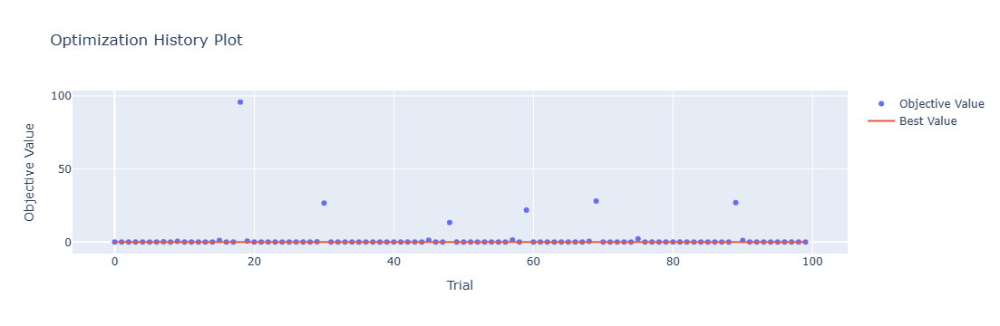

In [4]:
optuna.visualization.plot_optimization_history(study)

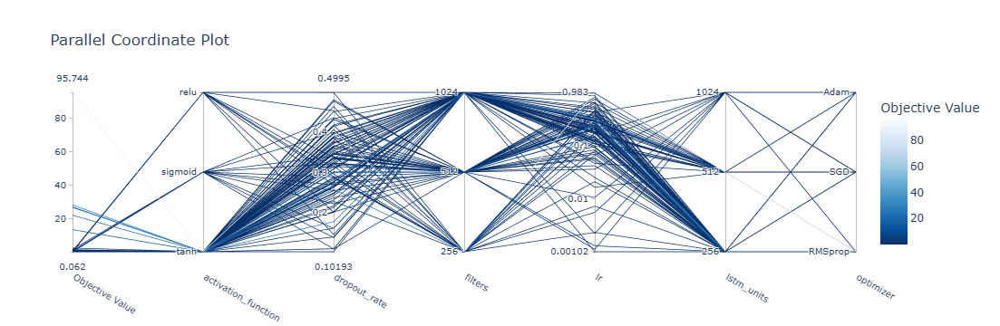

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

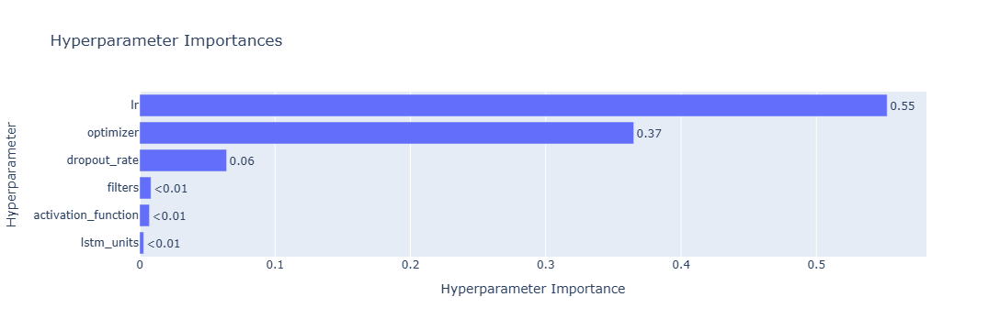

In [6]:
optuna.visualization.plot_param_importances(study)

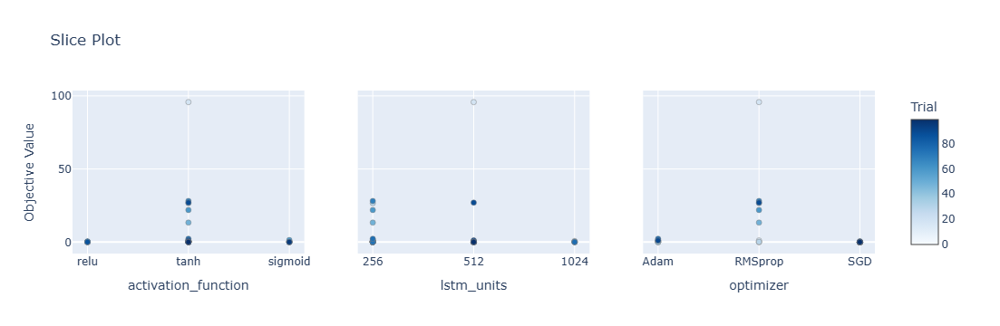

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

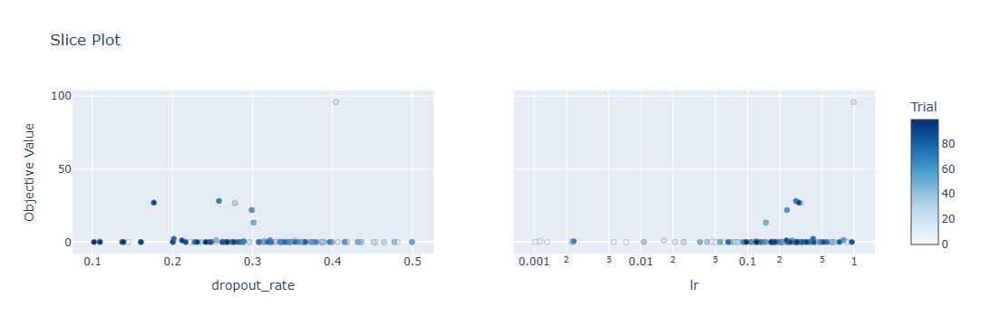

In [9]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 34s 163ms/step - loss: 0.1280 - accuracy: 0.1548 - mae: 0.1087 - rmse: 0.1280 - mape: 22.9479 - pearson: 0.5923 - val_loss: 0.0691 - val_accuracy: 0.9000 - val_mae: 0.0548 - val_rmse: 0.0691 - val_mape: 12.4100 - val_pearson: 0.7223
Epoch 2/100
84/84 [==============================] - 6s 76ms/step - loss: 0.0753 - accuracy: 0.2738 - mae: 0.0596 - rmse: 0.0753 - mape: 13.2806 - pearson: 0.7357 - val_loss: 0.0728 - val_accuracy: 0.3000 - val_mae: 0.0571 - val_rmse: 0.0728 - val_mape: 12.1179 - val_pearson: 0.6844
Epoch 3/100
84/84 [==============================] - 6s 68ms/step - loss: 0.0706 - accuracy: 0.3810 - mae: 0.0559 - rmse: 0.0706 - mape: 12.4756 - pearson: 0.7541 - val_loss: 0.0686 - val_accuracy: 0.0000e+00 - val_mae: 0.0530 - val_rmse: 0.0686 - val_mape: 11.6396 - val_pearson: 0.7513
Epoch 4/100
84/84 [==============================] - 5s 65ms/step - loss: 0.0690 - accuracy: 0.4048 - mae: 0.0543 - rmse: 0.0690 - mape: 12.17

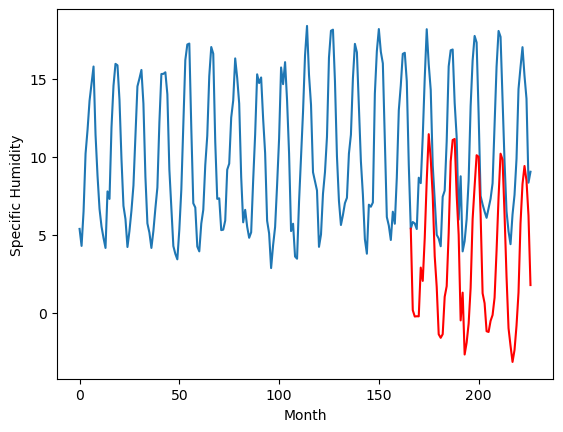

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.70		-1.05		0.65
-1.37		-1.16		0.21
-1.81		-1.30		0.51
-1.08		-1.10		-0.02
2.80		2.01		-0.79
1.01		1.13		0.12
3.33		3.16		-0.17
7.01		6.68		-0.33
8.67		9.05		0.38
8.61		8.55		-0.06
6.51		6.74		0.23
3.95		3.64		-0.31
0.62		0.77		0.15
-2.90		-2.97		-0.07
-2.55		-3.10		-0.55
-1.84		-2.24		-0.40
0.37		-0.41		-0.78
0.59		0.03		-0.56
3.08		3.03		-0.05
7.83		7.40		-0.43
8.63		8.63		-0.00
8.79		8.80		0.01
6.63		5.87		-0.76
3.55		3.28		-0.27
-2.11		-2.27		-0.16
1.53		0.26		-1.27
-3.23		-4.41		-1.18
-2.01		-3.35		-1.34
-0.10		-2.24		-2.14
1.20		-0.11		-1.31
5.44		3.99		-1.45
8.05		5.83		-2.22
8.95		7.82		-1.13
8.38		7.62		-0.76
5.32		4.39		-0.93
0.18		-0.49		-0.67
-0.02		-0.81		-0.79
-1.22		-2.88		-1.66
-1.13		-3.06		-1.93
0.56		-1.85		-2.41
0.94		-1.70		-2.64
1.73		-0.59		-2.32
3.92		1.63		-2.29
7.25		4.97		-2.28
8.92		7.66		-1.26
9.70		7.39		-2.31
5.68		3.97		-1.71
0.98		-0.04		-1.02
-1.20		-3.15		

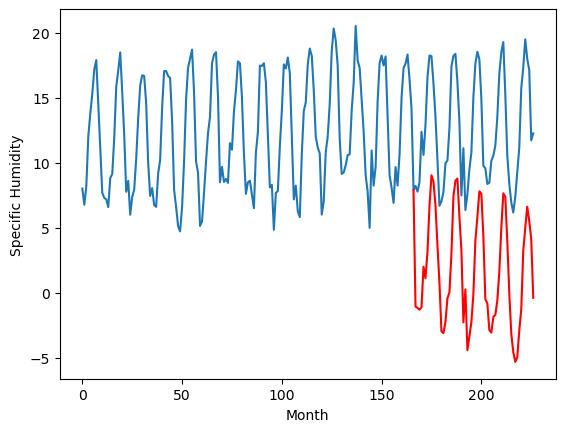

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		-0.78		0.58
-1.11		-0.95		0.16
-1.28		-1.06		0.22
-0.73		-0.96		-0.23
1.87		1.86		-0.01
0.62		1.08		0.46
3.48		3.39		-0.09
7.39		7.06		-0.33
9.79		9.76		-0.03
9.88		8.92		-0.96
6.79		6.74		-0.05
4.04		3.48		-0.56
0.71		1.00		0.29
-2.45		-2.27		0.18
-2.07		-2.50		-0.43
-1.92		-1.92		-0.00
-0.07		-0.02		0.05
0.17		0.61		0.44
2.93		3.46		0.53
7.55		8.05		0.50
9.46		9.39		-0.07
9.66		9.68		0.02
6.66		6.48		-0.18
3.94		4.08		0.14
-1.93		-1.51		0.42
0.47		0.46		-0.01
-2.94		-3.57		-0.63
-1.73		-2.66		-0.93
-1.02		-1.53		-0.51
0.43		0.41		-0.02
4.57		4.60		0.03
7.35		6.48		-0.87
9.55		8.73		-0.82
8.85		8.59		-0.26
5.12		5.29		0.17
0.12		0.45		0.33
-0.20		-0.08		0.12
-1.53		-2.07		-0.54
-1.16		-2.05		-0.89
-0.05		-1.23		-1.18
-0.69		-1.07		-0.38
0.75		0.21		-0.54
3.53		2.30		-1.23
6.11		5.71		-0.40
8.97		8.82		-0.15
9.06		8.46		-0.60
5.48		5.15		-0.33
1.57		1.24		-0.33
-0.96		-2.05		-1.09
-1.7

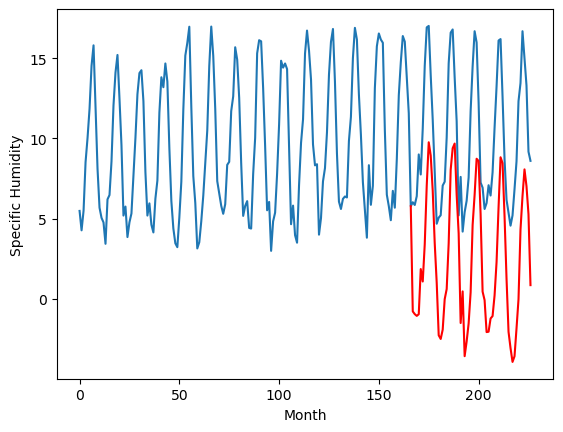

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		-1.14		0.68
-1.28		-1.43		-0.15
-1.04		-1.47		-0.43
-0.90		-1.33		-0.43
3.41		2.08		-1.33
2.26		1.11		-1.15
4.41		3.43		-0.98
6.90		6.95		0.05
9.65		9.48		-0.17
8.40		8.47		0.07
7.05		6.58		-0.47
3.24		3.06		-0.18
0.19		0.50		0.31
-2.88		-3.15		-0.27
-2.81		-3.26		-0.45
-2.90		-2.63		0.27
0.55		-0.42		-0.97
1.12		0.01		-1.11
4.63		3.48		-1.15
8.53		7.81		-0.72
9.37		9.04		-0.33
8.99		9.01		0.02
6.68		5.83		-0.85
4.25		3.08		-1.17
-1.96		-2.41		-0.45
1.09		0.11		-0.98
-4.03		-4.63		-0.60
-2.82		-3.66		-0.84
-1.73		-2.49		-0.76
1.19		-0.04		-1.23
5.43		4.22		-1.21
7.44		6.23		-1.21
8.65		7.98		-0.67
7.93		7.80		-0.13
4.55		4.29		-0.26
-0.55		-0.78		-0.23
-1.07		-1.13		-0.06
-1.57		-3.07		-1.50
-1.38		-3.34		-1.96
-0.71		-2.14		-1.43
0.37		-1.83		-2.20
0.77		-0.87		-1.64
3.62		2.07		-1.55
7.77		5.43		-2.34
8.80		7.80		-1.00
8.55		7.51		-1.04
6.37		3.92		-2.45
1.80		-0.18		-1.98
-1.19		-3.

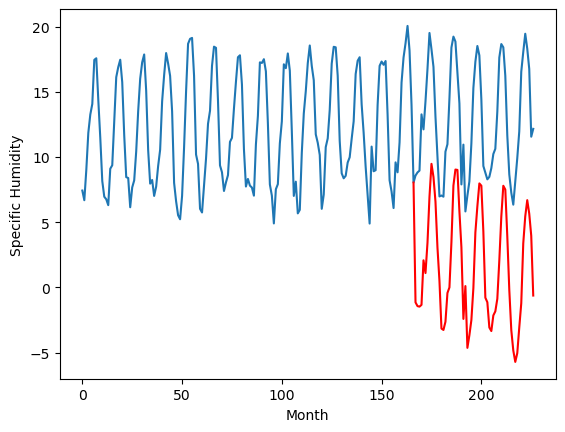

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		1.27		-0.98
1.00		0.66		-0.34
1.79		0.80		-0.99
1.18		0.75		-0.43
5.63		4.22		-1.41
5.35		3.29		-2.06
7.93		6.09		-1.84
10.29		9.51		-0.78
13.15		12.30		-0.85
10.88		10.40		-0.48
9.57		8.30		-1.27
5.29		4.22		-1.07
3.44		2.50		-0.94
0.66		-0.54		-1.20
0.59		-0.63		-1.22
0.19		-0.53		-0.72
3.03		2.12		-0.91
4.43		2.64		-1.79
8.44		6.58		-1.86
12.13		10.74		-1.39
12.84		12.10		-0.74
12.76		11.77		-0.99
8.53		8.22		-0.31
6.44		5.44		-1.00
2.22		0.53		-1.69
4.98		2.30		-2.68
-0.52		-1.79		-1.27
-0.26		-1.17		-0.91
1.29		0.07		-1.22
5.21		2.67		-2.54
8.91		6.96		-1.95
9.88		9.21		-0.67
9.64		10.72		1.08
10.73		10.64		-0.09
7.90		6.86		-1.04
3.10		1.88		-1.22
3.09		1.18		-1.91
2.01		-0.40		-2.41
1.25		-0.64		-1.89
1.59		0.17		-1.42
3.78		0.79		-2.99
4.54		1.58		-2.96
8.48		5.52		-2.96
12.60		8.76		-3.84
11.18		10.70		-0.48
9.36		10.44		1.08
9.32		6.84		-2.48
5.57		2.89		-2.68
2.77		-0.11		-2.

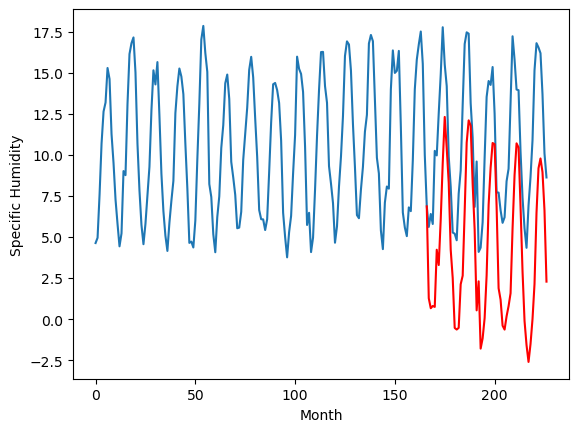

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.59		2.98		0.39
2.55		2.85		0.30
2.07		2.70		0.63
1.96		2.79		0.83
3.72		5.23		1.51
4.06		4.60		0.54
7.19		6.86		-0.33
10.92		10.55		-0.37
14.40		13.29		-1.11
14.43		12.60		-1.83
11.53		10.29		-1.24
7.83		7.25		-0.58
4.88		4.84		-0.04
1.12		1.82		0.70
0.51		1.53		1.02
1.10		2.08		0.98
2.67		3.75		1.08
3.68		4.50		0.82
6.18		6.99		0.81
11.44		11.63		0.19
12.56		13.04		0.48
13.72		13.47		-0.25
9.63		10.33		0.70
7.31		8.12		0.81
2.05		2.63		0.58
3.47		4.19		0.72
0.36		0.62		0.26
1.74		1.47		-0.27
3.07		2.56		-0.51
4.20		4.19		-0.01
8.98		8.24		-0.74
10.07		10.02		-0.05
14.40		12.50		-1.90
12.61		12.38		-0.23
9.91		9.25		-0.66
5.27		4.65		-0.62
4.61		3.99		-0.62
1.26		1.99		0.73
2.01		2.17		0.16
2.94		2.76		-0.18
2.72		2.85		0.13
5.40		4.31		-1.09
6.16		5.92		-0.24
10.06		9.30		-0.76
14.41		12.75		-1.66
13.52		12.33		-1.19
10.40		9.25		-1.15
6.00		5.52		-0.48
2.98		2.17		-0.81
2.16		1.48		-0.68


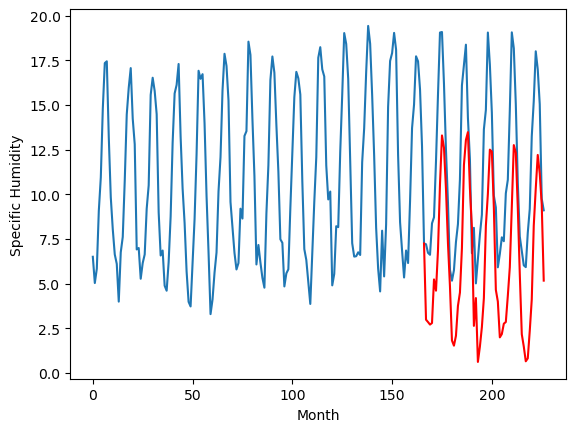

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.36		0.49		0.13
0.48		0.32		-0.16
0.40		0.20		-0.20
0.76		0.27		-0.49
2.39		2.82		0.43
2.17		2.15		-0.02
5.27		4.48		-0.79
8.99		8.15		-0.84
11.78		10.91		-0.87
11.72		10.09		-1.63
8.19		7.79		-0.40
5.47		4.62		-0.85
2.62		2.28		-0.34
-0.25		-0.76		-0.51
-0.40		-1.03		-0.63
-0.35		-0.53		-0.18
1.24		1.25		0.01
1.84		1.98		0.14
4.84		4.61		-0.23
9.22		9.22		0.00
10.66		10.62		-0.04
11.19		10.99		-0.20
7.87		7.79		-0.08
5.76		5.53		-0.23
0.01		0.06		0.05
1.85		1.67		-0.18
-0.93		-1.98		-1.05
0.35		-1.15		-1.50
1.36		-0.03		-1.39
2.36		1.69		-0.67
6.72		5.80		-0.92
8.60		7.63		-0.97
12.22		10.03		-2.19
10.87		9.92		-0.95
7.43		6.71		-0.72
2.87		2.04		-0.83
2.27		1.38		-0.89
0.09		-0.58		-0.67
0.95		-0.44		-1.39
1.63		0.18		-1.45
1.22		0.31		-0.91
3.43		1.71		-1.72
5.02		3.55		-1.47
7.75		6.93		-0.82
11.49		10.26		-1.23
11.12		9.87		-1.25
8.18		6.71		-1.47
3.92		2.94		-0.98
0.59		-0.40		-0.99
0.

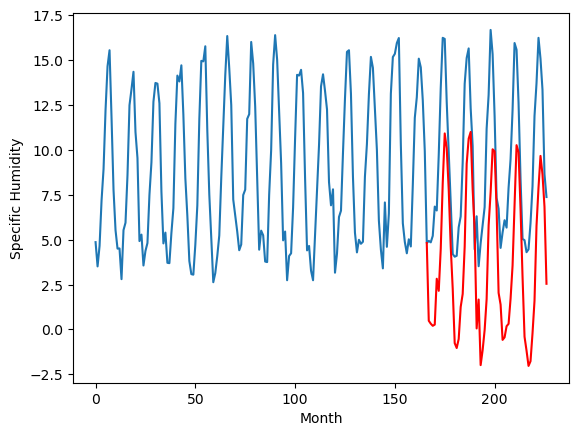

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.52		2.61		0.09
2.77		2.42		-0.35
2.80		2.32		-0.48
3.02		2.35		-0.67
4.32		4.74		0.42
4.26		4.13		-0.13
6.25		6.56		0.31
10.92		10.28		-0.64
13.73		13.17		-0.56
13.97		12.24		-1.73
10.07		9.78		-0.29
7.36		6.58		-0.78
4.82		4.40		-0.42
1.95		1.56		-0.39
1.64		1.24		-0.40
1.67		1.64		-0.03
3.29		3.42		0.13
3.99		4.24		0.25
7.01		6.78		-0.23
11.28		11.48		0.20
12.78		12.93		0.15
13.06		13.35		0.29
9.57		10.05		0.48
7.69		7.88		0.19
1.90		2.42		0.52
3.67		3.75		0.08
1.16		0.40		-0.76
2.39		1.17		-1.22
3.38		2.29		-1.09
4.28		3.90		-0.38
8.57		8.02		-0.55
10.02		9.85		-0.17
13.39		12.37		-1.02
12.32		12.29		-0.03
9.53		9.07		-0.46
5.11		4.44		-0.67
4.41		3.70		-0.71
2.07		1.76		-0.31
3.00		2.00		-1.00
3.36		2.44		-0.92
3.28		2.58		-0.70
5.56		4.06		-1.50
6.88		5.79		-1.09
9.50		9.18		-0.32
13.85		12.71		-1.14
12.79		12.27		-0.52
9.99		9.19		-0.80
6.24		5.47		-0.77
2.72		2.06		-0.66
2.92		1.47		

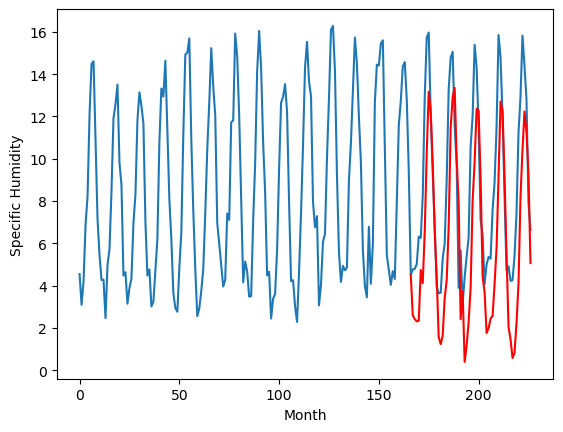

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		0.39		-0.96
1.44		-0.08		-1.52
1.04		-0.04		-1.08
1.03		-0.15		-1.18
3.29		2.71		-0.58
3.53		1.97		-1.56
6.75		4.98		-1.77
10.40		8.77		-1.63
13.49		12.03		-1.46
11.46		10.10		-1.36
8.74		7.40		-1.34
4.29		3.32		-0.97
2.53		1.76		-0.77
0.62		-0.81		-1.43
0.39		-1.13		-1.52
-0.29		-1.16		-0.87
2.77		1.33		-1.44
3.50		2.19		-1.31
6.41		5.47		-0.94
11.39		10.21		-1.18
12.89		11.70		-1.19
13.08		11.86		-1.22
9.27		8.03		-1.24
6.85		5.66		-1.19
1.56		0.20		-1.36
3.15		1.42		-1.73
-0.13		-1.95		-1.82
0.46		-1.34		-1.80
2.14		-0.10		-2.24
3.72		2.02		-1.70
7.91		6.49		-1.42
10.09		8.63		-1.46
13.75		10.82		-2.93
12.78		10.78		-2.00
8.33		7.02		-1.31
3.10		2.00		-1.10
2.10		1.14		-0.96
1.17		-0.55		-1.72
1.77		-0.43		-2.20
1.84		-0.09		-1.93
2.28		0.30		-1.98
3.50		1.53		-1.97
6.99		4.49		-2.50
9.27		7.95		-1.32
12.82		11.08		-1.74
12.82		10.66		-2.16
8.75		7.24		-1.51
4.69		3.32		-1.37
2.03		-

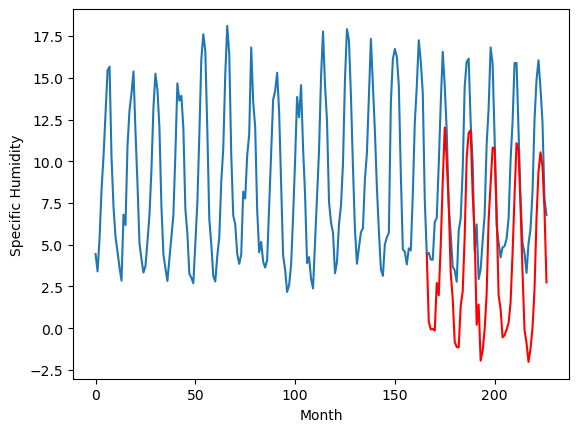

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.84		2.31		-0.53
3.25		2.00		-1.25
2.75		1.95		-0.80
2.43		1.85		-0.58
4.39		4.10		-0.29
4.45		3.56		-0.89
7.59		6.38		-1.21
10.28		10.18		-0.10
13.42		13.42		-0.00
12.20		11.89		-0.31
9.41		9.08		-0.33
6.07		5.46		-0.61
4.02		3.85		-0.17
2.36		1.55		-0.81
2.03		1.15		-0.88
1.58		1.18		-0.40
3.38		3.22		-0.16
4.70		4.23		-0.47
6.79		6.83		0.04
11.56		11.66		0.10
12.49		13.21		0.72
12.91		13.65		0.74
9.74		9.99		0.25
8.43		7.95		-0.48
2.91		2.57		-0.34
3.75		3.32		-0.43
1.46		0.56		-0.90
2.20		1.12		-1.08
3.48		2.30		-1.18
5.10		3.87		-1.23
9.71		8.10		-1.61
11.39		10.04		-1.35
14.97		12.66		-2.31
13.43		12.68		-0.75
10.37		9.25		-1.12
4.58		4.59		0.01
3.86		3.58		-0.28
2.93		1.86		-1.07
3.54		2.22		-1.32
3.31		2.27		-1.04
3.41		2.50		-0.91
5.14		4.02		-1.12
7.58		6.01		-1.57
10.20		9.40		-0.80
14.02		13.12		-0.90
12.72		12.66		-0.06
10.00		9.60		-0.40
6.76		5.93		-0.83
3.41		2.37		-1.04
3.6

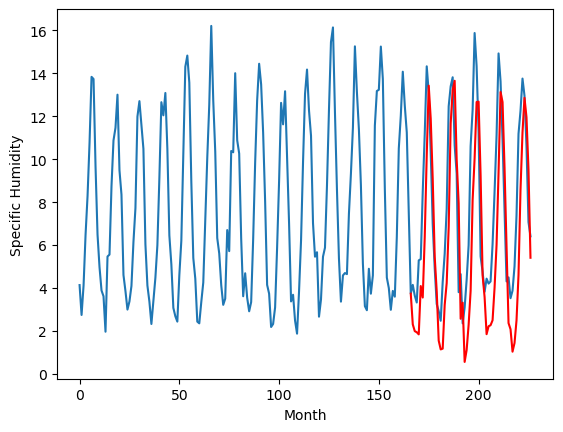

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.21		1.19		-0.02
1.33		0.83		-0.50
0.95		0.77		-0.18
0.44		0.59		0.15
2.04		2.52		0.48
2.40		2.15		-0.25
5.30		5.06		-0.24
8.40		8.85		0.45
11.45		12.20		0.75
9.88		10.50		0.62
7.22		7.49		0.27
3.77		3.86		0.09
2.36		2.61		0.25
0.83		0.76		-0.07
0.45		0.27		-0.18
-0.29		0.12		0.41
1.33		2.10		0.77
2.93		3.28		0.35
4.45		5.64		1.19
9.58		10.48		0.90
10.65		12.12		1.47
11.14		12.61		1.47
7.52		8.89		1.37
6.53		7.06		0.53
1.68		1.92		0.24
1.68		2.07		0.39
-0.39		-0.09		0.30
0.21		0.30		0.09
1.46		1.48		0.02
2.40		2.83		0.43
6.12		6.94		0.82
7.39		8.87		1.48
9.88		11.63		1.75
10.87		11.75		0.88
8.27		8.36		0.09
3.25		3.92		0.67
2.11		2.68		0.57
0.94		1.08		0.14
1.34		1.59		0.25
0.78		1.30		0.52
1.24		1.56		0.32
2.88		3.17		0.29
4.09		4.99		0.90
7.10		8.30		1.20
10.93		12.22		1.29
10.18		11.74		1.56
8.87		8.87		0.00
5.11		5.39		0.28
1.70		1.78		0.08
2.23		1.82		-0.41
0.71		0.77		0.06
1.24		1.13	

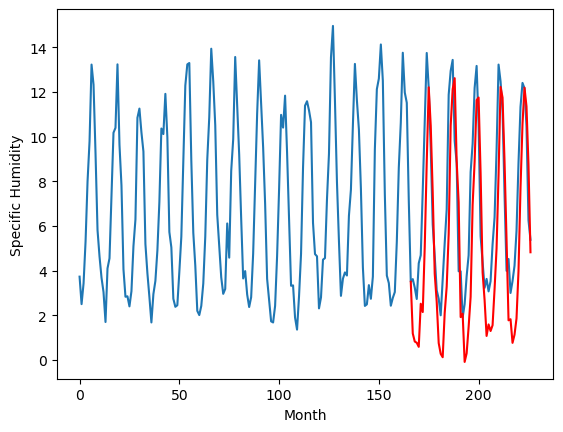

RangeIndex(start=1, stop=12, step=1)
[0.7500000000000009, -1.7000000000000002, -1.3600000000000003, -1.8200000000000012, 2.2500000000000004, 2.59, 0.3600000000000003, 2.5199999999999996, 1.3499999999999996, 2.84, 1.21]
[0.18434797286987337, -1.048470211029053, -0.7822857475280758, -1.1414540863037113, 1.2711211585998532, 2.979713706970214, 0.48554275512695355, 2.6106077957153317, 0.3949817466735839, 2.31412935256958, 1.1877888298034671]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.75   0.184348
1                 1   -1.70  -1.048470
2                 2   -1.36  -0.782286
3                 3   -1.82  -1.141454
4                 4    2.25   1.271121
5                 5    2.59   2.979714
6                 6    0.36   0.485543
7                 7    2.52   2.610608
8                 8    1.35   0.394982
9                 9    2.84   2.314129
10               10    1.21   1.187789


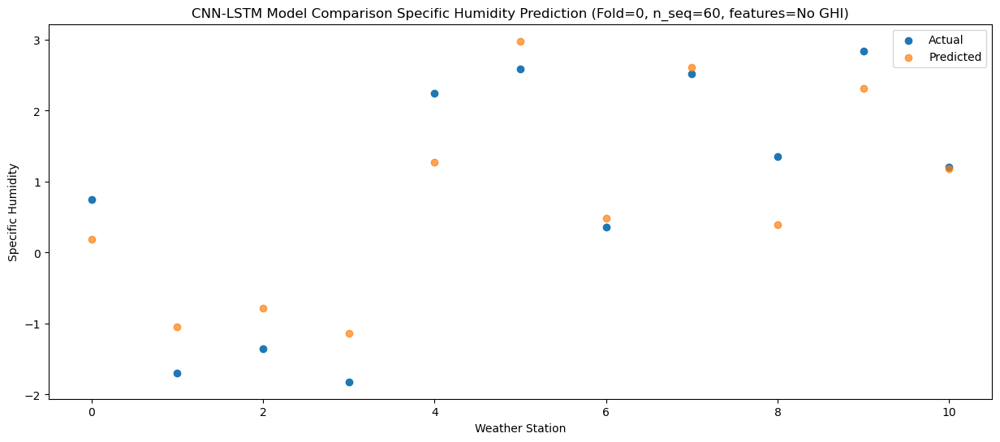

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -0.222689
1                 1   -1.37  -1.162664
2                 2   -1.11  -0.953307
3                 3   -1.28  -1.429634
4                 4    1.00   0.664361
5                 5    2.55   2.847256
6                 6    0.48   0.322350
7                 7    2.77   2.423527
8                 8    1.44  -0.077013
9                 9    3.25   1.996806
10               10    1.33   0.826284


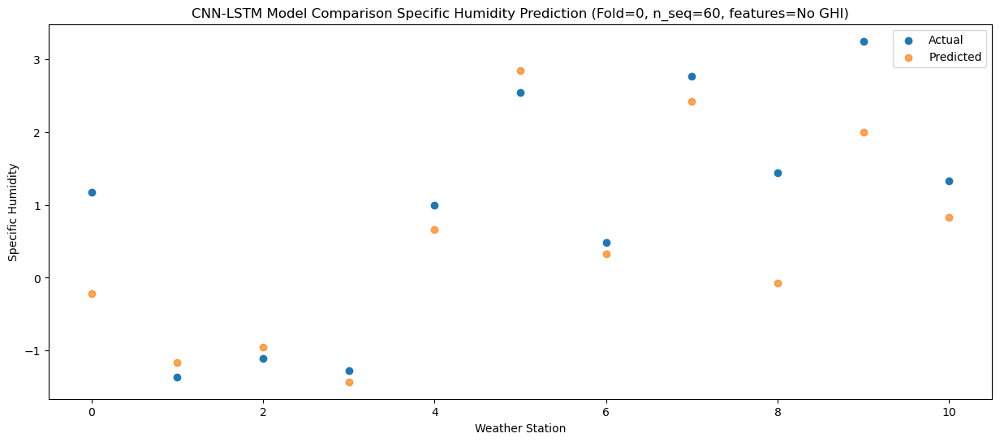

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.09  -0.205584
1                 1   -1.81  -1.300950
2                 2   -1.28  -1.062357
3                 3   -1.04  -1.466008
4                 4    1.79   0.800590
5                 5    2.07   2.704878
6                 6    0.40   0.204063
7                 7    2.80   2.316431
8                 8    1.04  -0.044913
9                 9    2.75   1.945208
10               10    0.95   0.771940


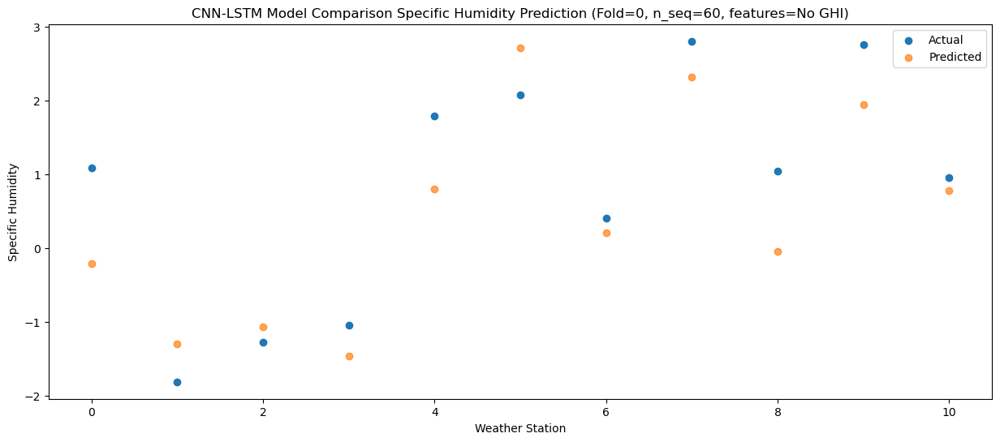

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.73  -0.210370
1                 1   -1.08  -1.104900
2                 2   -0.73  -0.958842
3                 3   -0.90  -1.332517
4                 4    1.18   0.745749
5                 5    1.96   2.791880
6                 6    0.76   0.270900
7                 7    3.02   2.347053
8                 8    1.03  -0.149063
9                 9    2.43   1.846386
10               10    0.44   0.588460


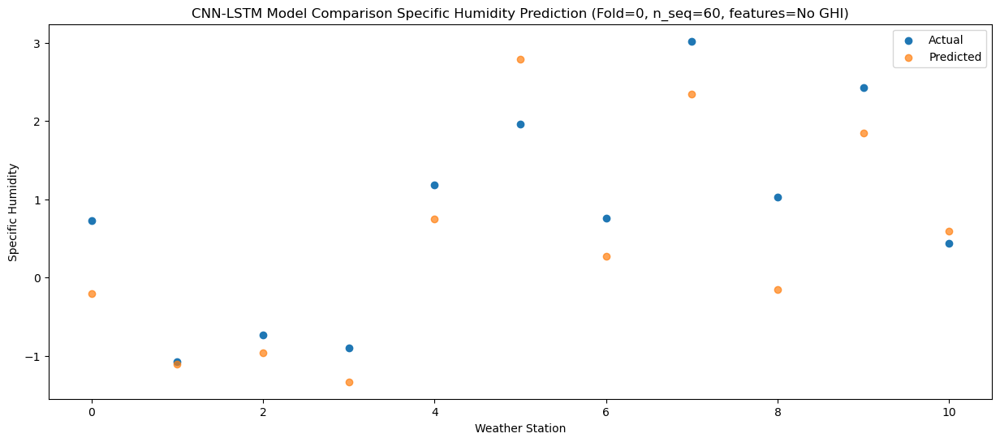

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.02   2.911588
1                 1    2.80   2.011299
2                 2    1.87   1.855603
3                 3    3.41   2.083275
4                 4    5.63   4.223841
5                 5    3.72   5.232337
6                 6    2.39   2.824034
7                 7    4.32   4.743291
8                 8    3.29   2.709333
9                 9    4.39   4.095114
10               10    2.04   2.517603


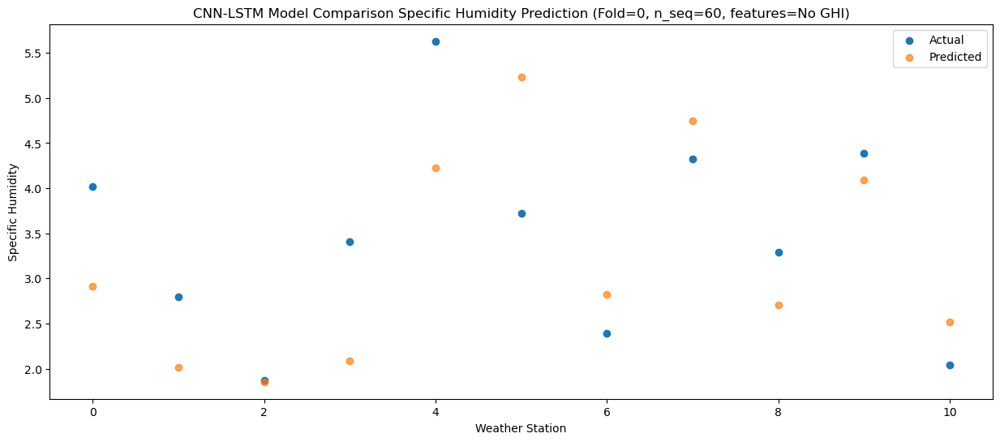

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.67   2.059290
1                 1    1.01   1.127814
2                 2    0.62   1.079866
3                 3    2.26   1.106821
4                 4    5.35   3.293091
5                 5    4.06   4.602761
6                 6    2.17   2.151091
7                 7    4.26   4.125268
8                 8    3.53   1.970157
9                 9    4.45   3.560532
10               10    2.40   2.146067


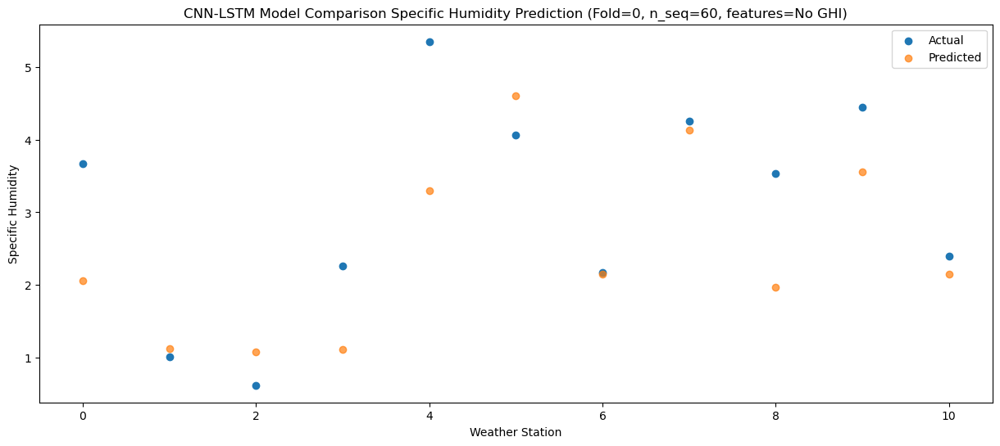

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.64   4.805431
1                 1    3.33   3.164978
2                 2    3.48   3.394890
3                 3    4.41   3.431708
4                 4    7.93   6.087634
5                 5    7.19   6.860037
6                 6    5.27   4.481217
7                 7    6.25   6.555971
8                 8    6.75   4.980123
9                 9    7.59   6.379912
10               10    5.30   5.062673


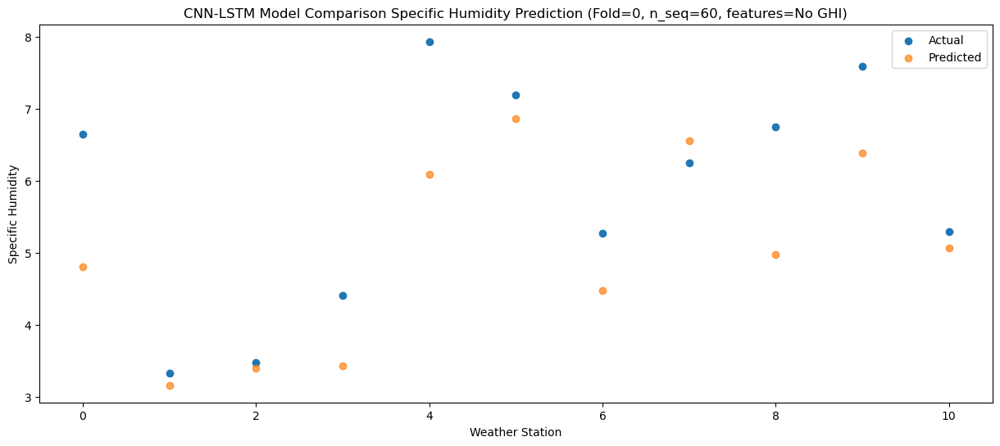

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.40   8.492499
1                 1    7.01   6.683494
2                 2    7.39   7.059103
3                 3    6.90   6.954247
4                 4   10.29   9.506474
5                 5   10.92  10.548669
6                 6    8.99   8.153177
7                 7   10.92  10.281733
8                 8   10.40   8.770851
9                 9   10.28  10.182225
10               10    8.40   8.847201


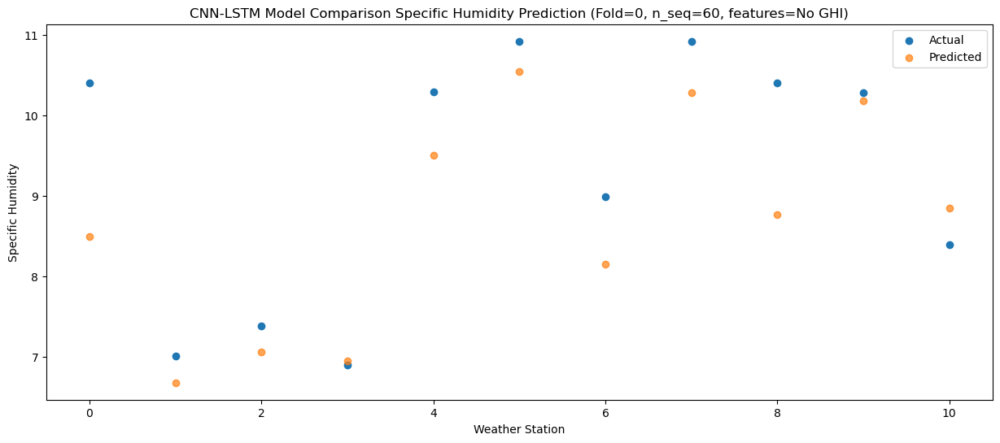

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.53  11.456575
1                 1    8.67   9.051813
2                 2    9.79   9.758108
3                 3    9.65   9.477819
4                 4   13.15  12.302824
5                 5   14.40  13.290034
6                 6   11.78  10.910342
7                 7   13.73  13.171669
8                 8   13.49  12.030187
9                 9   13.42  13.419449
10               10   11.45  12.201634


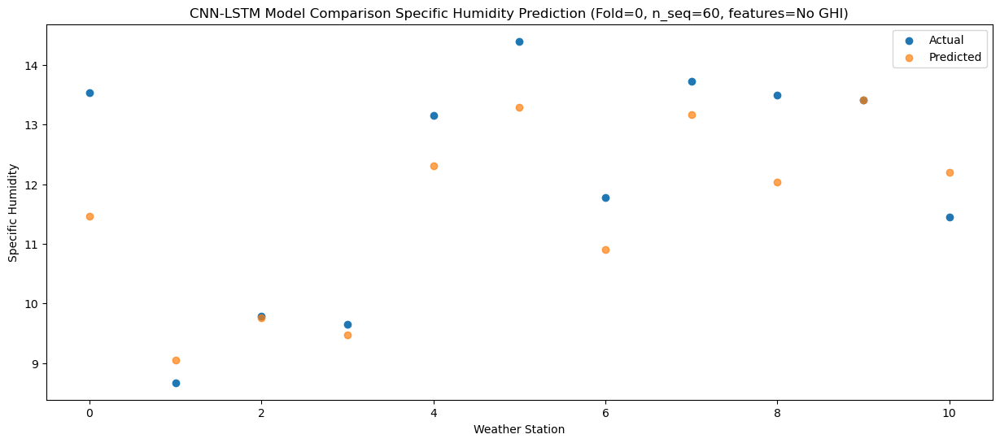

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.28   9.879507
1                 1    8.61   8.547247
2                 2    9.88   8.924475
3                 3    8.40   8.467974
4                 4   10.88  10.401873
5                 5   14.43  12.601031
6                 6   11.72  10.088226
7                 7   13.97  12.235048
8                 8   11.46  10.102876
9                 9   12.20  11.885812
10               10    9.88  10.498761


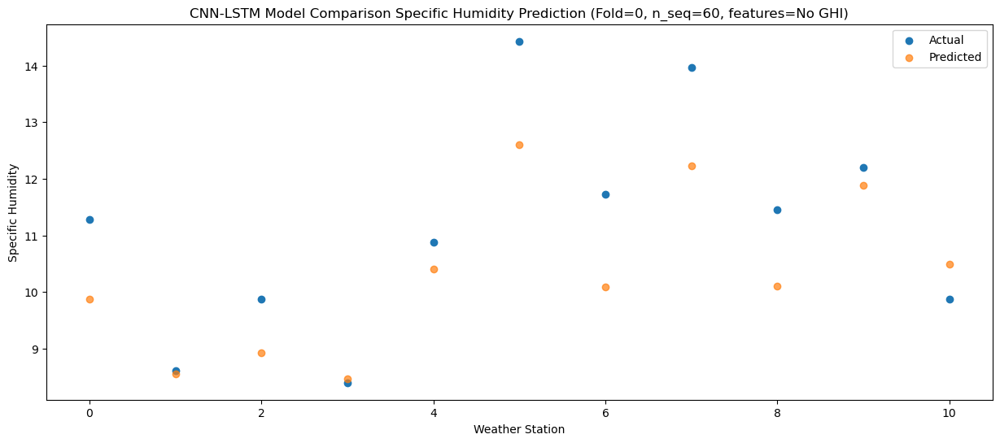

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.64   7.518780
1                 1    6.51   6.735739
2                 2    6.79   6.741153
3                 3    7.05   6.584340
4                 4    9.57   8.295165
5                 5   11.53  10.294117
6                 6    8.19   7.790040
7                 7   10.07   9.784698
8                 8    8.74   7.402198
9                 9    9.41   9.076554
10               10    7.22   7.488728


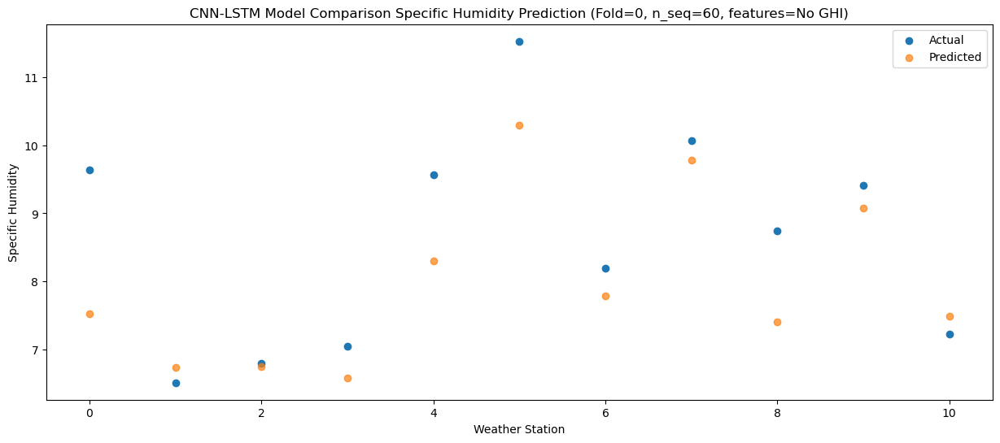

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.647002
1                 1    3.95   3.638223
2                 2    4.04   3.479346
3                 3    3.24   3.062088
4                 4    5.29   4.217288
5                 5    7.83   7.251878
6                 6    5.47   4.618938
7                 7    7.36   6.575295
8                 8    4.29   3.322682
9                 9    6.07   5.458038
10               10    3.77   3.861698


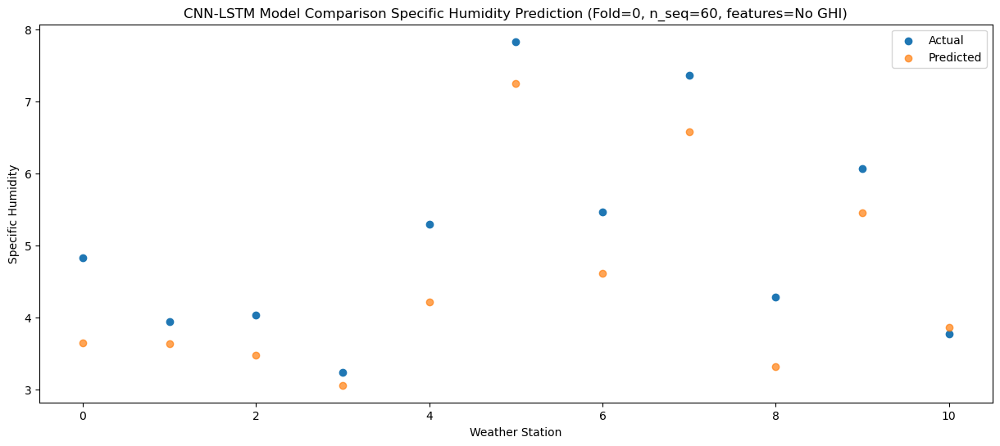

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.59   1.674472
1                 1    0.62   0.769391
2                 2    0.71   1.002356
3                 3    0.19   0.500550
4                 4    3.44   2.500894
5                 5    4.88   4.842699
6                 6    2.62   2.276645
7                 7    4.82   4.396088
8                 8    2.53   1.761431
9                 9    4.02   3.853294
10               10    2.36   2.608807


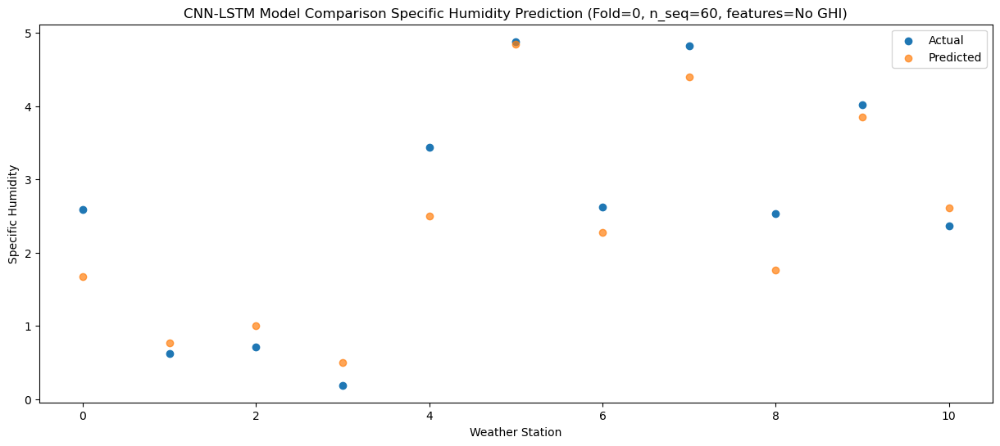

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.36  -1.359272
1                 1   -2.90  -2.967863
2                 2   -2.45  -2.272831
3                 3   -2.88  -3.147854
4                 4    0.66  -0.535381
5                 5    1.12   1.815651
6                 6   -0.25  -0.761039
7                 7    1.95   1.563158
8                 8    0.62  -0.813074
9                 9    2.36   1.554328
10               10    0.83   0.756035


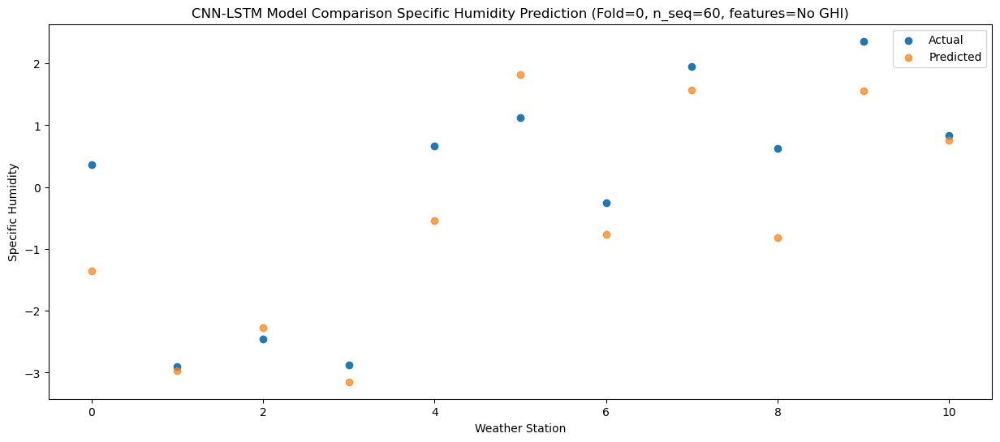

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.12  -1.586616
1                 1   -2.55  -3.095988
2                 2   -2.07  -2.500514
3                 3   -2.81  -3.255672
4                 4    0.59  -0.632281
5                 5    0.51   1.525568
6                 6   -0.40  -1.031987
7                 7    1.64   1.242886
8                 8    0.39  -1.129032
9                 9    2.03   1.146674
10               10    0.45   0.274479


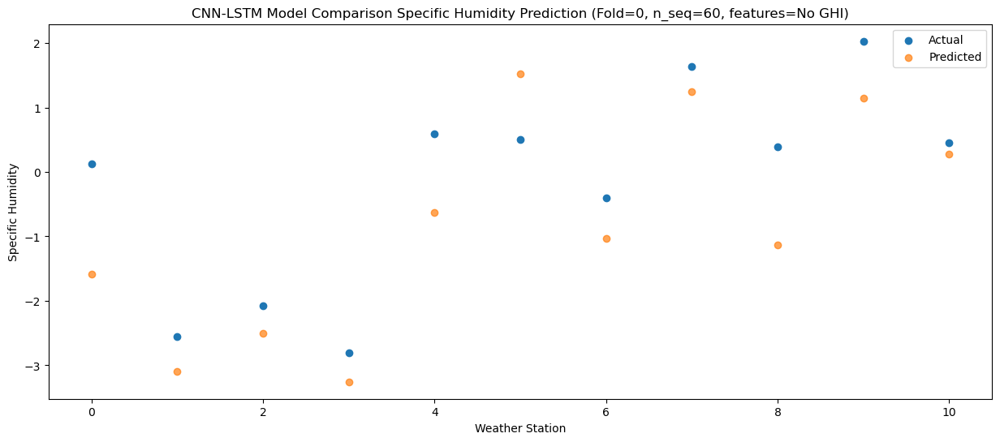

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.37  -1.353470
1                 1   -1.84  -2.244945
2                 2   -1.92  -1.921378
3                 3   -2.90  -2.628166
4                 4    0.19  -0.528573
5                 5    1.10   2.076744
6                 6   -0.35  -0.530149
7                 7    1.67   1.636378
8                 8   -0.29  -1.158202
9                 9    1.58   1.182168
10               10   -0.29   0.123572


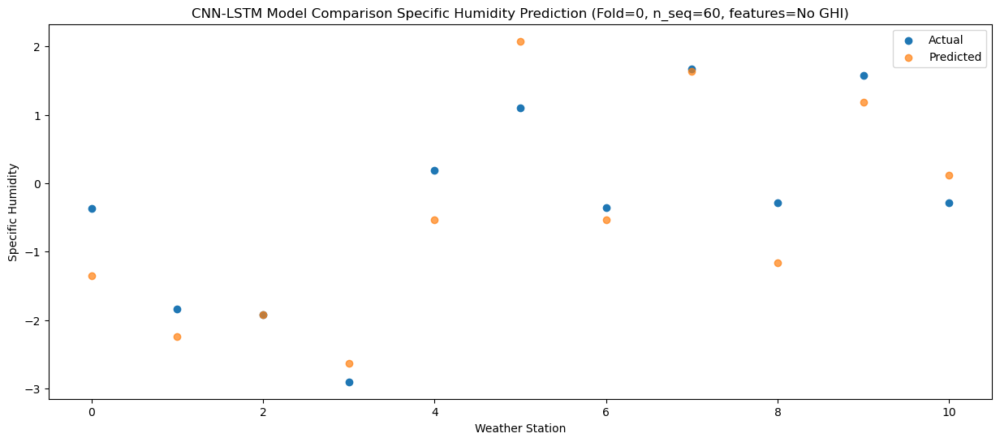

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.80   1.044609
1                 1    0.37  -0.408370
2                 2   -0.07  -0.022315
3                 3    0.55  -0.420733
4                 4    3.03   2.124064
5                 5    2.67   3.752767
6                 6    1.24   1.254677
7                 7    3.29   3.423990
8                 8    2.77   1.328257
9                 9    3.38   3.215211
10               10    1.33   2.100619


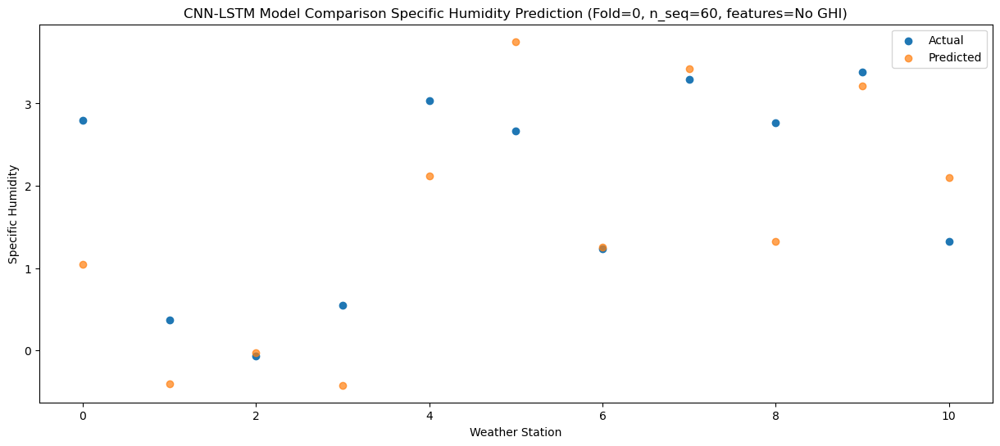

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.19   1.719160
1                 1    0.59   0.025349
2                 2    0.17   0.610223
3                 3    1.12   0.005143
4                 4    4.43   2.643869
5                 5    3.68   4.496002
6                 6    1.84   1.977431
7                 7    3.99   4.242250
8                 8    3.50   2.188612
9                 9    4.70   4.233664
10               10    2.93   3.278250


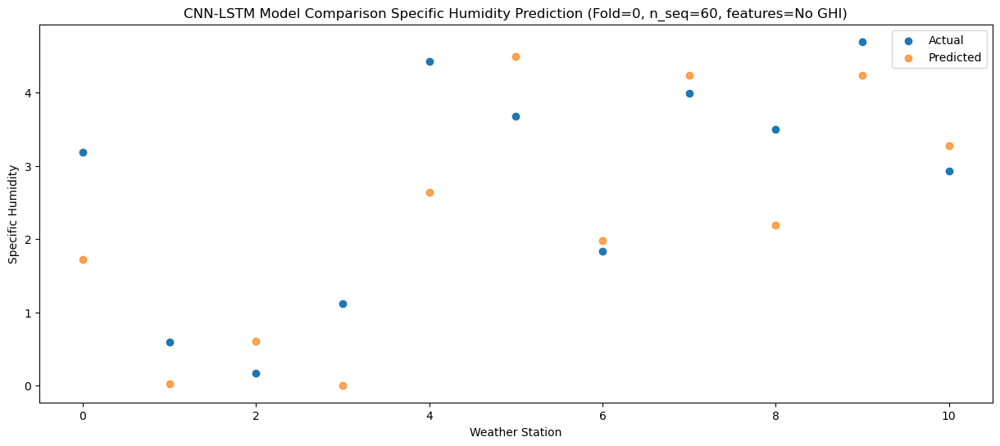

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    6.34   5.128996
1                 1    3.08   3.034421
2                 2    2.93   3.461961
3                 3    4.63   3.480515
4                 4    8.44   6.576305
5                 5    6.18   6.992586
6                 6    4.84   4.612025
7                 7    7.01   6.784202
8                 8    6.41   5.473602
9                 9    6.79   6.829296
10               10    4.45   5.641908


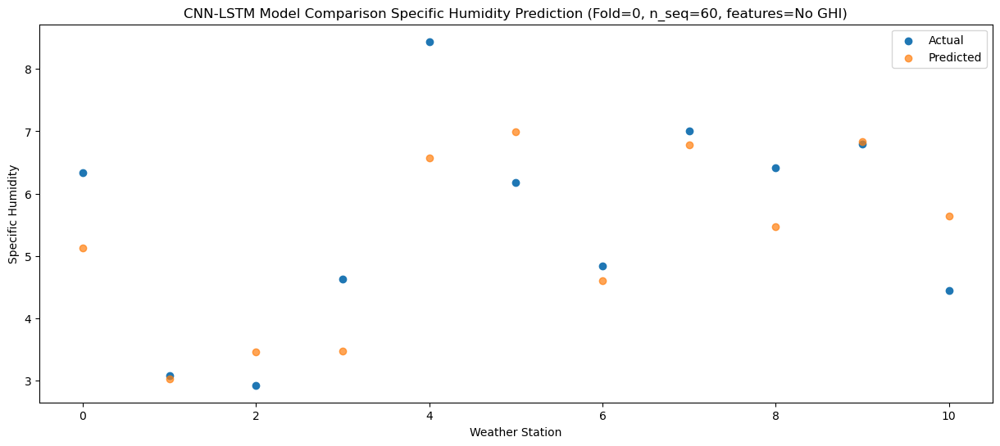

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.15   9.708432
1                 1    7.83   7.398174
2                 2    7.55   8.046381
3                 3    8.53   7.813324
4                 4   12.13  10.736268
5                 5   11.44  11.631930
6                 6    9.22   9.224277
7                 7   11.28  11.483232
8                 8   11.39  10.214512
9                 9   11.56  11.660924
10               10    9.58  10.480166


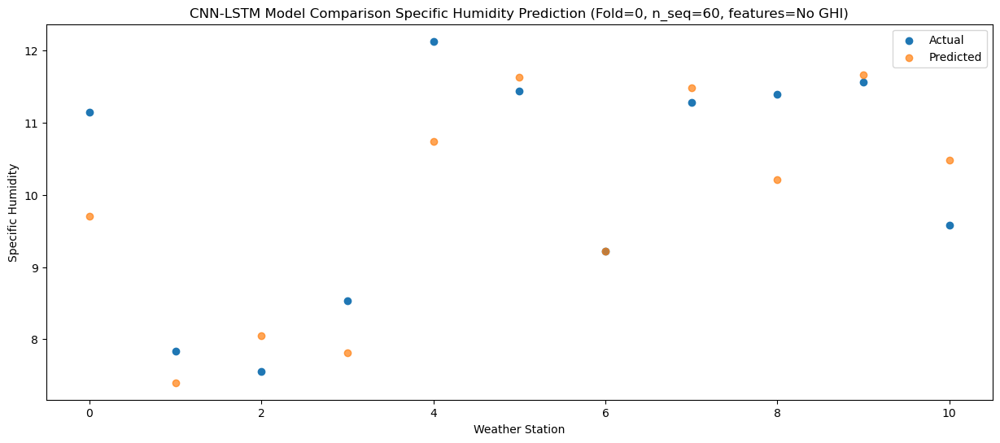

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.18  11.082946
1                 1    8.63   8.625250
2                 2    9.46   9.385134
3                 3    9.37   9.040540
4                 4   12.84  12.095788
5                 5   12.56  13.041732
6                 6   10.66  10.619672
7                 7   12.78  12.929041
8                 8   12.89  11.700852
9                 9   12.49  13.211829
10               10   10.65  12.119376


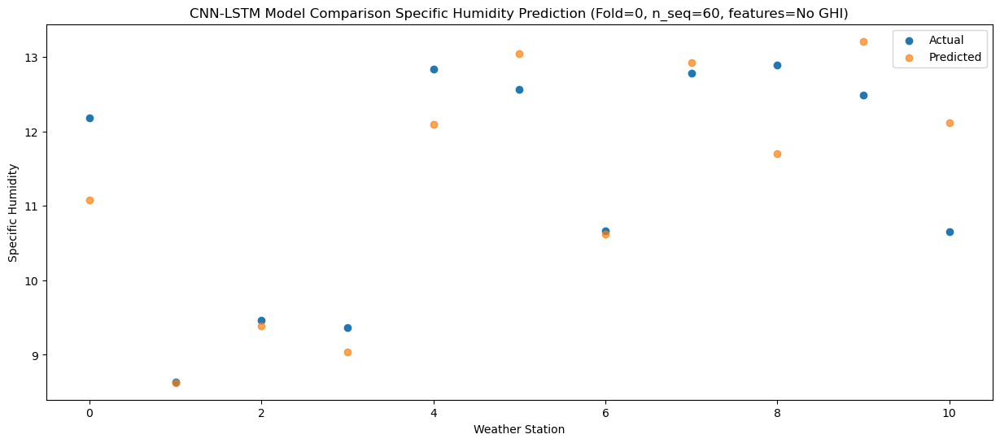

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.23  11.149104
1                 1    8.79   8.795021
2                 2    9.66   9.678091
3                 3    8.99   9.012804
4                 4   12.76  11.770673
5                 5   13.72  13.472998
6                 6   11.19  10.990750
7                 7   13.06  13.353660
8                 8   13.08  11.862229
9                 9   12.91  13.646916
10               10   11.14  12.611141


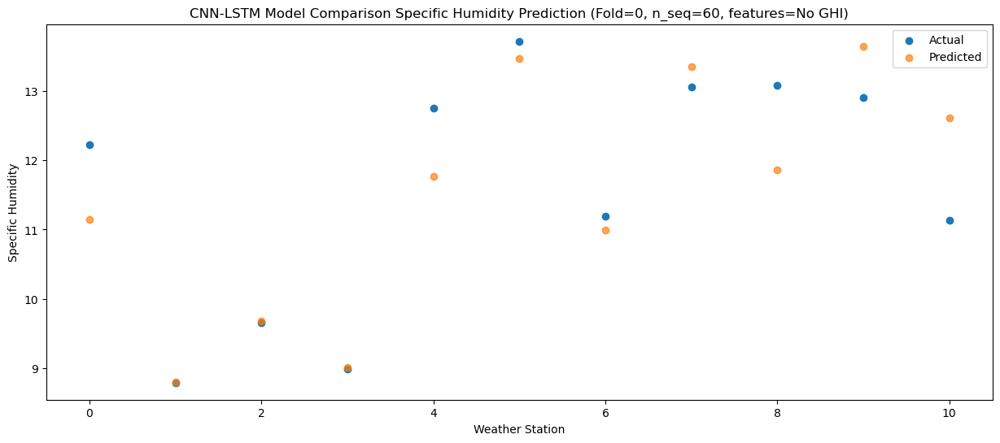

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.81   7.565367
1                 1    6.63   5.872715
2                 2    6.66   6.479196
3                 3    6.68   5.831139
4                 4    8.53   8.220471
5                 5    9.63  10.326737
6                 6    7.87   7.789653
7                 7    9.57  10.053037
8                 8    9.27   8.031623
9                 9    9.74   9.988690
10               10    7.52   8.894227


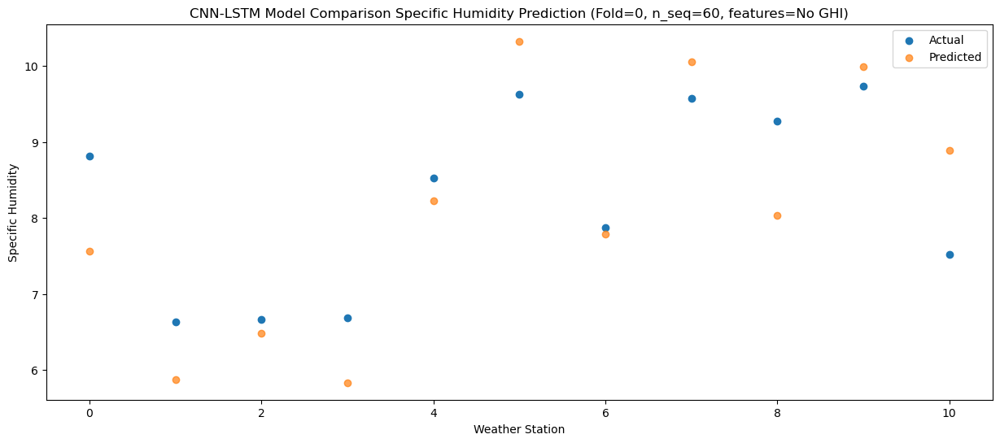

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.63   5.014064
1                 1    3.55   3.284026
2                 2    3.94   4.081119
3                 3    4.25   3.082370
4                 4    6.44   5.440389
5                 5    7.31   8.121585
6                 6    5.76   5.531318
7                 7    7.69   7.884471
8                 8    6.85   5.660764
9                 9    8.43   7.952728
10               10    6.53   7.062617


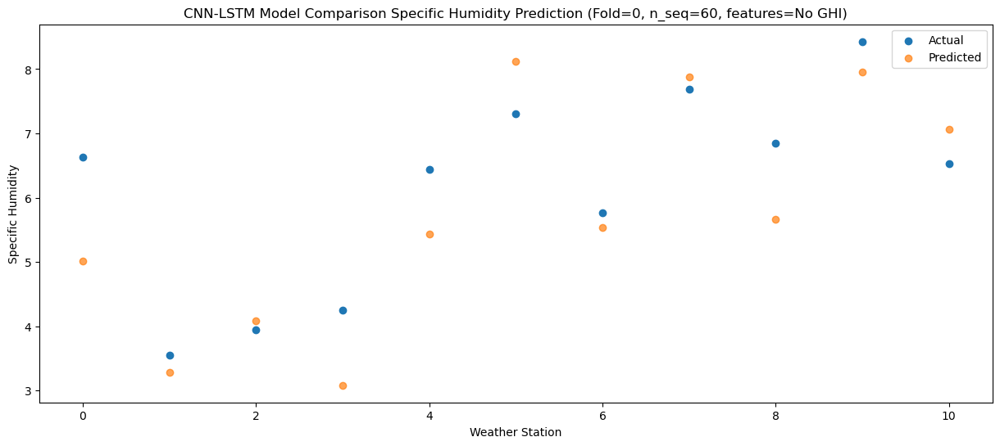

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.33  -0.470991
1                 1   -2.11  -2.272575
2                 2   -1.93  -1.507478
3                 3   -1.96  -2.408499
4                 4    2.22   0.534792
5                 5    2.05   2.633366
6                 6    0.01   0.057515
7                 7    1.90   2.415917
8                 8    1.56   0.204098
9                 9    2.91   2.572694
10               10    1.68   1.918481


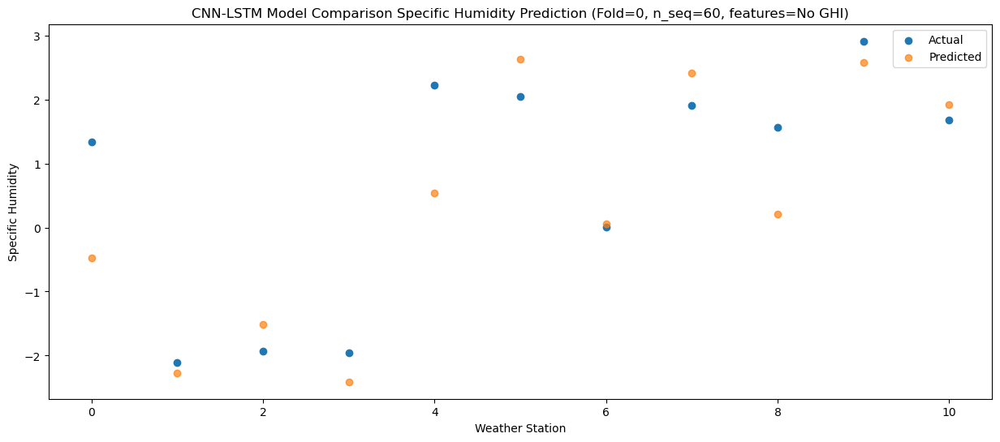

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.11   1.308044
1                 1    1.53   0.262302
2                 2    0.47   0.464266
3                 3    1.09   0.107967
4                 4    4.98   2.302084
5                 5    3.47   4.189427
6                 6    1.85   1.667302
7                 7    3.67   3.754856
8                 8    3.15   1.419786
9                 9    3.75   3.322286
10               10    1.68   2.072098


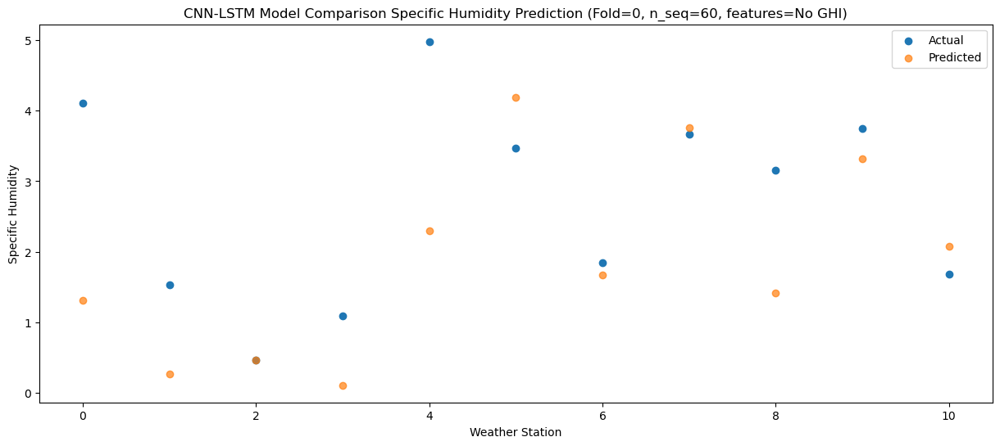

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.70  -2.655744
1                 1   -3.23  -4.407137
2                 2   -2.94  -3.574245
3                 3   -4.03  -4.627547
4                 4   -0.52  -1.792215
5                 5    0.36   0.615027
6                 6   -0.93  -1.983335
7                 7    1.16   0.398975
8                 8   -0.13  -1.950208
9                 9    1.46   0.564543
10               10   -0.39  -0.086262


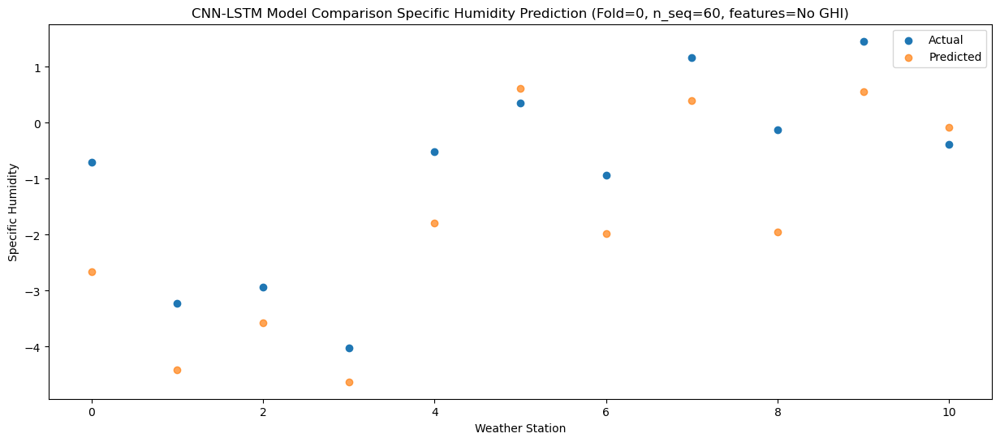

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.04  -1.896343
1                 1   -2.01  -3.350248
2                 2   -1.73  -2.658845
3                 3   -2.82  -3.658214
4                 4   -0.26  -1.167136
5                 5    1.74   1.469242
6                 6    0.35  -1.148152
7                 7    2.39   1.166962
8                 8    0.46  -1.343799
9                 9    2.20   1.117865
10               10    0.21   0.297501


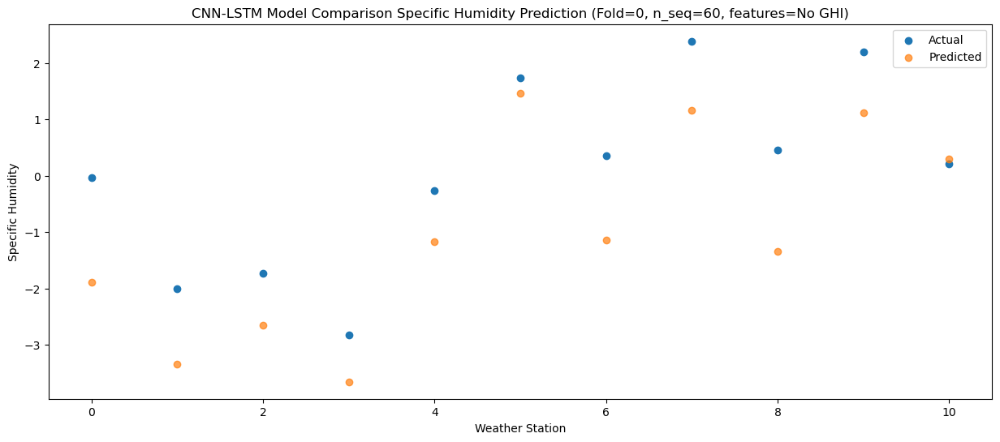

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.36  -0.678209
1                 1   -0.10  -2.242728
2                 2   -1.02  -1.530577
3                 3   -1.73  -2.493176
4                 4    1.29   0.066912
5                 5    3.07   2.564395
6                 6    1.36  -0.031575
7                 7    3.38   2.287820
8                 8    2.14  -0.095956
9                 9    3.48   2.295808
10               10    1.46   1.483177


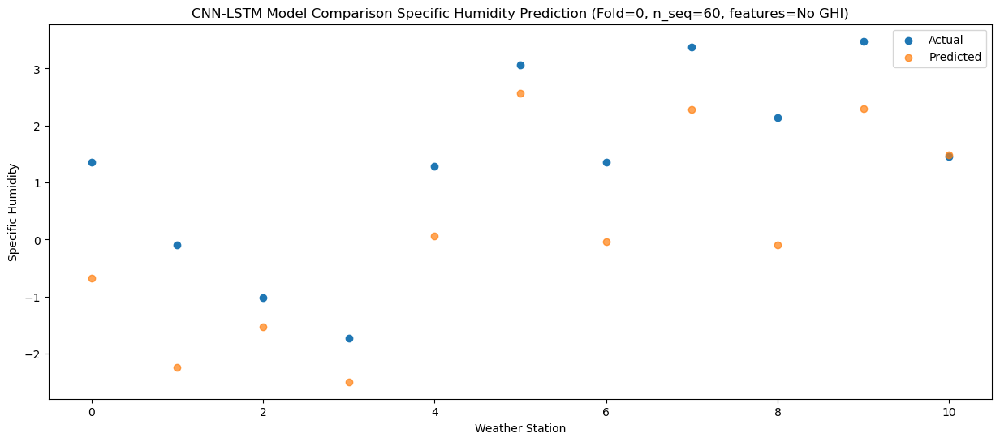

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.83   1.611669
1                 1    1.20  -0.106406
2                 2    0.43   0.408765
3                 3    1.19  -0.044274
4                 4    5.21   2.666251
5                 5    4.20   4.185108
6                 6    2.36   1.690601
7                 7    4.28   3.904752
8                 8    3.72   2.024885
9                 9    5.10   3.872195
10               10    2.40   2.826995


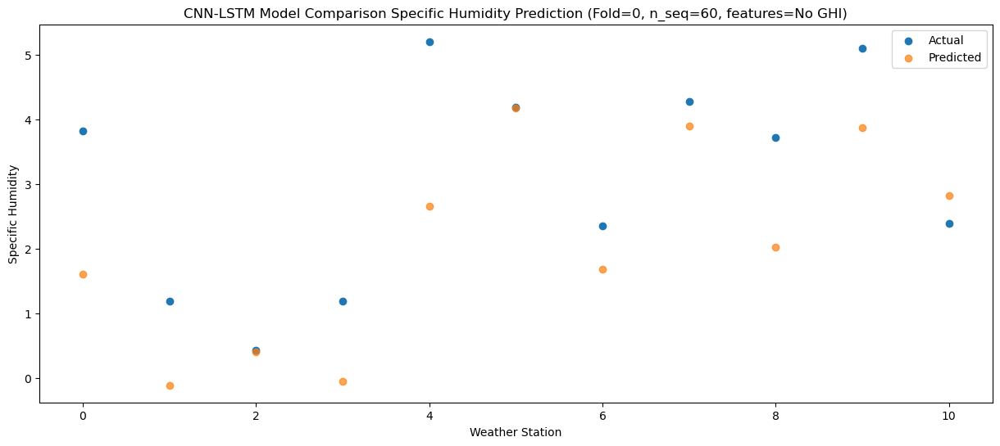

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    8.60   6.015464
1                 1    5.44   3.992728
2                 2    4.57   4.601841
3                 3    5.43   4.216226
4                 4    8.91   6.959885
5                 5    8.98   8.237688
6                 6    6.72   5.795915
7                 7    8.57   8.020194
8                 8    7.91   6.491026
9                 9    9.71   8.097263
10               10    6.12   6.937013


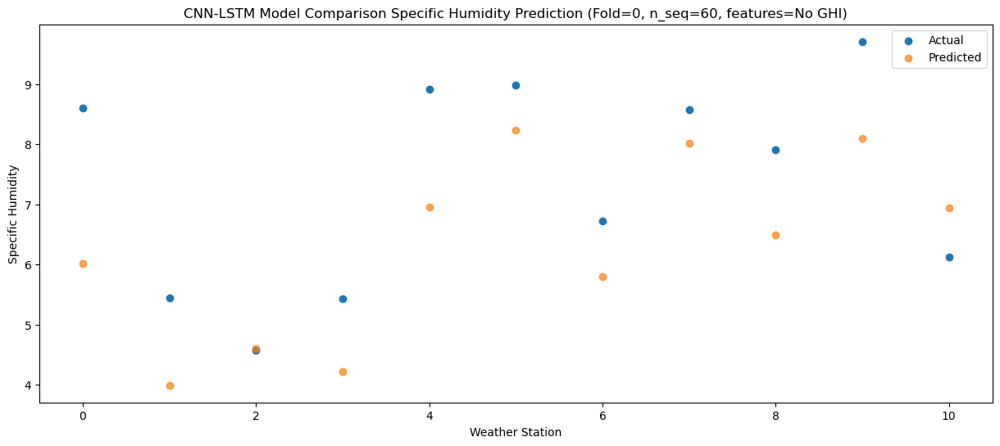

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   11.52   8.120122
1                 1    8.05   5.830802
2                 2    7.35   6.481642
3                 3    7.44   6.226118
4                 4    9.88   9.210813
5                 5   10.07  10.015799
6                 6    8.60   7.629277
7                 7   10.02   9.852971
8                 8   10.09   8.634855
9                 9   11.39  10.044190
10               10    7.39   8.868649


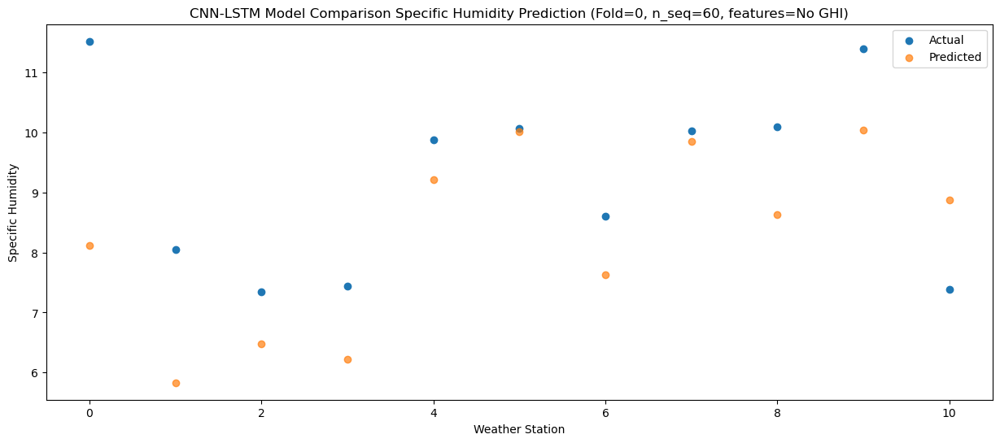

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.10  10.109193
1                 1    8.95   7.817566
2                 2    9.55   8.732214
3                 3    8.65   7.977280
4                 4    9.64  10.716593
5                 5   14.40  12.496221
6                 6   12.22  10.027526
7                 7   13.39  12.369846
8                 8   13.75  10.819660
9                 9   14.97  12.657812
10               10    9.88  11.626707


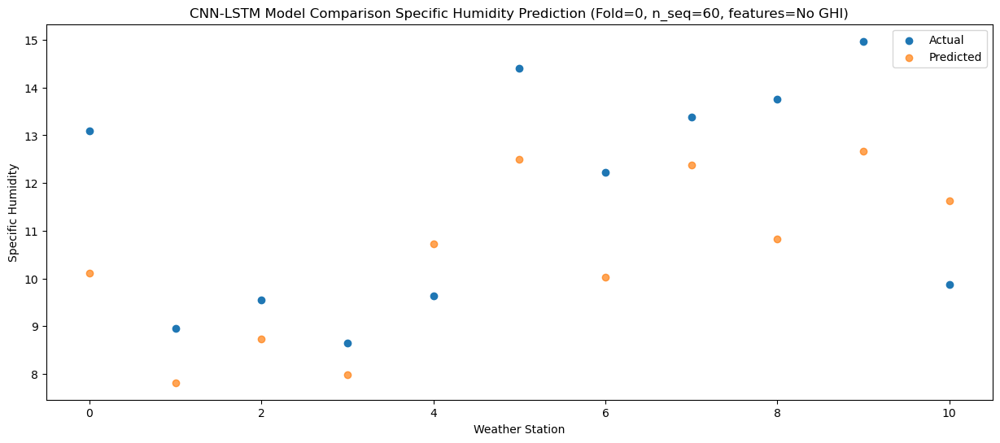

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.68  10.007977
1                 1    8.38   7.621059
2                 2    8.85   8.589267
3                 3    7.93   7.799910
4                 4   10.73  10.641392
5                 5   12.61  12.383930
6                 6   10.87   9.918115
7                 7   12.32  12.290543
8                 8   12.78  10.780832
9                 9   13.43  12.677511
10               10   10.87  11.746798


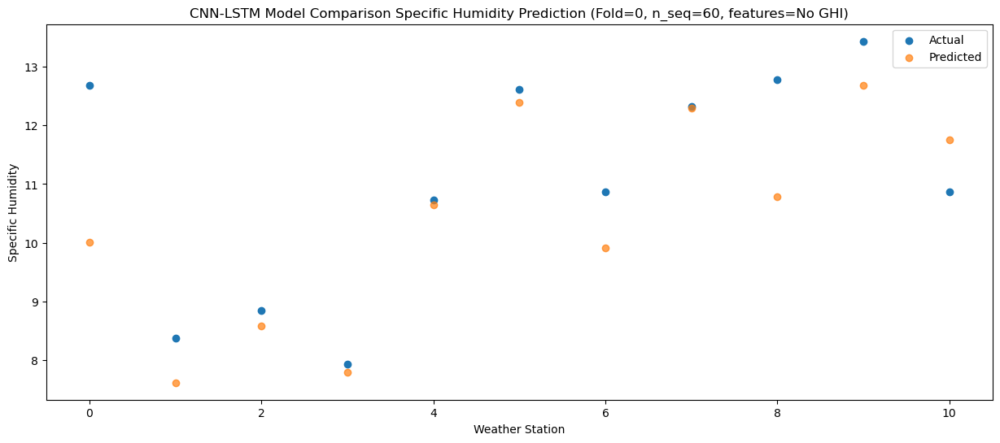

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    8.13   6.332733
1                 1    5.32   4.387613
2                 2    5.12   5.286571
3                 3    4.55   4.290250
4                 4    7.90   6.858192
5                 5    9.91   9.249211
6                 6    7.43   6.707158
7                 7    9.53   9.065797
8                 8    8.33   7.023920
9                 9   10.37   9.247779
10               10    8.27   8.363401


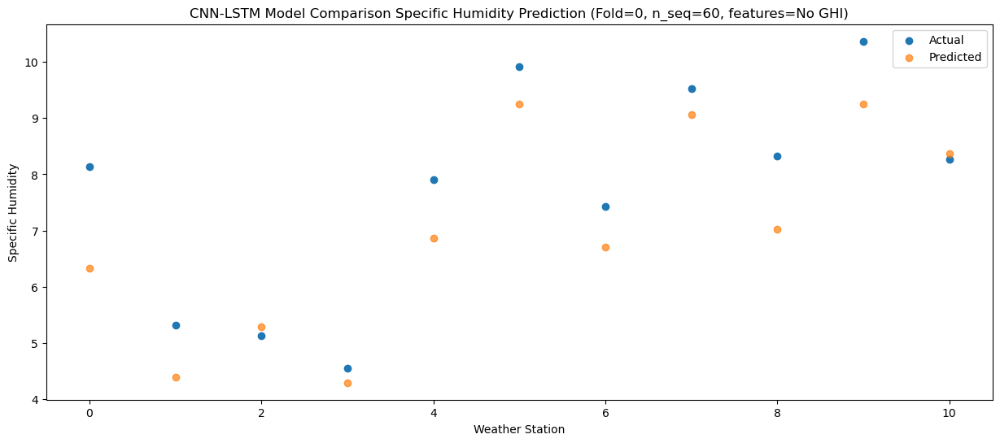

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.85   1.267004
1                 1    0.18  -0.493681
2                 2    0.12   0.448158
3                 3   -0.55  -0.781613
4                 4    3.10   1.880654
5                 5    5.27   4.648764
6                 6    2.87   2.037826
7                 7    5.11   4.442451
8                 8    3.10   1.997075
9                 9    4.58   4.590743
10               10    3.25   3.921036


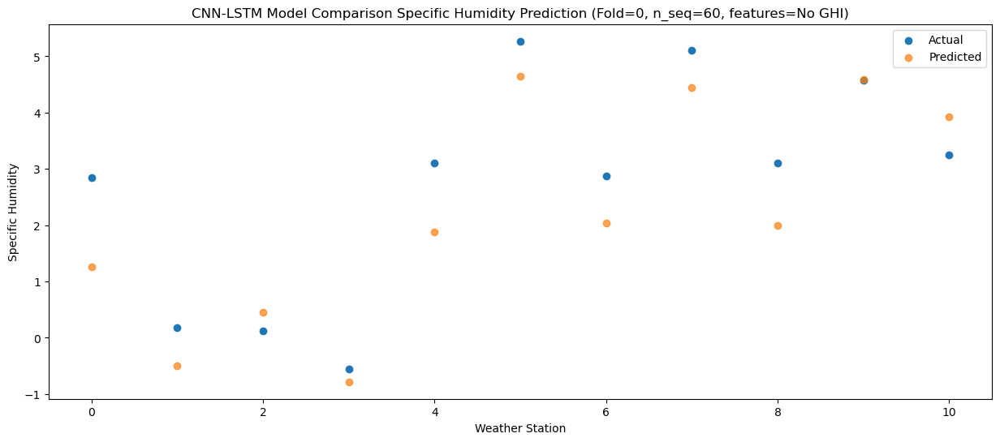

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.31   0.631017
1                 1   -0.02  -0.812934
2                 2   -0.20  -0.081766
3                 3   -1.07  -1.130156
4                 4    3.09   1.181068
5                 5    4.61   3.993493
6                 6    2.27   1.383147
7                 7    4.41   3.695301
8                 8    2.10   1.137747
9                 9    3.86   3.582598
10               10    2.11   2.679859


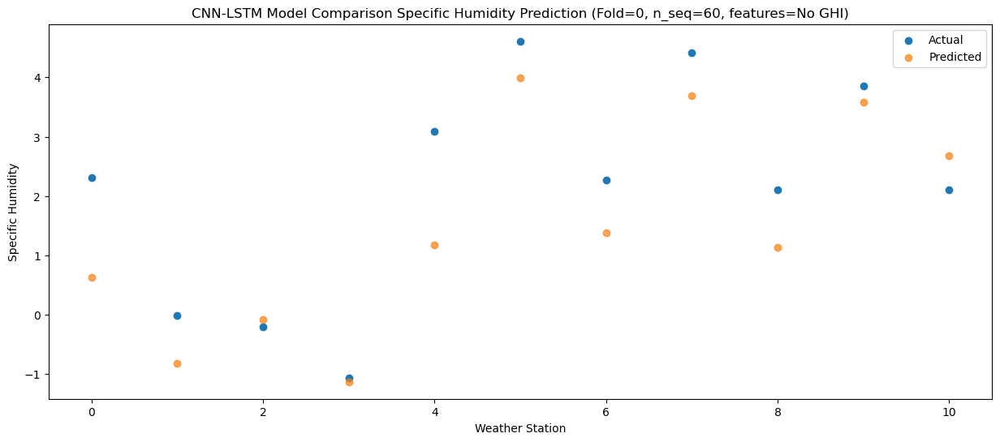

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.85  -1.164883
1                 1   -1.22  -2.877232
2                 2   -1.53  -2.073416
3                 3   -1.57  -3.067583
4                 4    2.01  -0.396597
5                 5    1.26   1.989430
6                 6    0.09  -0.579411
7                 7    2.07   1.764323
8                 8    1.17  -0.554815
9                 9    2.93   1.855798
10               10    0.94   1.076755


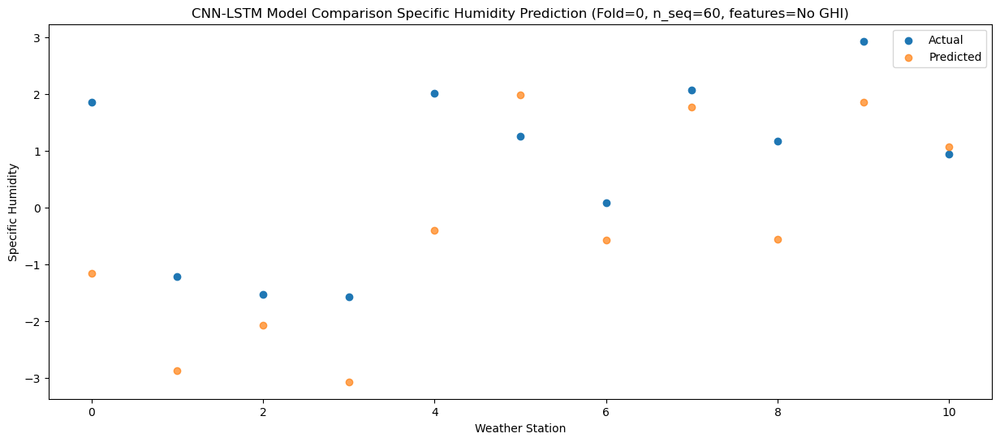

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.45  -1.212673
1                 1   -1.13  -3.058733
2                 2   -1.16  -2.048927
3                 3   -1.38  -3.339537
4                 4    1.25  -0.635642
5                 5    2.01   2.174139
6                 6    0.95  -0.436335
7                 7    3.00   1.998955
8                 8    1.77  -0.433275
9                 9    3.54   2.223677
10               10    1.34   1.592492


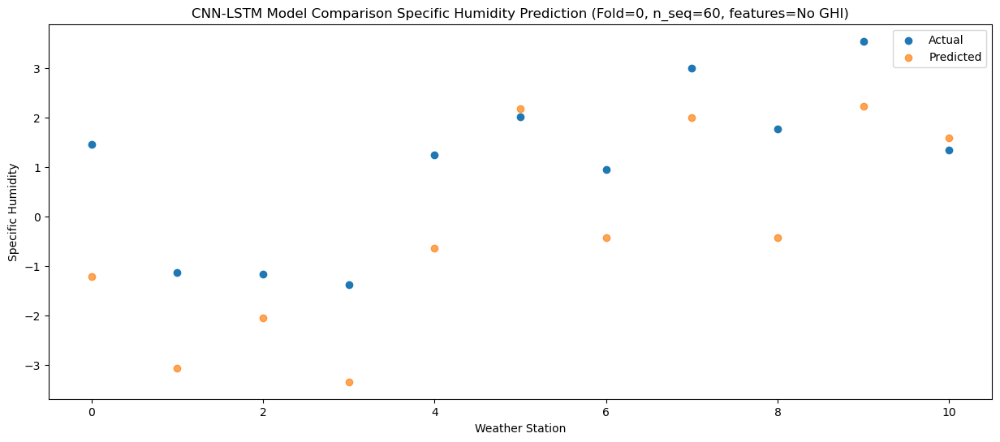

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.07  -0.499595
1                 1    0.56  -1.849772
2                 2   -0.05  -1.225567
3                 3   -0.71  -2.143306
4                 4    1.59   0.173808
5                 5    2.94   2.755457
6                 6    1.63   0.180723
7                 7    3.36   2.441055
8                 8    1.84  -0.088726
9                 9    3.31   2.272793
10               10    0.78   1.297047


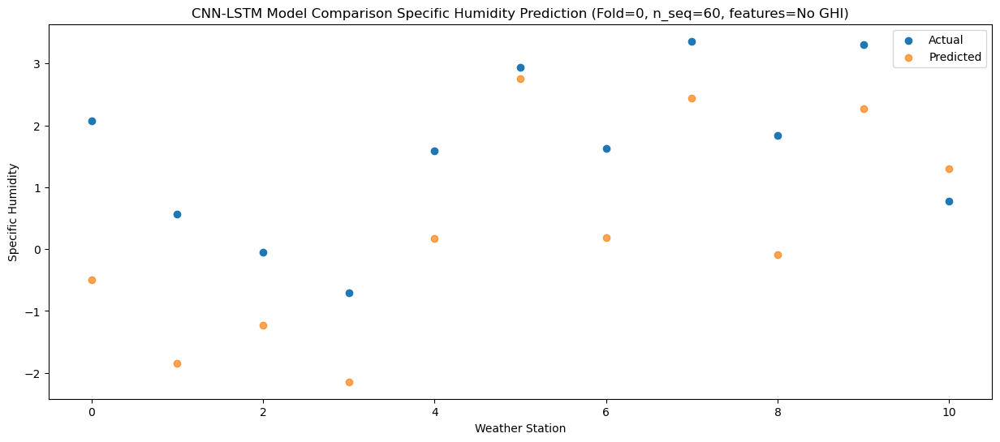

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.67  -0.127625
1                 1    0.94  -1.700179
2                 2   -0.69  -1.074547
3                 3    0.37  -1.829349
4                 4    3.78   0.792375
5                 5    2.72   2.848364
6                 6    1.22   0.314811
7                 7    3.28   2.576093
8                 8    2.28   0.302574
9                 9    3.41   2.503719
10               10    1.24   1.555324


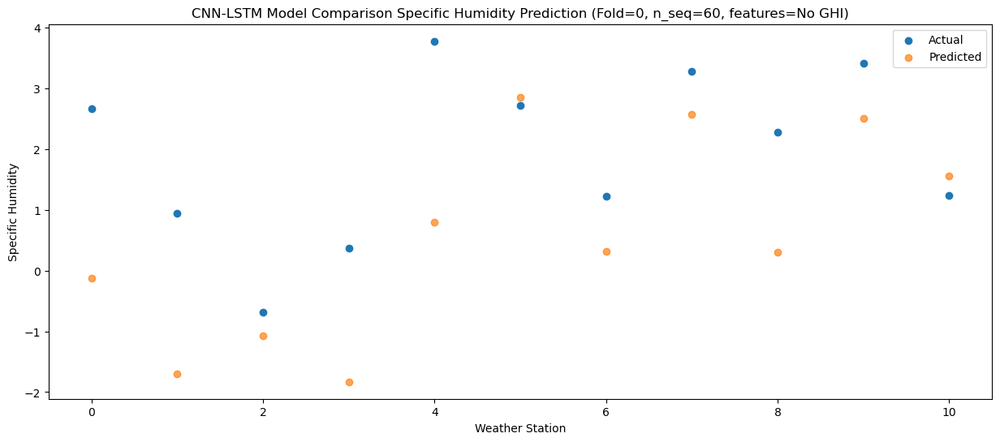

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    3.66   0.982602
1                 1    1.73  -0.589396
2                 2    0.75   0.210106
3                 3    0.77  -0.868405
4                 4    4.54   1.576912
5                 5    5.40   4.313967
6                 6    3.43   1.712578
7                 7    5.56   4.057929
8                 8    3.50   1.525715
9                 9    5.14   4.020437
10               10    2.88   3.172141


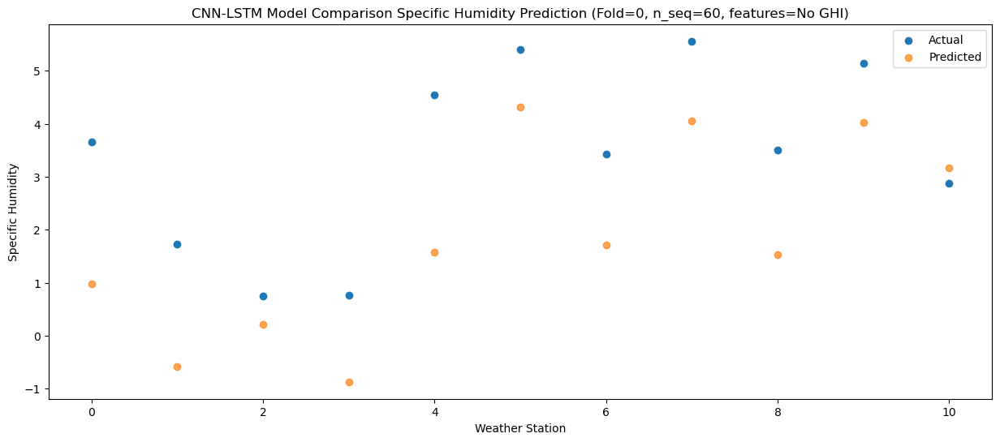

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.34   3.990691
1                 1    3.92   1.625081
2                 2    3.53   2.295875
3                 3    3.62   2.073807
4                 4    8.48   5.523236
5                 5    6.16   5.920444
6                 6    5.02   3.551583
7                 7    6.88   5.791688
8                 8    6.99   4.489817
9                 9    7.58   6.012051
10               10    4.09   4.994085


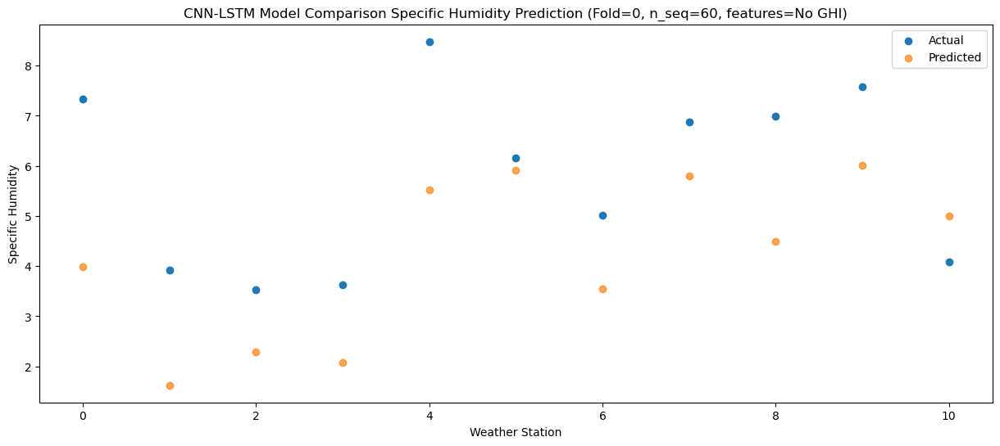

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.13   7.421011
1                 1    7.25   4.970144
2                 2    6.11   5.705937
3                 3    7.77   5.434910
4                 4   12.60   8.762591
5                 5   10.06   9.298193
6                 6    7.75   6.926902
7                 7    9.50   9.182226
8                 8    9.27   7.949055
9                 9   10.20   9.399711
10               10    7.10   8.297469


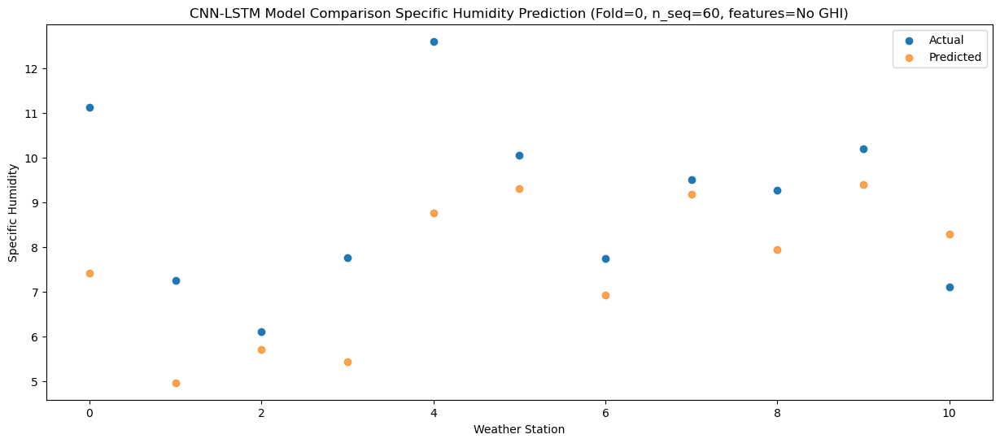

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.42  10.207731
1                 1    8.92   7.662126
2                 2    8.97   8.824732
3                 3    8.80   7.797119
4                 4   11.18  10.696111
5                 5   14.41  12.749121
6                 6   11.49  10.256649
7                 7   13.85  12.705967
8                 8   12.82  11.082704
9                 9   14.02  13.123714
10               10   10.93  12.219261


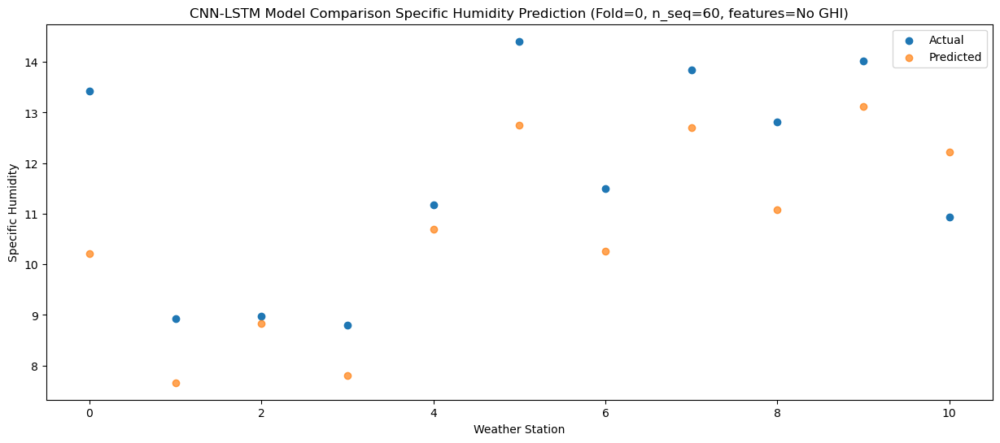

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.04   9.825199
1                 1    9.70   7.393310
2                 2    9.06   8.456331
3                 3    8.55   7.507616
4                 4    9.36  10.442583
5                 5   13.52  12.328826
6                 6   11.12   9.867324
7                 7   12.79  12.265280
8                 8   12.82  10.664850
9                 9   12.72  12.655707
10               10   10.18  11.741509


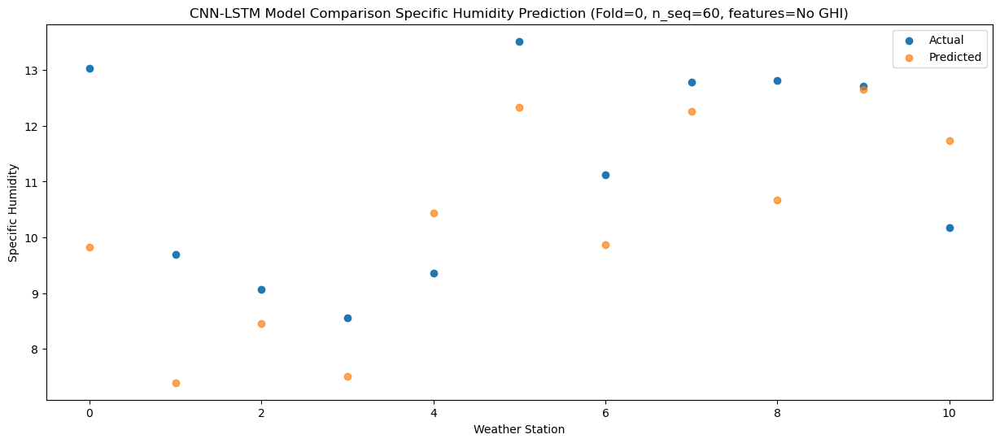

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.07   6.323899
1                 1    5.68   3.969605
2                 2    5.48   5.154653
3                 3    6.37   3.917040
4                 4    9.32   6.840859
5                 5   10.40   9.250039
6                 6    8.18   6.711858
7                 7    9.99   9.186277
8                 8    8.75   7.244170
9                 9   10.00   9.595419
10               10    8.87   8.870669


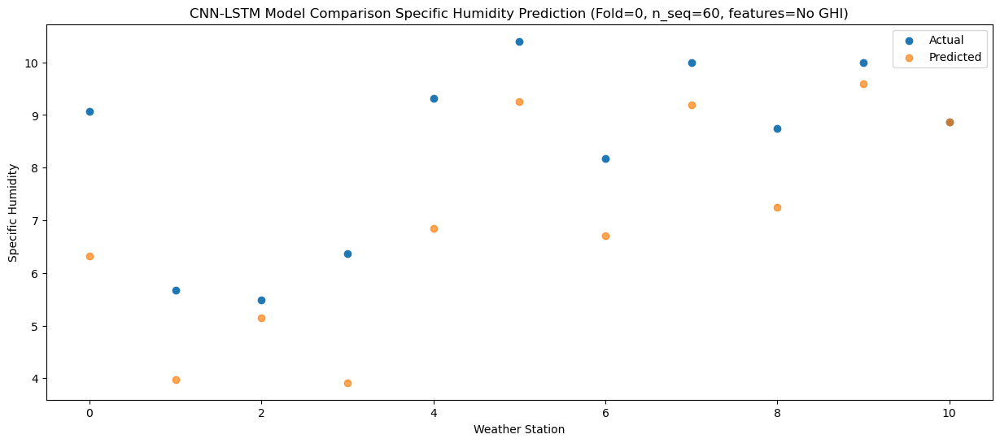

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.04   2.315223
1                 1    0.98  -0.040583
2                 2    1.57   1.239019
3                 3    1.80  -0.183288
4                 4    5.57   2.890286
5                 5    6.00   5.523419
6                 6    3.92   2.937264
7                 7    6.24   5.474295
8                 8    4.69   3.322205
9                 9    6.76   5.933200
10               10    5.11   5.385726


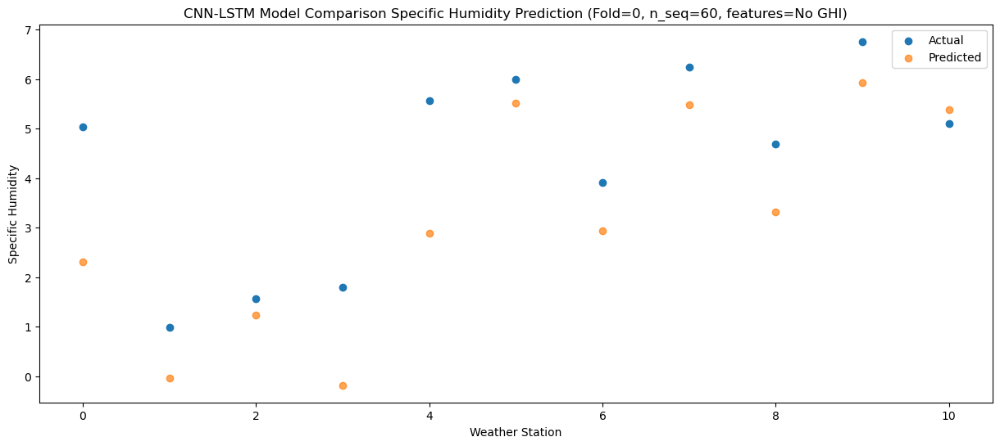

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.86  -0.970307
1                 1   -1.20  -3.147148
2                 2   -0.96  -2.054850
3                 3   -1.19  -3.259947
4                 4    2.77  -0.107697
5                 5    2.98   2.165017
6                 6    0.59  -0.404316
7                 7    2.72   2.055818
8                 8    2.03  -0.120793
9                 9    3.41   2.370596
10               10    1.70   1.775598


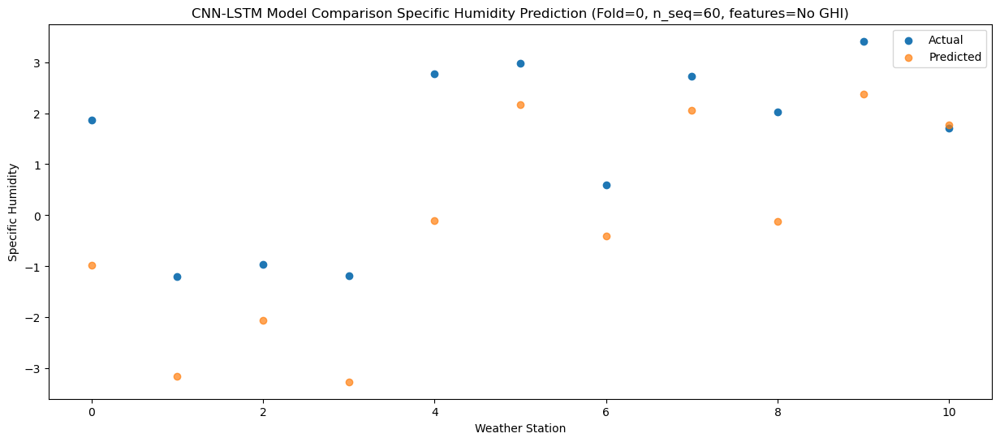

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.58  -2.094143
1                 1   -2.64  -4.554216
2                 2   -1.77  -3.068998
3                 3   -2.59  -4.823644
4                 4    0.91  -1.575876
5                 5    2.16   1.476859
6                 6    0.52  -1.174754
7                 7    2.92   1.474689
8                 8    1.42  -0.892462
9                 9    3.60   2.084741
10               10    2.23   1.823968


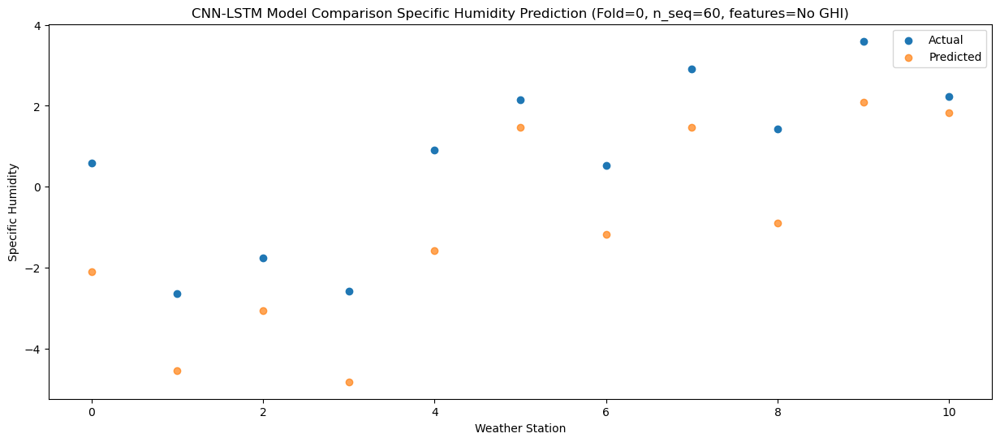

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.24  -3.130385
1                 1   -3.42  -5.316016
2                 2   -2.57  -3.931958
3                 3   -3.51  -5.705870
4                 4   -0.27  -2.602601
5                 5    1.37   0.650016
6                 6   -0.15  -2.028130
7                 7    2.23   0.584256
8                 8    0.24  -2.023731
9                 9    2.63   1.041490
10               10    0.71   0.767435


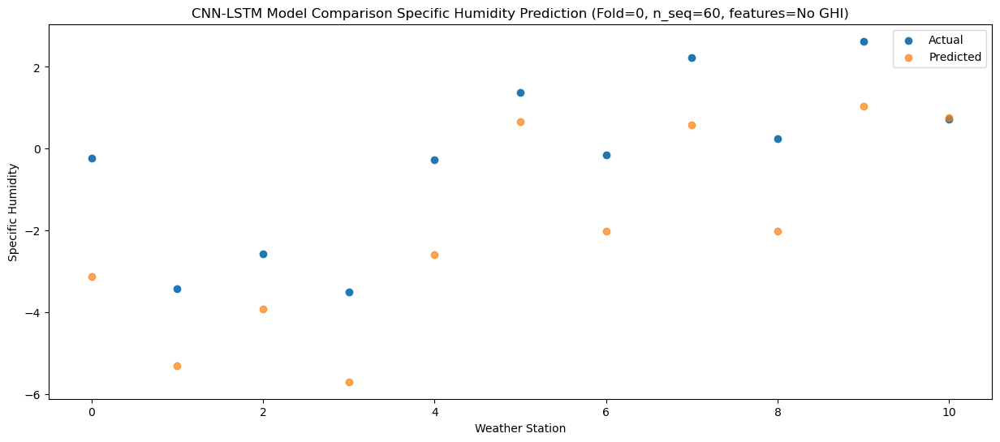

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.66  -2.367796
1                 1   -2.20  -4.957288
2                 2   -1.93  -3.578773
3                 3   -1.73  -5.032470
4                 4    2.30  -1.512292
5                 5    1.27   0.815043
6                 6    0.01  -1.765427
7                 7    2.26   0.823682
8                 8    2.00  -1.232632
9                 9    2.98   1.444309
10               10    1.24   1.132138


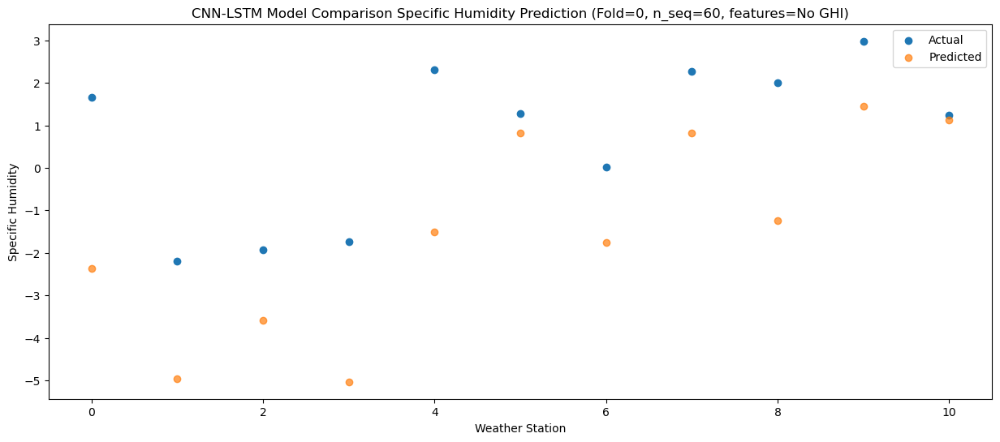

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.92  -0.807821
1                 1   -0.35  -2.921886
2                 2   -0.30  -1.846996
3                 3    0.06  -3.067404
4                 4    4.04   0.007069
5                 5    3.19   2.360727
6                 6    1.46  -0.212557
7                 7    3.40   2.232235
8                 8    2.87   0.024898
9                 9    4.11   2.497474
10               10    1.93   1.863621


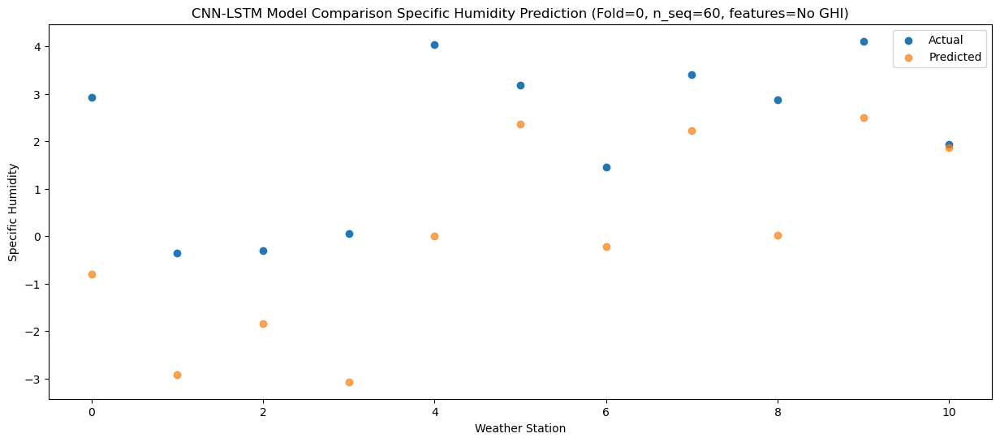

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.23   1.312850
1                 1    1.56  -1.270103
2                 2    1.44  -0.021696
3                 3    2.11  -1.207596
4                 4    6.28   2.137158
5                 5    4.53   4.113986
6                 6    3.52   1.595994
7                 7    5.42   4.097820
8                 8    5.10   2.305762
9                 9    6.48   4.609676
10               10    3.49   3.992072


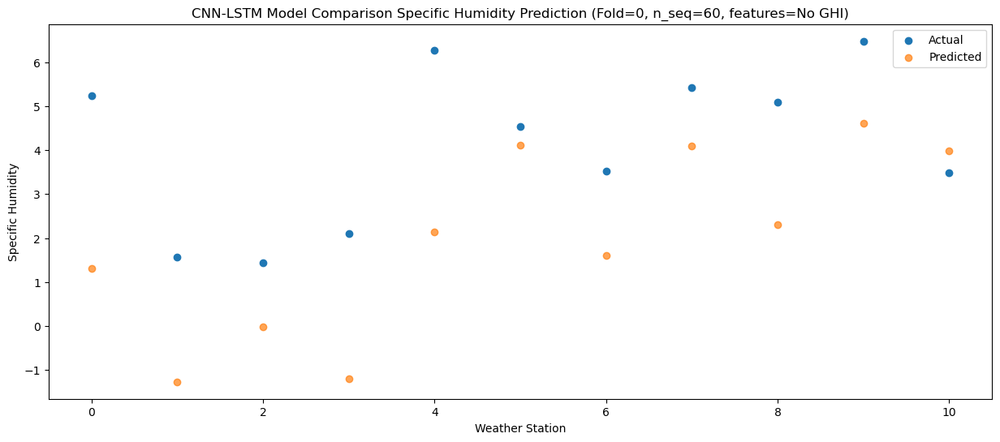

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.70   5.738838
1                 1    6.14   3.215403
2                 2    5.19   4.320687
3                 3    6.68   3.380256
4                 4   10.53   6.464434
5                 5    8.59   8.241334
6                 6    7.43   5.761097
7                 7    9.24   8.187666
8                 8    9.38   6.580423
9                 9   10.28   8.569440
10               10    6.54   7.687429


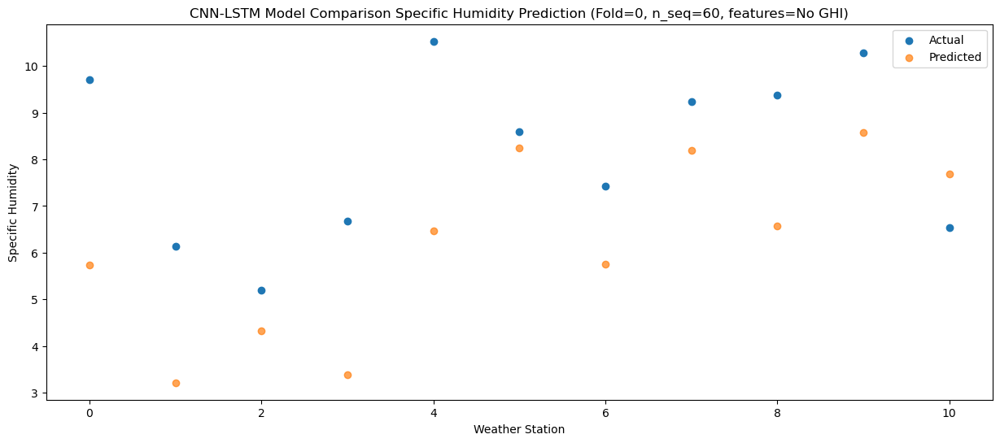

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.09   8.258459
1                 1    7.74   5.000964
2                 2    6.32   6.396339
3                 3    8.19   5.454972
4                 4   12.18   9.179838
5                 5   10.56  10.316648
6                 6    9.25   7.895146
7                 7   10.93  10.437238
8                 8   11.80   9.394849
9                 9   11.35  11.245369
10               10    9.04  10.562780


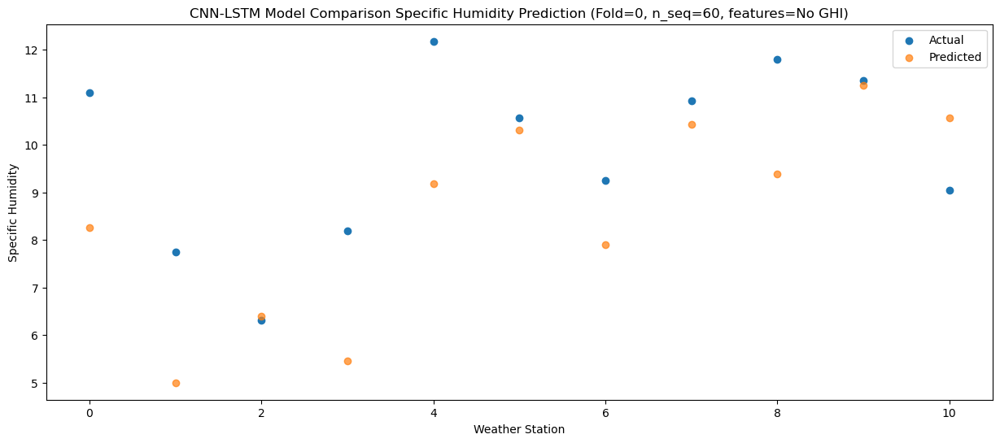

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.38   9.418328
1                 1    9.91   6.629287
2                 2    9.55   8.068497
3                 3    9.59   6.694648
4                 4   11.92   9.776998
5                 5   13.35  12.198936
6                 6   11.78   9.659070
7                 7   13.82  12.234869
8                 8   12.98  10.537862
9                 9   12.85  12.852279
10               10   10.11  12.185617


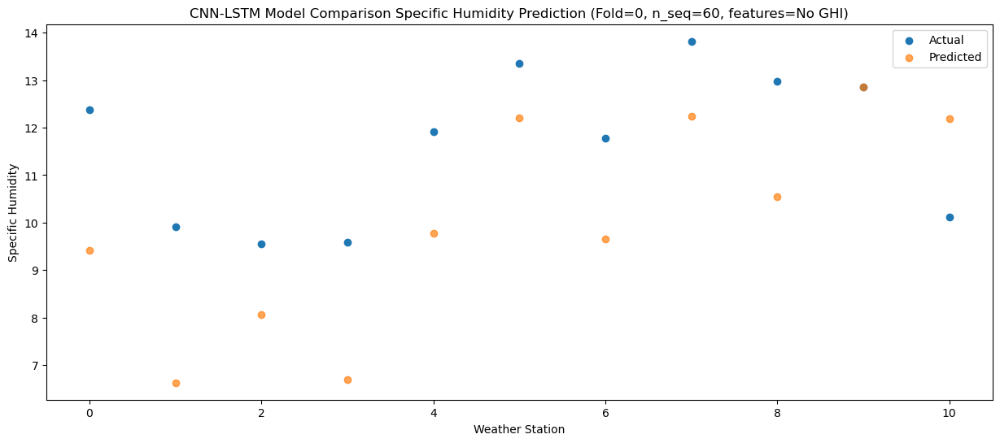

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.55   8.477745
1                 1    8.41   5.527623
2                 2    7.86   7.018924
3                 3    8.45   5.657003
4                 4   11.57   8.946510
5                 5   12.34  11.160298
6                 6   10.62   8.634864
7                 7   12.39  11.235197
8                 8   11.31   9.665905
9                 9   12.05  11.950825
10               10    9.87  11.349362


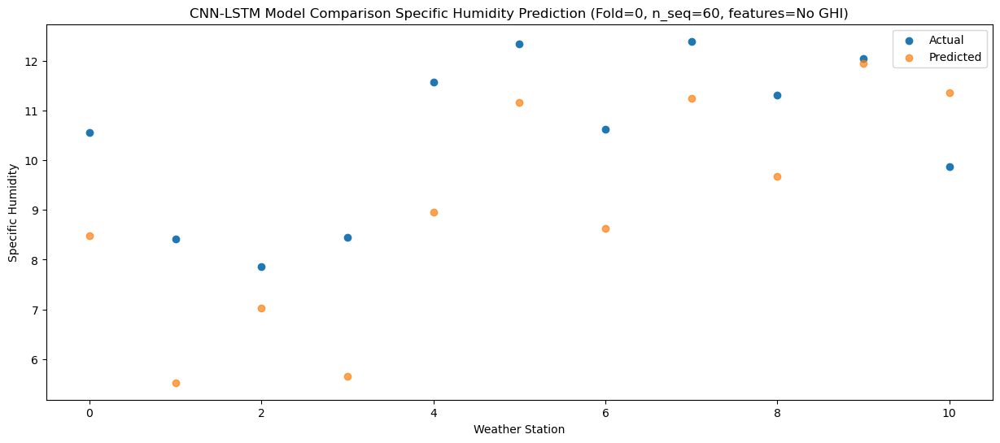

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.08   6.248635
1                 1    7.54   4.141126
2                 2    6.17   5.271153
3                 3    6.89   3.964571
4                 4    9.08   6.615339
5                 5   10.39   9.421952
6                 6    8.89   6.830876
7                 7   10.80   9.295095
8                 8    9.27   7.086636
9                 9    9.70   9.524974
10               10    8.16   8.743205


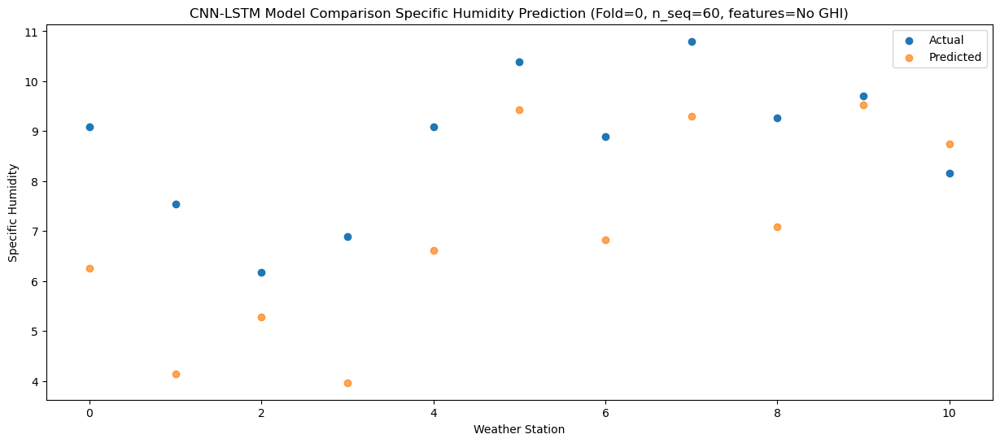

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.70   1.792083
1                 1    2.14  -0.385426
2                 2    2.04   0.853784
3                 3    1.70  -0.617933
4                 4    5.47   2.282533
5                 5    5.10   5.164687
6                 6    4.19   2.543143
7                 7    5.91   5.070013
8                 8    4.67   2.744679
9                 9    6.17   5.411821
10               10    3.96   4.821096


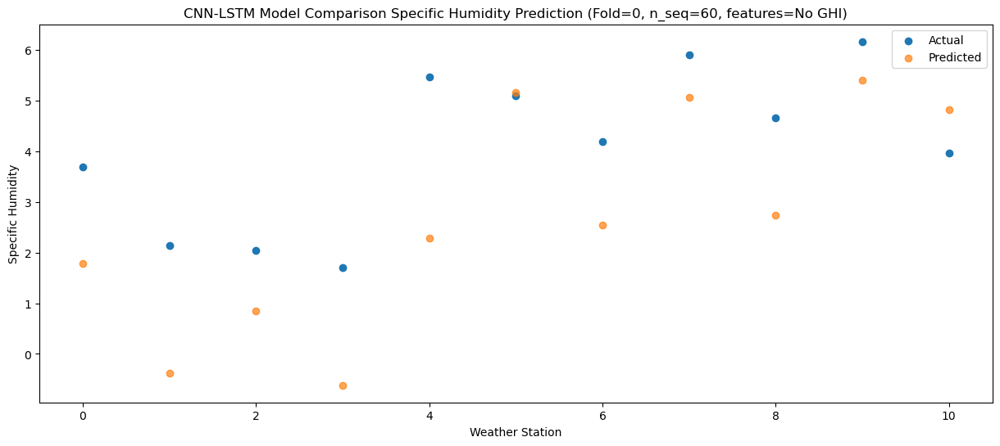

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d (MaxPooling1D  (None, 1, 1024)          0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 1, 1024)           0         
                                                                 
 lstm (LSTM)                 (None, 1, 512)            3147776   
                                                                 
 dropout_1 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_1 (LSTM)               (None, 512)               2099200   
                                                        

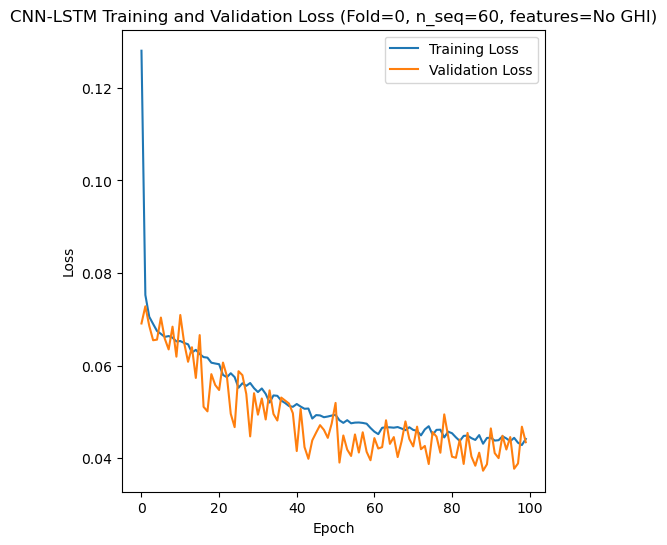

Epoch 1/100
84/84 [==============================] - 33s 138ms/step - loss: 0.1242 - accuracy: 0.2976 - mae: 0.1063 - rmse: 0.1242 - mape: 22.5673 - pearson: 0.6051 - val_loss: 0.0753 - val_accuracy: 0.0000e+00 - val_mae: 0.0607 - val_rmse: 0.0753 - val_mape: 13.1312 - val_pearson: 0.7687
Epoch 2/100
84/84 [==============================] - 5s 63ms/step - loss: 0.0754 - accuracy: 0.3452 - mae: 0.0597 - rmse: 0.0754 - mape: 13.4157 - pearson: 0.7363 - val_loss: 0.0636 - val_accuracy: 0.5000 - val_mae: 0.0486 - val_rmse: 0.0636 - val_mape: 11.3285 - val_pearson: 0.7744
Epoch 3/100
84/84 [==============================] - 5s 62ms/step - loss: 0.0706 - accuracy: 0.4286 - mae: 0.0560 - rmse: 0.0706 - mape: 12.6732 - pearson: 0.7602 - val_loss: 0.0683 - val_accuracy: 0.5000 - val_mae: 0.0536 - val_rmse: 0.0683 - val_mape: 11.9233 - val_pearson: 0.7487
Epoch 4/100
84/84 [==============================] - 5s 63ms/step - loss: 0.0669 - accuracy: 0.5357 - mae: 0.0528 - rmse: 0.0669 - mape: 12.00

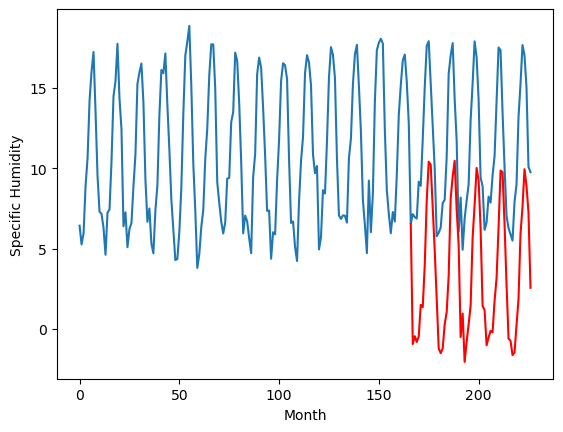

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.00		-0.92		0.08
-0.95		-0.60		0.35
-1.20		-0.92		0.28
-0.68		-0.69		-0.01
1.55		1.34		-0.21
-0.04		1.27		1.31
2.97		4.15		1.18
6.77		8.17		1.40
8.81		10.76		1.95
8.86		10.11		1.25
5.96		7.34		1.38
3.29		4.33		1.04
0.23		1.70		1.47
-2.36		-1.09		1.27
-2.34		-1.42		0.92
-2.15		-1.36		0.79
-0.62		0.35		0.97
-0.26		1.19		1.45
2.66		3.65		0.99
6.64		8.43		1.79
8.51		9.83		1.32
8.72		10.74		2.02
5.77		7.45		1.68
3.73		5.29		1.56
-1.86		-0.32		1.54
0.31		0.85		0.54
-2.69		-1.96		0.73
-1.74		-0.85		0.89
-1.06		0.30		1.36
0.00		1.60		1.60
4.17		5.93		1.76
6.57		8.04		1.47
9.24		10.20		0.96
8.83		9.54		0.71
5.47		6.38		0.91
0.58		1.52		0.94
0.10		1.17		1.07
-1.49		-0.92		0.57
-1.08		-0.45		0.63
0.04		-0.19		-0.23
-0.83		-0.15		0.68
0.77		1.72		0.95
3.51		3.59		0.08
5.86		6.75		0.89
8.82		10.18		1.36
8.95		10.06		1.11
5.84		6.79		0.95
1.99		3.07		1.08
-1.02		-0.30		0.72
-1.60		-0.41		1.19
-2.37		-1.3

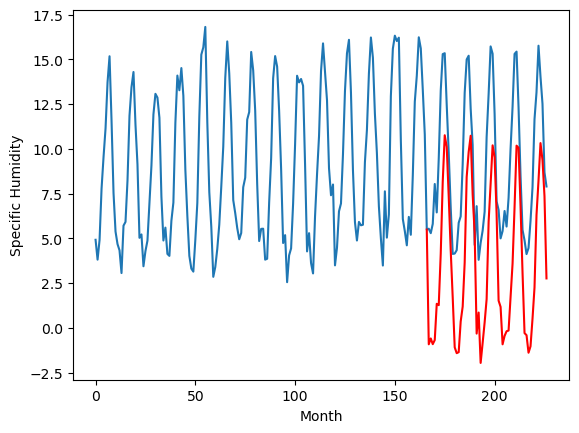

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.90		-2.20		-0.30
-0.99		-1.87		-0.88
-1.50		-2.16		-0.66
-1.11		-1.92		-0.81
2.05		0.50		-1.55
0.43		0.29		-0.14
3.20		3.11		-0.09
7.05		6.97		-0.08
9.60		9.41		-0.19
9.12		8.74		-0.38
6.17		6.21		0.04
3.41		3.05		-0.36
0.23		0.32		0.09
-2.54		-2.69		-0.15
-2.39		-2.87		-0.48
-2.39		-2.75		-0.36
0.23		-0.83		-1.06
-0.06		-0.17		-0.11
2.78		2.58		-0.20
7.30		7.15		-0.15
8.89		8.47		-0.42
9.11		9.12		0.01
6.35		5.94		-0.41
3.60		3.60		-0.00
-1.90		-1.87		0.03
0.74		-0.32		-1.06
-3.14		-3.55		-0.41
-2.11		-2.42		-0.31
-1.32		-1.23		0.09
0.44		0.31		-0.13
4.80		4.65		-0.15
7.89		6.85		-1.04
9.52		8.70		-0.82
8.65		7.98		-0.67
5.14		4.74		-0.40
0.03		-0.18		-0.21
-0.34		-0.49		-0.15
-1.03		-2.45		-1.42
-1.06		-2.12		-1.06
-0.01		-1.59		-1.58
-0.48		-1.43		-0.95
0.88		0.17		-0.71
4.18		2.54		-1.64
6.83		5.60		-1.23
9.97		8.51		-1.46
9.90		8.61		-1.29
6.09		5.12		-0.97
1.58		1.30		-0.28
-0.97		-1

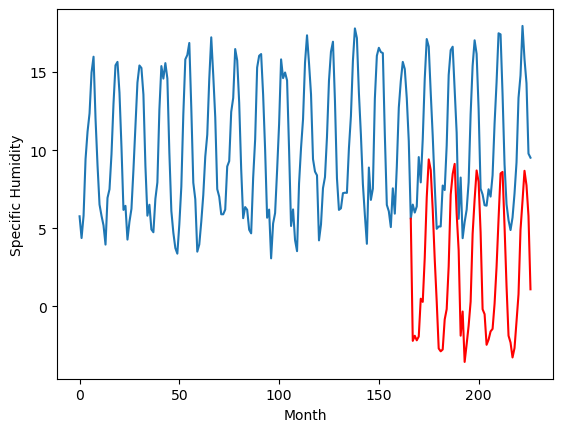

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.51		-1.32		0.19
-2.71		-1.28		1.43
-1.81		-1.36		0.45
-2.51		-1.36		1.15
1.85		1.50		-0.35
1.51		1.33		-0.18
3.49		4.15		0.66
5.61		7.31		1.70
8.12		9.41		1.29
7.01		8.16		1.15
5.43		6.08		0.65
2.03		2.40		0.37
-0.07		0.41		0.48
-2.62		-2.20		0.42
-2.96		-2.11		0.85
-2.89		-2.33		0.56
-0.25		-0.06		0.19
1.09		0.37		-0.72
4.98		3.62		-1.36
8.17		7.32		-0.85
8.65		8.53		-0.12
8.99		8.40		-0.59
5.90		5.37		-0.53
3.65		2.93		-0.72
-0.80		-1.17		-0.37
2.12		0.06		-2.06
-3.53		-3.04		0.49
-3.36		-2.36		1.00
-1.68		-1.04		0.64
2.48		0.90		-1.58
6.29		4.86		-1.43
7.34		7.31		-0.03
8.26		8.21		-0.05
8.51		7.71		-0.80
5.22		4.43		-0.79
0.26		0.03		-0.23
-0.24		-0.75		-0.51
-1.05		-2.08		-1.03
-1.47		-2.05		-0.58
-0.69		-1.52		-0.83
0.86		-0.84		-1.70
1.23		0.03		-1.20
5.01		3.93		-1.08
8.41		6.44		-1.97
8.97		7.77		-1.20
7.30		8.43		1.13
6.10		4.85		-1.25
2.68		1.30		-1.38
-0.65		-1.36		-0.71
-2.29	

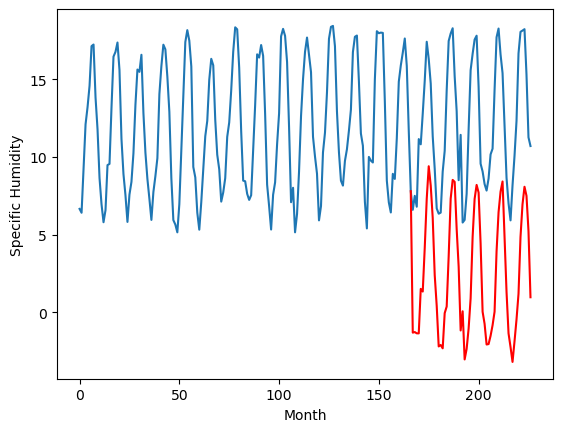

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.21		2.84		0.63
0.97		2.84		1.87
1.88		2.77		0.89
1.20		2.74		1.54
5.93		5.66		-0.27
5.62		5.49		-0.13
7.74		8.36		0.62
10.03		11.52		1.49
12.63		13.65		1.02
11.18		12.30		1.12
9.69		10.21		0.52
5.84		6.43		0.59
3.36		4.52		1.16
0.54		1.94		1.40
0.29		2.03		1.74
0.33		1.77		1.44
3.05		4.11		1.06
4.31		4.54		0.23
8.34		7.86		-0.48
11.75		11.55		-0.20
11.93		12.76		0.83
11.97		12.59		0.62
8.87		9.50		0.63
6.92		7.06		0.14
2.33		2.98		0.65
5.26		4.19		-1.07
-0.28		1.09		1.37
-0.08		1.74		1.82
1.62		3.07		1.45
5.72		5.07		-0.65
9.60		9.06		-0.54
10.72		11.53		0.81
11.47		12.37		0.90
11.85		11.89		0.04
8.50		8.57		0.07
3.60		4.14		0.54
3.22		3.36		0.14
2.40		2.05		-0.35
1.92		2.06		0.14
2.52		2.59		0.07
4.22		3.31		-0.91
4.67		4.14		-0.53
8.34		8.18		-0.16
11.60		10.70		-0.90
11.68		11.96		0.28
10.28		12.62		2.34
9.53		9.01		-0.52
6.14		5.45		-0.69
2.80		2.80		-0.00
1.08		1.89		0.81
-0.09		0.90		

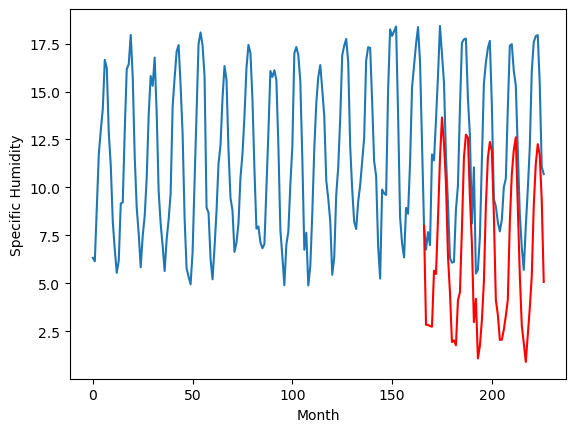

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.35		3.16		-0.19
1.87		3.05		1.18
1.59		3.04		1.45
1.77		2.79		1.02
4.44		4.83		0.39
3.43		5.11		1.68
6.11		7.61		1.50
7.93		10.11		2.18
8.92		11.73		2.81
7.69		10.56		2.87
7.26		8.57		1.31
3.75		5.33		1.58
3.19		4.20		1.01
0.75		2.59		1.84
1.58		2.73		1.15
0.95		2.18		1.23
1.74		3.86		2.12
3.04		4.32		1.28
7.35		7.02		-0.33
9.52		9.94		0.42
10.85		11.17		0.32
11.07		10.82		-0.25
7.53		8.22		0.69
4.42		6.21		1.79
2.58		3.70		1.12
1.53		3.56		2.03
0.26		1.86		1.60
0.14		2.00		1.86
0.69		3.33		2.64
2.96		4.76		1.80
4.73		7.75		3.02
7.33		10.17		2.84
8.28		10.83		2.55
10.39		10.71		0.32
9.12		7.99		-1.13
5.93		4.78		-1.15
3.06		3.19		0.13
2.39		2.32		-0.07
0.84		2.36		1.52
0.87		2.22		1.35
1.92		3.09		1.17
2.18		3.85		1.67
6.55		7.63		1.08
6.50		9.44		2.94
8.67		10.22		1.55
8.82		11.18		2.36
8.46		8.37		-0.09
6.48		5.59		-0.89
3.85		3.13		-0.72
1.98		2.70		0.72
0.83		1.86		1.03
1.24		3.11		1.87

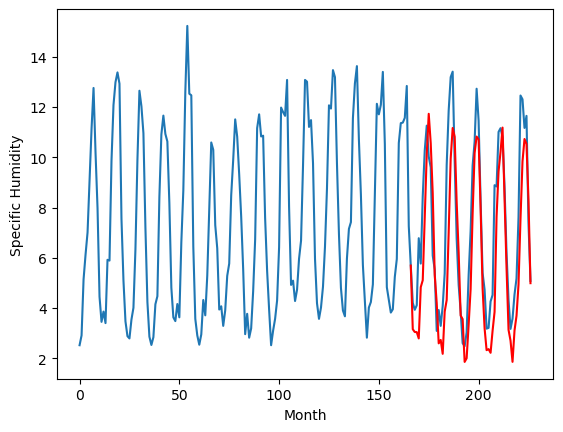

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.70		0.48		-0.22
0.73		0.83		0.10
0.31		0.50		0.19
0.79		0.73		-0.06
2.76		2.64		-0.12
2.11		2.60		0.49
5.31		5.46		0.15
8.95		9.53		0.58
11.39		12.15		0.76
11.41		11.55		0.14
8.10		8.72		0.62
5.61		5.79		0.18
2.50		3.15		0.65
-0.22		0.39		0.61
-0.33		0.03		0.36
-0.21		0.09		0.30
1.35		1.73		0.38
1.97		2.60		0.63
4.90		4.96		0.06
9.25		9.80		0.55
11.75		11.21		-0.54
12.04		12.21		0.17
8.69		8.92		0.23
6.56		6.80		0.24
0.63		1.14		0.51
2.50		2.24		-0.26
-0.50		-0.48		0.02
0.63		0.64		0.01
1.38		1.77		0.39
2.57		2.99		0.42
6.83		7.30		0.47
9.55		9.39		-0.16
12.54		11.64		-0.90
11.45		10.98		-0.47
7.97		7.86		-0.11
2.91		3.03		0.12
2.42		2.67		0.25
0.52		0.54		0.02
0.88		1.05		0.17
2.08		1.25		-0.83
1.32		1.24		-0.08
3.13		3.20		0.07
5.69		4.88		-0.81
8.27		8.06		-0.21
11.89		11.66		-0.23
11.78		11.48		-0.30
8.81		8.27		-0.54
4.56		4.57		0.01
1.21		1.15		-0.06
0.71		1.12		0.41
-0.11		0.14		0.25

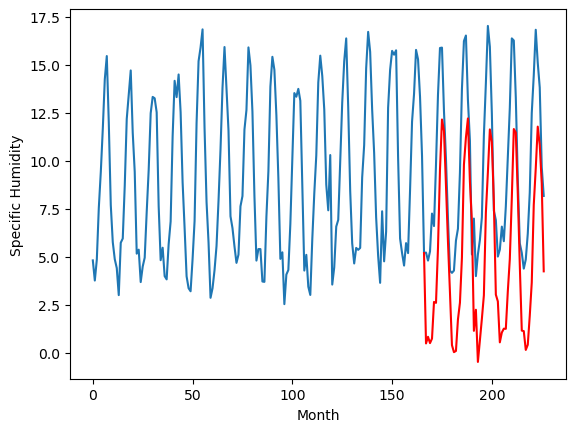

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.11		3.26		0.15
2.78		3.07		0.29
2.70		2.96		0.26
2.58		2.82		0.24
5.24		5.45		0.21
5.50		5.47		-0.03
8.40		8.91		0.51
12.23		12.51		0.28
15.31		15.30		-0.01
13.14		13.30		0.16
11.34		10.61		-0.73
6.52		6.47		-0.05
4.50		5.04		0.54
2.18		2.90		0.72
2.05		2.72		0.67
1.53		2.11		0.58
4.26		4.62		0.36
5.49		5.41		-0.08
8.70		8.72		0.02
13.46		12.95		-0.51
14.09		14.31		0.22
13.94		14.50		0.56
10.69		10.75		0.06
7.96		8.55		0.59
3.40		3.90		0.50
5.04		4.52		-0.52
1.29		1.93		0.64
1.97		2.55		0.58
3.50		3.90		0.40
5.69		5.85		0.16
10.14		10.25		0.11
12.90		12.74		-0.16
13.87		13.92		0.05
13.78		13.56		-0.22
9.82		9.96		0.14
5.28		5.20		-0.08
4.03		4.44		0.41
3.12		2.93		-0.19
3.24		3.14		-0.10
3.34		3.23		-0.11
4.10		3.88		-0.22
5.30		5.05		-0.25
9.34		8.98		-0.36
12.26		11.85		-0.41
14.83		13.97		-0.86
14.41		14.19		-0.22
9.92		10.62		0.70
6.67		7.08		0.41
3.96		4.01		0.05
2.57		3.52		0.95
1.50	

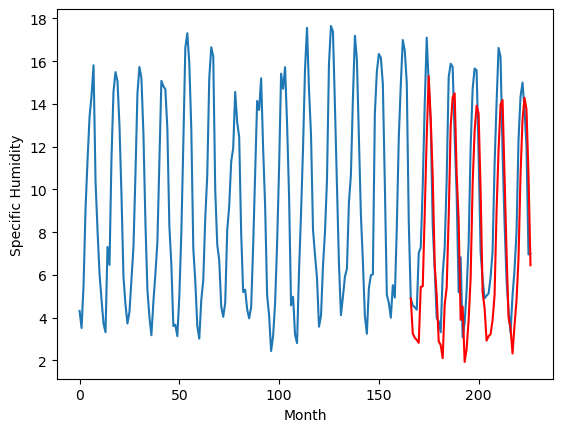

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.03		4.16		0.13
3.19		3.76		0.57
3.64		3.78		0.14
3.02		3.48		0.46
6.04		6.19		0.15
6.23		6.32		0.09
9.56		9.73		0.17
11.70		12.85		1.15
15.06		15.38		0.32
12.16		13.06		0.90
10.68		10.60		-0.08
6.01		6.24		0.23
4.90		5.39		0.49
2.62		3.66		1.04
2.78		3.62		0.84
1.97		2.75		0.78
4.58		5.35		0.77
5.74		6.03		0.29
9.96		9.52		-0.44
13.10		13.15		0.05
14.15		14.45		0.30
13.73		14.16		0.43
10.16		10.55		0.39
7.72		8.40		0.68
4.19		4.77		0.58
3.58		4.95		1.37
1.60		2.71		1.11
2.13		2.99		0.86
3.22		4.41		1.19
6.34		6.50		0.16
10.58		10.53		-0.05
12.48		13.16		0.68
11.84		13.78		1.94
12.58		13.61		1.03
9.84		10.08		0.24
5.89		5.80		-0.09
4.91		4.65		-0.26
3.17		3.54		0.37
2.69		3.59		0.90
3.02		3.54		0.52
4.44		4.51		0.07
5.66		5.29		-0.37
10.71		10.03		-0.68
13.29		12.48		-0.81
13.52		13.66		0.14
11.69		14.22		2.53
10.74		10.73		-0.01
7.31		7.48		0.17
4.64		4.71		0.07
3.59		4.06		0.47
2.28		2.89	

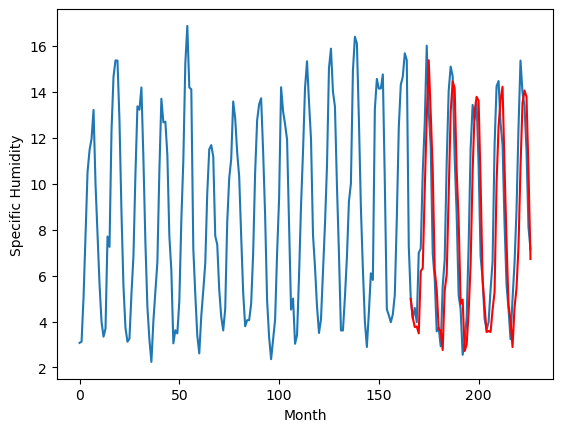

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.80		1.03		0.23
0.15		0.73		0.58
-0.00		0.74		0.74
0.01		0.41		0.40
1.90		2.52		0.62
2.06		2.87		0.81
4.88		5.77		0.89
6.59		8.44		1.85
9.48		10.42		0.94
8.16		8.70		0.54
5.37		6.44		1.07
1.85		2.78		0.93
1.53		2.03		0.50
-0.33		0.64		0.97
-0.14		0.67		0.81
-0.88		-0.13		0.75
0.94		1.85		0.91
1.11		2.45		1.34
6.26		5.38		-0.88
9.25		8.50		-0.75
10.49		9.79		-0.70
9.46		9.44		-0.02
6.50		6.42		-0.08
3.06		4.49		1.43
0.70		1.77		1.07
-0.28		1.40		1.68
-0.92		-0.16		0.76
-1.00		-0.07		0.93
-0.04		1.29		1.33
0.93		2.89		1.96
3.49		6.18		2.69
7.67		8.69		1.02
8.32		9.32		1.00
8.73		9.26		0.53
6.73		6.27		-0.46
3.34		2.82		-0.52
1.36		1.25		-0.11
0.15		0.34		0.19
-0.16		0.41		0.57
-0.30		0.12		0.42
0.49		1.05		0.56
1.01		1.85		0.84
6.74		6.01		-0.73
8.35		7.98		-0.37
10.28		8.92		-1.36
8.37		9.74		1.37
6.72		6.78		0.06
3.61		3.98		0.37
1.29		1.37		0.08
0.85		0.99		0.14
0.11		0.02		-0.09
0.78		1.4

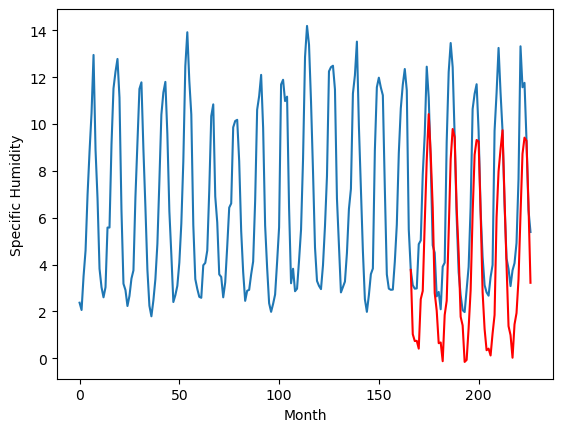

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.62		0.36		-0.26
0.61		0.56		-0.05
0.46		0.27		-0.19
0.53		0.33		-0.20
1.48		1.35		-0.13
1.77		1.67		-0.10
4.34		4.69		0.35
7.98		8.87		0.89
11.62		11.78		0.16
11.53		10.95		-0.58
8.05		7.62		-0.43
5.13		4.86		-0.27
2.75		2.86		0.11
0.59		0.92		0.33
-0.14		0.29		0.43
-0.10		0.04		0.14
1.14		1.25		0.11
2.51		2.50		-0.01
4.04		4.25		0.21
9.36		9.23		-0.13
11.22		10.82		-0.40
11.56		12.17		0.61
8.37		8.70		0.33
6.51		7.05		0.54
1.32		1.65		0.33
1.20		1.52		0.32
-0.41		-0.00		0.41
0.33		0.86		0.53
1.35		1.94		0.59
2.01		2.66		0.65
6.14		6.76		0.62
7.73		8.74		1.01
11.36		11.33		-0.03
10.93		11.00		0.07
7.68		8.08		0.40
4.24		3.69		-0.55
2.74		2.96		0.22
0.61		0.80		0.19
1.47		1.57		0.10
0.67		1.01		0.34
0.70		0.91		0.21
3.31		3.27		-0.04
3.61		4.26		0.65
6.90		7.45		0.55
11.61		11.71		0.10
9.32		11.16		1.84
8.06		8.57		0.51
5.01		5.29		0.28
1.35		1.54		0.19
1.59		2.21		0.62
0.54		1.13		0.59
0.4

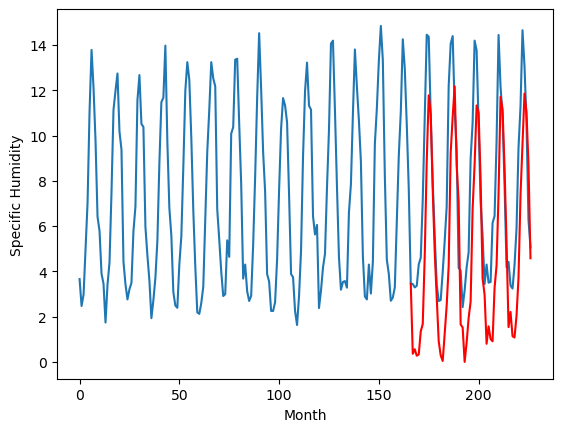

RangeIndex(start=1, stop=12, step=1)
[-1.4400000000000013, -1.0, -1.9, -1.5099999999999993, 2.209999999999999, 3.3500000000000005, 0.7000000000000002, 3.110000000000001, 4.03, 0.7999999999999996, 0.6200000000000001]
[-0.9375309371948246, -0.9237481880187985, -2.1997763442993166, -1.3157142448425292, 2.8375946807861325, 3.1575566959381103, 0.4824023437499996, 3.257743272781372, 4.156923608779907, 1.0259281587600708, 0.3576856231689449]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.44  -0.937531
1                 1   -1.00  -0.923748
2                 2   -1.90  -2.199776
3                 3   -1.51  -1.315714
4                 4    2.21   2.837595
5                 5    3.35   3.157557
6                 6    0.70   0.482402
7                 7    3.11   3.257743
8                 8    4.03   4.156924
9                 9    0.80   1.025928
10               10    0.62   0.357686


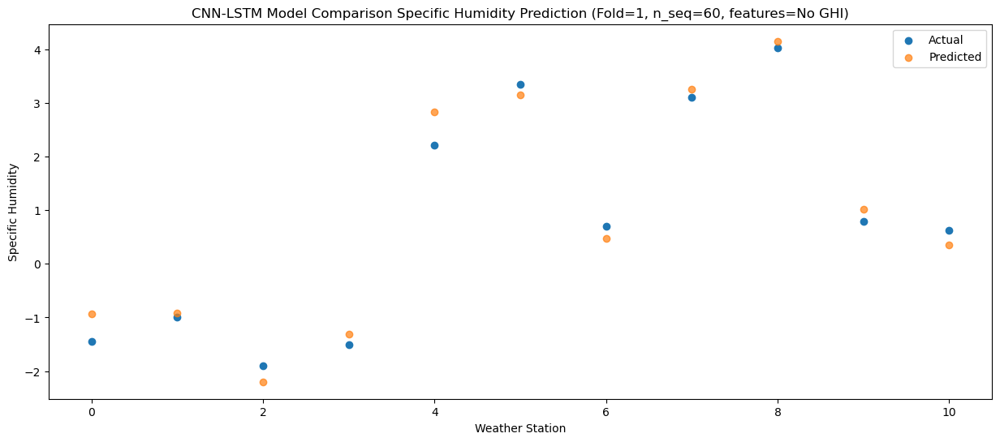

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.84  -0.445757
1                 1   -0.95  -0.595402
2                 2   -0.99  -1.871466
3                 3   -2.71  -1.276270
4                 4    0.97   2.838873
5                 5    1.87   3.045335
6                 6    0.73   0.827924
7                 7    2.78   3.065511
8                 8    3.19   3.759029
9                 9    0.15   0.734050
10               10    0.61   0.559756


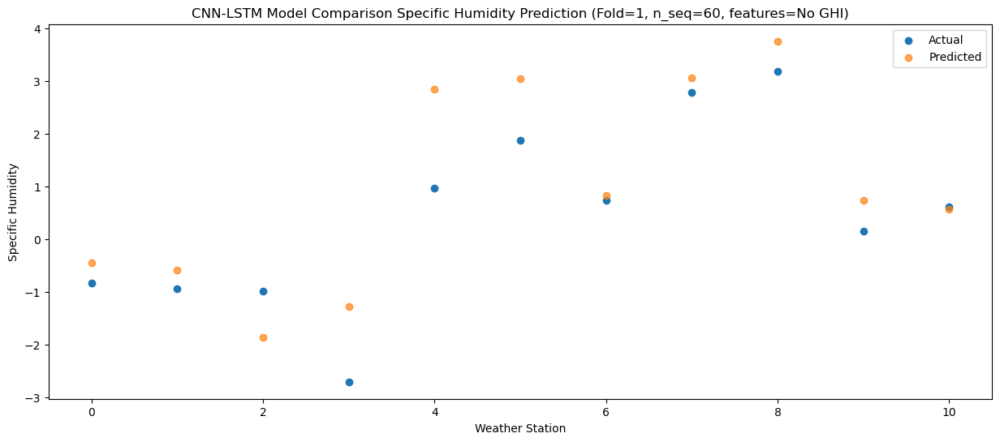

Predictions for (t+2):
    Weather_Station        Actual  Predicted
0                 0 -1.030000e+00  -0.806800
1                 1 -1.200000e+00  -0.915428
2                 2 -1.500000e+00  -2.163631
3                 3 -1.810000e+00  -1.359099
4                 4  1.880000e+00   2.771377
5                 5  1.590000e+00   3.041493
6                 6  3.100000e-01   0.498393
7                 7  2.700000e+00   2.961097
8                 8  3.640000e+00   3.784540
9                 9 -2.775558e-16   0.742139
10               10  4.600000e-01   0.272964


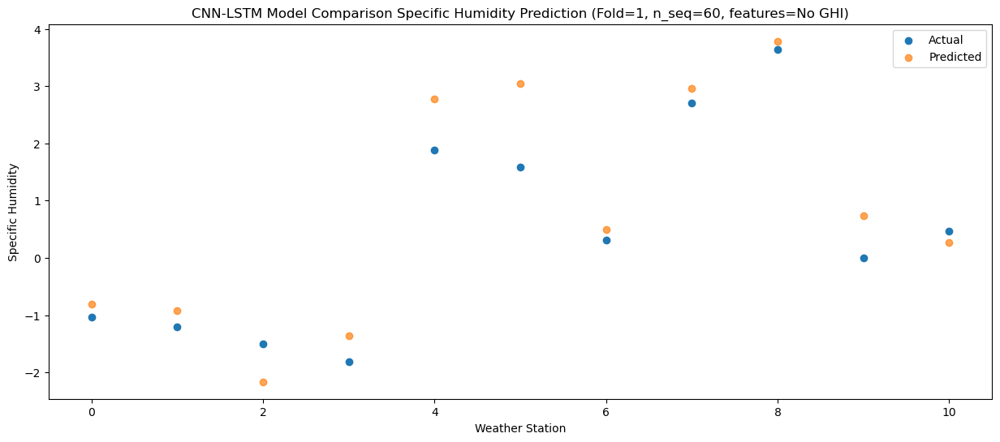

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.12  -0.463169
1                 1   -0.68  -0.685266
2                 2   -1.11  -1.921166
3                 3   -2.51  -1.362262
4                 4    1.20   2.742904
5                 5    1.77   2.788950
6                 6    0.79   0.734738
7                 7    2.58   2.824139
8                 8    3.02   3.483999
9                 9    0.01   0.409295
10               10    0.53   0.327496


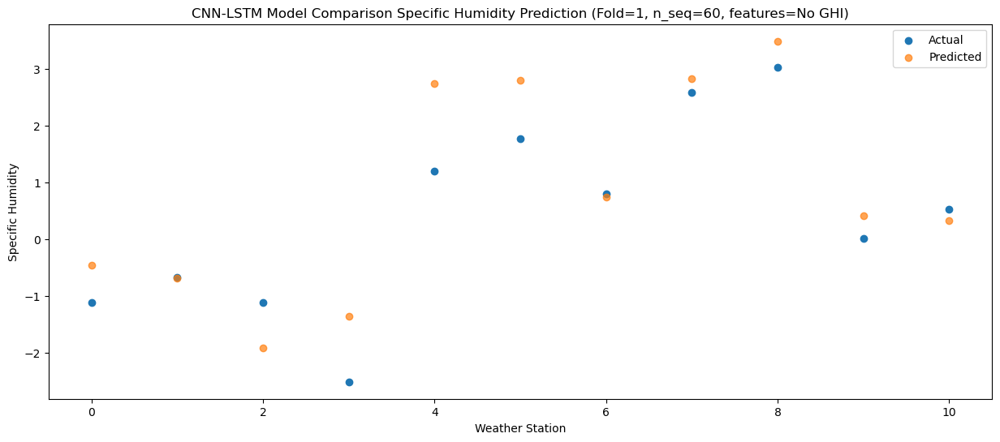

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.18   1.502146
1                 1    1.55   1.341441
2                 2    2.05   0.498135
3                 3    1.85   1.504990
4                 4    5.93   5.662907
5                 5    4.44   4.830703
6                 6    2.76   2.643094
7                 7    5.24   5.446238
8                 8    6.04   6.188799
9                 9    1.90   2.521280
10               10    1.48   1.347198


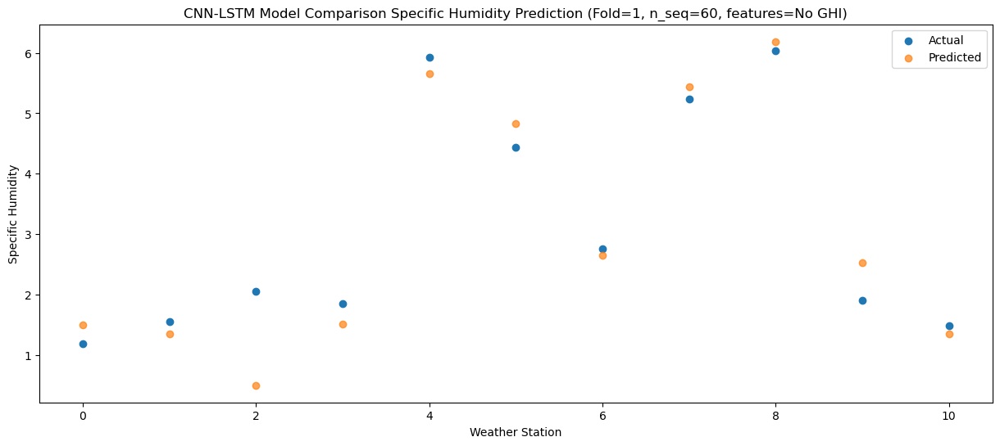

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.92   1.357989
1                 1   -0.04   1.266291
2                 2    0.43   0.294931
3                 3    1.51   1.332110
4                 4    5.62   5.488415
5                 5    3.43   5.106765
6                 6    2.11   2.597218
7                 7    5.50   5.468315
8                 8    6.23   6.323136
9                 9    2.06   2.871316
10               10    1.77   1.673264


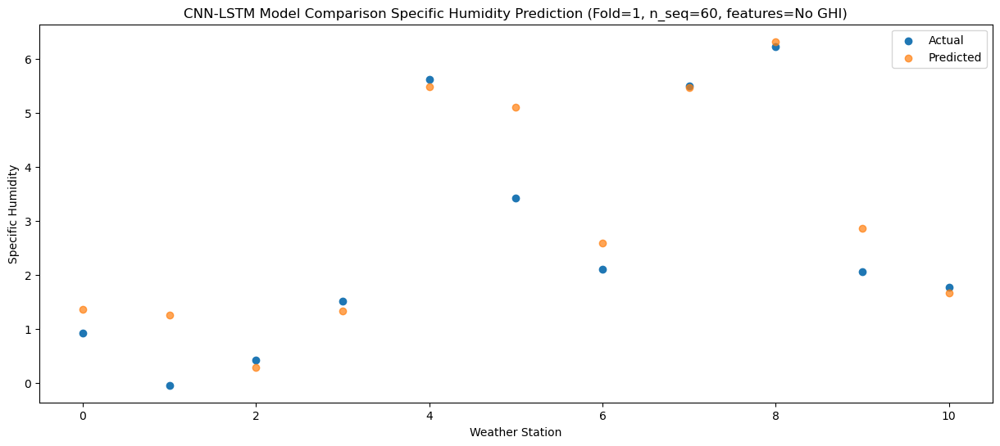

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    3.82   3.974880
1                 1    2.97   4.145605
2                 2    3.20   3.113974
3                 3    3.49   4.146204
4                 4    7.74   8.359798
5                 5    6.11   7.608969
6                 6    5.31   5.464352
7                 7    8.40   8.910495
8                 8    9.56   9.734365
9                 9    4.88   5.774064
10               10    4.34   4.692704


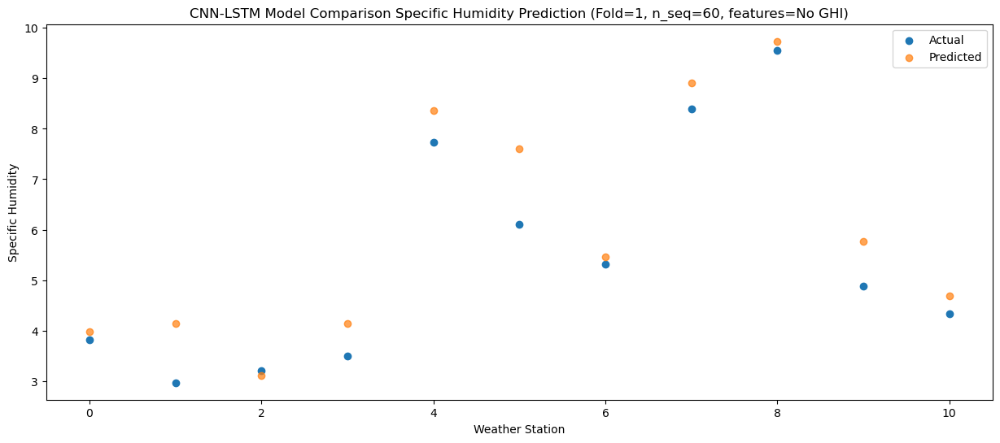

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.06   8.000944
1                 1    6.77   8.168054
2                 2    7.05   6.972226
3                 3    5.61   7.309350
4                 4   10.03  11.516611
5                 5    7.93  10.110372
6                 6    8.95   9.531253
7                 7   12.23  12.510665
8                 8   11.70  12.845589
9                 9    6.59   8.440521
10               10    7.98   8.872083


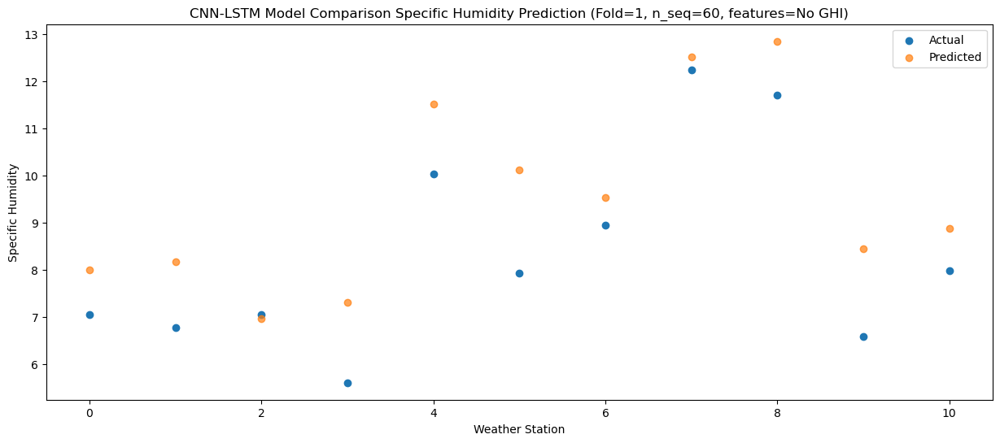

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    9.63  10.410982
1                 1    8.81  10.764176
2                 2    9.60   9.410974
3                 3    8.12   9.407517
4                 4   12.63  13.650760
5                 5    8.92  11.731430
6                 6   11.39  12.153110
7                 7   15.31  15.298501
8                 8   15.06  15.376384
9                 9    9.48  10.423575
10               10   11.62  11.775828


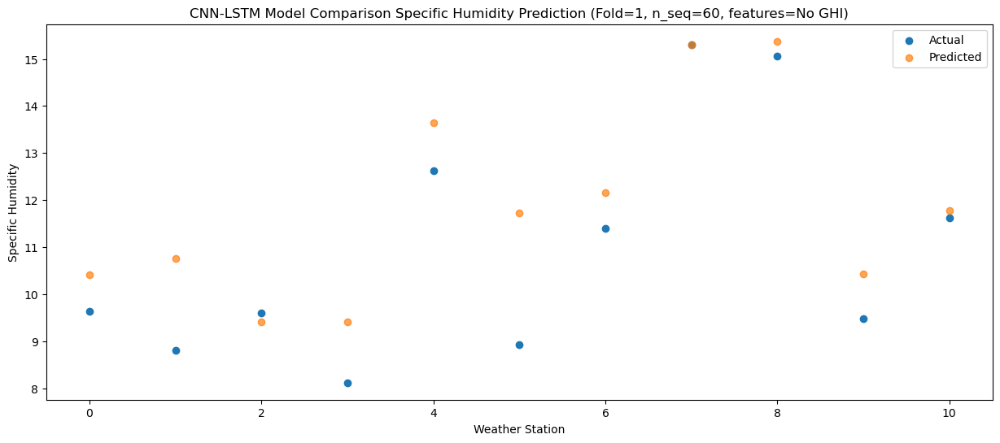

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.92  10.215204
1                 1    8.86  10.113569
2                 2    9.12   8.735278
3                 3    7.01   8.163113
4                 4   11.18  12.297016
5                 5    7.69  10.563069
6                 6   11.41  11.554734
7                 7   13.14  13.303411
8                 8   12.16  13.058595
9                 9    8.16   8.700112
10               10   11.53  10.945818


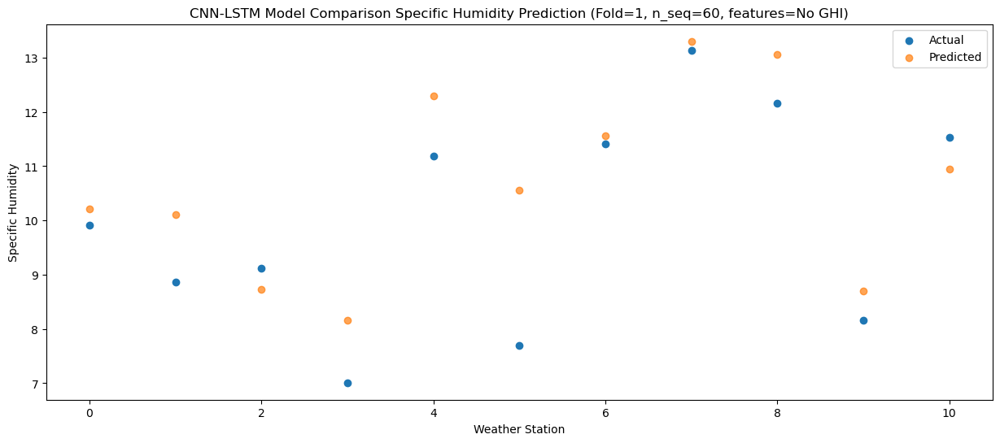

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.30   7.560279
1                 1    5.96   7.337036
2                 2    6.17   6.208600
3                 3    5.43   6.079584
4                 4    9.69  10.209020
5                 5    7.26   8.571273
6                 6    8.10   8.720317
7                 7   11.34  10.609717
8                 8   10.68  10.601501
9                 9    5.37   6.444202
10               10    8.05   7.619419


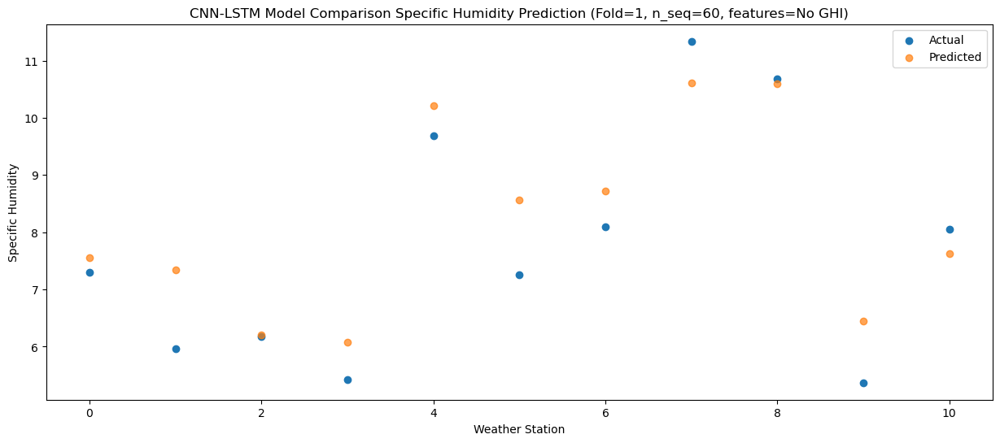

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.62   4.885906
1                 1    3.29   4.329123
2                 2    3.41   3.045474
3                 3    2.03   2.398540
4                 4    5.84   6.429216
5                 5    3.75   5.327996
6                 6    5.61   5.789157
7                 7    6.52   6.467395
8                 8    6.01   6.244980
9                 9    1.85   2.782065
10               10    5.13   4.856899


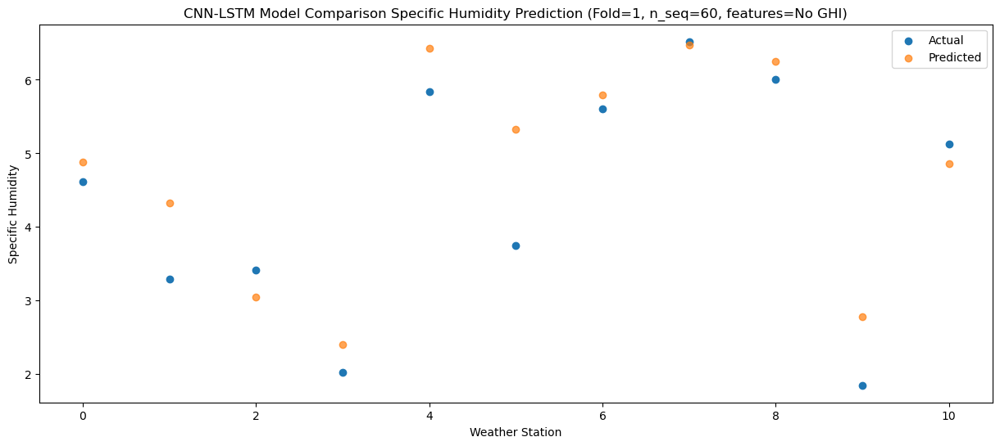

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.99   1.855206
1                 1    0.23   1.699739
2                 2    0.23   0.321455
3                 3   -0.07   0.411771
4                 4    3.36   4.517497
5                 5    3.19   4.202553
6                 6    2.50   3.146718
7                 7    4.50   5.036032
8                 8    4.90   5.389469
9                 9    1.53   2.028242
10               10    2.75   2.861055


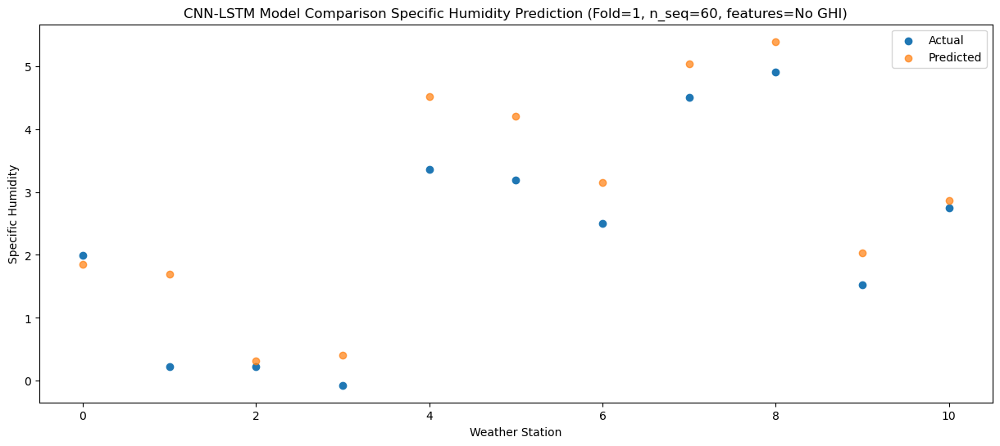

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.22  -1.210167
1                 1   -2.36  -1.089984
2                 2   -2.54  -2.686963
3                 3   -2.62  -2.203595
4                 4    0.54   1.938645
5                 5    0.75   2.593955
6                 6   -0.22   0.392465
7                 7    2.18   2.896402
8                 8    2.62   3.656160
9                 9   -0.33   0.640365
10               10    0.59   0.917597


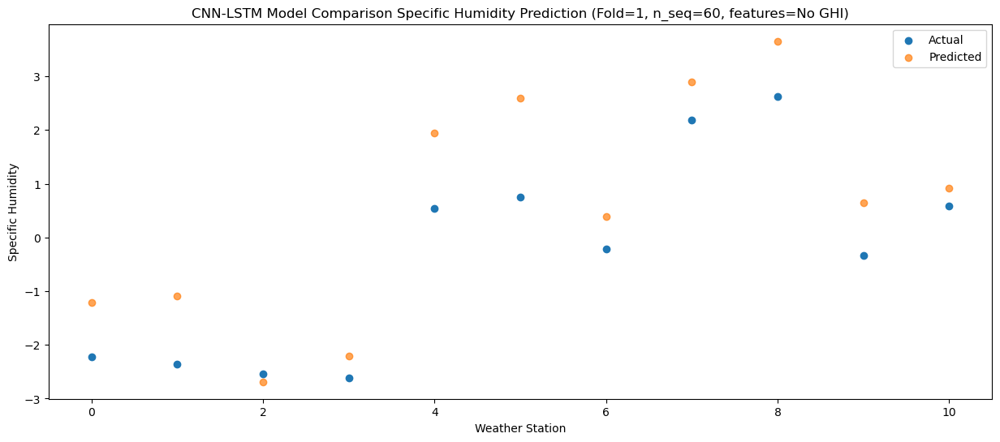

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.00  -1.506984
1                 1   -2.34  -1.418673
2                 2   -2.39  -2.868110
3                 3   -2.96  -2.111399
4                 4    0.29   2.032152
5                 5    1.58   2.730006
6                 6   -0.33   0.026403
7                 7    2.05   2.720721
8                 8    2.78   3.615818
9                 9   -0.14   0.672124
10               10   -0.14   0.289511


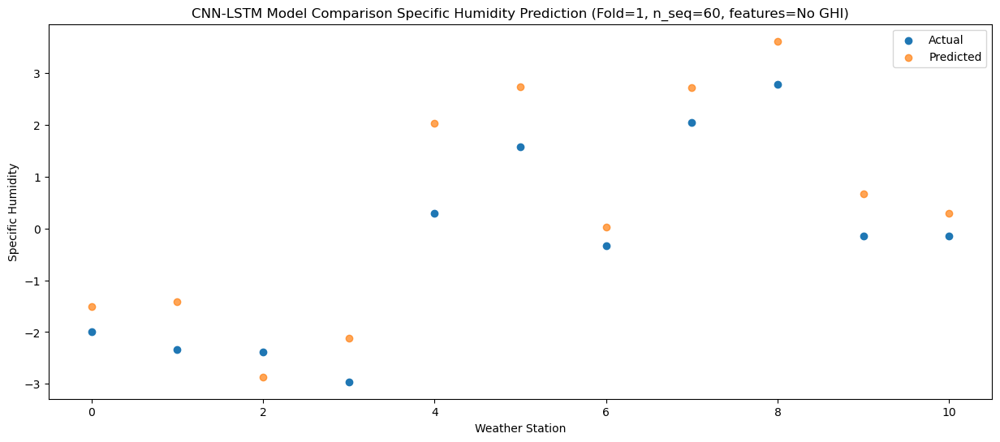

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.68  -1.209781
1                 1   -2.15  -1.361965
2                 2   -2.39  -2.751084
3                 3   -2.89  -2.325927
4                 4    0.33   1.770439
5                 5    0.95   2.177356
6                 6   -0.21   0.091471
7                 7    1.53   2.105669
8                 8    1.97   2.754780
9                 9   -0.88  -0.128362
10               10   -0.10   0.040322


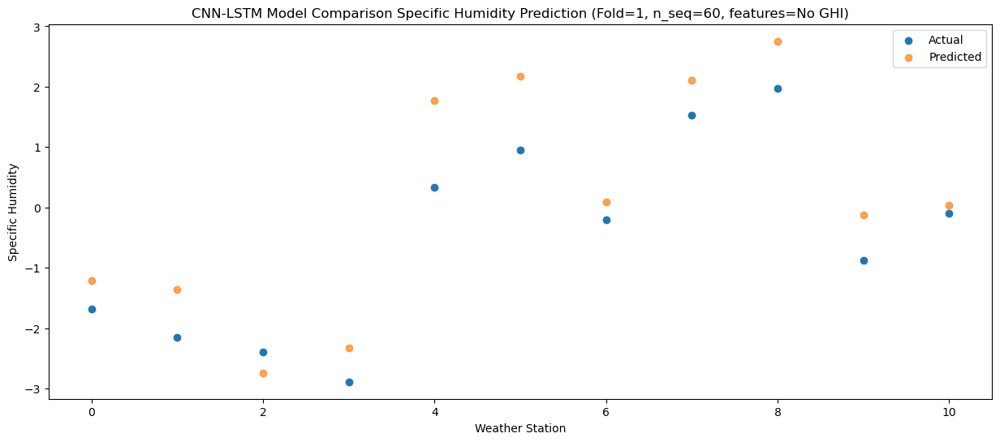

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.15   0.290876
1                 1   -0.62   0.353991
2                 2    0.23  -0.831779
3                 3   -0.25  -0.057608
4                 4    3.05   4.111026
5                 5    1.74   3.857668
6                 6    1.35   1.726755
7                 7    4.26   4.615361
8                 8    4.58   5.353289
9                 9    0.94   1.847843
10               10    1.14   1.248215


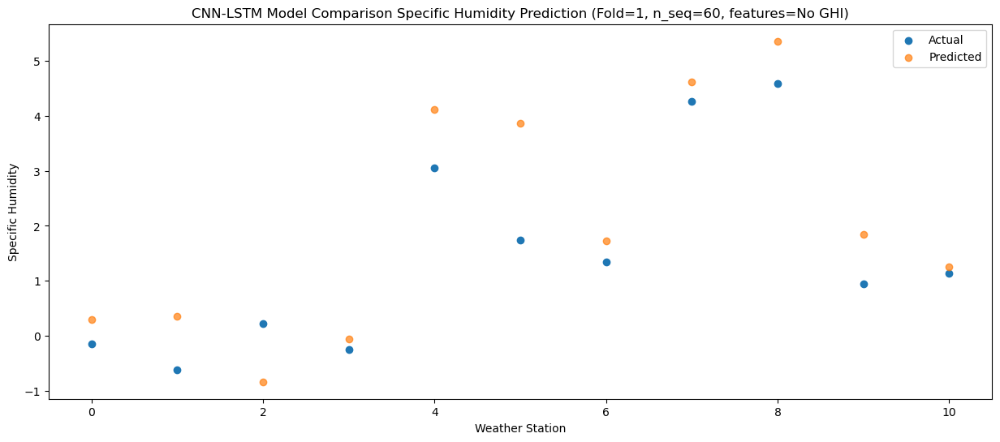

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.05   1.049462
1                 1   -0.26   1.187098
2                 2   -0.06  -0.169162
3                 3    1.09   0.366637
4                 4    4.31   4.538000
5                 5    3.04   4.317786
6                 6    1.97   2.600728
7                 7    5.49   5.408029
8                 8    5.74   6.031308
9                 9    1.11   2.448894
10               10    2.51   2.496150


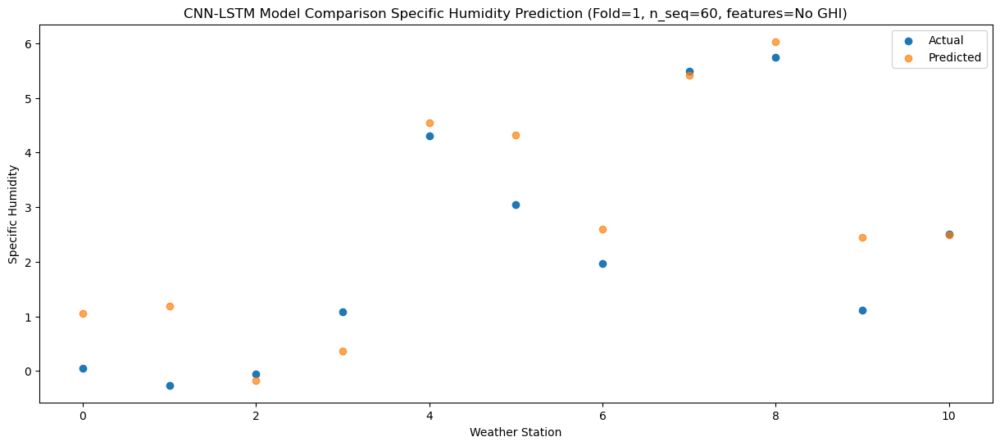

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    2.73   3.324928
1                 1    2.66   3.646216
2                 2    2.78   2.581325
3                 3    4.98   3.622374
4                 4    8.34   7.864055
5                 5    7.35   7.022246
6                 6    4.90   4.957142
7                 7    8.70   8.715240
8                 8    9.96   9.520138
9                 9    6.26   5.383748
10               10    4.04   4.246521


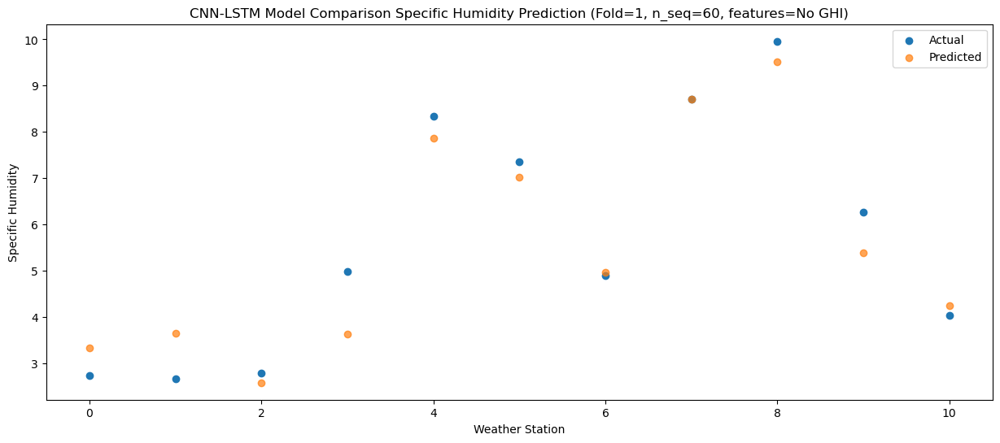

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.89   8.108848
1                 1    6.64   8.427530
2                 2    7.30   7.152490
3                 3    8.17   7.321630
4                 4   11.75  11.551690
5                 5    9.52   9.944131
6                 6    9.25   9.795858
7                 7   13.46  12.953661
8                 8   13.10  13.145127
9                 9    9.25   8.503111
10               10    9.36   9.230637


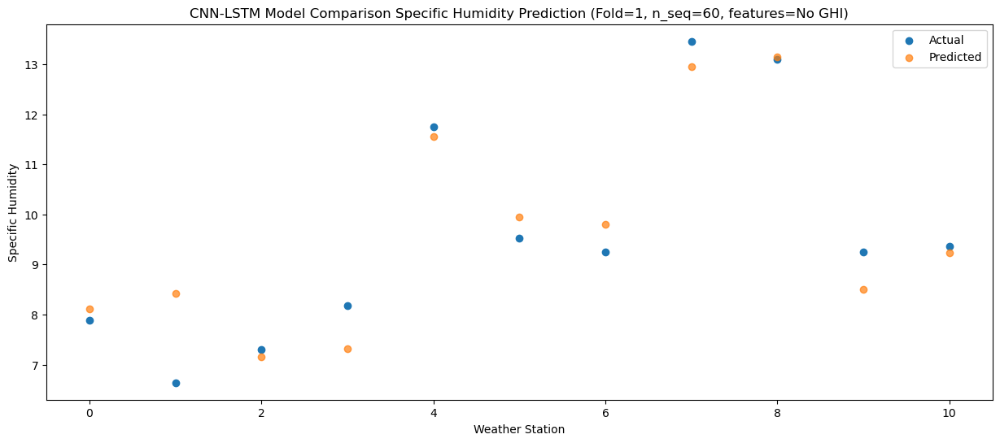

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.04   9.476223
1                 1    8.51   9.826501
2                 2    8.89   8.473419
3                 3    8.65   8.525940
4                 4   11.93  12.755011
5                 5   10.85  11.166729
6                 6   11.75  11.212087
7                 7   14.09  14.311006
8                 8   14.15  14.453053
9                 9   10.49   9.786935
10               10   11.22  10.815406


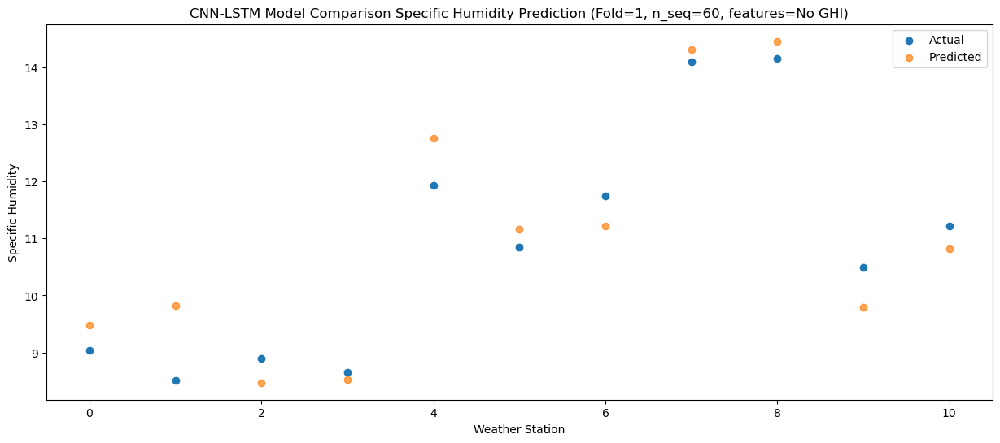

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.80  10.471306
1                 1    8.72  10.737476
2                 2    9.11   9.123307
3                 3    8.99   8.401322
4                 4   11.97  12.590991
5                 5   11.07  10.818220
6                 6   12.04  12.207338
7                 7   13.94  14.498687
8                 8   13.73  14.161242
9                 9    9.46   9.440479
10               10   11.56  12.174409


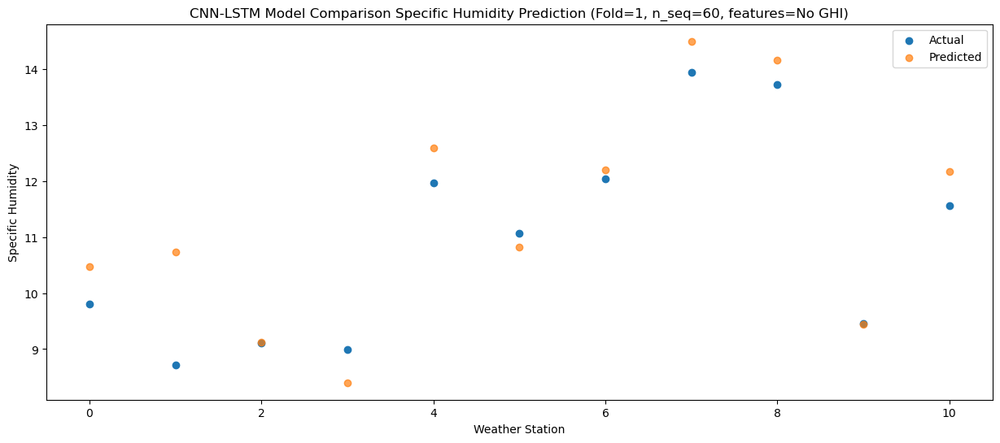

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    6.32   7.443077
1                 1    5.77   7.450747
2                 2    6.35   5.940181
3                 3    5.90   5.367550
4                 4    8.87   9.501613
5                 5    7.53   8.215784
6                 6    8.69   8.918785
7                 7   10.69  10.746080
8                 8   10.16  10.551274
9                 9    6.50   6.415235
10               10    8.37   8.703908


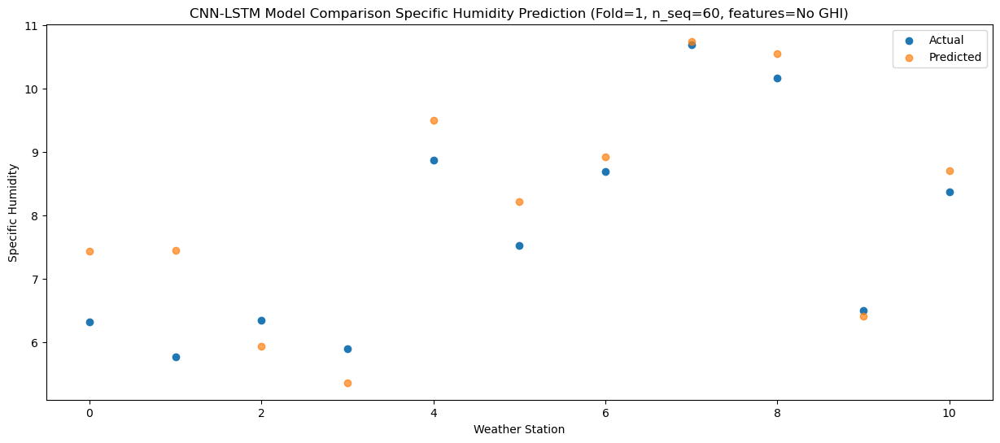

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.74   5.221648
1                 1    3.73   5.291610
2                 2    3.60   3.597852
3                 3    3.65   2.932411
4                 4    6.92   7.060861
5                 5    4.42   6.207708
6                 6    6.56   6.804694
7                 7    7.96   8.552058
8                 8    7.72   8.402028
9                 9    3.06   4.489780
10               10    6.51   7.054659


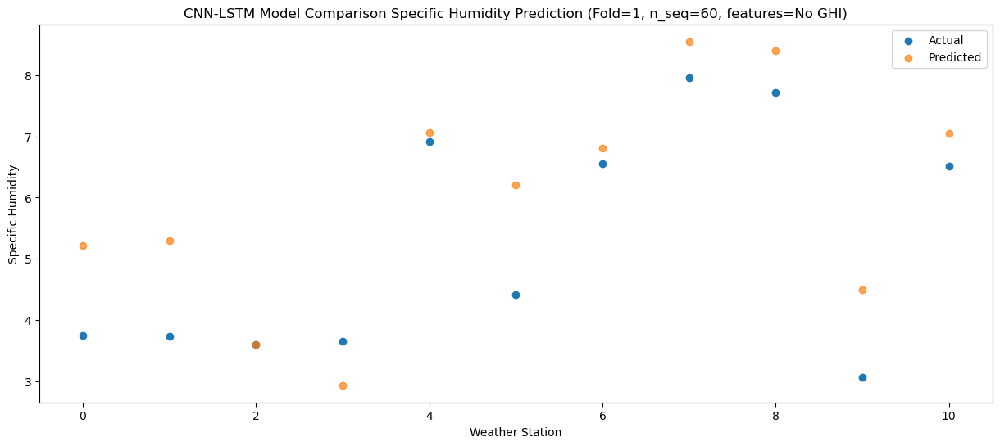

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.92  -0.503286
1                 1   -1.86  -0.324060
2                 2   -1.90  -1.867020
3                 3   -0.80  -1.174594
4                 4    2.33   2.979755
5                 5    2.58   3.701129
6                 6    0.63   1.138803
7                 7    3.40   3.900333
8                 8    4.19   4.768878
9                 9    0.70   1.768648
10               10    1.32   1.651287


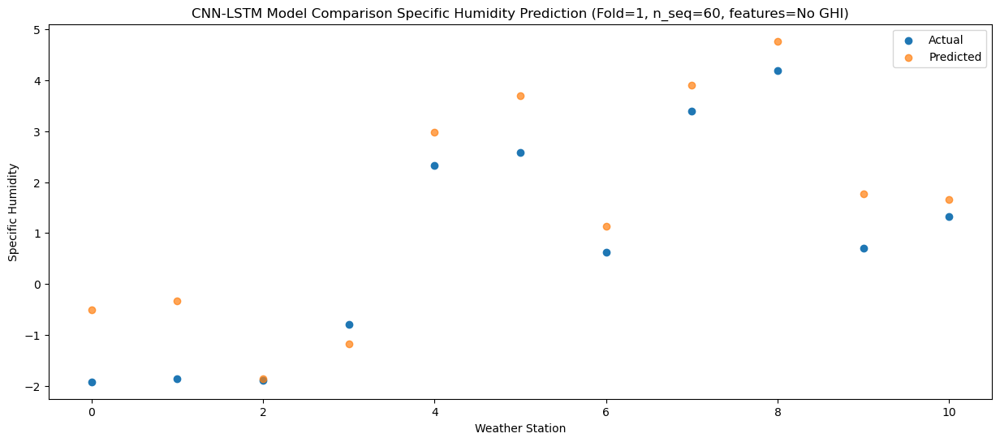

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.19   0.956553
1                 1    0.31   0.852672
2                 2    0.74  -0.320840
3                 3    2.12   0.062014
4                 4    5.26   4.194018
5                 5    1.53   3.559168
6                 6    2.50   2.237725
7                 7    5.04   4.522329
8                 8    3.58   4.954498
9                 9   -0.28   1.399575
10               10    1.20   1.524629


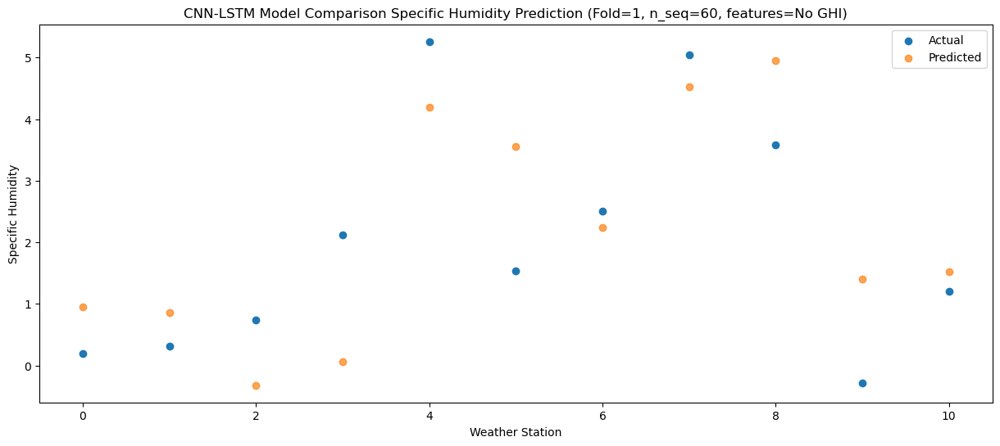

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.06  -2.049582
1                 1   -2.69  -1.963513
2                 2   -3.14  -3.546124
3                 3   -3.53  -3.041252
4                 4   -0.28   1.086582
5                 5    0.26   1.855022
6                 6   -0.50  -0.481679
7                 7    1.29   1.931752
8                 8    1.60   2.714139
9                 9   -0.92  -0.158648
10               10   -0.41  -0.000810


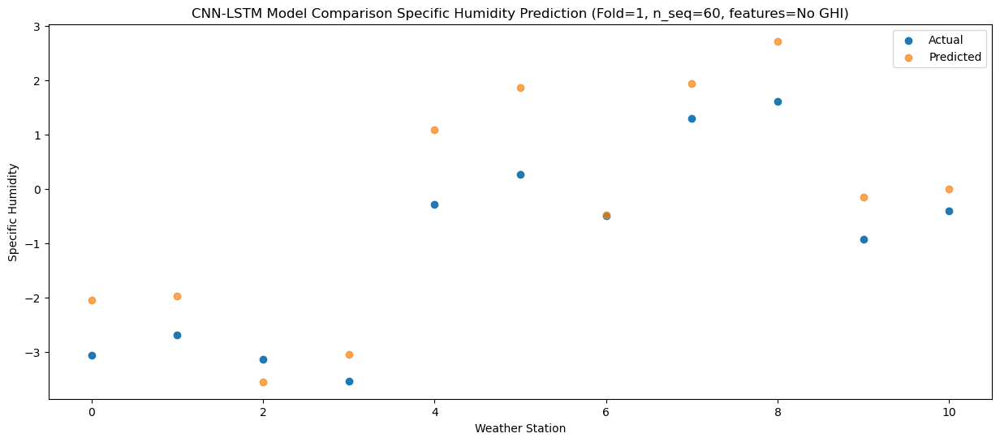

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.12  -0.808175
1                 1   -1.74  -0.848359
2                 2   -2.11  -2.420269
3                 3   -3.36  -2.361626
4                 4   -0.08   1.740056
5                 5    0.14   2.000766
6                 6    0.63   0.638862
7                 7    1.97   2.547493
8                 8    2.13   2.991777
9                 9   -1.00  -0.073316
10               10    0.33   0.859759


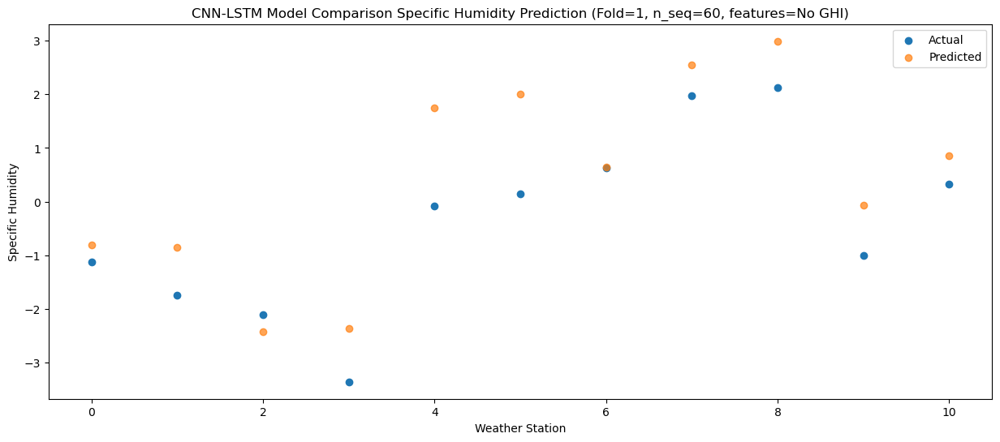

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.01   0.290323
1                 1   -1.06   0.298761
2                 2   -1.32  -1.231311
3                 3   -1.68  -1.040419
4                 4    1.62   3.072862
5                 5    0.69   3.327318
6                 6    1.38   1.768672
7                 7    3.50   3.897508
8                 8    3.22   4.411374
9                 9   -0.04   1.291296
10               10    1.35   1.940556


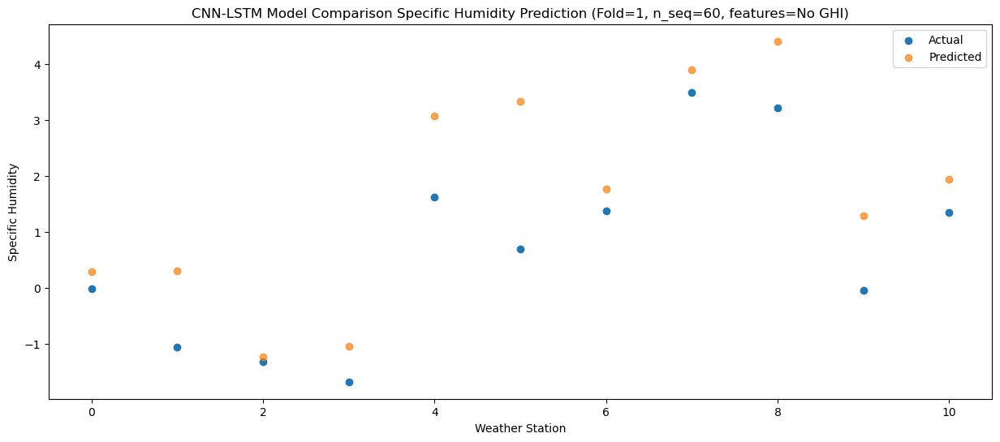

Predictions for (t+29):
    Weather_Station        Actual  Predicted
0                 0  1.010000e+00   1.462911
1                 1  1.332268e-15   1.602579
2                 2  4.400000e-01   0.311724
3                 3  2.480000e+00   0.901040
4                 4  5.720000e+00   5.069584
5                 5  2.960000e+00   4.758070
6                 6  2.570000e+00   2.989885
7                 7  5.690000e+00   5.851512
8                 8  6.340000e+00   6.502885
9                 9  9.300000e-01   2.894787
10               10  2.010000e+00   2.663063


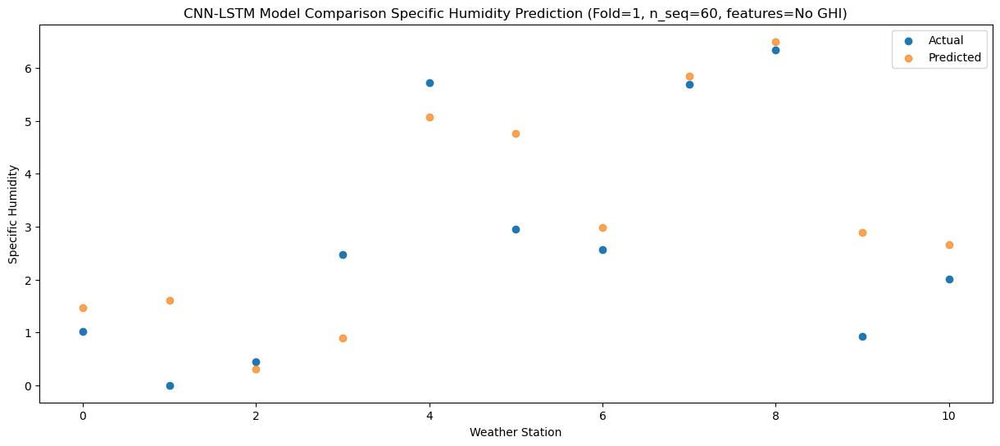

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    4.99   5.696886
1                 1    4.17   5.927688
2                 2    4.80   4.646033
3                 3    6.29   4.855853
4                 4    9.60   9.058622
5                 5    4.73   7.754117
6                 6    6.83   7.302706
7                 7   10.14  10.248981
8                 8   10.58  10.534421
9                 9    3.49   6.176364
10               10    6.14   6.761030


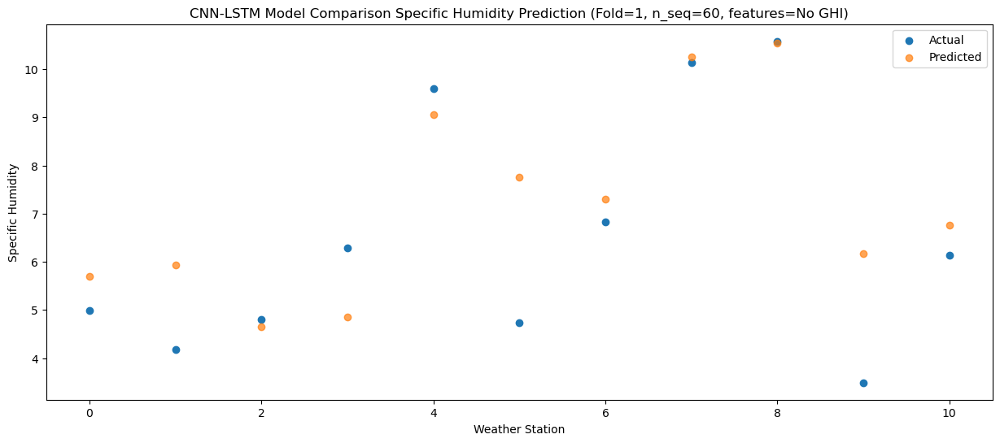

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    7.29   7.723451
1                 1    6.57   8.044752
2                 2    7.89   6.845708
3                 3    7.34   7.305633
4                 4   10.72  11.532531
5                 5    7.33  10.173193
6                 6    9.55   9.386424
7                 7   12.90  12.735221
8                 8   12.48  13.157450
9                 9    7.67   8.688392
10               10    7.73   8.736961


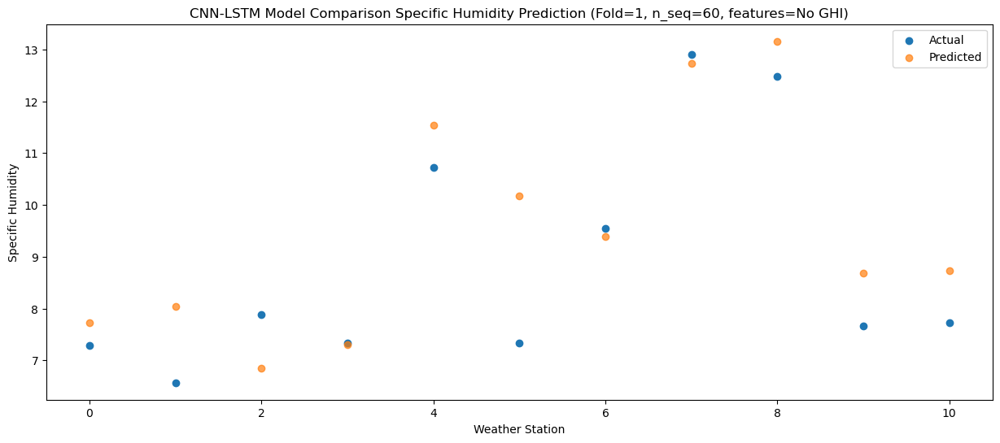

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    9.91  10.020350
1                 1    9.24  10.199468
2                 2    9.52   8.703129
3                 3    8.26   8.205146
4                 4   11.47  12.372362
5                 5    8.28  10.826161
6                 6   12.54  11.635917
7                 7   13.87  13.921323
8                 8   11.84  13.784525
9                 9    8.32   9.319608
10               10   11.36  11.326620


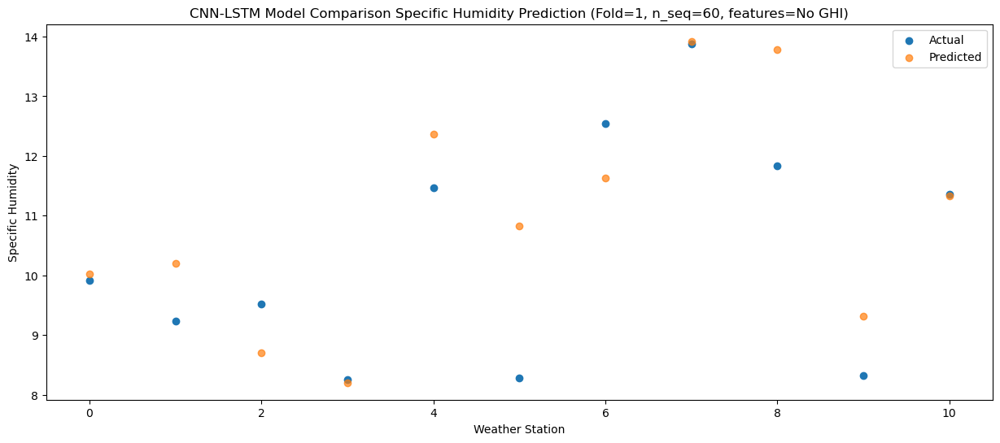

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.91   9.254855
1                 1    8.83   9.536260
2                 2    8.65   7.975996
3                 3    8.51   7.709242
4                 4   11.85  11.893152
5                 5   10.39  10.710438
6                 6   11.45  10.981492
7                 7   13.78  13.561036
8                 8   12.58  13.607994
9                 9    8.73   9.257193
10               10   10.93  10.999749


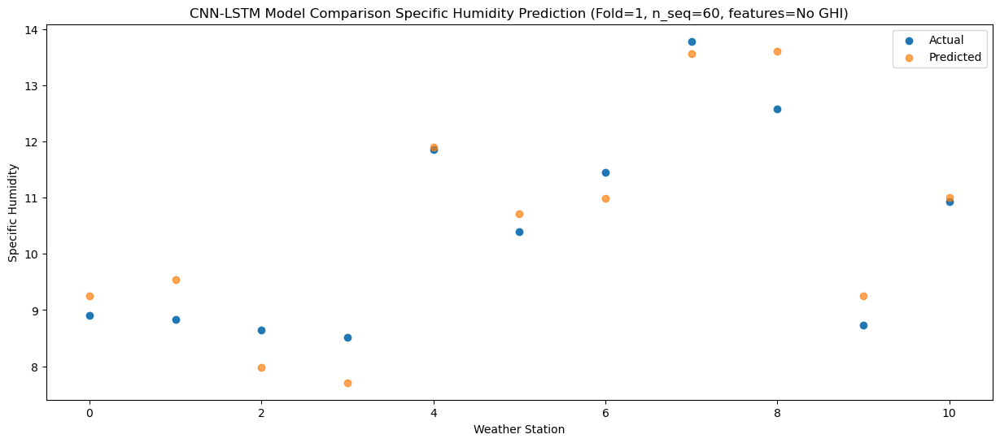

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.29   6.254402
1                 1    5.47   6.381014
2                 2    5.14   4.740636
3                 3    5.22   4.434631
4                 4    8.50   8.568790
5                 5    9.12   7.992183
6                 6    7.97   7.864767
7                 7    9.82   9.960085
8                 8    9.84  10.081191
9                 9    6.73   6.274307
10               10    7.68   8.077930


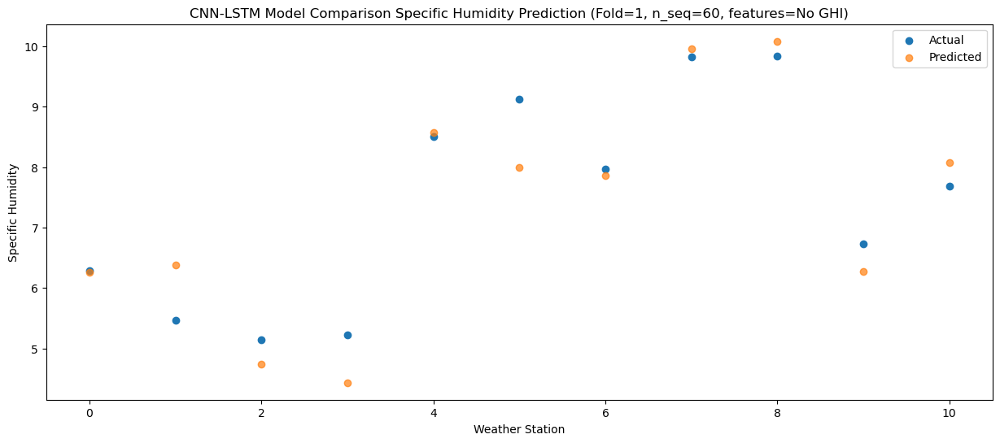

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    1.43   1.432109
1                 1    0.58   1.517000
2                 2    0.03  -0.177794
3                 3    0.26   0.031732
4                 4    3.60   4.144482
5                 5    5.93   4.781740
6                 6    2.91   3.025004
7                 7    5.28   5.195678
8                 8    5.89   5.799987
9                 9    3.34   2.817386
10               10    4.24   3.687308


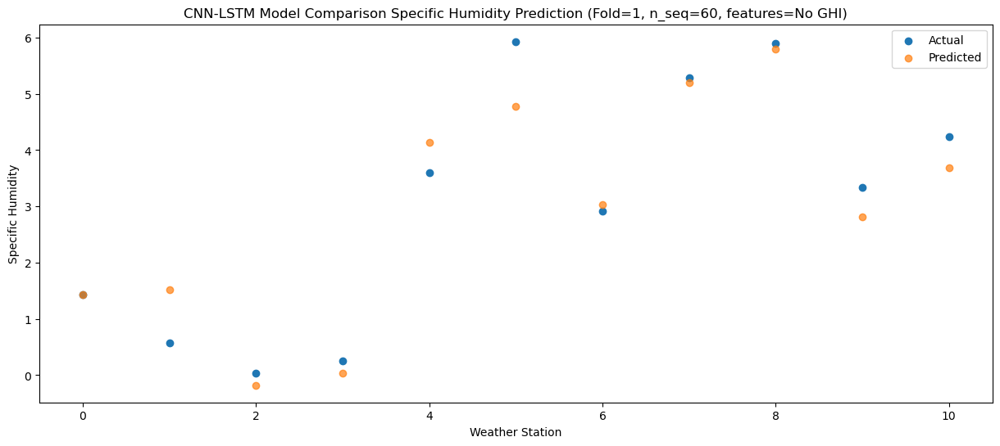

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.90   1.174489
1                 1    0.10   1.168009
2                 2   -0.34  -0.489863
3                 3   -0.24  -0.748474
4                 4    3.22   3.356078
5                 5    3.06   3.192215
6                 6    2.42   2.672987
7                 7    4.03   4.444865
8                 8    4.91   4.654917
9                 9    1.36   1.248238
10               10    2.74   2.964567


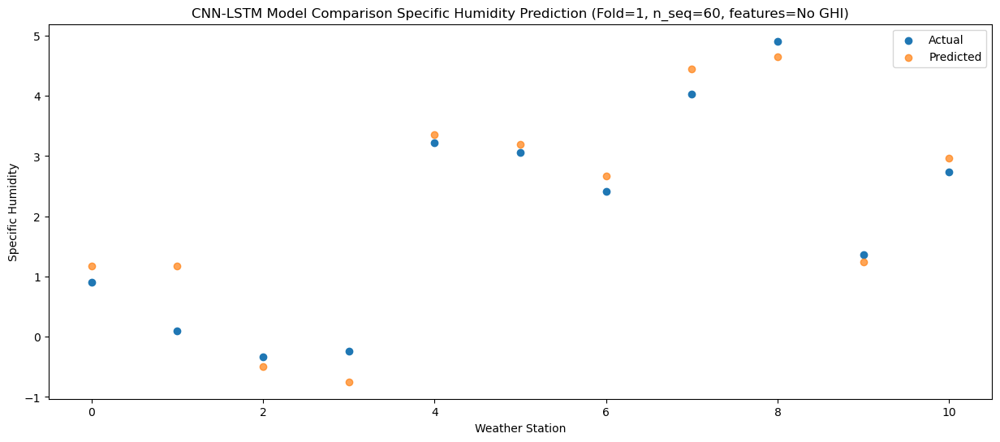

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.82  -1.012615
1                 1   -1.49  -0.922973
2                 2   -1.03  -2.450565
3                 3   -1.05  -2.079065
4                 4    2.40   2.051966
5                 5    2.39   2.324024
6                 6    0.52   0.538975
7                 7    3.12   2.928586
8                 8    3.17   3.540965
9                 9    0.15   0.341633
10               10    0.61   0.799730


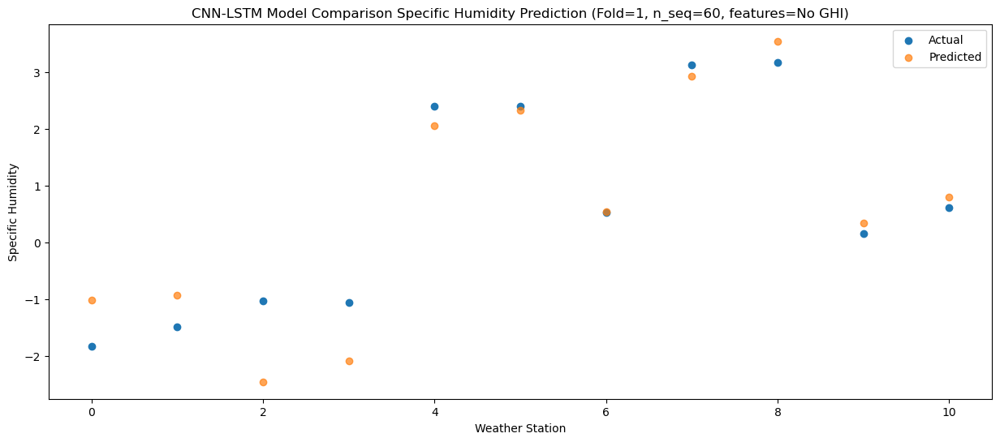

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -1.36  -0.528526
1                 1   -1.08  -0.452800
2                 2   -1.06  -2.119790
3                 3   -1.47  -2.051565
4                 4    1.92   2.064540
5                 5    0.84   2.364578
6                 6    0.88   1.051403
7                 7    3.24   3.136494
8                 8    2.69   3.587036
9                 9   -0.16   0.408607
10               10    1.47   1.571448


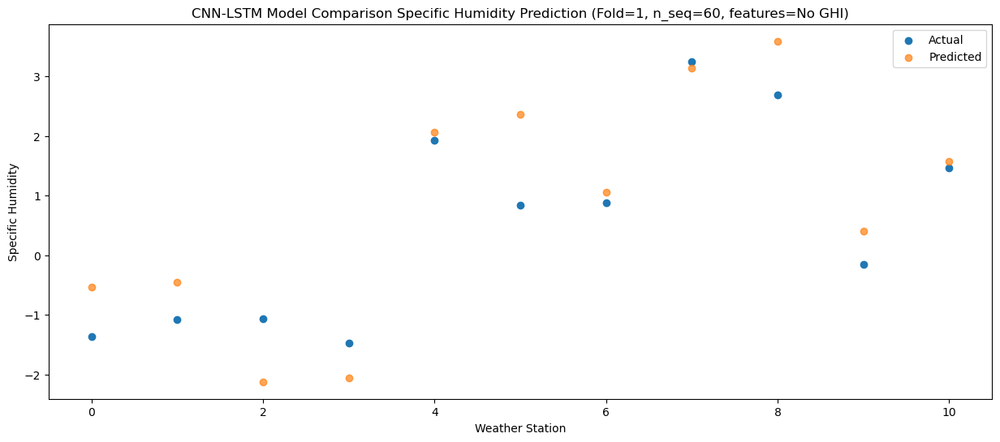

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.25  -0.113191
1                 1    0.04  -0.192352
2                 2   -0.01  -1.592984
3                 3   -0.69  -1.519291
4                 4    2.52   2.587375
5                 5    0.87   2.218258
6                 6    2.08   1.251532
7                 7    3.34   3.228287
8                 8    3.02   3.543904
9                 9   -0.30   0.116101
10               10    0.67   1.009113


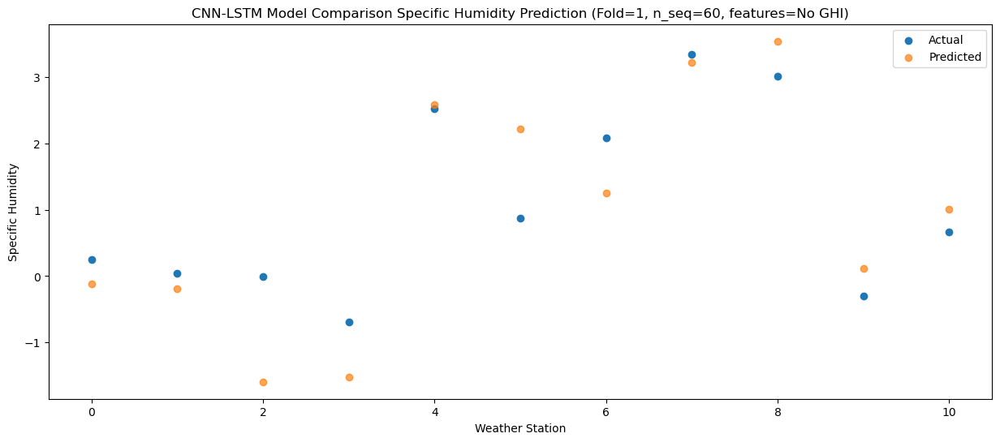

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.13  -0.206848
1                 1   -0.83  -0.153597
2                 2   -0.48  -1.432898
3                 3    0.86  -0.838140
4                 4    4.22   3.307792
5                 5    1.92   3.092237
6                 6    1.32   1.243163
7                 7    4.10   3.881334
8                 8    4.44   4.508732
9                 9    0.49   1.052865
10               10    0.70   0.910607


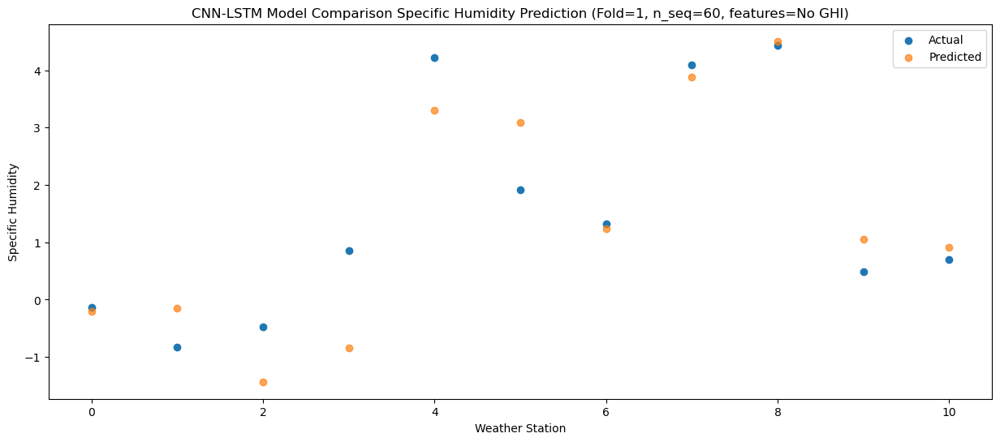

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.57   1.752491
1                 1    0.77   1.721184
2                 2    0.88   0.173572
3                 3    1.23   0.032770
4                 4    4.67   4.136581
5                 5    2.18   3.845965
6                 6    3.13   3.201729
7                 7    5.30   5.051713
8                 8    5.66   5.287119
9                 9    1.01   1.845580
10               10    3.31   3.268824


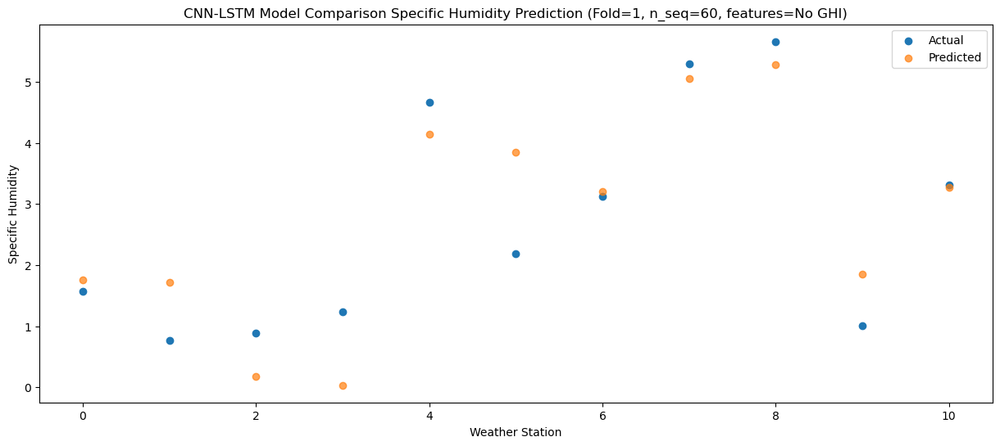

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.77   3.165583
1                 1    3.51   3.588131
2                 2    4.18   2.535781
3                 3    5.01   3.925771
4                 4    8.34   8.179590
5                 5    6.55   7.628648
6                 6    5.69   4.880822
7                 7    9.34   8.983853
8                 8   10.71  10.028858
9                 9    6.74   6.010285
10               10    3.61   4.263295


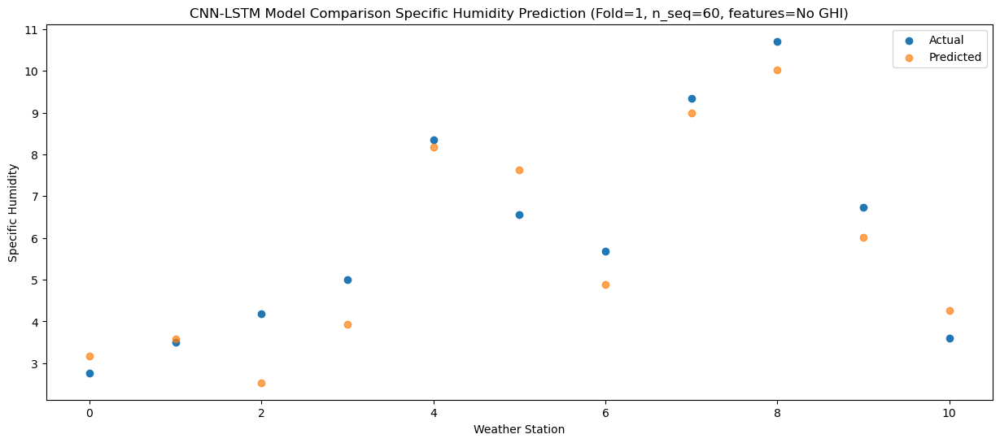

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.12   6.322534
1                 1    5.86   6.747840
2                 2    6.83   5.603585
3                 3    8.41   6.442921
4                 4   11.60  10.695149
5                 5    6.50   9.438295
6                 6    8.27   8.064790
7                 7   12.26  11.848743
8                 8   13.29  12.475670
9                 9    8.35   7.978671
10               10    6.90   7.451740


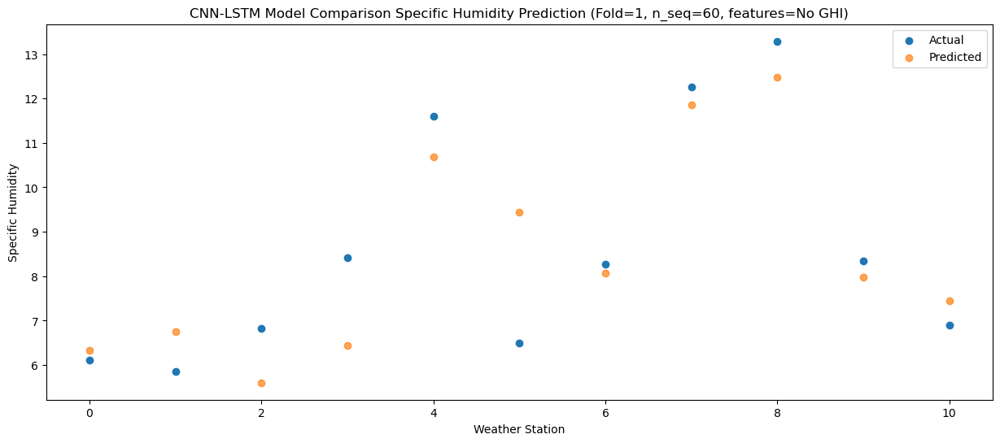

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    9.53   9.859880
1                 1    8.82  10.182692
2                 2    9.97   8.509894
3                 3    8.97   7.771269
4                 4   11.68  11.956022
5                 5    8.67  10.222529
6                 6   11.89  11.656180
7                 7   14.83  13.968669
8                 8   13.52  13.664764
9                 9   10.28   8.923778
10               10   11.61  11.711107


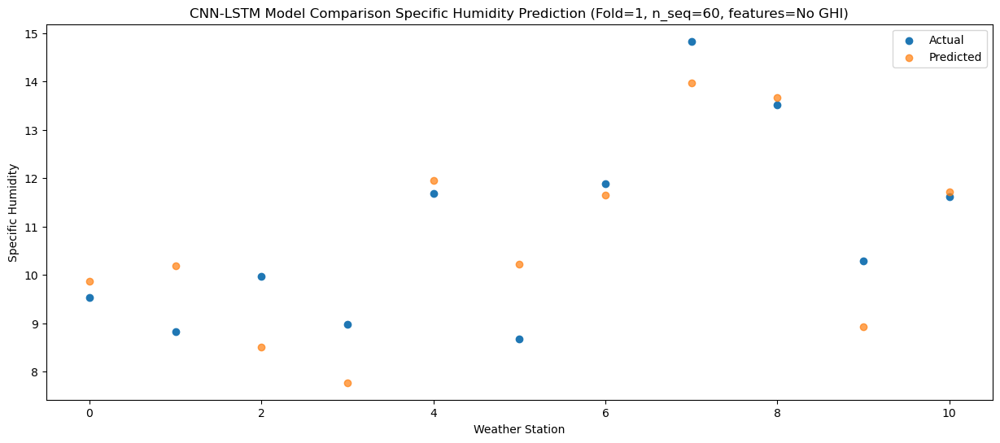

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.36   9.758229
1                 1    8.95  10.063670
2                 2    9.90   8.609795
3                 3    7.30   8.425099
4                 4   10.28  12.615478
5                 5    8.82  11.183183
6                 6   11.78  11.475713
7                 7   14.41  14.187155
8                 8   11.69  14.220888
9                 9    8.37   9.735565
10               10    9.32  11.162653


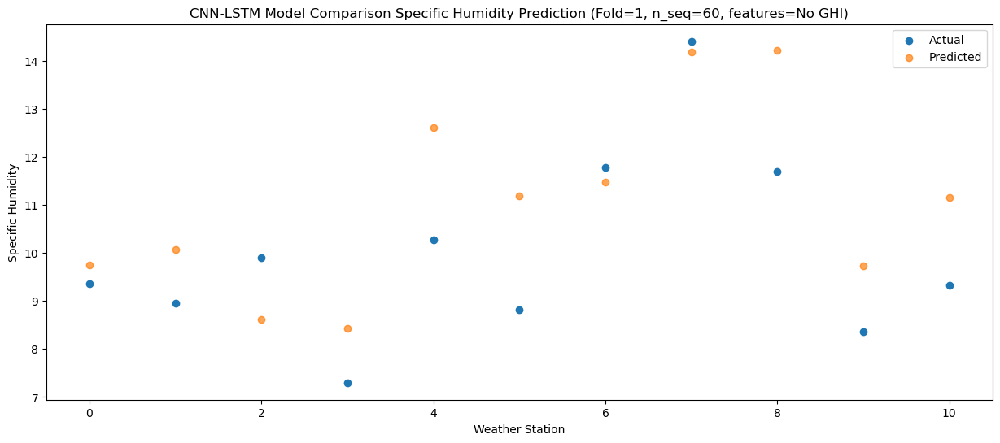

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.50   6.531401
1                 1    5.84   6.793553
2                 2    6.09   5.118487
3                 3    6.10   4.851694
4                 4    9.53   9.005074
5                 5    8.46   8.365625
6                 6    8.81   8.274350
7                 7    9.92  10.622874
8                 8   10.74  10.730336
9                 9    6.72   6.784475
10               10    8.06   8.568436


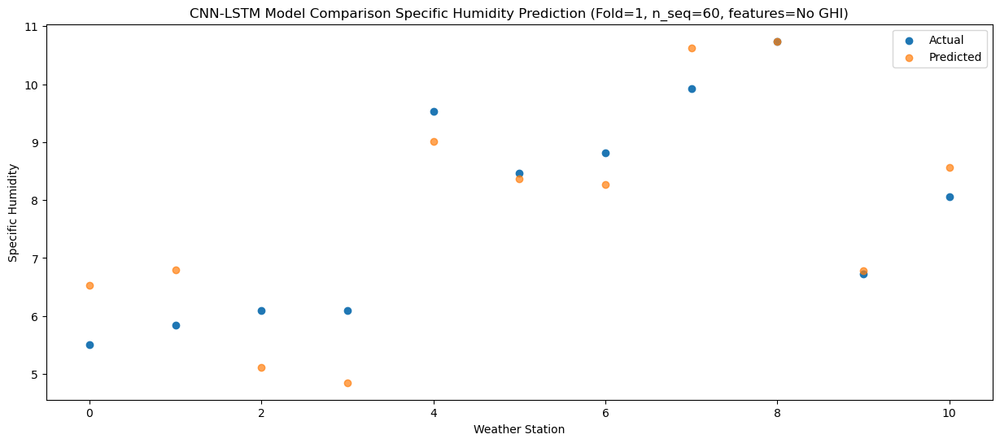

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.10   2.753160
1                 1    1.99   3.071877
2                 2    1.58   1.296394
3                 3    2.68   1.298193
4                 4    6.14   5.446335
5                 5    6.48   5.594903
6                 6    4.56   4.574436
7                 7    6.67   7.080356
8                 8    7.31   7.479138
9                 9    3.61   3.981895
10               10    5.01   5.290549


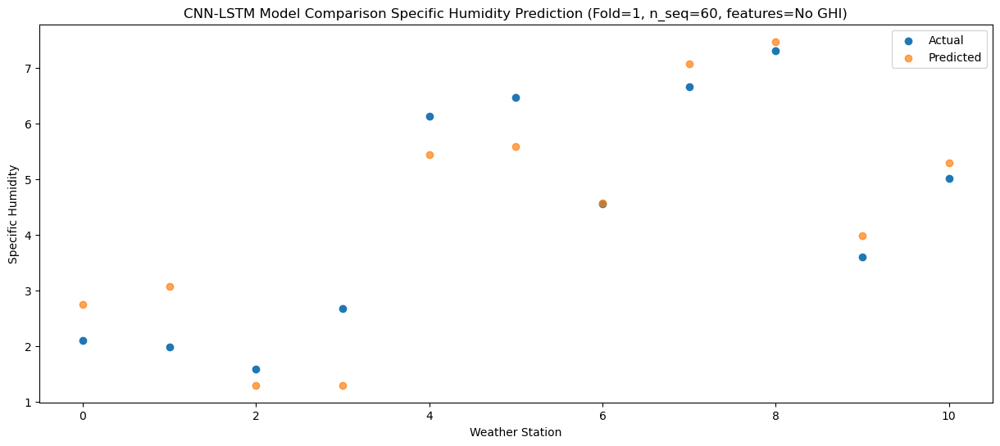

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.96  -0.594279
1                 1   -1.02  -0.296593
2                 2   -0.97  -1.869608
3                 3   -0.65  -1.360066
4                 4    2.80   2.798654
5                 5    3.85   3.132852
6                 6    1.21   1.150709
7                 7    3.96   4.014767
8                 8    4.64   4.713369
9                 9    1.29   1.369594
10               10    1.35   1.538311


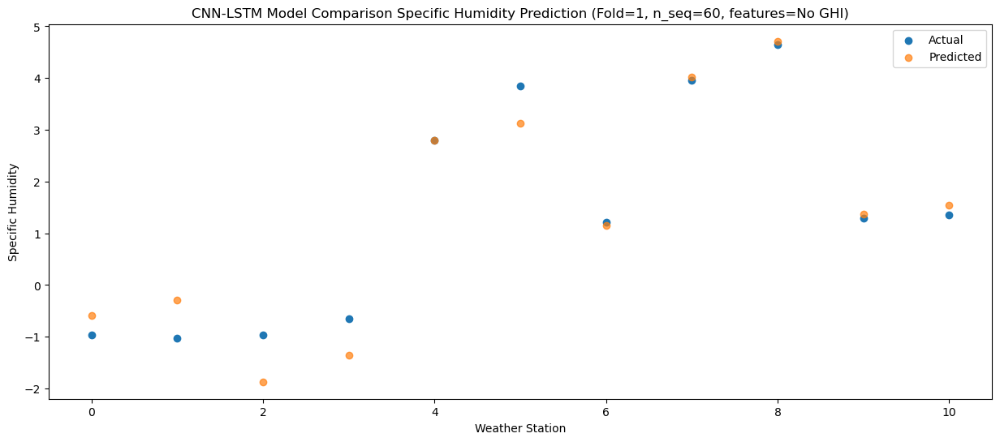

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.71  -0.735809
1                 1   -1.60  -0.412724
2                 2   -1.99  -2.306709
3                 3   -2.29  -2.239803
4                 4    1.08   1.889622
5                 5    1.98   2.699430
6                 6    0.71   1.122950
7                 7    2.57   3.518067
8                 8    3.59   4.059037
9                 9    0.85   0.988866
10               10    1.59   2.206894


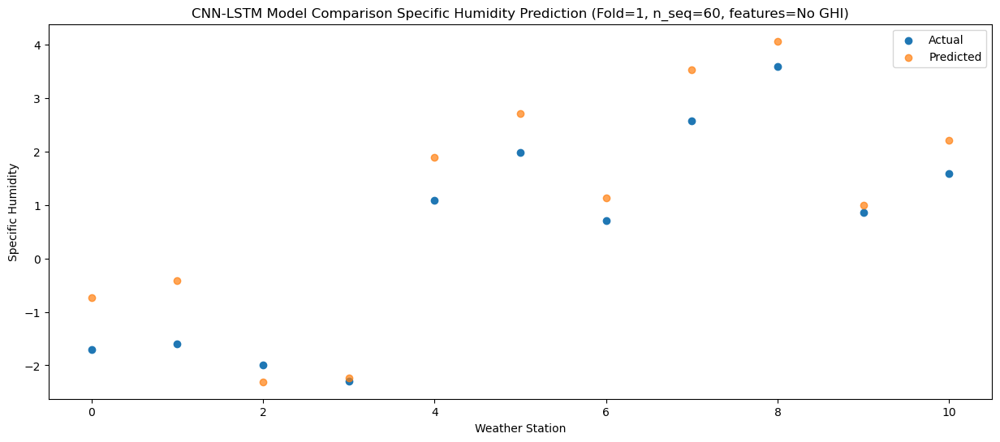

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.10  -1.625926
1                 1   -2.37  -1.393892
2                 2   -2.62  -3.261316
3                 3   -3.39  -3.201752
4                 4   -0.09   0.904872
5                 5    0.83   1.857646
6                 6   -0.11   0.143311
7                 7    1.50   2.324520
8                 8    2.28   2.885232
9                 9    0.11   0.020509
10               10    0.54   1.132694


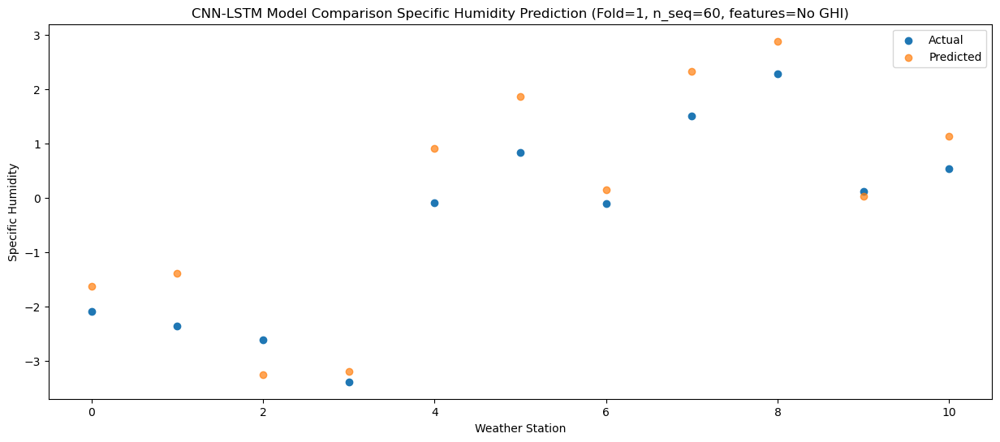

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -2.49  -1.471231
1                 1   -2.03  -1.034149
2                 2   -1.82  -2.658212
3                 3   -1.14  -1.872129
4                 4    2.16   2.303136
5                 5    1.24   3.107656
6                 6    0.37   0.411854
7                 7    3.25   3.648502
8                 8    4.03   4.599701
9                 9    0.78   1.445590
10               10    0.41   1.078091


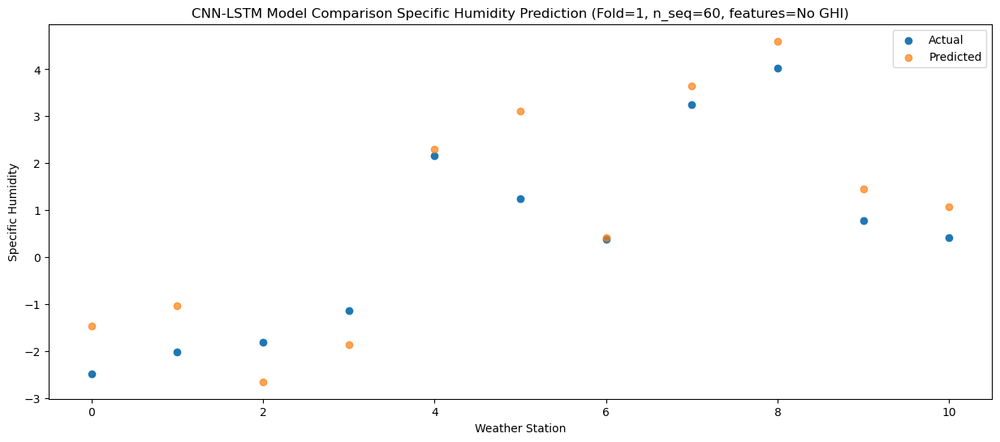

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.08   0.230889
1                 1   -0.52   0.508697
2                 2   -0.28  -0.960399
3                 3    0.77  -0.464561
4                 4    4.09   3.697720
5                 5    2.20   3.692741
6                 6    1.71   1.928025
7                 7    4.44   4.819902
8                 8    5.58   5.449402
9                 9    1.09   1.928138
10               10    1.44   2.034294


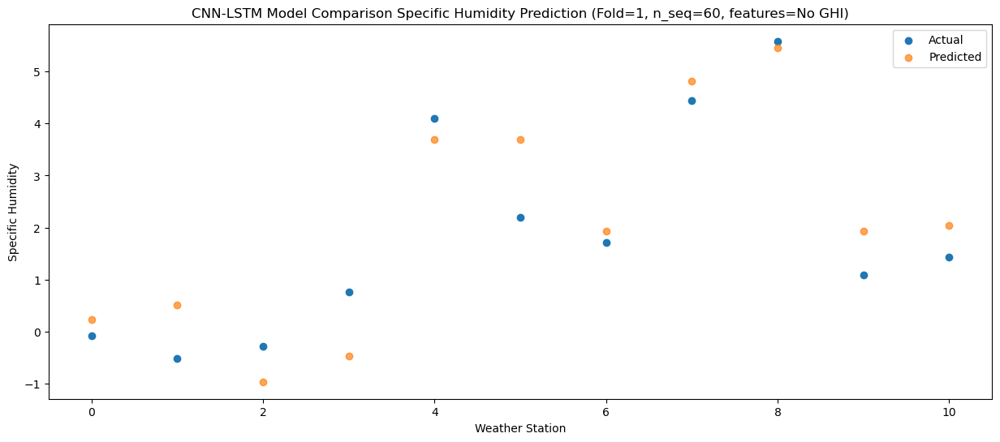

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    0.99   1.866186
1                 1    1.37   2.252361
2                 2    1.71   0.777900
3                 3    3.02   1.187077
4                 4    6.29   5.376627
5                 5    2.84   4.933572
6                 6    3.86   3.659335
7                 7    6.21   6.768765
8                 8    7.90   7.286265
9                 9    1.95   3.363288
10               10    3.05   3.713602


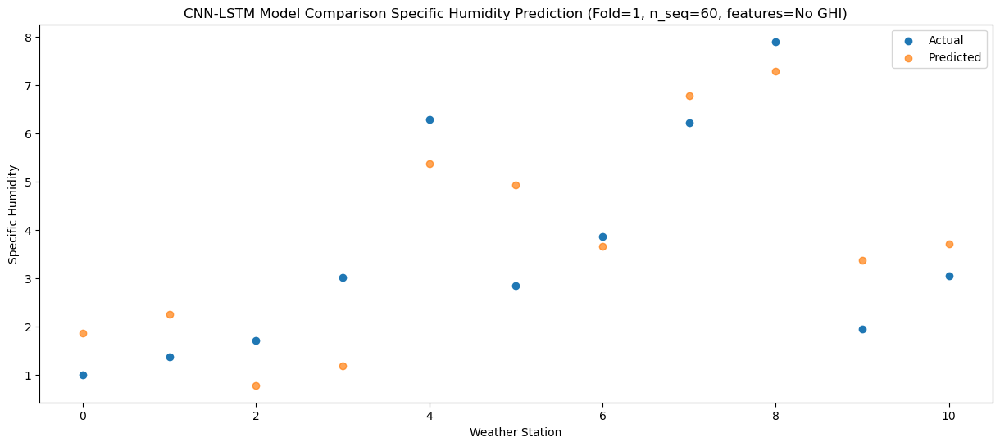

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.19   5.927484
1                 1    5.17   6.309425
2                 2    5.84   4.900264
3                 3    7.37   4.852714
4                 4   10.27   9.051435
5                 5    5.27   7.553047
6                 6    8.00   7.698207
7                 7   10.52  10.664149
8                 8   11.50  10.730581
9                 9    4.68   6.138926
10               10    6.63   7.353859


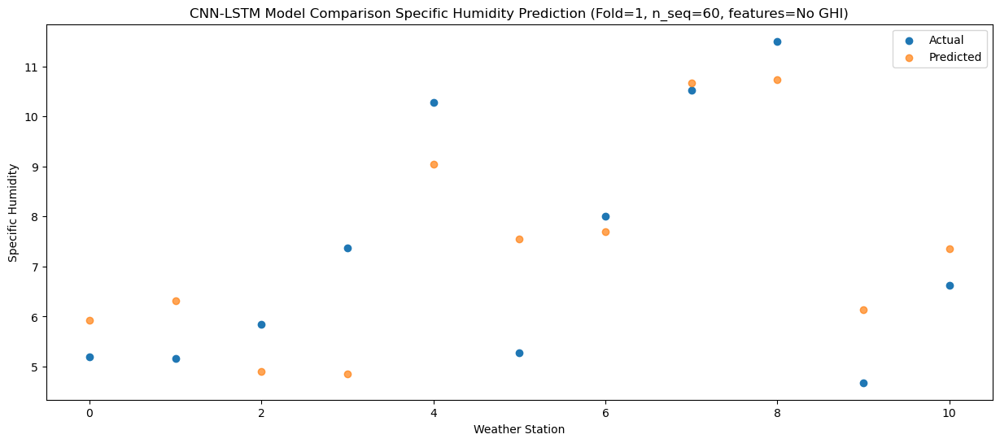

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.26   7.584703
1                 1    6.68   8.224387
2                 2    7.27   6.737269
3                 3    8.76   6.947879
4                 4   11.78  11.193115
5                 5   10.12   9.837020
6                 6    9.96   9.608864
7                 7   12.54  13.251827
8                 8   14.41  13.513917
9                 9   10.35   8.726588
10               10    8.45   9.624731


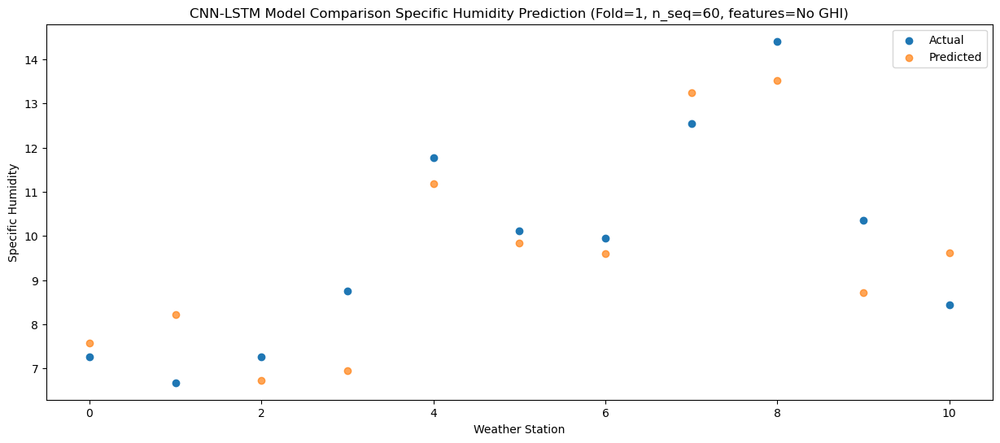

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    9.68   9.942824
1                 1    9.28  10.325828
2                 2   10.44   8.681360
3                 3    8.84   8.084529
4                 4   12.10  12.256647
5                 5    9.97  10.728753
6                 6   12.34  11.781025
7                 7   13.21  14.287696
8                 8   13.02  14.060368
9                 9    8.60   9.418812
10               10   11.82  11.852055


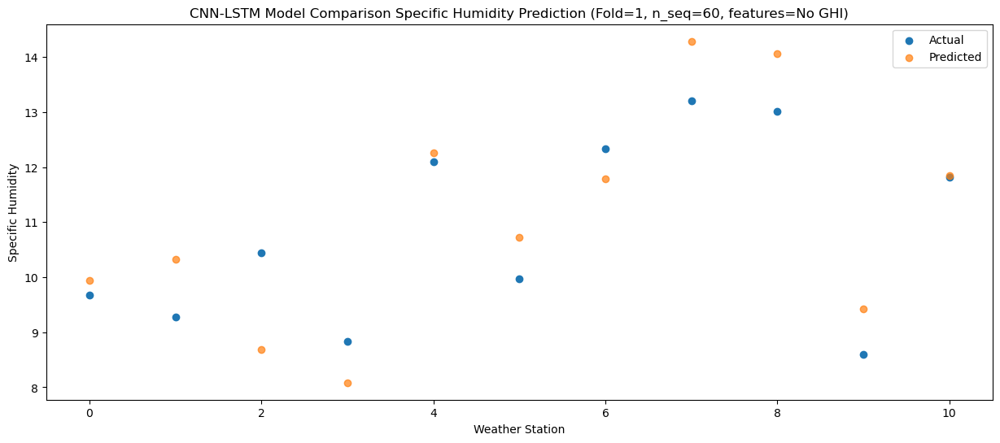

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.04   8.900636
1                 1    7.55   9.380869
2                 2    8.32   7.752127
3                 3    8.93   7.502448
4                 4   12.15  11.692706
5                 5    8.83  10.535072
6                 6   10.62  10.821589
7                 7   11.97  13.738314
8                 8   12.43  13.781657
9                 9    8.79   9.282807
10               10   10.24  11.023259


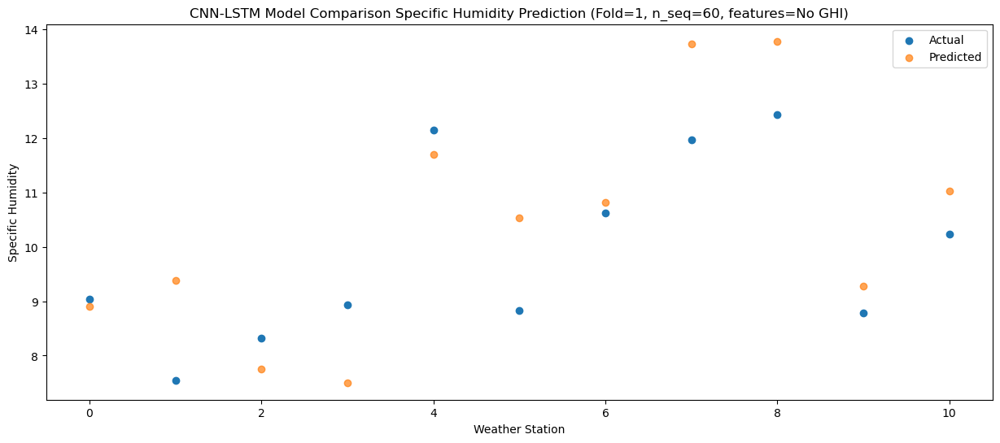

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.05   7.258058
1                 1    6.03   7.362582
2                 2    6.77   5.789758
3                 3    6.01   5.234736
4                 4    9.61   9.339996
5                 5    9.31   8.311658
6                 6    9.33   8.827260
7                 7   10.21  10.734814
8                 8   10.52  10.595885
9                 9    6.35   6.569491
10               10    7.75   8.723934


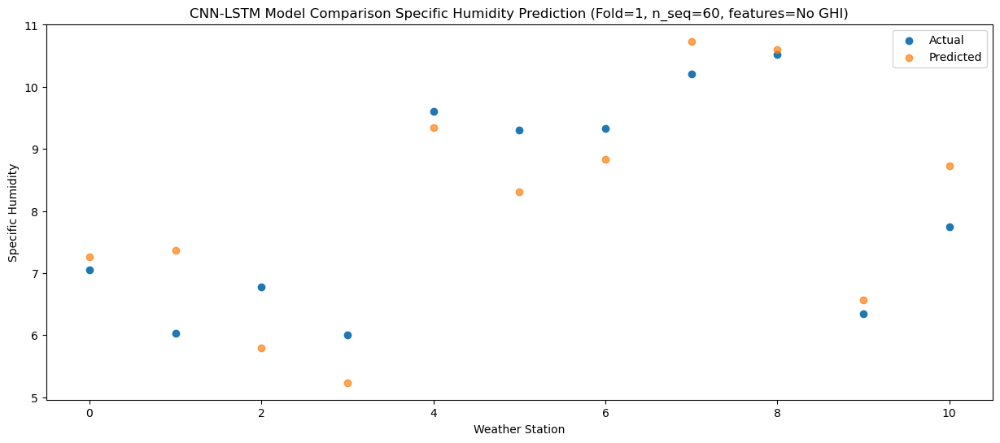

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.10   2.561973
1                 1    2.20   2.760362
2                 2    2.27   1.100568
3                 3    1.96   0.966145
4                 4    5.28   5.074941
5                 5    5.04   4.989799
6                 6    5.19   4.239009
7                 7    5.17   6.454357
8                 8    7.16   6.721606
9                 9    3.36   3.220989
10               10    3.44   4.576928


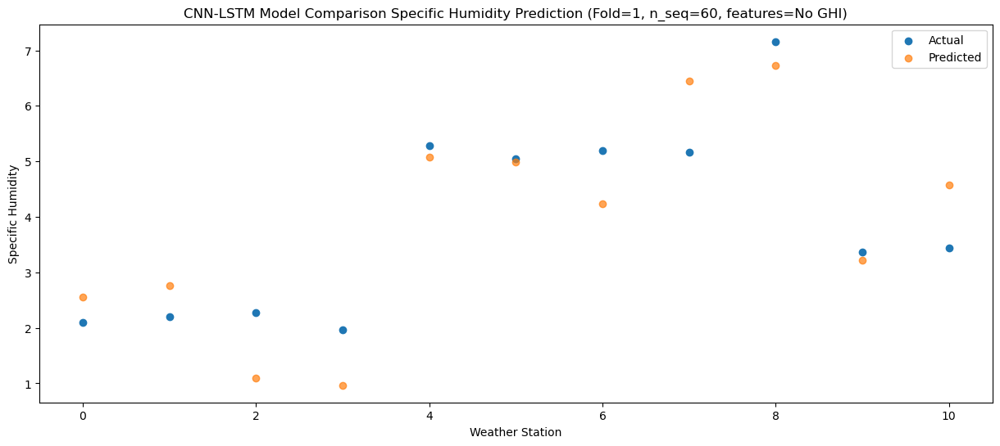

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_1 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_3 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_2 (LSTM)               (None, 1, 512)            3147776   
                                                                 
 dropout_4 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_3 (LSTM)               (None, 512)               2099200   
                                                      

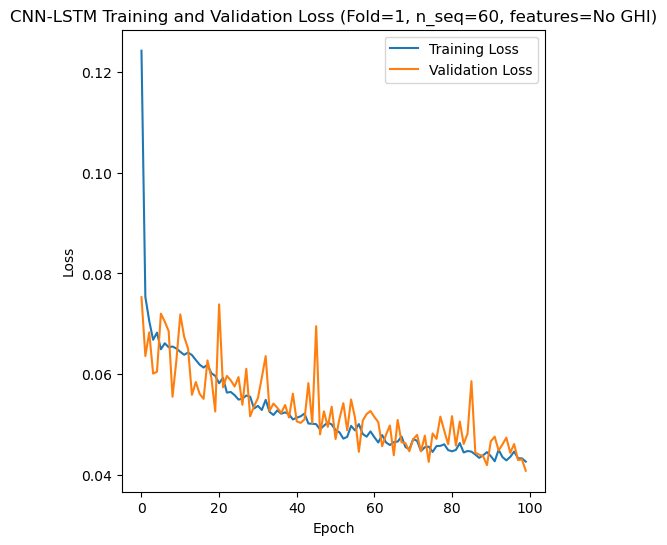

Epoch 1/100
84/84 [==============================] - 5s 64ms/step - loss: 0.0560 - accuracy: 0.5833 - mae: 0.0441 - rmse: 0.0560 - mape: 9.9793 - pearson: 0.8236 - val_loss: 0.0447 - val_accuracy: 0.8000 - val_mae: 0.0347 - val_rmse: 0.0447 - val_mape: 7.8150 - val_pearson: 0.9249
Epoch 29/100
84/84 [==============================] - 5s 61ms/step - loss: 0.0545 - accuracy: 0.5476 - mae: 0.0426 - rmse: 0.0545 - mape: 9.5889 - pearson: 0.8246 - val_loss: 0.0411 - val_accuracy: 0.8000 - val_mae: 0.0323 - val_rmse: 0.0411 - val_mape: 7.1751 - val_pearson: 0.9257
Epoch 30/100
84/84 [==============================] - 5s 65ms/step - loss: 0.0539 - accuracy: 0.5238 - mae: 0.0427 - rmse: 0.0539 - mape: 9.6708 - pearson: 0.8311 - val_loss: 0.0393 - val_accuracy: 0.8000 - val_mae: 0.0300 - val_rmse: 0.0393 - val_mape: 7.0745 - val_pearson: 0.9308
Epoch 31/100
84/84 [==============================] - 5s 62ms/step - loss: 0.0550 - accuracy: 0.5595 - mae: 0.0430 - rmse: 0.0550 - mape: 9.7306 - pears

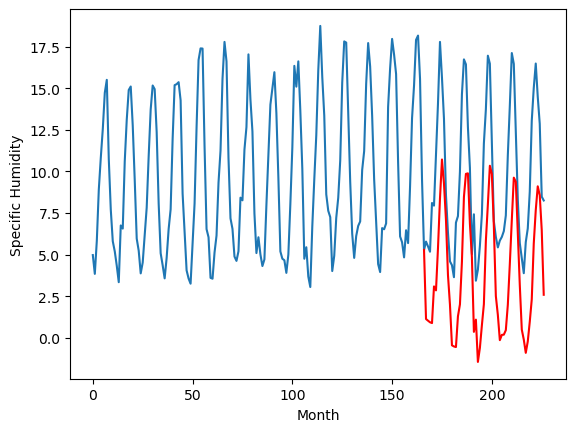

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.26		0.94		0.68
-0.25		0.51		0.76
-0.27		0.43		0.70
-0.21		0.05		0.26
1.58		1.53		-0.05
1.87		1.80		-0.07
4.77		3.84		-0.93
6.19		5.67		-0.52
11.00		7.11		-3.89
9.57		5.78		-3.79
5.51		4.13		-1.38
1.78		1.31		-0.47
1.56		0.53		-1.03
-0.17		-0.82		-0.65
-0.22		-0.83		-0.61
-0.90		-1.29		-0.39
0.95		-0.14		-1.09
1.07		0.34		-0.73
6.19		2.44		-3.75
9.10		5.07		-4.03
10.71		6.18		-4.53
9.09		5.76		-3.33
6.27		3.48		-2.79
2.88		1.80		-1.08
0.45		-0.23		-0.68
-0.61		-1.20		-0.59
-0.94		-2.04		-1.10
-1.03		-1.81		-0.78
-0.15		-0.45		-0.30
1.00		0.11		-0.89
3.39		2.54		-0.85
7.75		4.66		-3.09
9.09		6.45		-2.64
8.59		6.15		-2.44
6.02		3.57		-2.45
2.34		0.94		-1.40
0.84		-1.16		-2.00
-0.35		-1.95		-1.60
-0.36		-1.63		-1.27
-0.44		-2.21		-1.77
0.25		-1.64		-1.89
0.87		-0.67		-1.54
6.65		2.19		-4.46
9.30		3.78		-5.52
11.36		4.80		-6.56
9.47		5.22		-4.25
6.88		2.82		-4.06
3.42		0.69		-2.73
0.86		-1.38		-

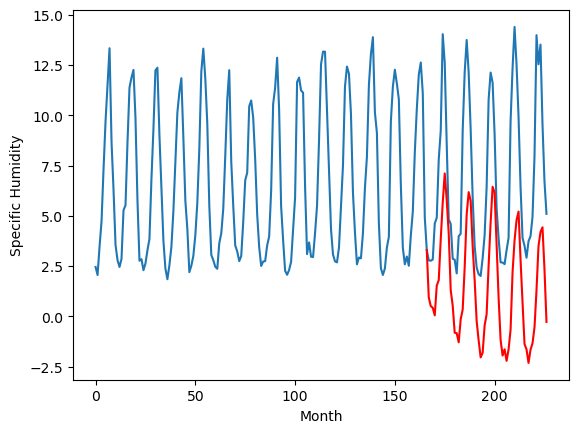

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.12		0.81		0.69
0.43		1.27		0.84
-1.13		1.10		2.23
-0.25		1.26		1.51
0.92		3.22		2.30
2.40		2.91		0.51
3.51		4.38		0.87
6.85		6.80		-0.05
7.87		8.17		0.30
8.57		8.45		-0.12
7.87		7.17		-0.70
5.28		5.15		-0.13
2.33		2.23		-0.10
-2.34		-0.73		1.61
-1.85		-0.67		1.18
0.28		0.00		-0.28
0.50		0.91		0.41
1.47		1.31		-0.16
2.78		3.16		0.38
6.56		6.75		0.19
6.96		7.90		0.94
7.58		8.10		0.52
6.30		6.21		-0.09
3.64		4.32		0.68
-0.31		0.21		0.52
1.09		1.52		0.43
-2.56		-1.25		1.31
-1.37		-0.06		1.31
0.44		1.16		0.72
1.80		1.82		0.02
4.90		4.80		-0.10
6.83		6.61		-0.22
7.66		8.99		1.33
7.55		8.48		0.93
7.40		6.19		-1.21
3.01		2.72		-0.29
2.90		1.54		-1.36
-0.76		0.05		0.81
-1.14		0.34		1.48
0.71		0.68		-0.03
1.10		0.57		-0.53
2.61		2.15		-0.46
3.42		3.32		-0.10
6.58		5.38		-1.20
7.55		7.99		0.44
8.27		8.04		-0.23
5.88		5.44		-0.44
2.96		2.73		-0.23
0.46		0.50		0.04
-0.11		-0.23		-0.12
-1.18		-0.57		0.61

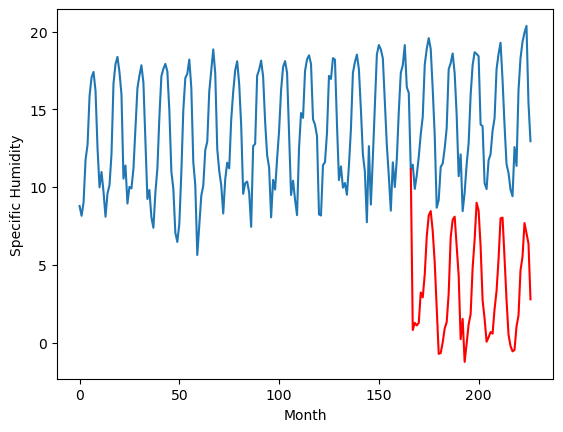

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.77		2.09		1.32
0.21		2.23		2.02
0.03		2.01		1.98
0.05		1.87		1.82
0.57		2.71		2.14
0.95		2.99		2.04
3.20		5.22		2.02
7.21		7.99		0.78
10.59		10.23		-0.36
9.76		9.46		-0.30
6.67		7.15		0.48
4.16		4.82		0.66
2.29		3.14		0.85
0.37		1.46		1.09
-0.71		1.07		1.78
-0.54		0.95		1.49
0.10		1.77		1.67
1.45		2.86		1.41
3.13		4.06		0.93
7.73		8.20		0.47
10.33		9.55		-0.78
11.07		10.18		-0.89
8.41		7.54		-0.87
5.45		6.31		0.86
1.00		2.26		1.26
0.64		1.72		1.08
-0.69		0.69		1.38
-0.12		1.41		1.53
0.64		2.65		2.01
1.34		2.66		1.32
4.64		5.67		1.03
6.90		7.33		0.43
10.26		10.46		0.20
10.94		10.20		-0.74
7.14		7.78		0.64
4.27		4.46		0.19
2.45		2.81		0.36
0.36		1.40		1.04
0.87		2.18		1.31
0.11		1.39		1.28
0.36		1.37		1.01
2.44		3.39		0.95
3.25		3.86		0.61
7.15		6.32		-0.83
11.41		9.85		-1.56
9.07		9.43		0.36
8.06		7.55		-0.51
4.70		5.10		0.40
0.87		2.11		1.24
1.16		2.63		1.47
-0.17		1.91		2.08
-0.22		1.77		1

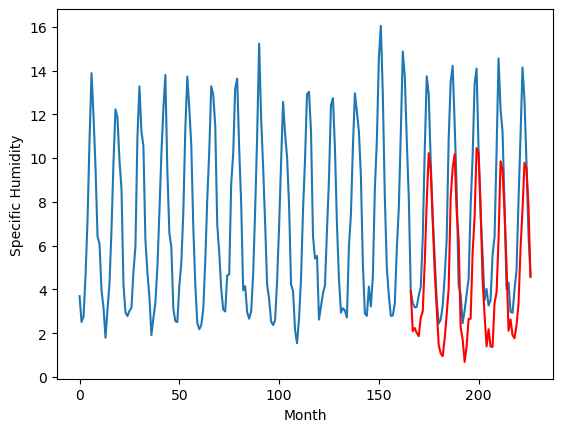

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.79		0.45		1.24
0.01		0.70		0.69
0.04		0.59		0.55
0.36		0.77		0.41
3.85		3.30		-0.55
2.89		2.77		-0.12
5.01		4.77		-0.24
8.35		7.58		-0.77
10.48		9.44		-1.04
9.75		8.94		-0.81
7.95		7.31		-0.64
4.74		4.54		-0.20
2.01		1.80		-0.21
-1.27		-1.35		-0.08
-1.14		-1.27		-0.13
-1.16		-0.74		0.42
2.13		0.85		-1.28
2.15		1.27		-0.88
5.35		3.81		-1.54
9.24		7.60		-1.64
10.27		8.88		-1.39
9.87		8.90		-0.97
7.73		6.42		-1.31
5.20		4.23		-0.97
-0.46		-0.46		0.00
2.82		1.27		-1.55
-2.09		-2.09		-0.00
-0.63		-0.91		-0.28
0.22		0.38		0.16
2.65		1.69		-0.96
6.68		5.36		-1.32
8.98		7.45		-1.53
10.27		9.66		-0.61
10.67		9.06		-1.61
7.16		6.18		-0.98
1.98		2.00		0.02
1.54		1.14		-0.40
0.99		-0.52		-1.51
0.90		-0.35		-1.25
2.20		0.19		-2.01
3.08		0.24		-2.84
3.63		1.75		-1.88
6.69		3.83		-2.86
10.00		6.30		-3.70
11.34		8.84		-2.50
11.37		8.72		-2.65
9.02		5.54		-3.48
3.79		2.34		-1.45
1.27		-0.04		-1.31
-0.32		-

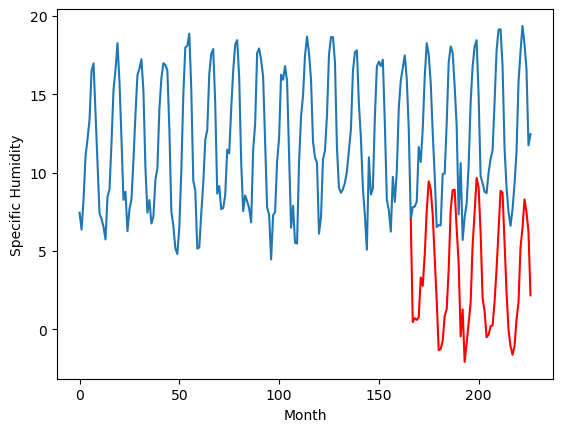

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.21		-0.61		0.60
-2.40		-0.69		1.71
-1.57		-0.77		0.80
-2.24		-0.82		1.42
2.37		1.51		-0.86
1.85		1.24		-0.61
3.93		3.36		-0.57
6.05		5.81		-0.24
8.63		7.57		-1.06
7.19		6.53		-0.66
5.74		4.90		-0.84
1.87		1.89		0.02
-0.19		0.01		0.20
-2.51		-2.49		0.02
-2.64		-2.40		0.24
-2.69		-2.29		0.40
0.30		-0.68		-0.98
1.87		-0.28		-2.15
6.70		2.34		-4.36
9.34		5.63		-3.71
8.30		6.87		-1.43
8.43		6.62		-1.81
4.87		4.10		-0.77
3.28		1.98		-1.30
-0.91		-1.68		-0.77
1.96		-0.89		-2.85
-3.67		-3.43		0.24
-3.45		-2.65		0.80
-1.83		-1.32		0.51
2.13		-0.07		-2.20
5.78		3.24		-2.54
6.81		5.43		-1.38
7.91		7.32		-0.59
8.37		6.82		-1.55
5.01		3.91		-1.10
0.19		0.21		0.02
0.05		-1.07		-1.12
-0.86		-2.37		-1.51
-1.24		-2.22		-0.98
-0.79		-2.04		-1.25
0.99		-1.71		-2.70
1.54		-0.49		-2.03
5.24		2.30		-2.94
8.70		4.46		-4.24
8.41		6.21		-2.20
6.98		6.31		-0.67
6.43		3.26		-3.17
2.90		0.41		-2.49
-0.27		-1.82		-1.5

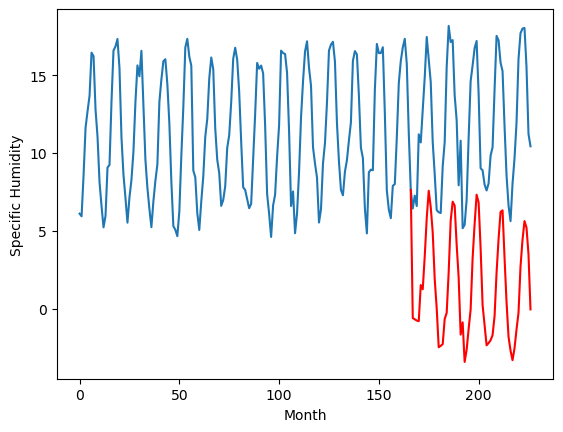

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.57		6.15		0.58
4.47		5.88		1.41
5.15		5.82		0.67
4.59		5.69		1.10
8.81		7.99		-0.82
8.39		7.80		-0.59
11.33		10.16		-1.17
13.61		12.66		-0.95
16.52		14.60		-1.92
13.82		13.11		-0.71
12.88		11.27		-1.61
8.39		7.98		-0.41
6.80		6.51		-0.29
4.09		4.25		0.16
3.99		4.31		0.32
3.66		4.19		0.53
6.52		5.98		-0.54
7.84		6.44		-1.40
12.04		9.21		-2.83
15.79		12.45		-3.34
16.61		13.73		-2.88
16.99		13.38		-3.61
12.54		10.64		-1.90
9.93		8.52		-1.41
5.94		5.00		-0.94
8.44		5.45		-2.99
3.15		3.14		-0.01
3.62		3.78		0.16
5.25		5.16		-0.09
9.15		6.50		-2.65
13.24		9.91		-3.33
14.04		12.18		-1.86
13.36		14.02		0.66
14.42		13.55		-0.87
11.75		10.47		-1.28
6.97		6.74		-0.23
6.52		5.36		-1.16
5.35		4.12		-1.23
4.57		4.27		-0.30
4.97		4.30		-0.67
6.88		4.76		-2.12
7.55		5.92		-1.63
11.44		9.07		-2.37
15.34		11.28		-4.06
14.63		12.87		-1.76
12.58		12.97		0.39
11.95		9.87		-2.08
8.80		7.00		-1.80
6.18		4.71		-1.

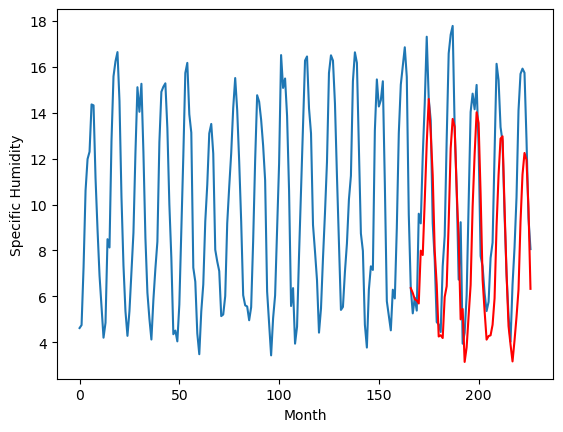

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.62		2.99		0.37
2.17		2.93		0.76
1.22		2.78		1.56
1.75		2.42		0.67
3.21		3.35		0.14
1.81		3.77		1.96
2.05		4.89		2.84
3.73		5.96		2.23
7.17		6.49		-0.68
5.44		6.44		1.00
4.79		5.60		0.81
1.72		3.86		2.14
1.77		2.60		0.83
0.51		1.28		0.77
0.79		1.34		0.55
0.66		1.22		0.56
0.75		1.43		0.68
1.05		1.67		0.62
1.17		2.94		1.77
3.83		5.11		1.28
9.07		5.95		-3.12
9.36		5.66		-3.70
6.60		4.40		-2.20
2.89		3.01		0.12
1.24		1.94		0.70
1.37		0.77		-0.60
1.09		0.41		-0.68
0.10		0.65		0.55
0.50		1.87		1.37
0.51		1.63		1.12
0.44		2.96		2.52
5.94		4.68		-1.26
8.50		6.45		-2.05
10.47		6.24		-4.23
7.43		4.47		-2.96
5.35		2.89		-2.46
1.38		0.45		-0.93
2.20		-0.05		-2.25
1.31		0.34		-0.97
1.19		-0.35		-1.54
1.53		0.00		-1.53
0.69		0.92		0.23
2.69		2.76		0.07
2.49		3.60		1.11
5.84		4.41		-1.43
8.03		5.11		-2.92
6.22		3.37		-2.85
3.77		1.93		-1.84
2.85		0.25		-2.60
1.33		0.15		-1.18
1.75		-0.17		-1.92
1.77		-0.04

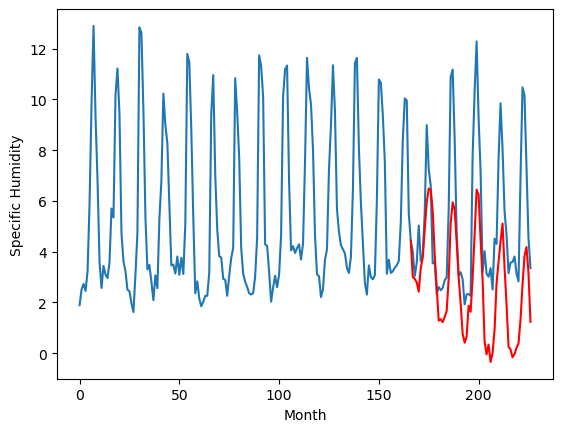

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
7.78		7.36		-0.42
7.60		7.47		-0.13
7.39		7.28		-0.11
6.67		6.86		0.19
8.31		7.23		-1.08
9.72		7.85		-1.87
10.48		8.32		-2.16
10.46		8.71		-1.75
11.23		8.54		-2.69
12.31		9.31		-3.00
10.53		9.03		-1.50
9.40		8.09		-1.31
7.16		6.71		-0.45
5.59		5.66		0.07
6.44		5.74		-0.70
6.97		5.72		-1.25
7.08		5.20		-1.88
8.40		5.27		-3.13
9.88		5.86		-4.02
11.13		7.55		-3.58
12.28		8.15		-4.13
11.68		7.90		-3.78
11.22		7.40		-3.82
8.42		6.30		-2.12
7.88		6.25		-1.63
7.70		4.56		-3.14
6.34		4.88		-1.46
5.60		5.02		-0.58
7.34		6.15		-1.19
8.18		5.21		-2.97
9.44		5.59		-3.85
11.21		7.00		-4.21
12.10		8.72		-3.38
12.20		8.61		-3.59
13.05		7.46		-5.59
11.28		6.84		-4.44
6.64		3.99		-2.65
7.49		3.80		-3.69
7.58		4.25		-3.33
6.17		3.34		-2.83
8.09		3.58		-4.51
8.79		4.39		-4.40
10.19		5.54		-4.65
10.57		5.72		-4.85
11.91		6.21		-5.70
12.52		7.20		-5.32
12.27		6.03		-6.24
9.97		5.20		-4.77
6.94		3.83		-3.11
7.73		

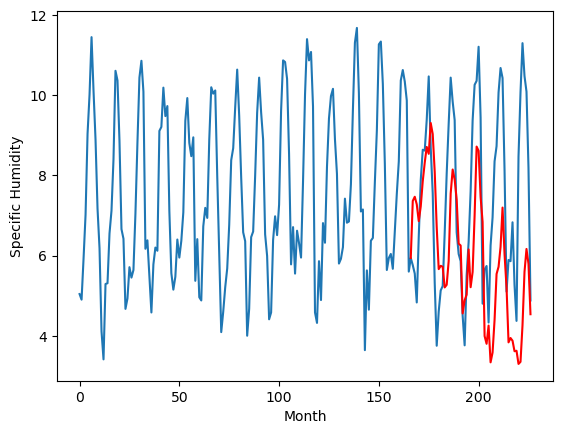

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.89		1.89		1.00
1.00		2.14		1.14
0.98		1.96		0.98
1.37		2.02		0.65
3.00		3.71		0.71
2.91		3.54		0.63
6.24		5.82		-0.42
9.75		8.92		-0.83
12.60		11.25		-1.35
12.59		10.55		-2.04
8.87		8.33		-0.54
6.25		5.68		-0.57
3.60		3.35		-0.25
0.38		0.84		0.46
0.26		0.63		0.37
0.33		0.85		0.52
2.06		2.16		0.10
2.59		3.06		0.47
5.30		4.91		-0.39
9.80		9.24		-0.56
11.32		10.64		-0.68
11.90		11.15		-0.75
8.30		8.36		0.06
6.14		6.68		0.54
0.58		1.75		1.17
2.43		2.51		0.08
-0.35		0.15		0.50
0.96		1.22		0.26
1.92		2.48		0.56
2.96		3.16		0.20
7.28		6.82		-0.46
9.08		8.70		-0.38
12.66		11.63		-1.03
11.09		11.17		0.08
7.66		8.42		0.76
3.30		4.35		1.05
2.83		3.25		0.42
0.59		1.55		0.96
1.45		2.11		0.66
2.21		2.01		-0.20
1.90		1.95		0.05
4.03		3.91		-0.12
5.56		4.92		-0.64
8.42		7.67		-0.75
12.26		11.19		-1.07
11.77		10.73		-1.04
8.63		8.15		-0.48
4.44		5.13		0.69
1.33		2.22		0.89
1.24		2.05		0.81
0.55		1.37		0.82

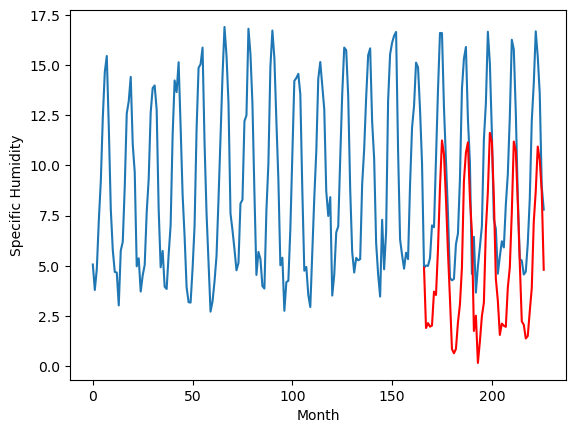

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.08		0.50		0.42
0.53		0.71		0.18
0.33		0.54		0.21
0.44		0.57		0.13
2.29		2.25		-0.04
1.72		2.11		0.39
4.51		4.46		-0.05
7.95		7.58		-0.37
10.65		9.96		-0.69
10.41		9.14		-1.27
7.80		6.86		-0.94
4.61		4.12		-0.49
1.49		1.90		0.41
-0.30		-0.56		-0.26
-0.29		-0.78		-0.49
-0.05		-0.62		-0.57
0.98		0.75		-0.23
1.59		1.68		0.09
4.26		3.55		-0.71
8.36		7.89		-0.47
9.77		9.31		-0.46
10.16		9.81		-0.35
6.95		6.95		0.00
5.22		5.27		0.05
-0.14		0.34		0.48
1.42		1.03		-0.39
-1.00		-1.27		-0.27
-0.10		-0.24		-0.14
0.52		1.03		0.51
1.79		1.73		-0.06
5.95		5.42		-0.53
7.91		7.32		-0.59
11.12		10.24		-0.88
10.13		9.80		-0.33
6.65		7.01		0.36
1.99		2.91		0.92
1.37		1.79		0.42
0.28		0.11		-0.17
0.55		0.68		0.13
0.95		0.53		-0.42
0.55		0.50		-0.05
2.19		2.45		0.26
4.78		3.53		-1.25
6.62		6.31		-0.31
9.93		9.81		-0.12
10.04		9.34		-0.70
7.62		6.74		-0.88
3.51		3.72		0.21
0.56		0.78		0.22
0.35		0.63		0.28
-0.27

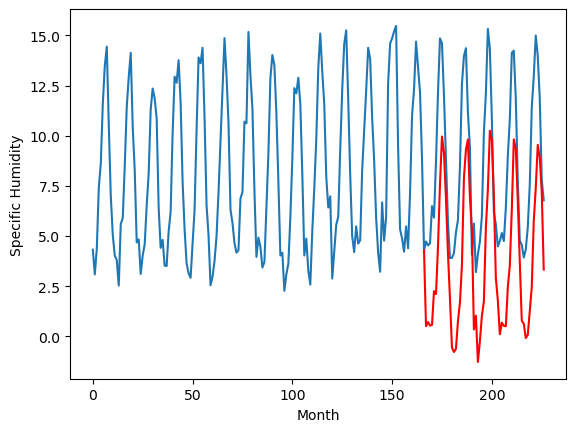

RangeIndex(start=1, stop=12, step=1)
[0.41000000000000014, 0.26000000000000045, 0.1200000000000001, 0.7699999999999987, -0.79, -1.2099999999999995, 5.569999999999999, 2.62, 7.780000000000001, 0.8900000000000006, 0.08000000000000007]
[1.1258865547180177, 0.9418012046813964, 0.8084555053710938, 2.093511161804199, 0.4507333946228025, -0.6142149353027344, 6.147649316787719, 2.994754137992859, 7.363926338553429, 1.8906212806701657, 0.5044494819641114]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.41   1.125887
1                 1    0.26   0.941801
2                 2    0.12   0.808456
3                 3    0.77   2.093511
4                 4   -0.79   0.450733
5                 5   -1.21  -0.614215
6                 6    5.57   6.147649
7                 7    2.62   2.994754
8                 8    7.78   7.363926
9                 9    0.89   1.890621
10               10    0.08   0.504449


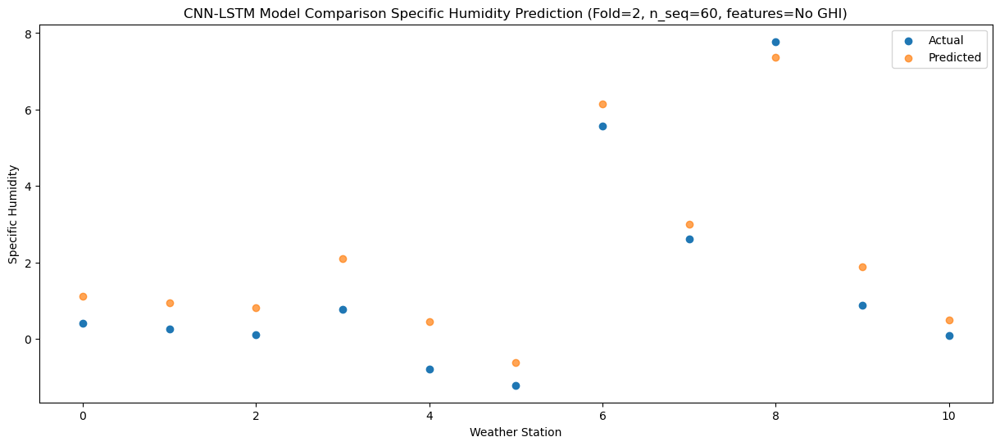

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.91   1.027006
1                 1   -0.25   0.513875
2                 2    0.43   1.267173
3                 3    0.21   2.234921
4                 4    0.01   0.702471
5                 5   -2.40  -0.692985
6                 6    4.47   5.879696
7                 7    2.17   2.931252
8                 8    7.60   7.467299
9                 9    1.00   2.136885
10               10    0.53   0.711669


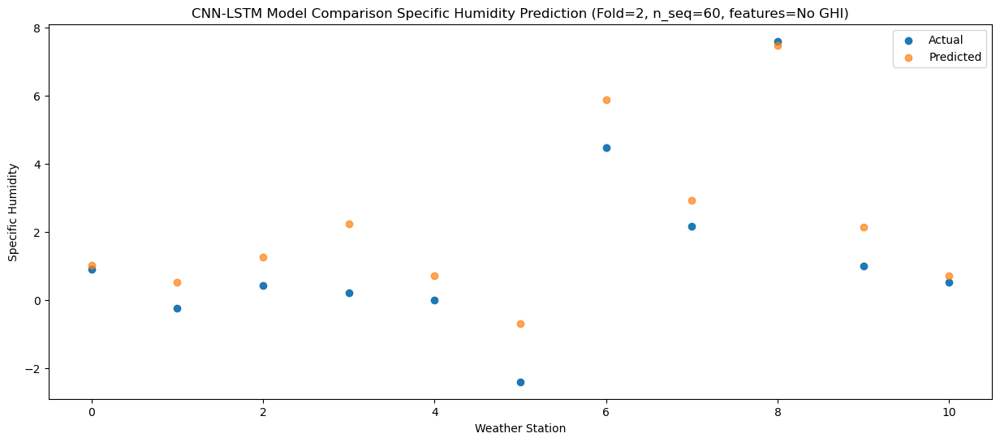

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.62   0.931049
1                 1   -0.27   0.431491
2                 2   -1.13   1.100738
3                 3    0.03   2.007761
4                 4    0.04   0.591090
5                 5   -1.57  -0.773990
6                 6    5.15   5.818271
7                 7    1.22   2.783724
8                 8    7.39   7.278323
9                 9    0.98   1.958063
10               10    0.33   0.536204


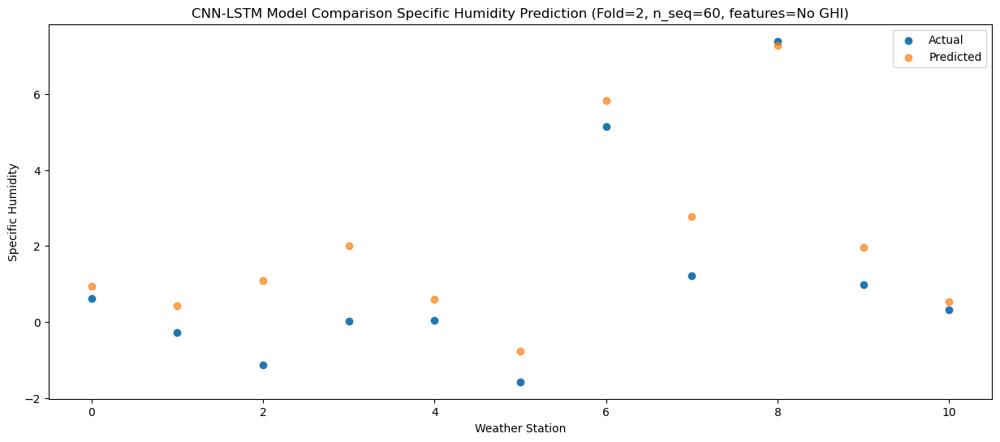

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.30   0.884729
1                 1   -0.21   0.051666
2                 2   -0.25   1.263312
3                 3    0.05   1.865792
4                 4    0.36   0.767631
5                 5   -2.24  -0.815117
6                 6    4.59   5.690085
7                 7    1.75   2.424321
8                 8    6.67   6.858747
9                 9    1.37   2.017982
10               10    0.44   0.572150


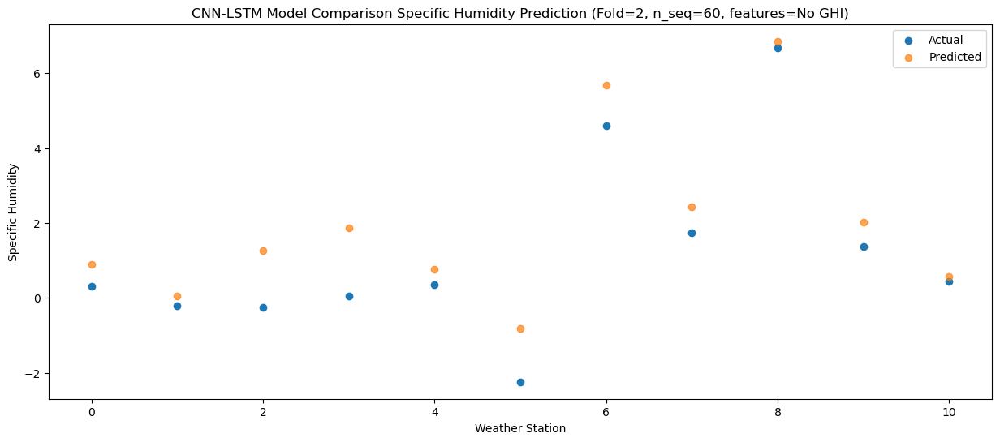

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.23   3.087646
1                 1    1.58   1.530988
2                 2    0.92   3.220733
3                 3    0.57   2.711462
4                 4    3.85   3.295541
5                 5    2.37   1.507675
6                 6    8.81   7.991959
7                 7    3.21   3.352114
8                 8    8.31   7.226272
9                 9    3.00   3.706061
10               10    2.29   2.252452


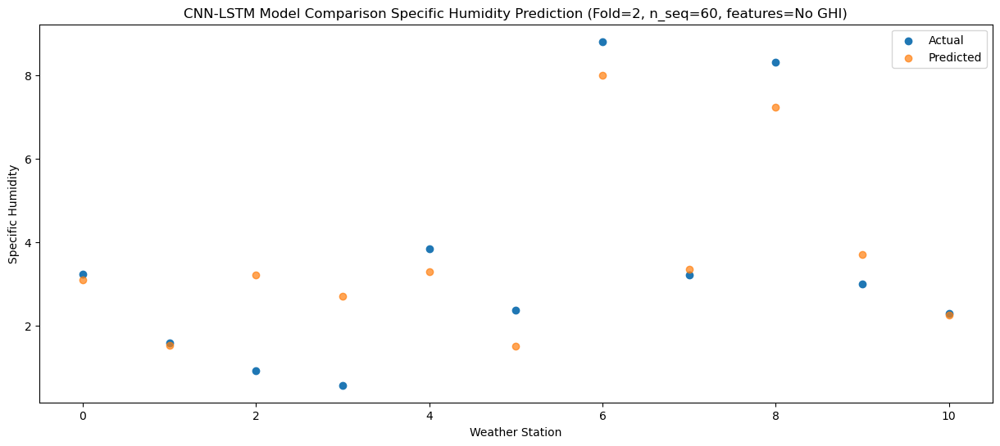

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.07   2.847077
1                 1    1.87   1.802806
2                 2    2.40   2.905395
3                 3    0.95   2.992136
4                 4    2.89   2.765794
5                 5    1.85   1.237024
6                 6    8.39   7.800860
7                 7    1.81   3.765184
8                 8    9.72   7.854723
9                 9    2.91   3.538694
10               10    1.72   2.105526


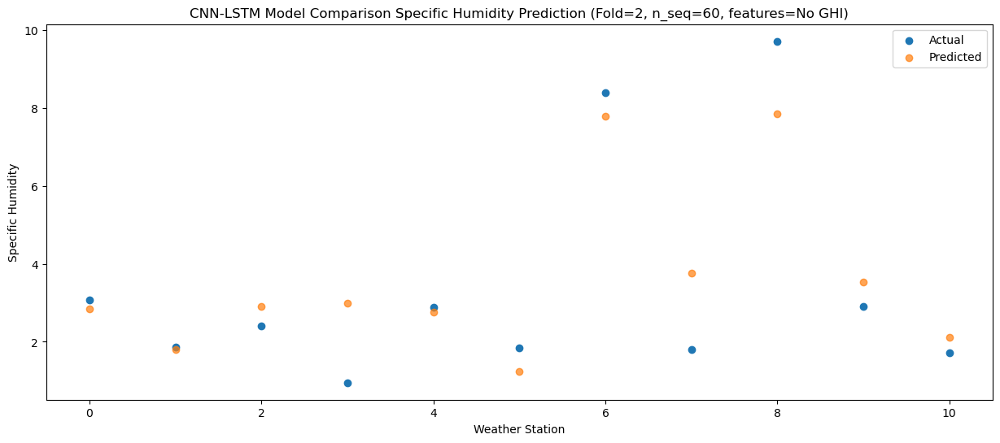

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.06   5.396205
1                 1    4.77   3.837250
2                 2    3.51   4.376076
3                 3    3.20   5.216486
4                 4    5.01   4.765765
5                 5    3.93   3.360804
6                 6   11.33  10.161383
7                 7    2.05   4.892690
8                 8   10.48   8.318448
9                 9    6.24   5.822926
10               10    4.51   4.456517


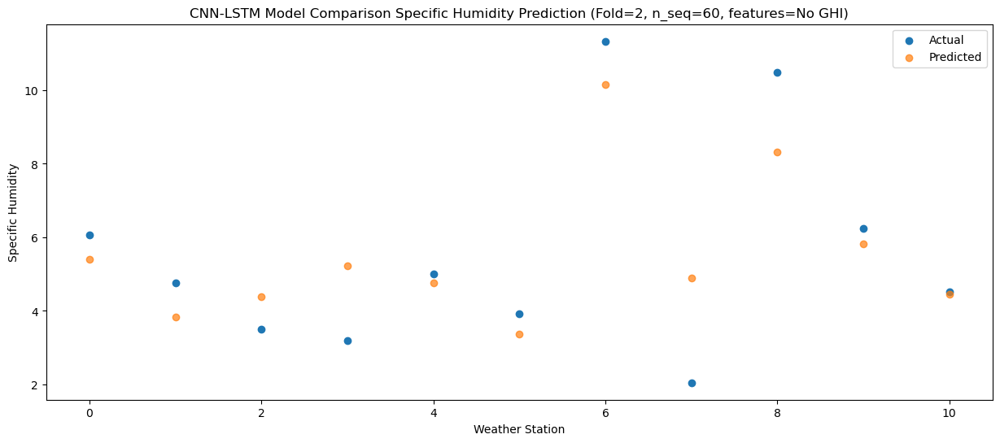

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.21   8.371763
1                 1    6.19   5.669189
2                 2    6.85   6.804316
3                 3    7.21   7.994030
4                 4    8.35   7.579841
5                 5    6.05   5.808170
6                 6   13.61  12.663970
7                 7    3.73   5.956333
8                 8   10.46   8.710960
9                 9    9.75   8.922308
10               10    7.95   7.579250


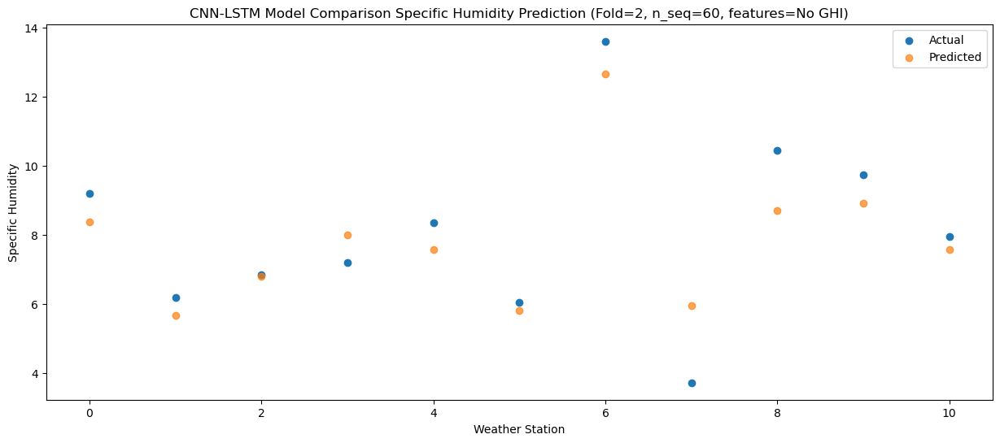

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.91  10.712892
1                 1   11.00   7.111648
2                 2    7.87   8.172854
3                 3   10.59  10.226331
4                 4   10.48   9.442622
5                 5    8.63   7.573082
6                 6   16.52  14.595943
7                 7    7.17   6.489573
8                 8   11.23   8.537865
9                 9   12.60  11.245758
10               10   10.65   9.957158


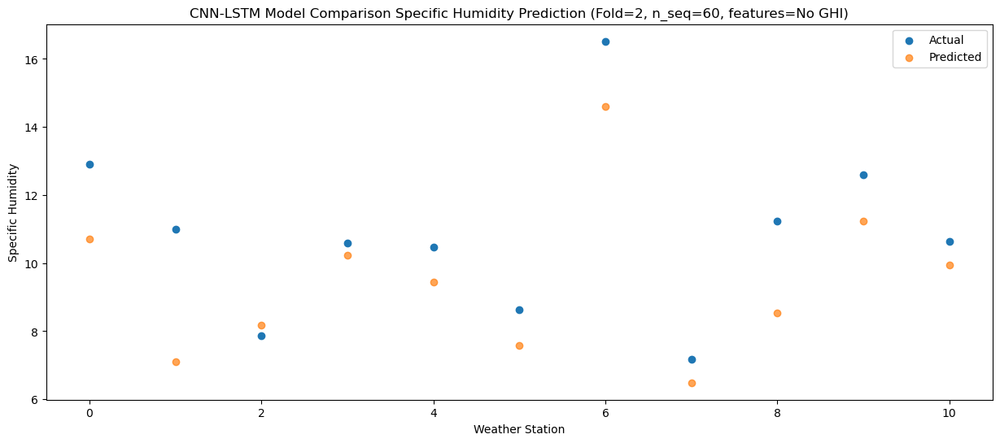

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.75   9.269964
1                 1    9.57   5.784860
2                 2    8.57   8.454894
3                 3    9.76   9.462005
4                 4    9.75   8.940521
5                 5    7.19   6.526493
6                 6   13.82  13.108298
7                 7    5.44   6.436170
8                 8   12.31   9.307344
9                 9   12.59  10.551738
10               10   10.41   9.141796


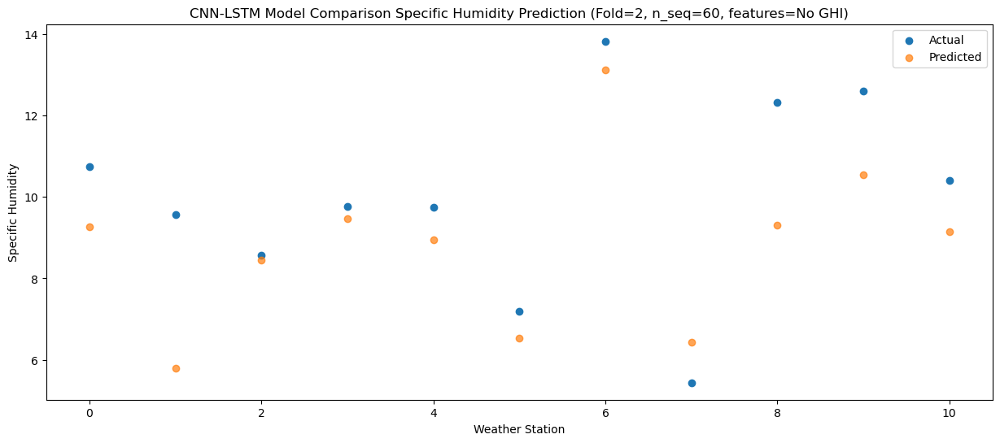

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.29   7.075035
1                 1    5.51   4.134472
2                 2    7.87   7.173906
3                 3    6.67   7.145768
4                 4    7.95   7.308769
5                 5    5.74   4.898148
6                 6   12.88  11.272194
7                 7    4.79   5.602976
8                 8   10.53   9.032054
9                 9    8.87   8.330812
10               10    7.80   6.859062


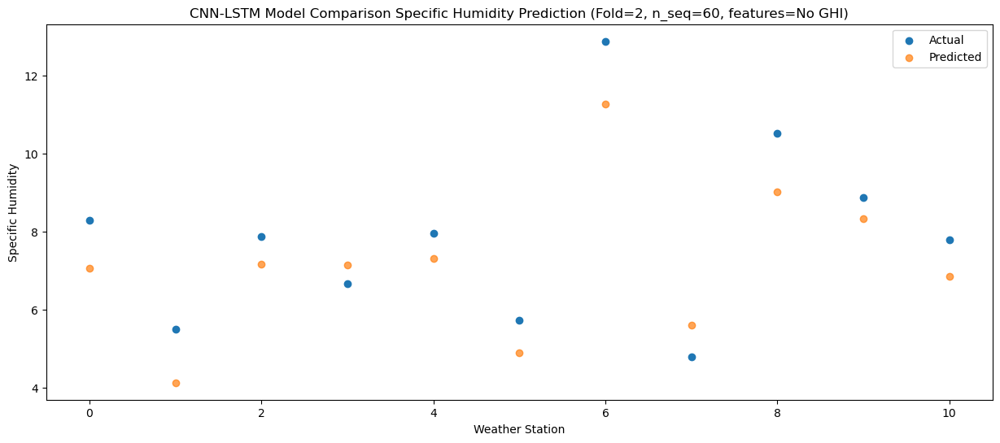

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.70   3.775503
1                 1    1.78   1.307231
2                 2    5.28   5.154084
3                 3    4.16   4.818927
4                 4    4.74   4.537877
5                 5    1.87   1.891411
6                 6    8.39   7.979567
7                 7    1.72   3.864862
8                 8    9.40   8.088993
9                 9    6.25   5.678073
10               10    4.61   4.123557


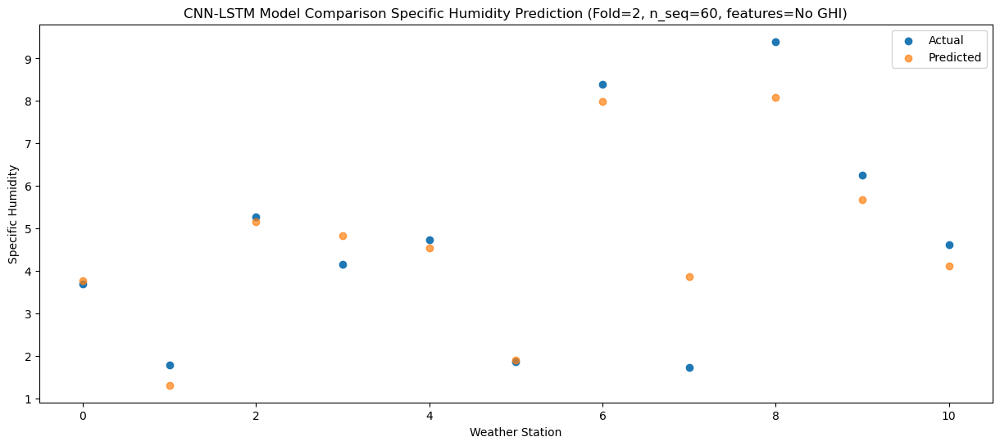

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.45   1.991118
1                 1    1.56   0.533120
2                 2    2.33   2.226980
3                 3    2.29   3.135084
4                 4    2.01   1.803835
5                 5   -0.19   0.014237
6                 6    6.80   6.507084
7                 7    1.77   2.597460
8                 8    7.16   6.710154
9                 9    3.60   3.351270
10               10    1.49   1.896476


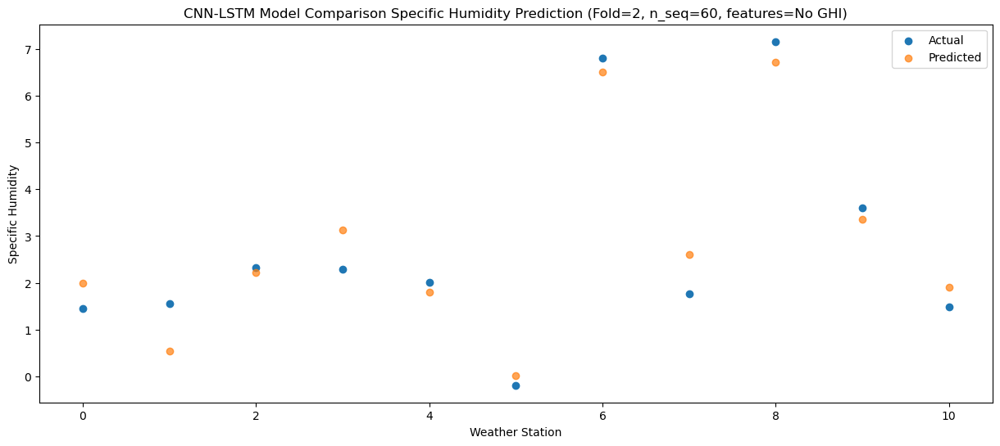

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.28  -0.453776
1                 1   -0.17  -0.815790
2                 2   -2.34  -0.725179
3                 3    0.37   1.456612
4                 4   -1.27  -1.345205
5                 5   -2.51  -2.489841
6                 6    4.09   4.252127
7                 7    0.51   1.284865
8                 8    5.59   5.661970
9                 9    0.38   0.842686
10               10   -0.30  -0.556085


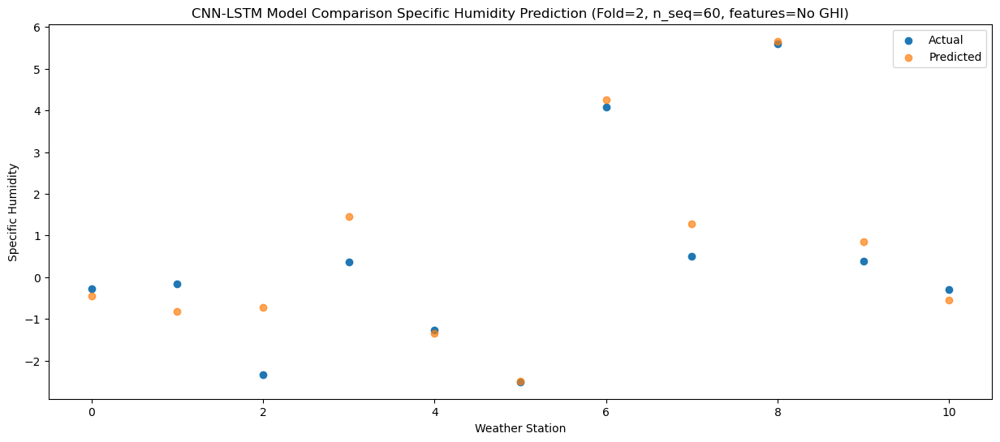

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.51  -0.521568
1                 1   -0.22  -0.834109
2                 2   -1.85  -0.673679
3                 3   -0.71   1.074031
4                 4   -1.14  -1.267929
5                 5   -2.64  -2.401369
6                 6    3.99   4.306999
7                 7    0.79   1.337523
8                 8    6.44   5.743693
9                 9    0.26   0.633247
10               10   -0.29  -0.778093


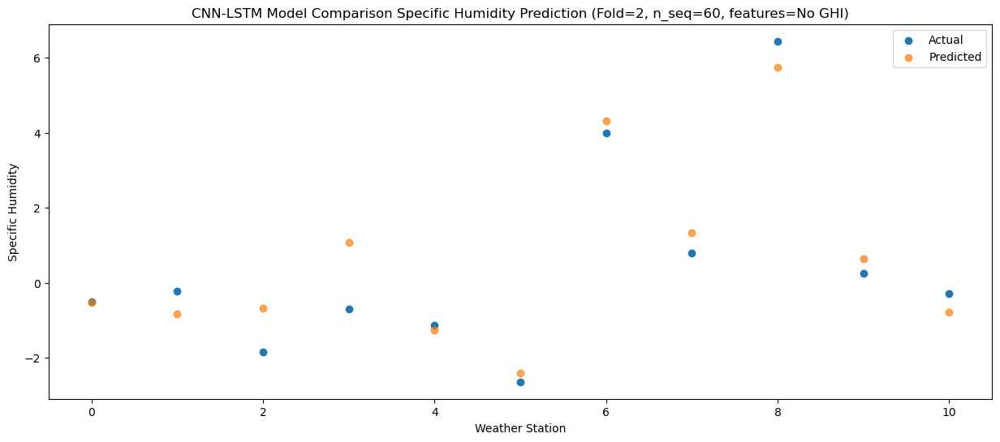

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -0.557634
1                 1   -0.90  -1.287895
2                 2    0.28   0.000691
3                 3   -0.54   0.949187
4                 4   -1.16  -0.740441
5                 5   -2.69  -2.294734
6                 6    3.66   4.185577
7                 7    0.66   1.219653
8                 8    6.97   5.721085
9                 9    0.33   0.848806
10               10   -0.05  -0.620727


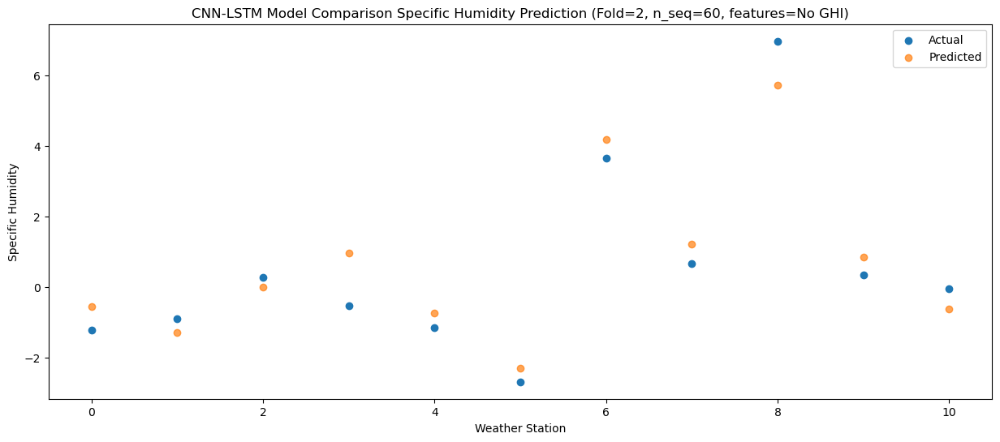

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.05   1.288731
1                 1    0.95  -0.143365
2                 2    0.50   0.911448
3                 3    0.10   1.765150
4                 4    2.13   0.850550
5                 5    0.30  -0.675736
6                 6    6.52   5.975811
7                 7    0.75   1.433044
8                 8    7.08   5.204897
9                 9    2.06   2.164179
10               10    0.98   0.749611


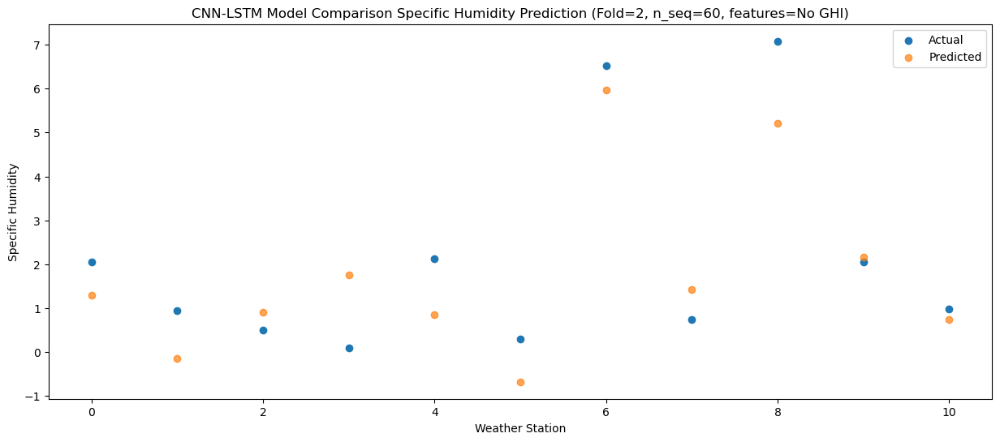

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.44   2.003603
1                 1    1.07   0.341318
2                 2    1.47   1.306865
3                 3    1.45   2.856611
4                 4    2.15   1.267008
5                 5    1.87  -0.280022
6                 6    7.84   6.441278
7                 7    1.05   1.666275
8                 8    8.40   5.270475
9                 9    2.59   3.064799
10               10    1.59   1.677930


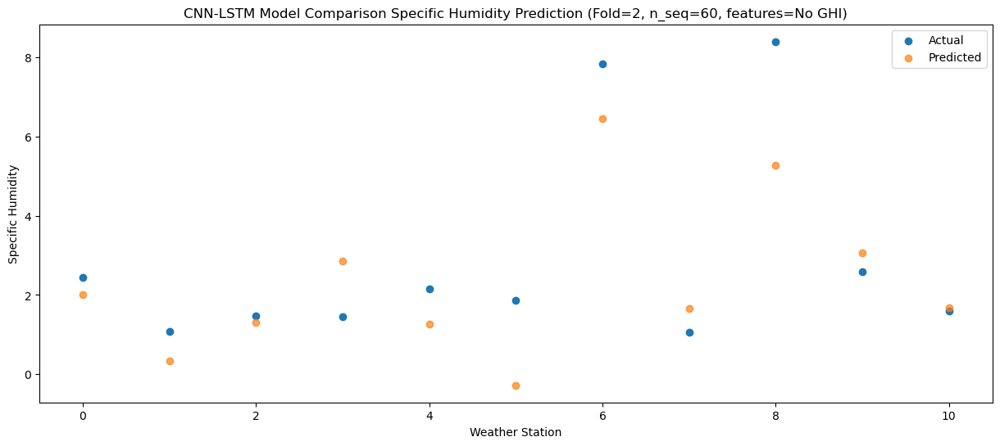

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.11   4.574873
1                 1    6.19   2.442134
2                 2    2.78   3.155537
3                 3    3.13   4.056855
4                 4    5.35   3.812614
5                 5    6.70   2.344826
6                 6   12.04   9.205065
7                 7    1.17   2.944719
8                 8    9.88   5.863915
9                 9    5.30   4.910469
10               10    4.26   3.552543


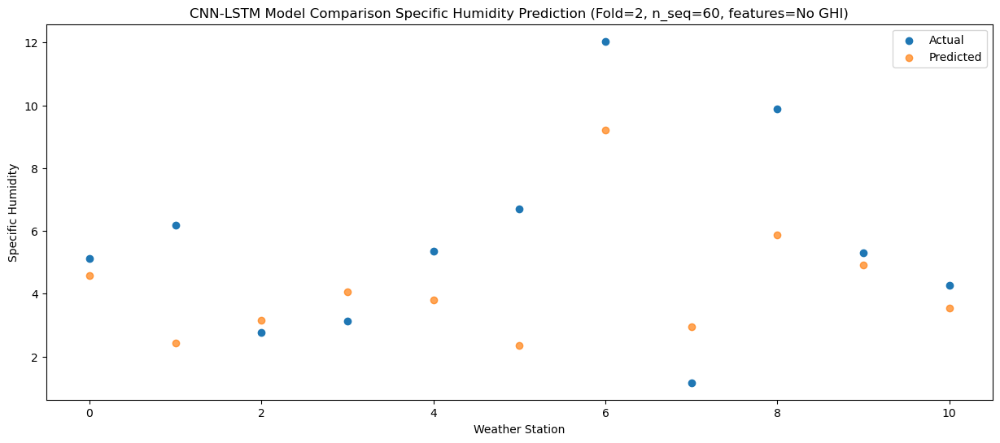

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    9.76   8.459001
1                 1    9.10   5.074568
2                 2    6.56   6.751011
3                 3    7.73   8.198953
4                 4    9.24   7.598808
5                 5    9.34   5.633954
6                 6   15.79  12.449394
7                 7    3.83   5.114379
8                 8   11.13   7.547630
9                 9    9.80   9.235398
10               10    8.36   7.889195


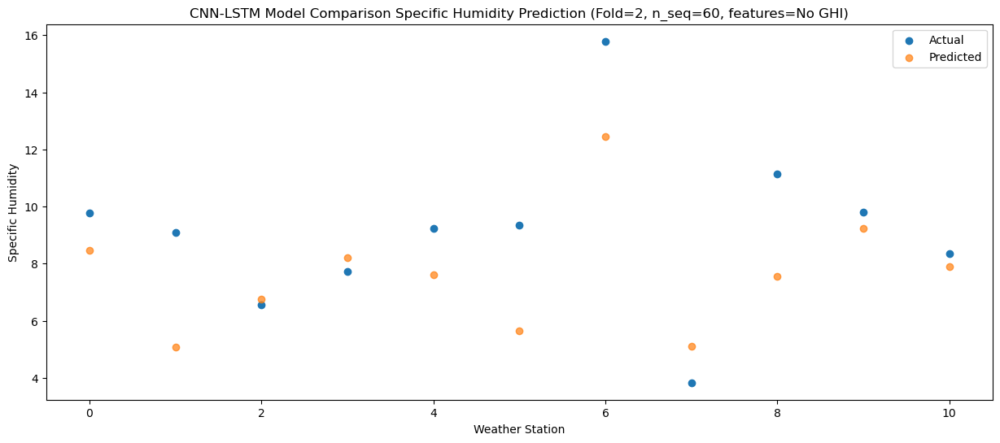

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.86   9.848565
1                 1   10.71   6.182158
2                 2    6.96   7.898419
3                 3   10.33   9.550840
4                 4   10.27   8.877673
5                 5    8.30   6.869059
6                 6   16.61  13.728772
7                 7    9.07   5.947668
8                 8   12.28   8.146993
9                 9   11.32  10.641083
10               10    9.77   9.305437


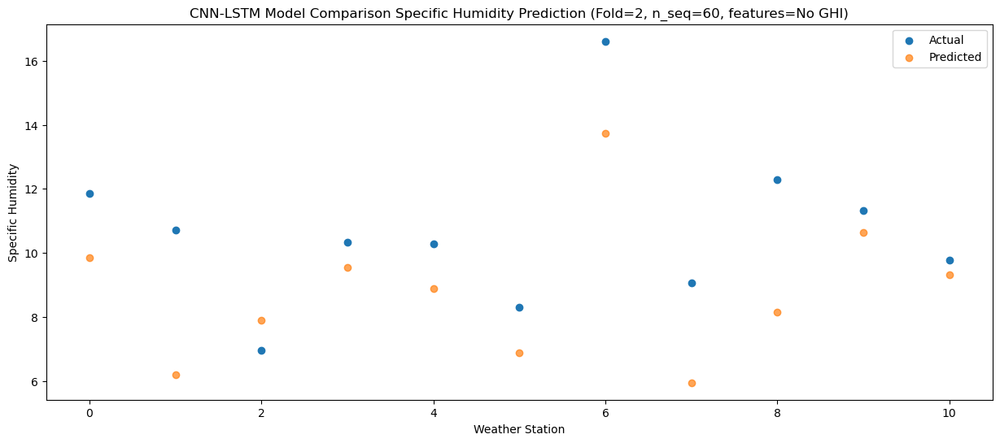

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.56   9.882505
1                 1    9.09   5.755587
2                 2    7.58   8.095967
3                 3   11.07  10.180369
4                 4    9.87   8.904505
5                 5    8.43   6.618065
6                 6   16.99  13.384716
7                 7    9.36   5.656420
8                 8   11.68   7.895937
9                 9   11.90  11.151117
10               10   10.16   9.810423


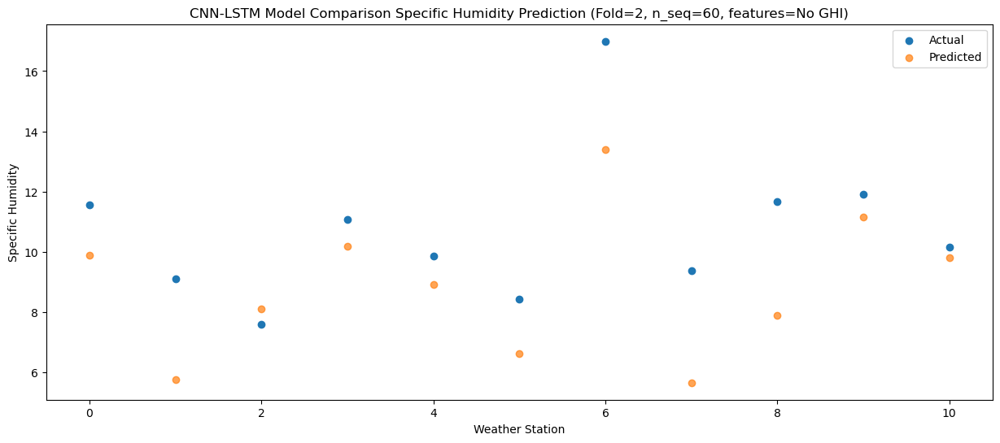

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    7.79   6.849130
1                 1    6.27   3.480239
2                 2    6.30   6.207662
3                 3    8.41   7.538343
4                 4    7.73   6.424031
5                 5    4.87   4.102428
6                 6   12.54  10.639570
7                 7    6.60   4.400020
8                 8   11.22   7.403234
9                 9    8.30   8.363752
10               10    6.95   6.951297


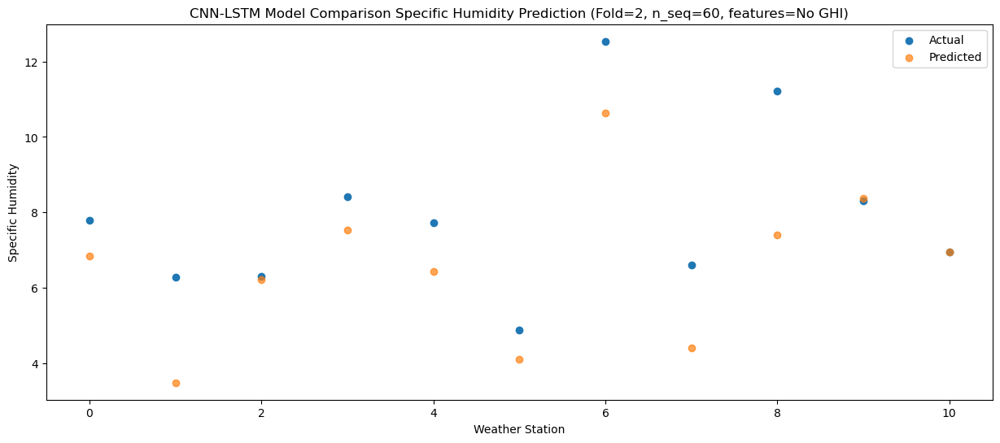

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.34   4.835149
1                 1    2.88   1.796837
2                 2    3.64   4.321792
3                 3    5.45   6.306322
4                 4    5.20   4.229641
5                 5    3.28   1.984018
6                 6    9.93   8.522373
7                 7    2.89   3.010244
8                 8    8.42   6.297120
9                 9    6.14   6.679638
10               10    5.22   5.272895


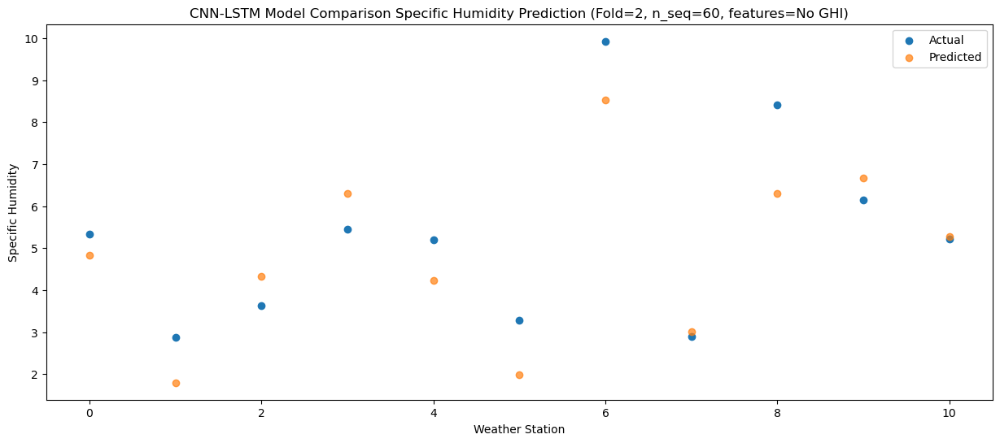

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.15   0.355474
1                 1    0.45  -0.231944
2                 2   -0.31   0.214836
3                 3    1.00   2.255323
4                 4   -0.46  -0.459675
5                 5   -0.91  -1.676419
6                 6    5.94   4.998321
7                 7    1.24   1.943690
8                 8    7.88   6.251223
9                 9    0.58   1.745763
10               10   -0.14   0.343240


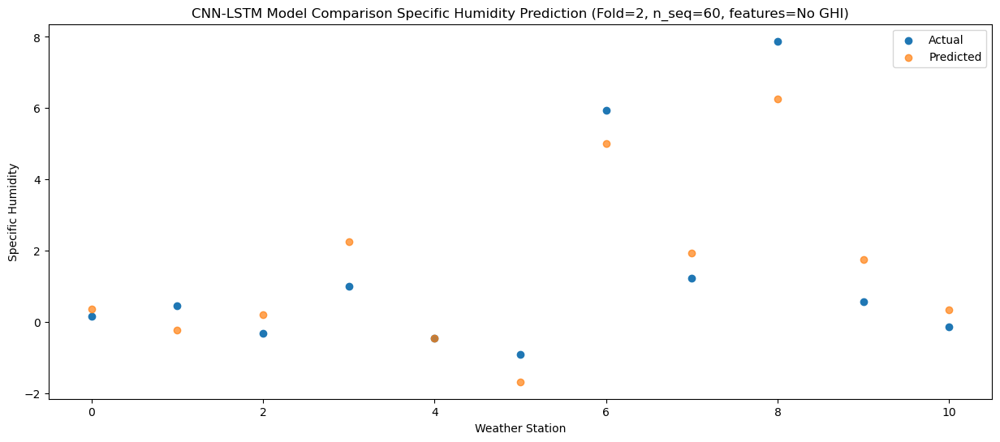

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.55   1.089083
1                 1   -0.61  -1.195617
2                 2    1.09   1.521779
3                 3    0.64   1.720465
4                 4    2.82   1.266914
5                 5    1.96  -0.889213
6                 6    8.44   5.448975
7                 7    1.37   0.774415
8                 8    7.70   4.556613
9                 9    2.43   2.505703
10               10    1.42   1.028478


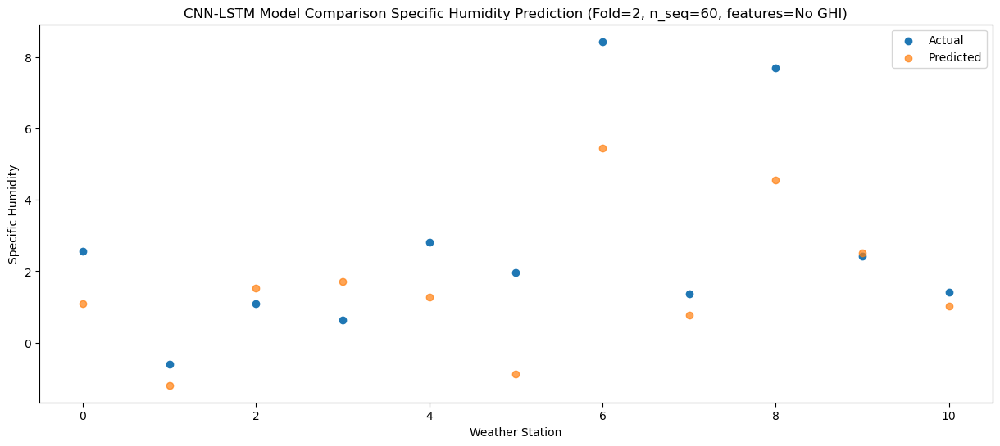

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.44  -1.451470
1                 1   -0.94  -2.038817
2                 2   -2.56  -1.245144
3                 3   -0.69   0.686347
4                 4   -2.09  -2.092526
5                 5   -3.67  -3.433262
6                 6    3.15   3.144480
7                 7    1.09   0.412479
8                 8    6.34   4.882498
9                 9   -0.35   0.151181
10               10   -1.00  -1.273374


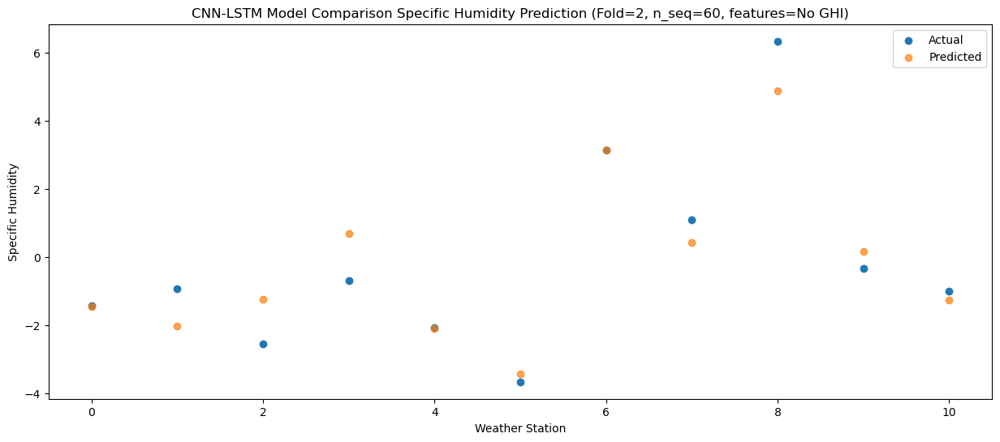

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.78  -0.609841
1                 1   -1.03  -1.808901
2                 2   -1.37  -0.059058
3                 3   -0.12   1.412235
4                 4   -0.63  -0.905205
5                 5   -3.45  -2.654608
6                 6    3.62   3.781330
7                 7    0.10   0.652829
8                 8    5.60   5.024379
9                 9    0.96   1.216929
10               10   -0.10  -0.242878


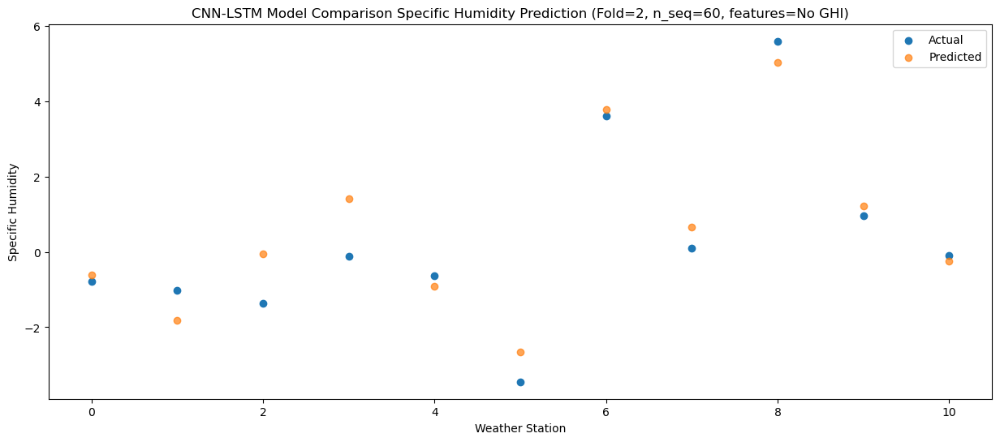

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.65   0.743900
1                 1   -0.15  -0.449489
2                 2    0.44   1.163957
3                 3    0.64   2.653868
4                 4    0.22   0.379136
5                 5   -1.83  -1.318413
6                 6    5.25   5.161567
7                 7    0.50   1.869845
8                 8    7.34   6.152579
9                 9    1.92   2.481081
10               10    0.52   1.026839


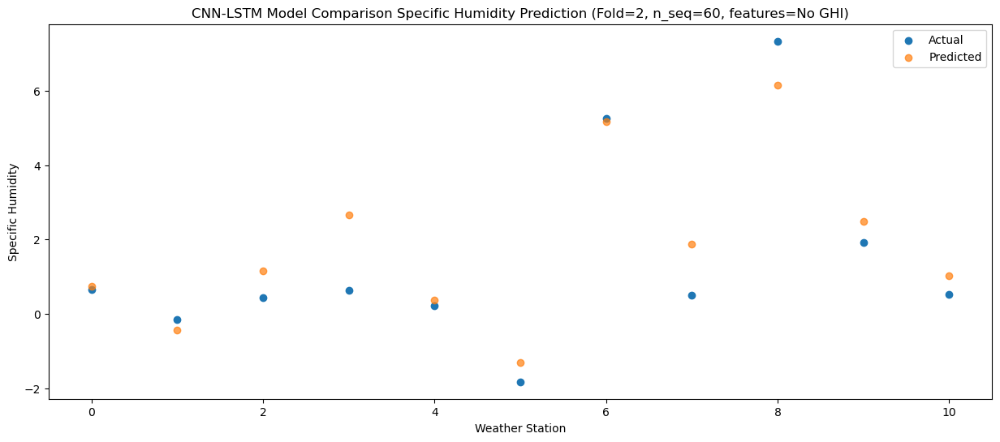

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.55   2.016645
1                 1    1.00   0.106385
2                 2    1.80   1.823386
3                 3    1.34   2.658676
4                 4    2.65   1.690228
5                 5    2.13  -0.068974
6                 6    9.15   6.497004
7                 7    0.51   1.629517
8                 8    8.18   5.210572
9                 9    2.96   3.158841
10               10    1.79   1.729718


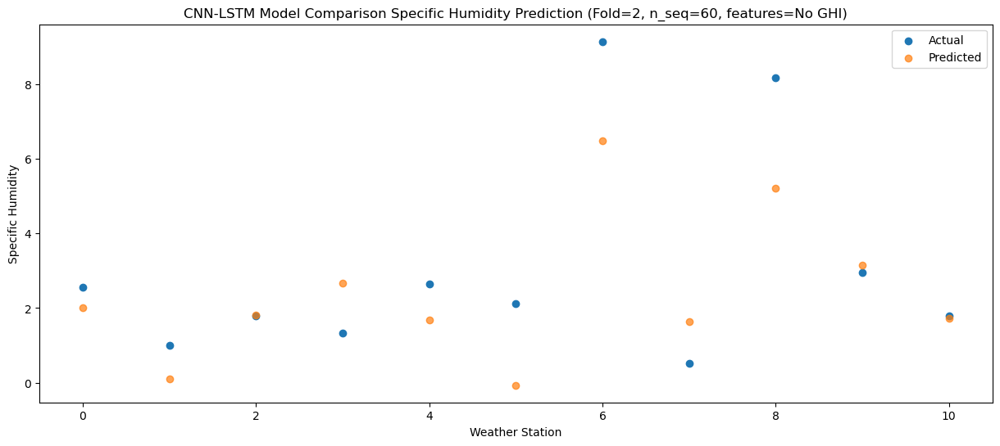

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    6.81   5.832302
1                 1    3.39   2.537598
2                 2    4.90   4.795817
3                 3    4.64   5.673773
4                 4    6.68   5.363574
5                 5    5.78   3.244125
6                 6   13.24   9.905306
7                 7    0.44   2.959984
8                 8    9.44   5.591085
9                 9    7.28   6.817784
10               10    5.95   5.418688


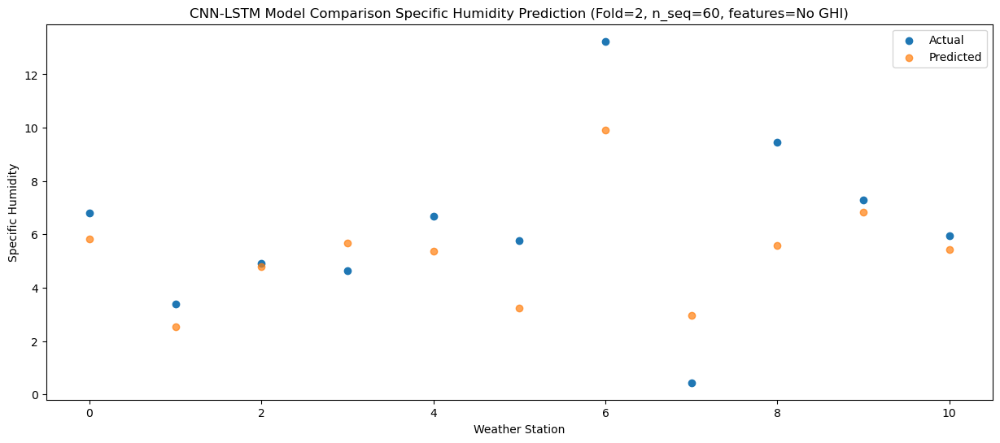

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    8.86   8.016456
1                 1    7.75   4.662564
2                 2    6.83   6.608163
3                 3    6.90   7.328853
4                 4    8.98   7.449079
5                 5    6.81   5.426389
6                 6   14.04  12.184142
7                 7    5.94   4.680411
8                 8   11.21   7.004856
9                 9    9.08   8.695131
10               10    7.91   7.317497


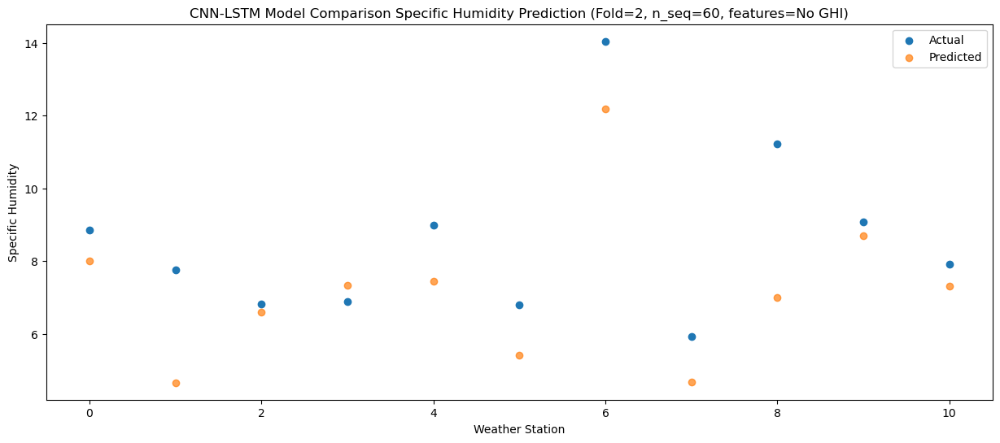

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.08  10.336875
1                 1    9.09   6.447933
2                 2    7.66   8.991284
3                 3   10.26  10.460783
4                 4   10.27   9.657789
5                 5    7.91   7.317459
6                 6   13.36  14.017414
7                 7    8.50   6.447376
8                 8   12.10   8.719392
9                 9   12.66  11.626230
10               10   11.12  10.244449


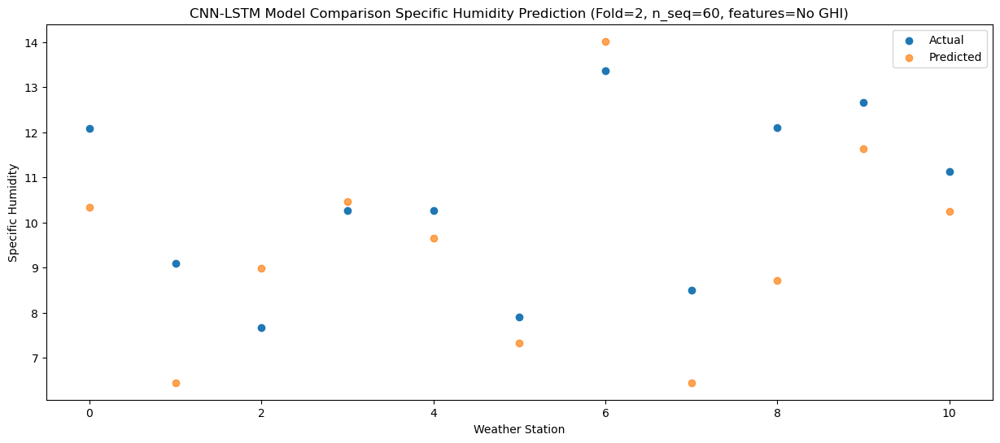

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.60   9.841624
1                 1    8.59   6.154545
2                 2    7.55   8.484544
3                 3   10.94  10.200305
4                 4   10.67   9.060098
5                 5    8.37   6.823690
6                 6   14.42  13.550760
7                 7   10.47   6.244405
8                 8   12.20   8.612571
9                 9   11.09  11.170718
10               10   10.13   9.797106


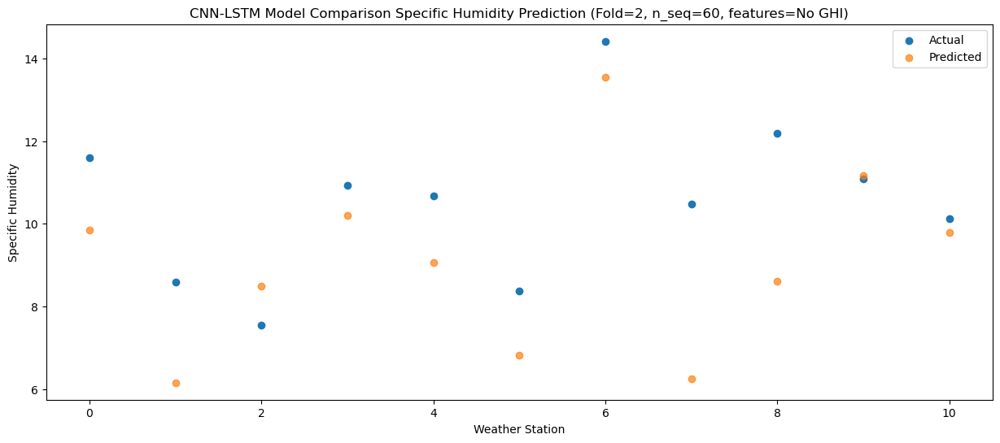

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.85   6.697238
1                 1    6.02   3.572776
2                 2    7.40   6.189315
3                 3    7.14   7.781429
4                 4    7.16   6.181663
5                 5    5.01   3.905288
6                 6   11.75  10.469369
7                 7    7.43   4.467408
8                 8   13.05   7.462276
9                 9    7.66   8.424802
10               10    6.65   7.005622


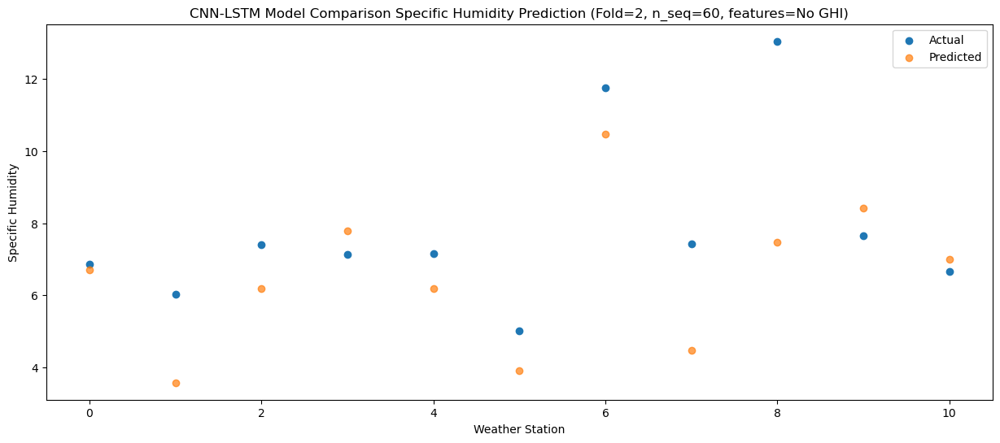

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   2.505199
1                 1    2.34   0.936825
2                 2    3.01   2.718106
3                 3    4.27   4.456266
4                 4    1.98   1.995904
5                 5    0.19   0.214613
6                 6    6.97   6.737489
7                 7    5.35   2.887365
8                 8   11.28   6.838369
9                 9    3.30   4.351809
10               10    1.99   2.908971


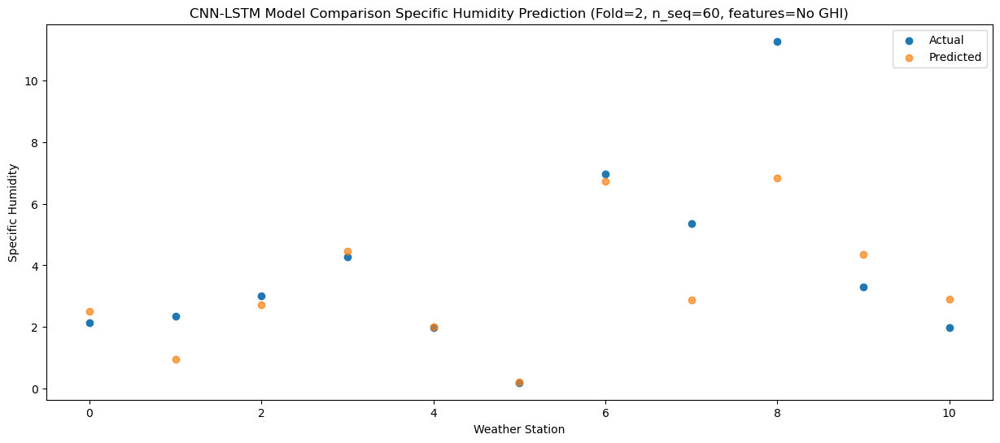

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.19   1.377523
1                 1    0.84  -1.163918
2                 2    2.90   1.538999
3                 3    2.45   2.812036
4                 4    1.54   1.137335
5                 5    0.05  -1.069931
6                 6    6.52   5.362085
7                 7    1.38   0.448143
8                 8    6.64   3.992170
9                 9    2.83   3.248305
10               10    1.37   1.787735


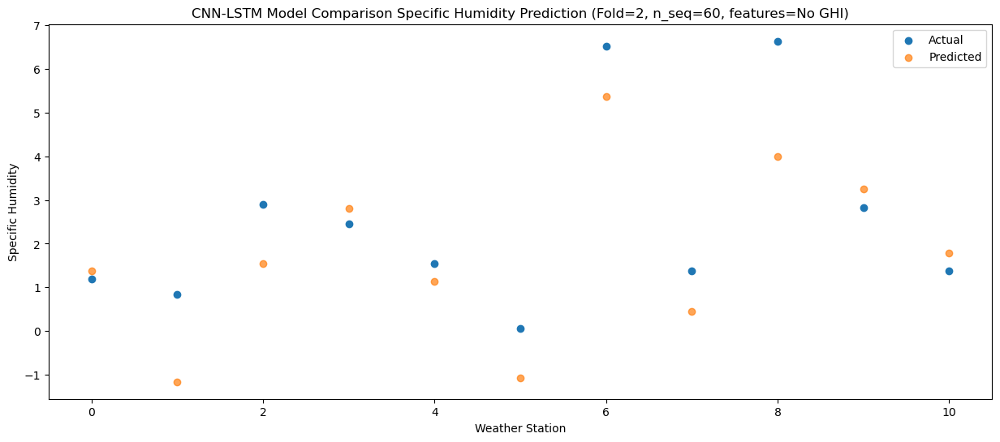

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.56  -0.144155
1                 1   -0.35  -1.947888
2                 2   -0.76   0.051780
3                 3    0.36   1.395733
4                 4    0.99  -0.516242
5                 5   -0.86  -2.366604
6                 6    5.35   4.115719
7                 7    2.20  -0.048419
8                 8    7.49   3.798171
9                 9    0.59   1.548106
10               10    0.28   0.105003


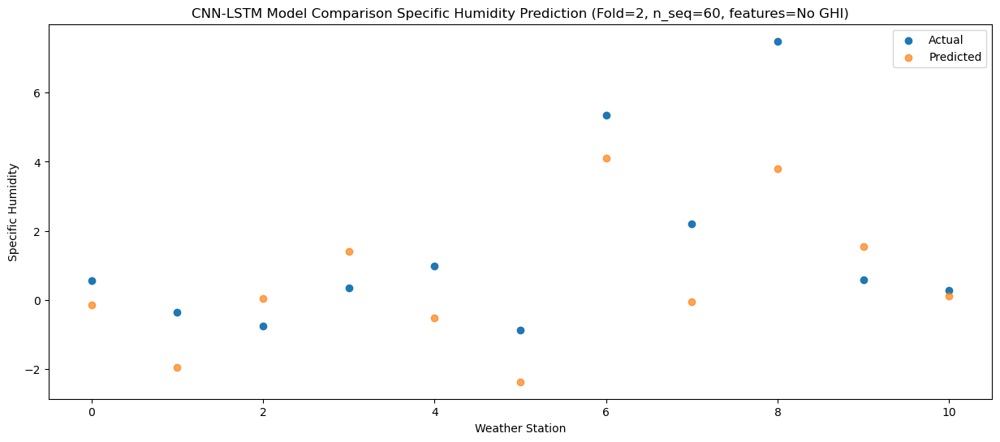

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.97   0.173350
1                 1   -0.36  -1.634891
2                 2   -1.14   0.338895
3                 3    0.87   2.182142
4                 4    0.90  -0.353458
5                 5   -1.24  -2.217280
6                 6    4.57   4.270145
7                 7    1.31   0.338372
8                 8    7.58   4.253107
9                 9    1.45   2.113302
10               10    0.55   0.679362


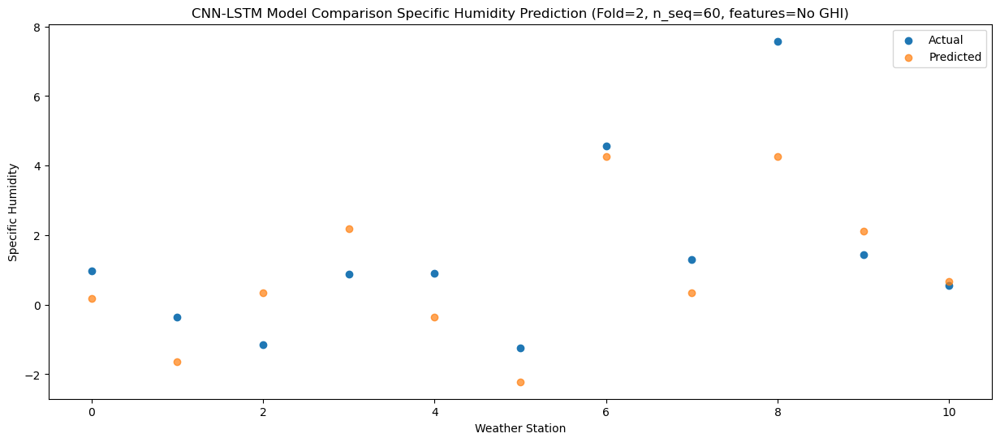

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.19   0.187111
1                 1   -0.44  -2.212609
2                 2    0.71   0.679529
3                 3    0.11   1.389199
4                 4    2.20   0.188262
5                 5   -0.79  -2.041108
6                 6    4.97   4.303960
7                 7    1.19  -0.345477
8                 8    6.17   3.336109
9                 9    2.21   2.006327
10               10    0.95   0.529443


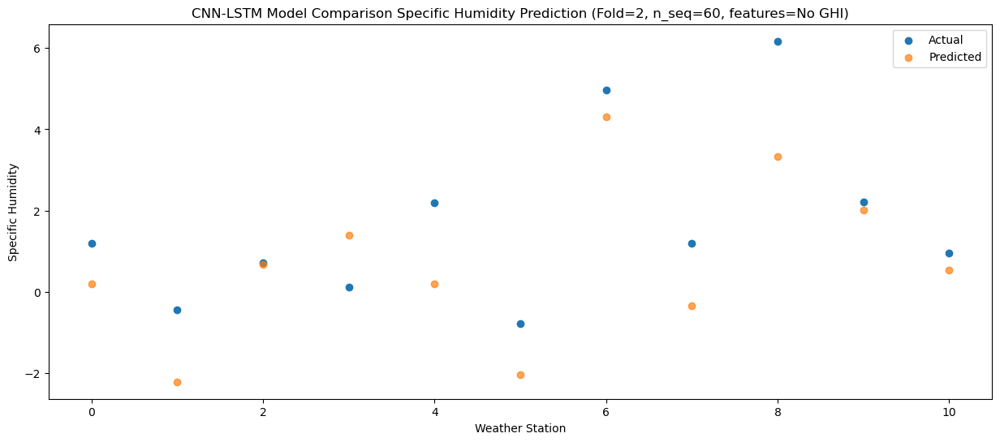

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.54   0.458212
1                 1    0.25  -1.642388
2                 2    1.10   0.570309
3                 3    0.36   1.373535
4                 4    3.08   0.238648
5                 5    0.99  -1.708574
6                 6    6.88   4.761939
7                 7    1.53   0.002456
8                 8    8.09   3.581678
9                 9    1.90   1.951313
10               10    0.55   0.501329


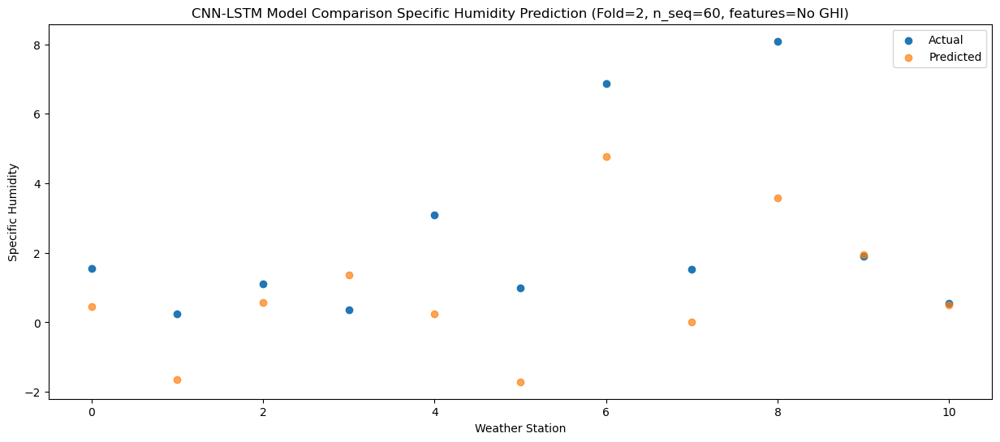

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.48   1.981726
1                 1    0.87  -0.665728
2                 2    2.61   2.152835
3                 3    2.44   3.385619
4                 4    3.63   1.746583
5                 5    1.54  -0.492074
6                 6    7.55   5.916770
7                 7    0.69   0.923910
8                 8    8.79   4.394096
9                 9    4.03   3.910919
10               10    2.19   2.452942


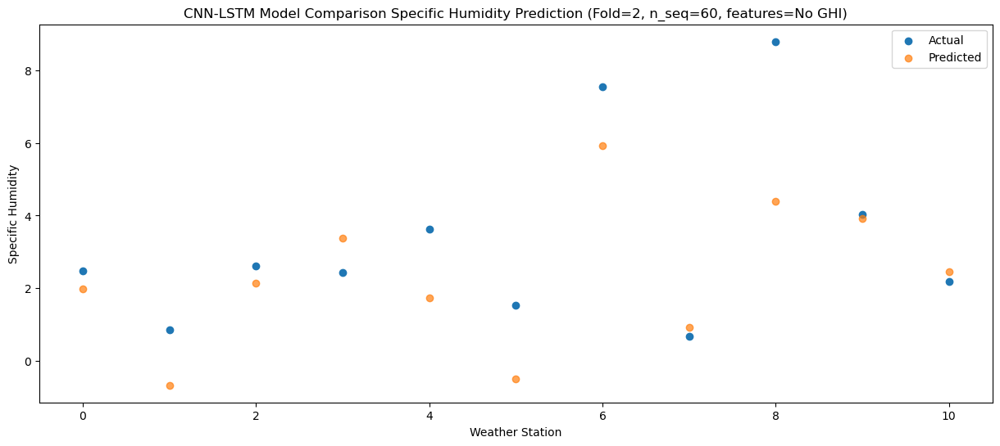

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.09   4.427415
1                 1    6.65   2.193846
2                 2    3.42   3.321551
3                 3    3.25   3.861759
4                 4    6.69   3.834012
5                 5    5.24   2.300787
6                 6   11.44   9.066686
7                 7    2.69   2.760899
8                 8   10.19   5.541123
9                 9    5.56   4.917967
10               10    4.78   3.534923


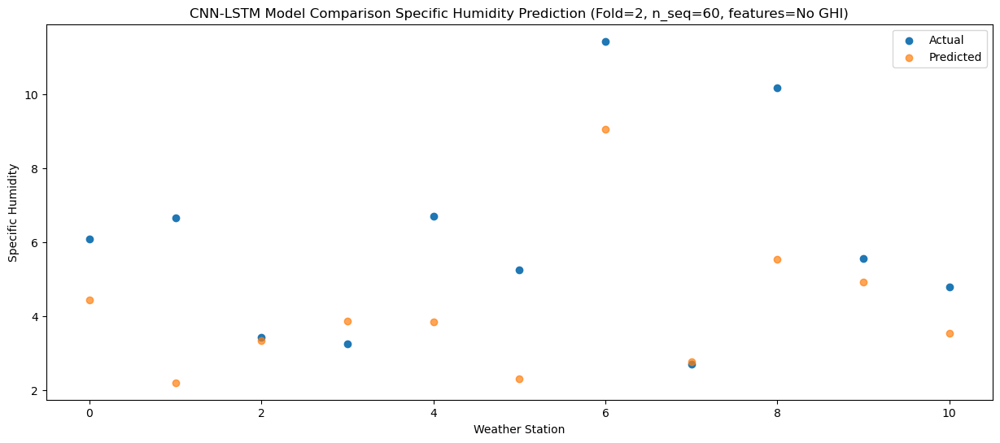

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.06   7.077097
1                 1    9.30   3.783906
2                 2    6.58   5.378521
3                 3    7.15   6.321297
4                 4   10.00   6.302891
5                 5    8.70   4.456086
6                 6   15.34  11.278646
7                 7    2.49   3.599296
8                 8   10.57   5.719381
9                 9    8.42   7.665523
10               10    6.62   6.307939


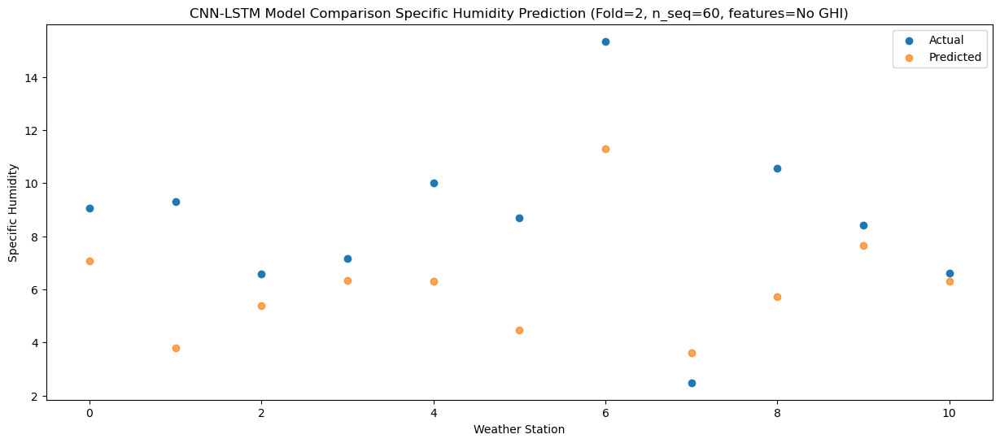

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.24   9.621947
1                 1   11.36   4.797961
2                 2    7.55   7.989892
3                 3   11.41   9.854452
4                 4   11.34   8.838132
5                 5    8.41   6.209080
6                 6   14.63  12.872429
7                 7    5.84   4.410912
8                 8   11.91   6.214515
9                 9   12.26  11.191009
10               10    9.93   9.814249


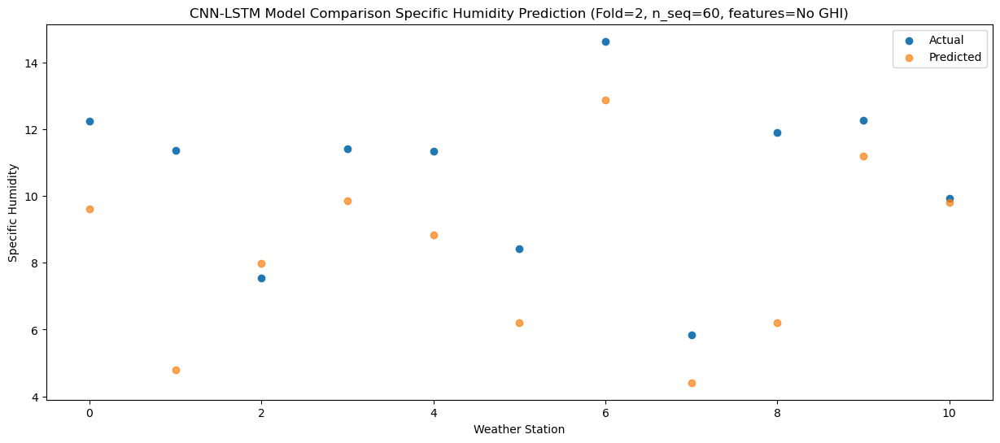

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   11.59   9.378533
1                 1    9.47   5.215008
2                 2    8.27   8.035025
3                 3    9.07   9.425086
4                 4   11.37   8.722252
5                 5    6.98   6.312762
6                 6   12.58  12.971498
7                 7    8.03   5.109634
8                 8   12.52   7.197485
9                 9   11.77  10.728732
10               10   10.04   9.336899


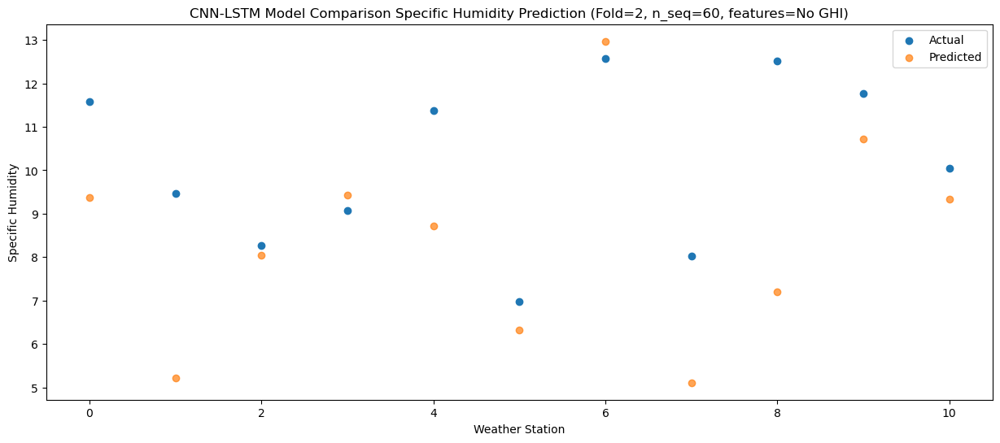

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    7.56   6.305398
1                 1    6.88   2.823313
2                 2    5.88   5.438430
3                 3    8.06   7.553825
4                 4    9.02   5.535190
5                 5    6.43   3.263019
6                 6   11.95   9.872614
7                 7    6.22   3.374703
8                 8   12.27   6.034095
9                 9    8.63   8.146041
10               10    7.62   6.737364


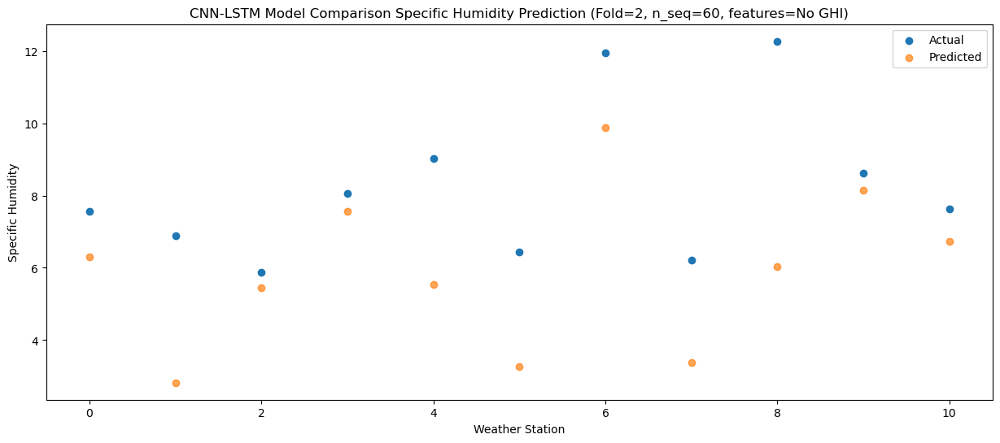

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.46   3.166585
1                 1    3.42   0.692048
2                 2    2.96   2.729974
3                 3    4.70   5.102162
4                 4    3.79   2.343814
5                 5    2.90   0.411120
6                 6    8.80   6.999739
7                 7    3.77   1.930667
8                 8    9.97   5.202780
9                 9    4.44   5.133630
10               10    3.51   3.715857


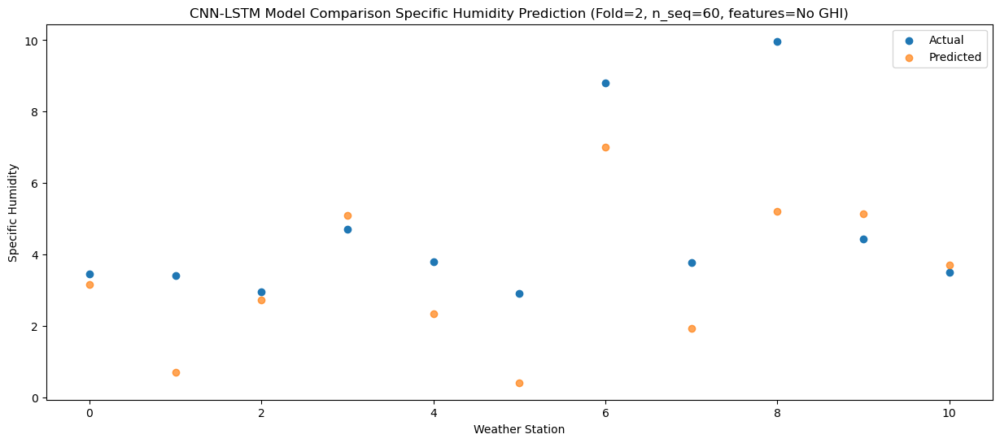

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.82   0.491785
1                 1    0.86  -1.383348
2                 2    0.46   0.502966
3                 3    0.87   2.111219
4                 4    1.27  -0.042965
5                 5   -0.27  -1.818560
6                 6    6.18   4.707087
7                 7    2.85   0.249763
8                 8    6.94   3.834172
9                 9    1.33   2.223468
10               10    0.56   0.777592


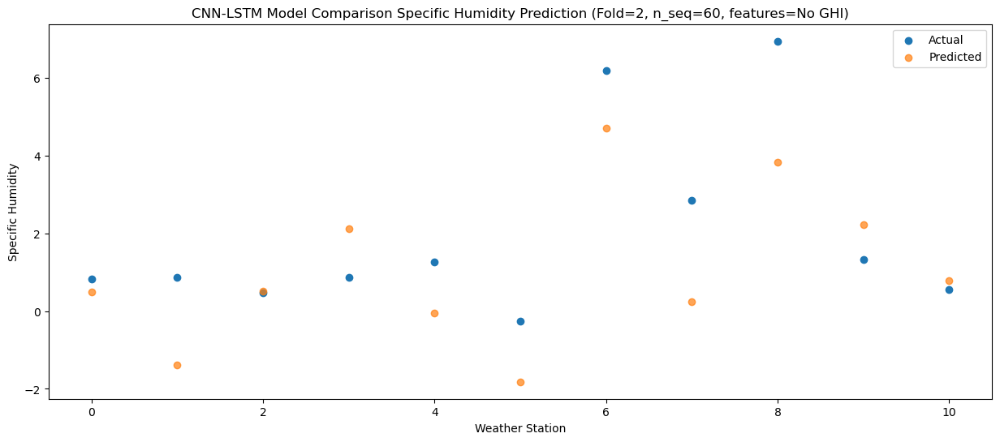

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.10  -0.107881
1                 1    0.47  -1.636327
2                 2   -0.11  -0.225932
3                 3    1.16   2.629372
4                 4   -0.32  -1.088221
5                 5   -2.20  -2.699444
6                 6    4.36   3.899029
7                 7    1.33   0.147952
8                 8    7.73   3.942663
9                 9    1.24   2.054363
10               10    0.35   0.628521


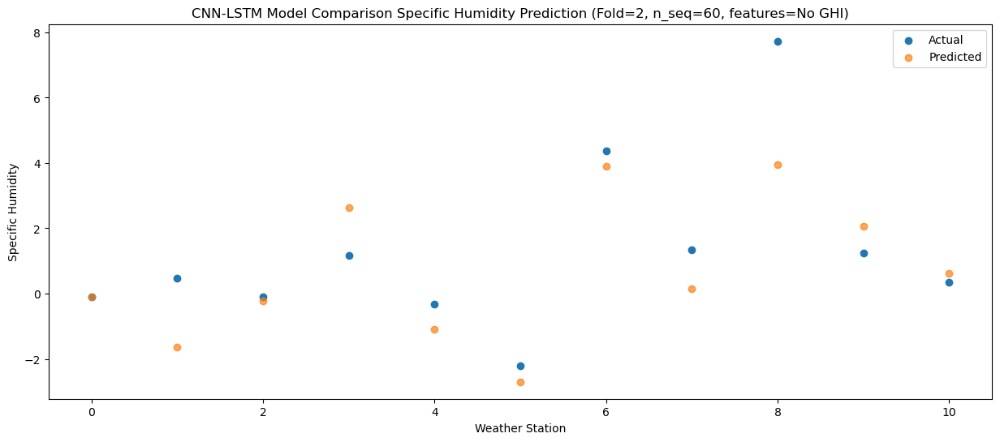

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.99  -0.905262
1                 1   -0.12  -2.313432
2                 2   -1.18  -0.567305
3                 3   -0.17   1.908356
4                 4   -1.19  -1.637875
5                 5   -3.21  -3.323180
6                 6    3.24   3.165944
7                 7    1.75  -0.165307
8                 8    7.70   3.875755
9                 9    0.55   1.370858
10               10   -0.27  -0.083800


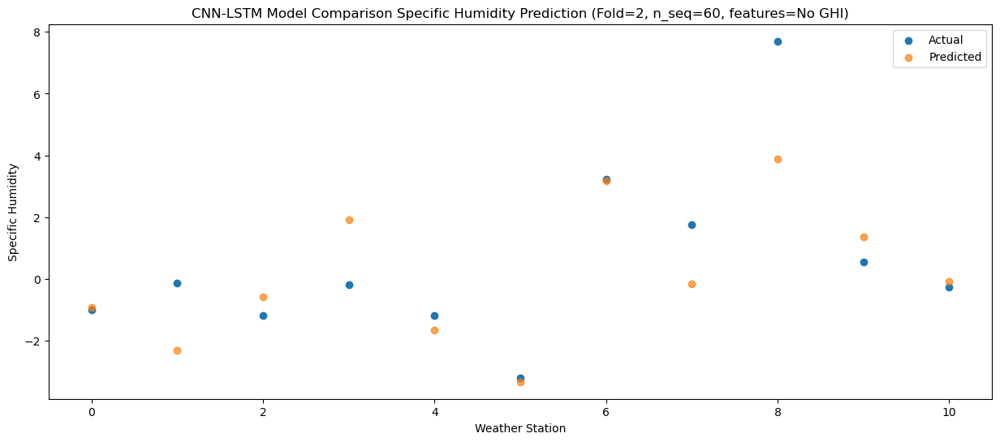

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.88  -0.218885
1                 1    0.70  -1.653310
2                 2   -1.60  -0.474206
3                 3   -0.22   1.767629
4                 4   -0.13  -1.094092
5                 5   -0.81  -2.557184
6                 6    5.71   4.077832
7                 7    1.77  -0.038474
8                 8    8.67   3.612957
9                 9    0.69   1.496397
10               10    0.13   0.071030


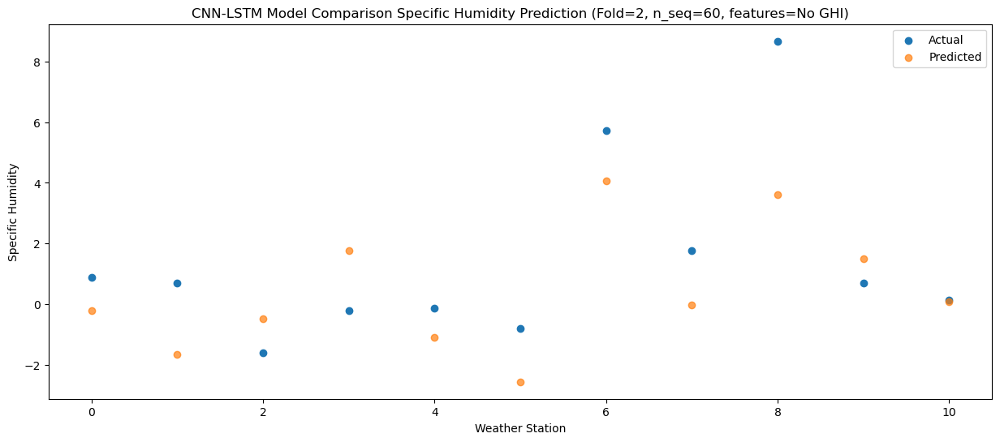

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.70   0.961377
1                 1    0.95  -1.336737
2                 2    1.56   1.034599
3                 3    0.83   2.362898
4                 4    1.47   0.599381
5                 5    0.83  -1.351104
6                 6    7.33   5.104791
7                 7    1.99   0.208700
8                 8    7.11   3.624734
9                 9    2.10   2.721613
10               10    1.23   1.253254


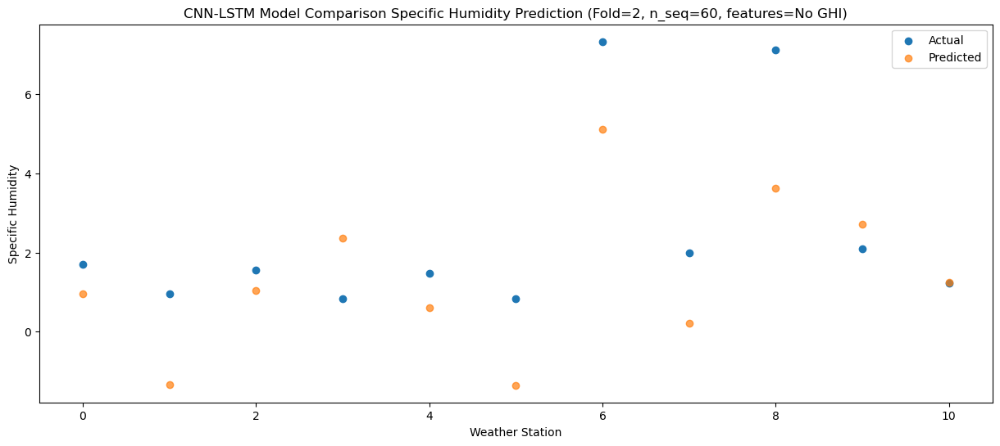

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   2.310598
1                 1    1.91  -0.539307
2                 2    0.35   1.739941
3                 3    1.72   3.329223
4                 4    3.54   1.711426
5                 5    3.11  -0.271003
6                 6    9.53   6.292827
7                 7    1.32   0.378547
8                 8    6.21   3.296399
9                 9    4.32   3.880976
10               10    3.34   2.451662


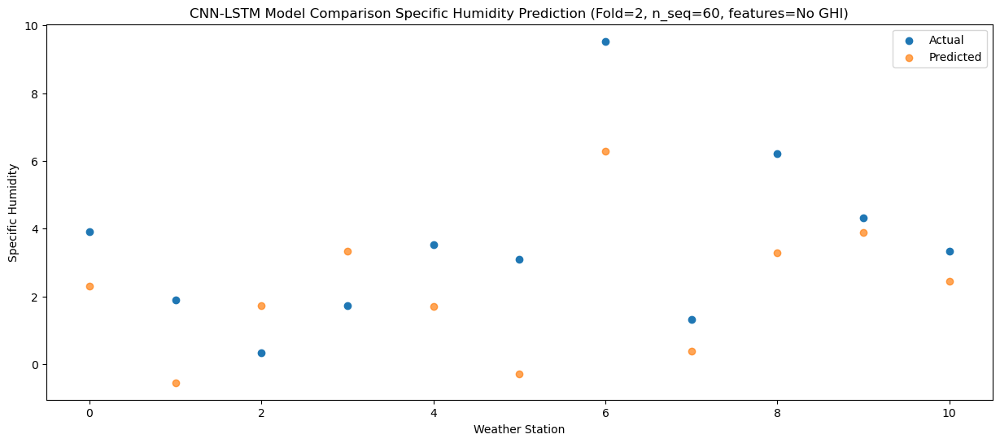

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.17   5.658296
1                 1    4.94   1.304313
2                 2    5.21   4.642178
3                 3    4.90   5.837123
4                 4    7.97   5.204495
5                 5    7.21   2.686751
6                 6   13.31   9.239516
7                 7    1.01   1.305832
8                 8   10.31   3.348438
9                 9    8.20   7.170761
10               10    7.20   5.743332


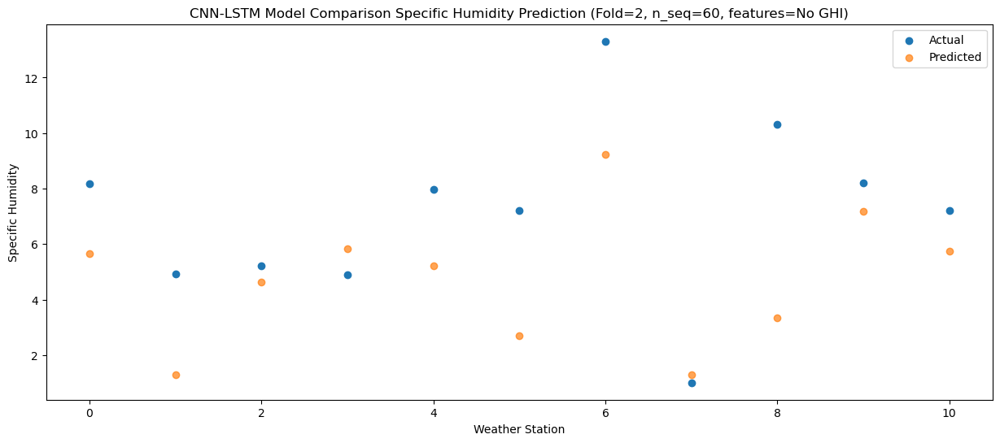

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.14   7.662067
1                 1   10.95   3.501256
2                 2    7.27   5.506769
3                 3    7.82   7.638242
4                 4    9.94   6.453309
5                 5    8.87   4.408859
6                 6   14.90  11.303635
7                 7    5.06   2.686535
8                 8   11.91   4.258390
9                 9   10.07   8.728774
10               10    8.75   7.386975


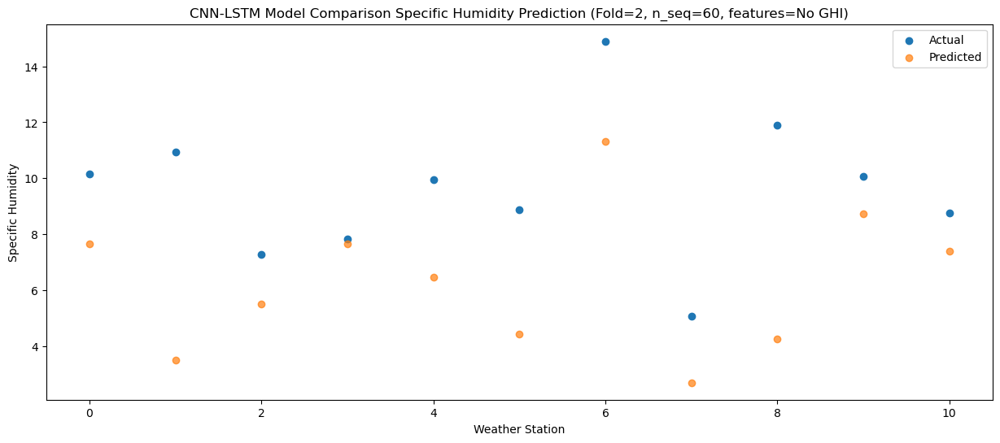

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.61   9.100437
1                 1    9.50   4.197930
2                 2    8.32   7.685113
3                 3   10.99   9.788108
4                 4   11.58   8.283611
5                 5    9.17   5.622266
6                 6   15.13  12.246547
7                 7    8.66   3.829517
8                 8   13.14   5.590852
9                 9   12.68  10.941200
10               10   10.79   9.544968


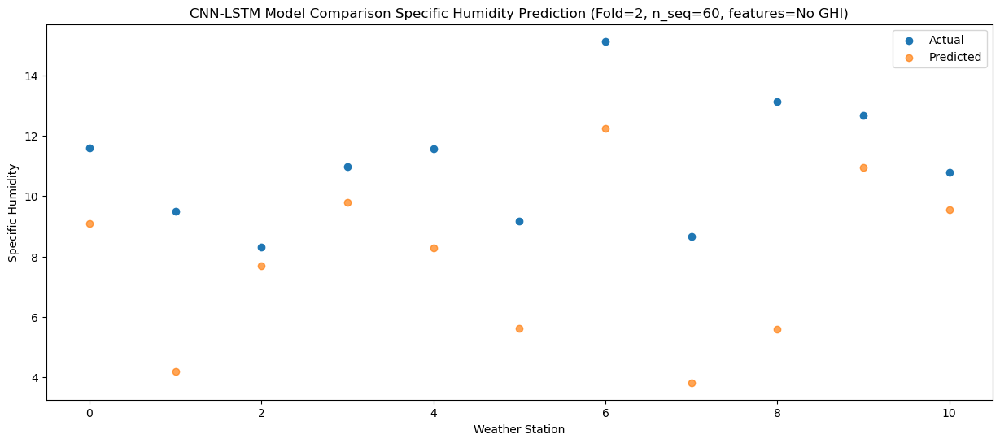

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.61   8.567641
1                 1   10.48   4.433684
2                 2    8.92   7.031194
3                 3    9.49   9.533425
4                 4   10.41   7.477676
5                 5    9.21   5.208285
6                 6   14.95  11.945647
7                 7    8.34   4.184394
8                 8   12.32   6.165038
9                 9   11.42  10.272506
10               10    9.78   8.898484


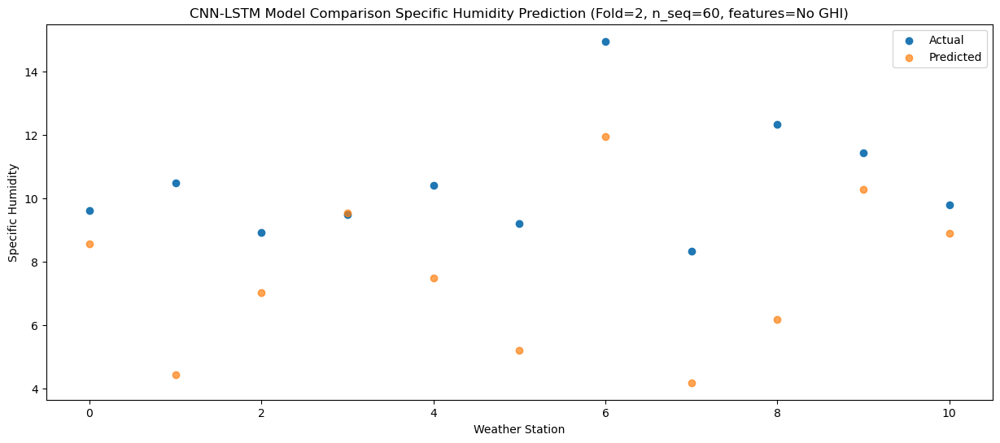

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.99   6.473852
1                 1    6.53   2.336488
2                 2    9.35   6.360391
3                 3    6.60   7.806968
4                 4    8.81   6.231899
5                 5    6.72   3.499180
6                 6   12.05   9.847010
7                 7    5.60   3.159740
8                 8   11.93   5.793016
9                 9    9.57   8.703567
10               10    7.68   7.231500


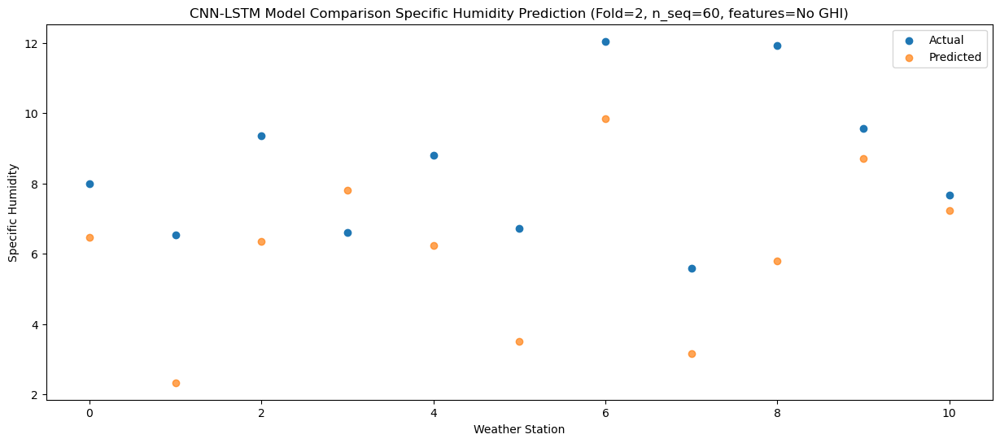

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.61   2.583346
1                 1    3.67  -0.273112
2                 2    4.37   2.778534
3                 3    3.36   4.566323
4                 4    3.95   2.160346
5                 5    2.40  -0.056859
6                 6    8.63   6.327613
7                 7    2.71   1.234121
8                 8   10.03   4.536459
9                 9    4.95   4.796977
10               10    3.61   3.329389


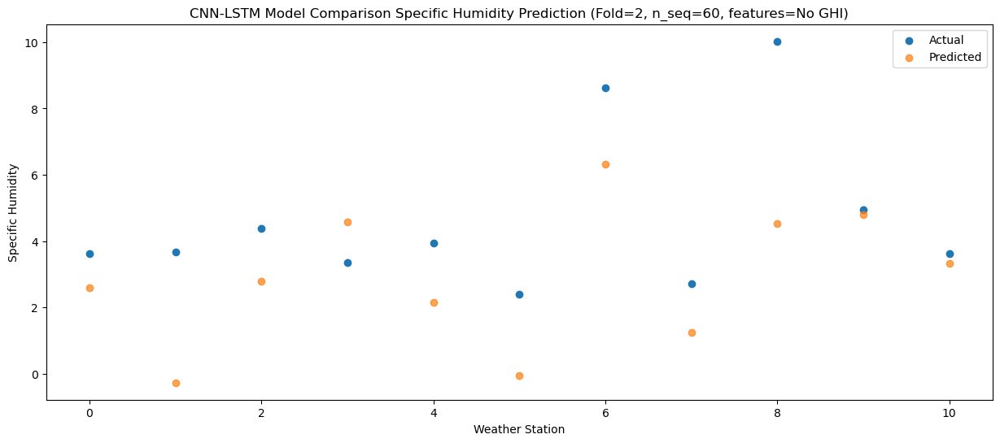

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_2 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_2 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_4 (LSTM)               (None, 1, 512)            3147776   
                                                                 
 dropout_7 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_5 (LSTM)               (None, 512)               2099200   
                                                      

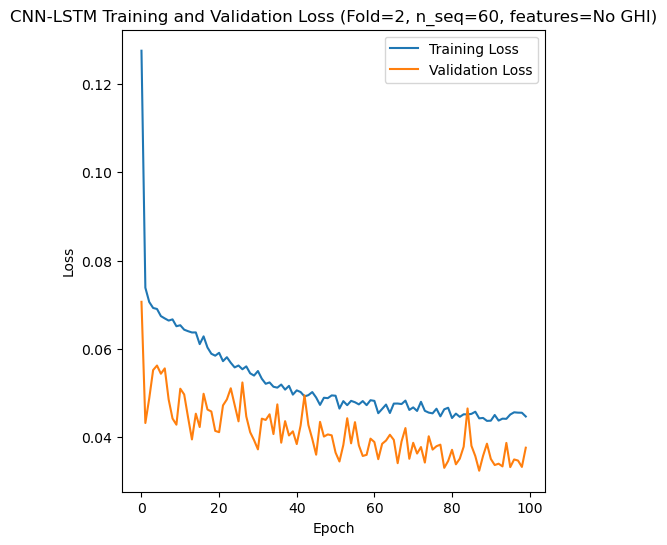

Epoch 1/100
84/84 [==============================] - 16s 91ms/step - loss: 0.1277 - accuracy: 0.2976 - mae: 0.1086 - rmse: 0.1277 - mape: 22.9985 - pearson: 0.6161 - val_loss: 0.0821 - val_accuracy: 0.6000 - val_mae: 0.0643 - val_rmse: 0.0821 - val_mape: 13.5920 - val_pearson: 0.6680
Epoch 2/100
84/84 [==============================] - 6s 70ms/step - loss: 0.0735 - accuracy: 0.4048 - mae: 0.0580 - rmse: 0.0735 - mape: 13.0149 - pearson: 0.7654 - val_loss: 0.0784 - val_accuracy: 0.0000e+00 - val_mae: 0.0633 - val_rmse: 0.0784 - val_mape: 13.8018 - val_pearson: 0.6423
Epoch 3/100
84/84 [==============================] - 6s 71ms/step - loss: 0.0692 - accuracy: 0.3690 - mae: 0.0546 - rmse: 0.0692 - mape: 12.2860 - pearson: 0.7823 - val_loss: 0.0760 - val_accuracy: 0.6000 - val_mae: 0.0578 - val_rmse: 0.0760 - val_mape: 12.3935 - val_pearson: 0.7089
Epoch 4/100
84/84 [==============================] - 5s 63ms/step - loss: 0.0663 - accuracy: 0.4167 - mae: 0.0520 - rmse: 0.0663 - mape: 11.824

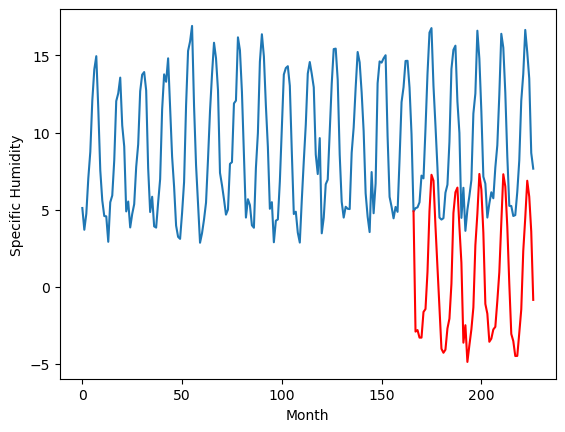

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.14		0.14		0.28
-0.55		-0.35		0.20
-0.58		-0.41		0.17
-0.94		-0.81		0.13
1.66		1.71		0.05
1.81		1.71		-0.10
4.78		4.52		-0.26
8.31		7.86		-0.45
11.05		10.45		-0.60
8.38		8.58		0.20
6.94		5.74		-1.20
2.37		2.01		-0.36
0.87		0.51		-0.36
-1.17		-1.39		-0.22
-1.26		-1.45		-0.19
-1.82		-2.13		-0.31
0.69		0.13		-0.56
1.86		0.81		-1.05
5.38		4.17		-1.21
9.91		7.82		-2.09
10.79		9.02		-1.77
10.96		8.56		-2.40
6.99		5.57		-1.42
4.80		2.93		-1.87
0.37		-1.03		-1.40
1.34		-0.43		-1.77
-1.85		-2.77		-0.92
-1.48		-2.43		-0.95
-0.01		-1.28		-1.27
2.29		1.13		-1.16
6.74		5.04		-1.70
9.36		7.41		-1.95
9.57		8.84		-0.73
10.18		8.26		-1.92
6.33		4.97		-1.36
1.87		0.50		-1.37
0.84		-0.56		-1.40
-0.35		-1.51		-1.16
-0.43		-1.73		-1.30
-0.27		-1.43		-1.16
0.67		-0.46		-1.13
1.54		0.37		-1.17
5.95		4.68		-1.27
8.59		7.70		-0.89
10.86		9.00		-1.86
11.10		8.17		-2.93
7.03		5.76		-1.27
3.59		2.17		-1.42
0.71		-0.74

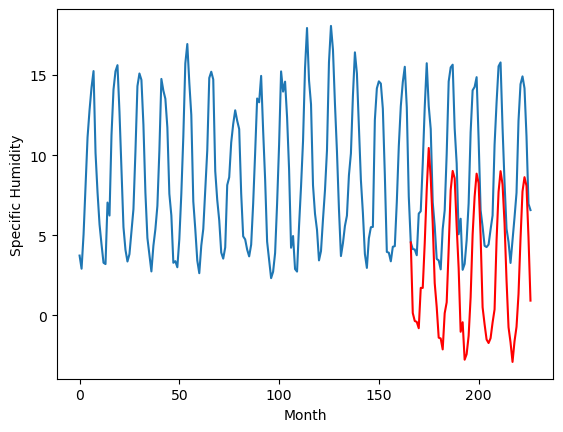

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.99		7.15		1.16
6.53		6.58		0.05
6.15		6.62		0.47
5.46		6.16		0.70
6.54		6.16		-0.38
7.91		7.12		-0.79
7.72		8.01		0.29
9.26		8.86		-0.40
9.48		8.91		-0.57
11.00		8.90		-2.10
10.52		7.98		-2.54
8.64		7.09		-1.55
5.95		6.38		0.43
5.35		5.87		0.52
5.79		6.31		0.52
5.73		6.04		0.31
5.81		5.86		0.05
6.43		5.83		-0.60
6.83		7.63		0.80
9.28		8.73		-0.55
9.98		9.35		-0.63
9.51		8.41		-1.10
8.22		8.10		-0.12
7.08		6.14		-0.94
7.66		6.90		-0.76
6.16		4.37		-1.79
5.88		5.26		-0.62
5.10		4.78		-0.32
6.44		5.81		-0.63
6.11		5.63		-0.48
6.29		6.31		0.02
7.46		8.73		1.27
8.63		9.10		0.47
9.42		8.92		-0.50
9.13		8.03		-1.10
7.96		7.67		-0.29
5.24		4.42		-0.82
6.08		4.37		-1.71
6.23		4.21		-2.02
5.10		3.65		-1.45
6.62		4.57		-2.05
6.82		5.04		-1.78
7.76		8.36		0.60
8.53		8.67		0.14
9.63		7.97		-1.66
10.70		8.59		-2.11
9.16		7.61		-1.55
8.00		6.77		-1.23
5.89		5.00		-0.89
6.12		4.74		-1.38
6.66		3.95		-2.71


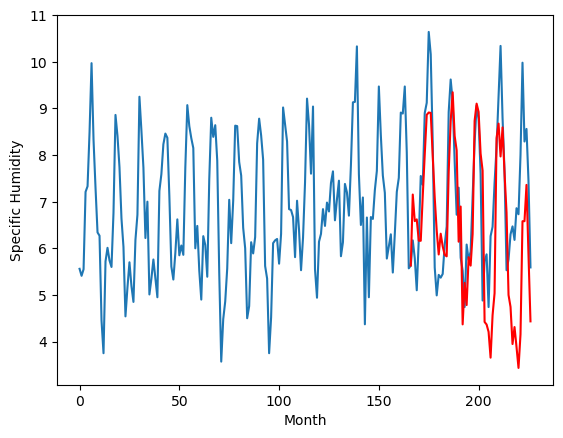

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.83		-0.31		0.52
-0.30		-0.31		-0.01
-0.70		-0.72		-0.02
-0.88		-0.87		0.01
0.98		0.78		-0.20
0.90		1.01		0.11
4.33		3.68		-0.65
7.57		7.65		0.08
10.67		10.30		-0.37
9.59		9.41		-0.18
7.02		6.15		-0.87
3.33		3.15		-0.18
0.44		0.98		0.54
-1.17		-1.22		-0.05
-1.44		-1.55		-0.11
-1.51		-1.75		-0.24
-0.21		-0.17		0.04
0.98		0.62		-0.36
3.51		2.94		-0.57
8.93		7.56		-1.37
9.56		8.97		-0.59
10.44		9.21		-1.23
6.97		6.33		-0.64
4.91		4.07		-0.84
-0.78		-0.97		-0.19
0.36		-0.29		-0.65
-1.96		-2.28		-0.32
-1.44		-1.41		0.03
-0.46		-0.38		0.08
0.81		1.13		0.32
5.23		5.24		0.01
7.49		7.34		-0.15
10.53		9.93		-0.60
9.40		9.04		-0.36
6.15		6.04		-0.11
1.00		1.39		0.39
0.19		0.57		0.38
-0.84		-1.06		-0.22
-0.30		-0.81		-0.51
-0.48		-0.55		-0.07
-0.61		-0.24		0.37
0.93		1.40		0.47
3.84		3.61		-0.23
5.86		6.87		1.01
9.51		10.02		0.51
8.96		9.11		0.15
6.49		6.57		0.08
2.96		2.88		-0.08
-0.43		-0.50		-0.07
-

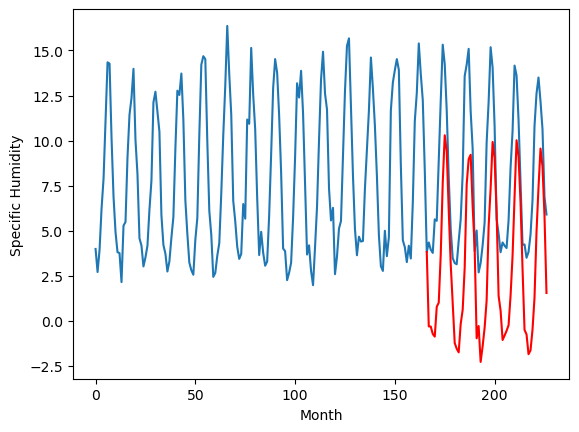

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.61		2.32		-1.29
2.11		2.01		-0.10
-0.18		1.74		1.92
-0.94		1.39		2.33
1.13		3.24		2.11
1.45		3.49		2.04
5.15		6.39		1.24
8.24		10.09		1.85
12.19		12.77		0.58
9.81		11.17		1.36
6.85		7.83		0.98
2.13		4.37		2.24
1.03		2.96		1.93
-0.90		1.28		2.18
-1.10		1.08		2.18
-1.93		0.43		2.36
0.55		2.37		1.82
1.61		3.14		1.53
4.03		5.90		1.87
8.49		10.05		1.56
10.44		11.49		1.05
10.53		11.32		0.79
6.76		8.25		1.49
4.81		5.91		1.10
-0.31		1.59		1.90
0.39		1.71		1.32
-2.07		0.11		2.18
-1.45		0.56		2.01
0.12		1.67		1.55
1.68		3.46		1.78
5.77		7.44		1.67
7.87		9.81		1.94
10.46		11.95		1.49
9.96		11.21		1.25
6.86		8.05		1.19
1.86		3.52		1.66
0.47		2.39		1.92
-0.65		1.18		1.83
-0.27		1.30		1.57
0.61		1.35		0.74
0.28		2.00		1.72
1.51		3.24		1.73
4.69		6.57		1.88
6.82		9.66		2.84
10.59		12.00		1.41
10.98		11.27		0.29
6.87		8.71		1.84
3.25		5.13		1.88
0.08		1.93		1.85
-0.33		1.58		1.91
-1.20		0.34		1.54
-0.29		1

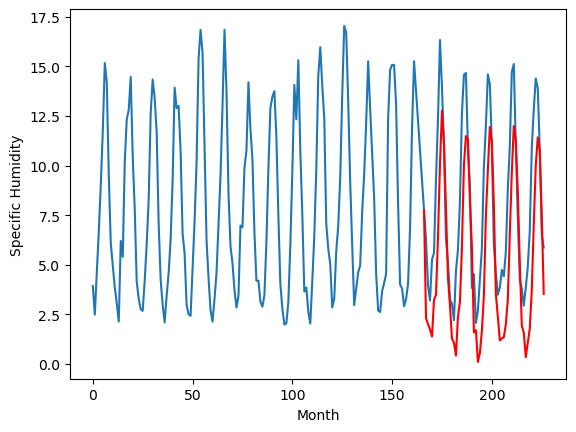

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.24		0.40		0.16
0.53		0.23		-0.30
0.03		-0.11		-0.14
-0.22		-0.38		-0.16
1.77		1.34		-0.43
1.89		1.60		-0.29
5.10		4.43		-0.67
7.83		8.30		0.47
10.99		11.02		0.03
9.77		9.71		-0.06
6.59		6.32		-0.27
3.17		3.04		-0.13
1.40		1.33		-0.07
-0.26		-0.53		-0.27
-0.57		-0.82		-0.25
-1.09		-1.31		-0.22
0.94		0.47		-0.47
2.24		1.28		-0.96
4.48		3.81		-0.67
9.70		8.23		-1.47
10.95		9.69		-1.26
11.12		9.74		-1.38
7.82		6.70		-1.12
6.20		4.42		-1.78
0.33		-0.27		-0.60
1.38		0.04		-1.34
-1.13		-1.66		-0.53
-0.60		-1.02		-0.42
0.71		0.04		-0.67
2.24		1.68		-0.56
6.47		5.74		-0.73
8.54		8.00		-0.54
11.32		10.40		-0.92
10.12		9.60		-0.52
7.35		6.49		-0.86
2.05		1.89		-0.16
0.83		0.88		0.05
0.07		-0.52		-0.59
0.65		-0.31		-0.96
0.32		-0.22		-0.54
0.75		0.27		-0.48
2.06		1.73		-0.33
4.66		4.50		-0.16
6.82		7.69		0.87
11.33		10.50		-0.83
10.45		9.67		-0.78
7.22		7.11		-0.11
3.84		3.47		-0.37
0.65		0.14		-0.51
0

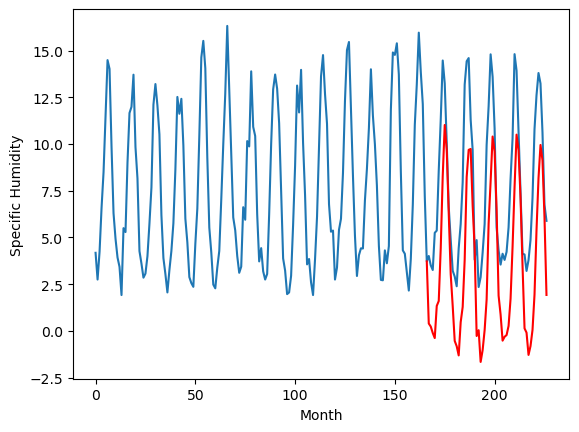

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.16		6.18		0.02
5.79		5.59		-0.20
5.75		5.58		-0.17
5.71		5.10		-0.61
6.34		5.57		-0.77
6.69		6.36		-0.33
7.82		7.89		0.07
8.88		9.43		0.55
10.40		10.22		-0.18
9.19		9.57		0.38
8.05		7.92		-0.13
6.40		6.22		-0.18
6.34		5.62		-0.72
5.53		5.04		-0.49
5.70		5.32		-0.38
5.76		4.78		-0.98
6.07		5.26		-0.81
6.54		5.46		-1.08
7.94		7.60		-0.34
9.27		9.37		0.10
11.72		10.25		-1.47
10.29		9.41		-0.88
8.59		8.30		-0.29
7.50		6.25		-1.25
6.79		5.91		-0.88
6.08		3.80		-2.28
5.60		4.29		-1.31
5.39		3.92		-1.47
6.07		4.99		-1.08
6.57		5.36		-1.21
7.38		6.85		-0.53
9.32		9.36		0.04
12.31		10.11		-2.20
12.15		9.82		-2.33
9.20		8.29		-0.91
7.59		6.92		-0.67
5.93		4.10		-1.83
5.96		3.87		-2.09
5.93		3.78		-2.15
5.55		3.26		-2.29
5.85		4.19		-1.66
6.48		4.77		-1.71
8.64		8.40		-0.24
8.87		9.40		0.53
9.71		9.34		-0.37
11.36		9.65		-1.71
8.74		8.26		-0.48
7.49		6.75		-0.74
6.16		4.64		-1.52
6.03		4.40		-1.63
5.9

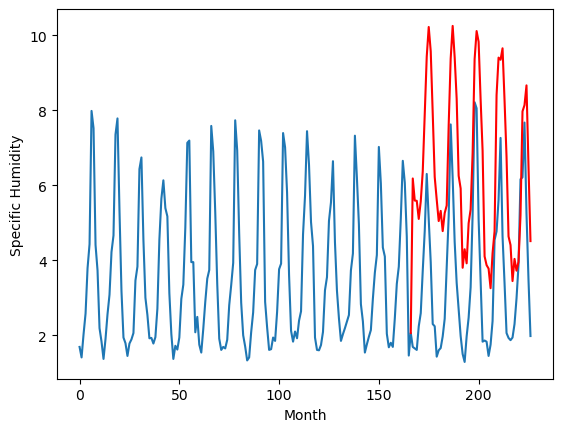

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.99		5.56		0.57
5.98		4.92		-1.06
4.86		4.97		0.11
4.44		4.44		0.00
6.18		4.44		-1.74
5.99		5.41		-0.58
5.29		6.48		1.19
5.62		7.36		1.74
6.10		7.56		1.46
6.97		7.25		0.28
5.71		6.10		0.39
4.70		4.98		0.28
4.68		4.59		-0.09
3.85		4.34		0.49
4.66		4.75		0.09
4.18		4.27		0.09
4.48		4.24		-0.24
4.17		4.26		0.09
4.73		6.15		1.42
6.15		7.24		1.09
11.51		7.95		-3.56
9.08		6.93		-2.15
7.36		6.42		-0.94
6.26		4.48		-1.78
4.99		5.30		0.31
5.13		2.51		-2.62
4.14		3.64		-0.50
3.71		3.03		-0.68
4.33		4.07		-0.26
4.33		3.95		-0.38
4.59		4.69		0.10
6.35		7.21		0.86
9.78		7.59		-2.19
12.85		7.43		-5.42
8.94		6.41		-2.53
6.21		5.99		-0.22
4.44		2.67		-1.77
5.19		2.71		-2.48
5.58		2.58		-3.00
4.33		1.87		-2.46
5.37		2.85		-2.52
4.52		3.27		-1.25
6.06		6.86		0.80
6.56		7.21		0.65
7.53		6.50		-1.03
10.11		7.13		-2.98
9.17		6.08		-3.09
6.11		5.21		-0.90
5.10		3.40		-1.70
5.02		3.23		-1.79
5.56		2.36		-3.20
6.38

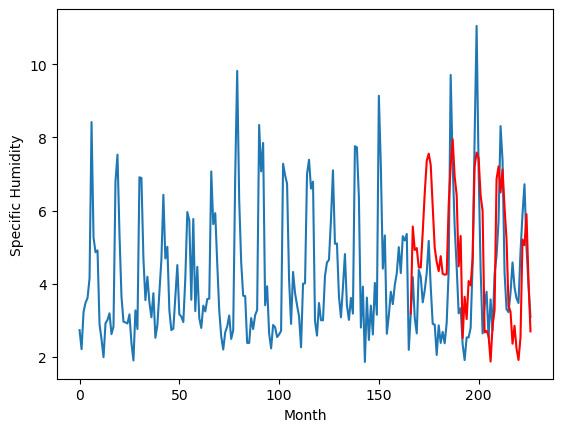

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.53		4.66		0.13
5.76		4.17		-1.59
5.08		4.17		-0.91
4.19		3.81		-0.38
4.67		3.89		-0.78
5.73		4.83		-0.90
6.59		5.56		-1.03
6.81		6.44		-0.37
7.28		6.35		-0.93
8.08		6.66		-1.42
7.69		5.94		-1.75
5.49		5.24		-0.25
4.33		4.16		-0.17
3.99		3.31		-0.68
4.66		3.80		-0.86
4.31		3.78		-0.53
3.96		3.48		-0.48
4.89		3.40		-1.49
5.33		5.15		-0.18
6.76		6.30		-0.46
7.24		6.85		-0.39
7.63		5.97		-1.66
6.99		5.82		-1.17
5.96		3.82		-2.14
6.18		4.38		-1.80
4.93		2.24		-2.69
4.60		2.77		-1.83
3.76		2.47		-1.29
4.76		3.50		-1.26
4.86		3.31		-1.55
5.23		4.01		-1.22
6.72		6.36		-0.36
7.55		6.76		-0.79
8.01		6.52		-1.49
7.41		5.73		-1.68
6.10		5.30		-0.80
3.85		2.21		-1.64
4.64		2.00		-2.64
4.47		1.81		-2.66
3.61		1.48		-2.13
4.41		2.30		-2.11
4.79		2.83		-1.96
6.38		5.90		-0.48
6.44		6.22		-0.22
7.28		5.54		-1.74
8.55		6.19		-2.36
8.00		5.17		-2.83
6.57		4.29		-2.28
5.48		2.58		-2.90
5.86		2.18		-3.68
5.87		

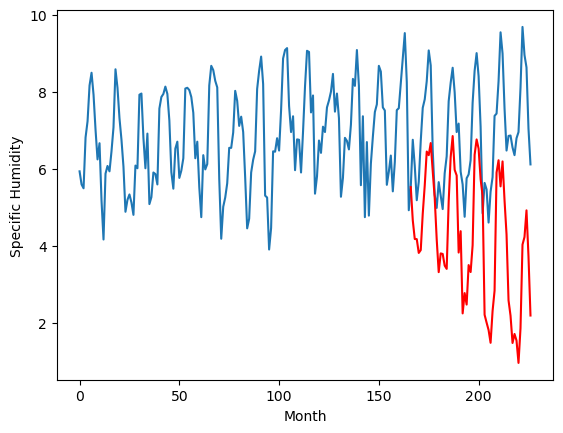

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.50		1.13		0.63
0.14		1.11		0.97
-0.14		0.78		0.92
-0.06		0.52		0.58
0.43		1.26		0.83
0.93		1.79		0.86
3.16		4.12		0.96
7.27		7.73		0.46
11.25		10.20		-1.05
10.18		9.56		-0.62
6.81		6.43		-0.38
4.28		3.99		-0.29
2.12		2.08		-0.04
0.16		0.57		0.41
-0.93		0.17		1.10
-0.78		-0.22		0.56
0.00		0.75		0.75
1.38		1.71		0.33
2.95		3.32		0.37
7.85		7.70		-0.15
10.06		9.06		-1.00
10.44		9.49		-0.95
7.84		6.97		-0.87
5.30		4.98		-0.32
0.77		0.85		0.08
0.47		0.34		-0.13
-1.01		-0.45		0.56
-0.42		0.18		0.60
0.42		1.11		0.69
1.07		1.85		0.78
4.46		5.32		0.86
6.80		7.28		0.48
9.96		9.87		-0.09
10.10		9.23		-0.87
6.43		6.66		0.23
3.80		3.06		-0.74
1.95		1.64		-0.31
-0.02		0.18		0.20
0.55		0.64		0.09
-0.16		0.23		0.39
0.05		0.48		0.43
2.29		2.32		0.03
2.81		3.81		1.00
6.51		6.72		0.21
11.36		10.08		-1.28
8.79		9.00		0.21
7.82		7.11		-0.71
4.43		4.20		-0.23
0.63		0.78		0.15
0.96		1.15		0.19
-0.34		0.03		0.37


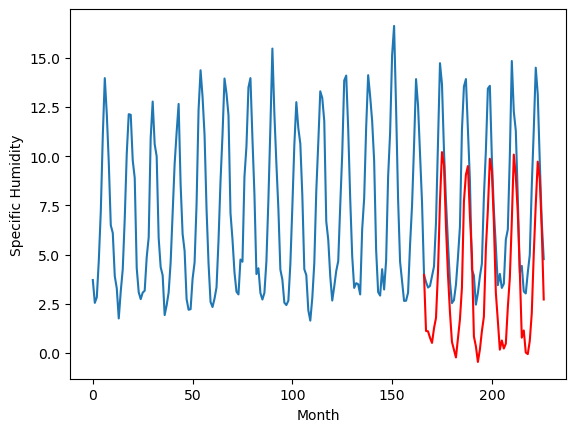

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.56		-1.81		0.75
-2.68		-1.79		0.89
-2.76		-2.16		0.60
-2.77		-2.38		0.39
-1.81		-1.44		0.37
-1.38		-0.99		0.39
1.15		1.49		0.34
4.72		5.34		0.62
8.07		7.99		-0.08
7.43		7.26		-0.17
4.14		3.96		-0.18
1.37		1.33		-0.04
-0.96		-0.70		0.26
-2.81		-2.40		0.41
-3.50		-2.84		0.66
-3.64		-3.20		0.44
-2.36		-2.06		0.30
-0.95		-1.07		-0.12
0.64		0.66		0.02
5.51		5.29		-0.22
7.20		6.71		-0.49
7.52		7.18		-0.34
4.60		4.45		-0.15
2.70		2.42		-0.28
-2.22		-2.19		0.03
-2.32		-2.35		-0.03
-3.83		-3.45		0.38
-3.13		-2.71		0.42
-2.19		-1.77		0.42
-1.55		-0.84		0.71
2.63		2.91		0.28
4.03		4.88		0.85
7.01		7.62		0.61
6.64		6.90		0.26
3.62		4.15		0.53
0.20		0.15		-0.05
-1.02		-1.06		-0.04
-2.94		-2.65		0.29
-2.16		-2.18		-0.02
-2.91		-2.46		0.45
-2.78		-2.25		0.53
-0.35		-0.35		0.00
0.12		1.14		1.02
3.81		4.27		0.46
7.79		7.87		0.08
6.55		6.73		0.18
4.86		4.65		-0.21
1.59		1.46		-0.13
-2.09		-2.05		0.04
-1.71

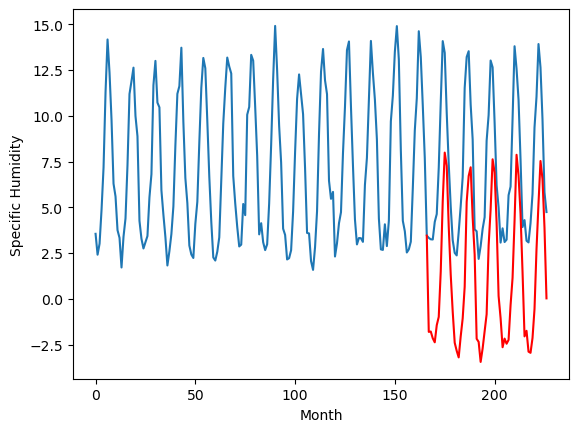

RangeIndex(start=1, stop=12, step=1)
[-3.310000000000001, -0.13999999999999968, 5.989999999999999, -0.8299999999999992, 3.6100000000000003, 0.2400000000000002, 6.16, 4.990000000000001, 4.529999999999999, 0.49999999999999956, -2.56]
[-2.900312957763672, 0.14366267204284666, 7.152824931144714, -0.30675748825073246, 2.3154398059844974, 0.39686487197875975, 6.1794219589233395, 5.564291706085205, 4.6604313778877255, 1.1279506015777585, -1.808765230178833]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.31  -2.900313
1                 1   -0.14   0.143663
2                 2    5.99   7.152825
3                 3   -0.83  -0.306757
4                 4    3.61   2.315440
5                 5    0.24   0.396865
6                 6    6.16   6.179422
7                 7    4.99   5.564292
8                 8    4.53   4.660431
9                 9    0.50   1.127951
10               10   -2.56  -1.808765


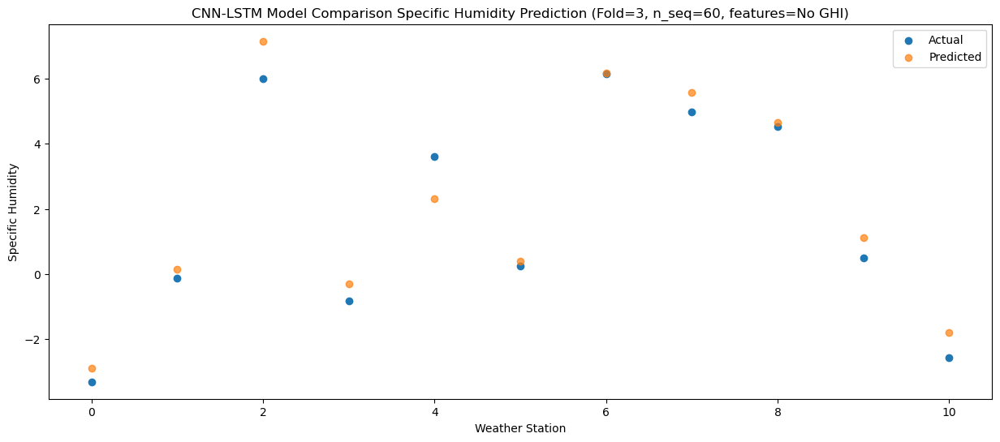

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.10  -2.801612
1                 1   -0.55  -0.354502
2                 2    6.53   6.583033
3                 3   -0.30  -0.312593
4                 4    2.11   2.010590
5                 5    0.53   0.232921
6                 6    5.79   5.591323
7                 7    5.98   4.920767
8                 8    5.76   4.173179
9                 9    0.14   1.106801
10               10   -2.68  -1.787527


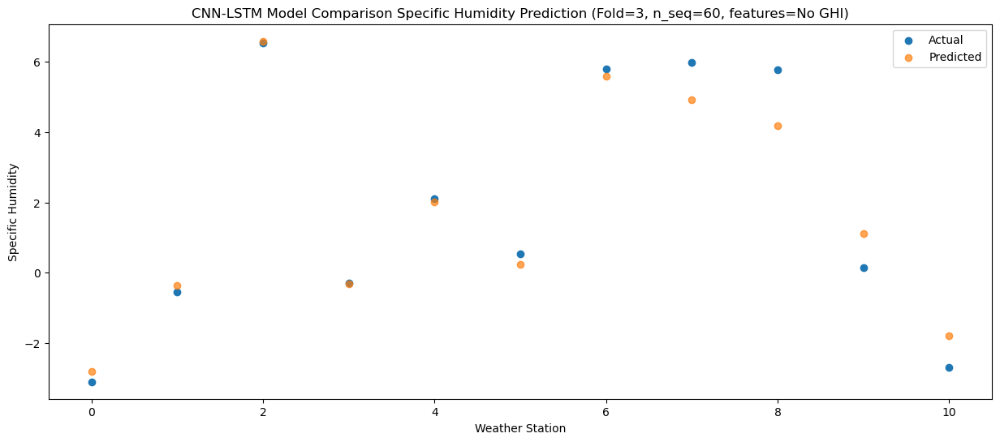

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.05  -3.289352
1                 1   -0.58  -0.410773
2                 2    6.15   6.619999
3                 3   -0.70  -0.724047
4                 4   -0.18   1.739346
5                 5    0.03  -0.109840
6                 6    5.75   5.583801
7                 7    4.86   4.973615
8                 8    5.08   4.169965
9                 9   -0.14   0.779364
10               10   -2.76  -2.158387


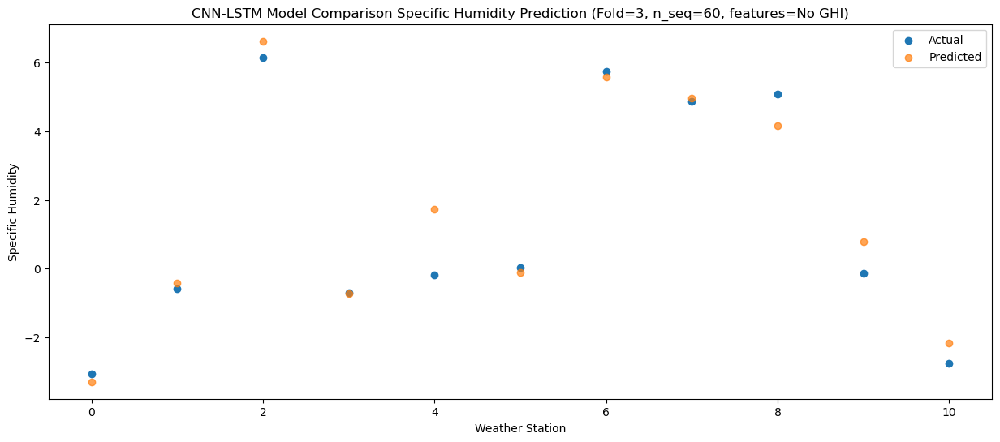

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -2.72  -3.291219
1                 1   -0.94  -0.807975
2                 2    5.46   6.163285
3                 3   -0.88  -0.872201
4                 4   -0.94   1.387714
5                 5   -0.22  -0.382004
6                 6    5.71   5.101435
7                 7    4.44   4.444162
8                 8    4.19   3.811408
9                 9   -0.06   0.518502
10               10   -2.77  -2.378119


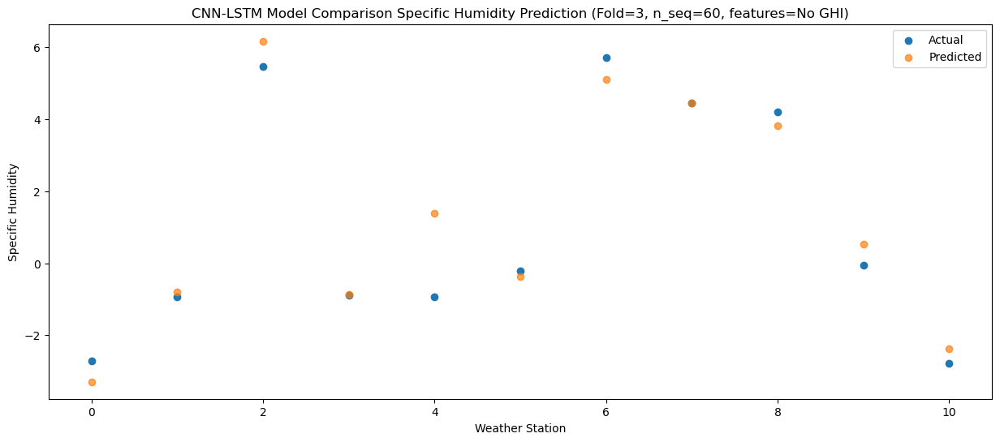

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -0.99  -1.626722
1                 1    1.66   1.713600
2                 2    6.54   6.161008
3                 3    0.98   0.780244
4                 4    1.13   3.241383
5                 5    1.77   1.337482
6                 6    6.34   5.568092
7                 7    6.18   4.441142
8                 8    4.67   3.885181
9                 9    0.43   1.256754
10               10   -1.81  -1.443501


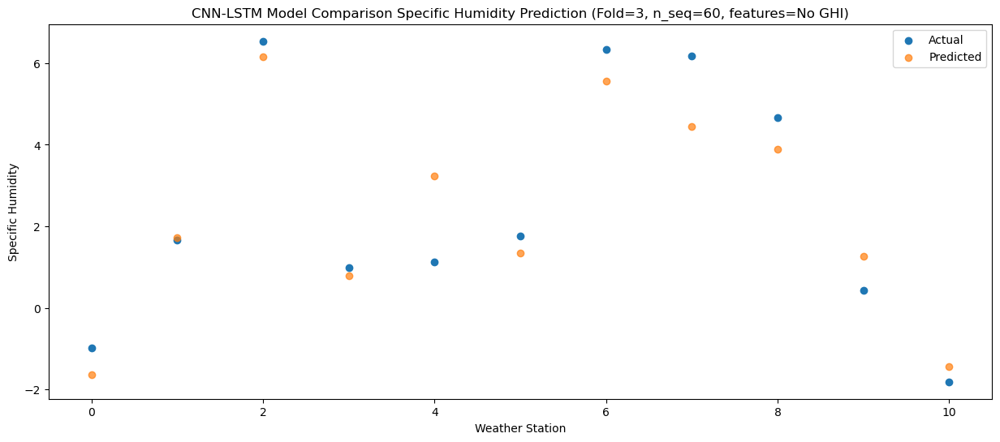

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.17  -1.437884
1                 1    1.81   1.710837
2                 2    7.91   7.121503
3                 3    0.90   1.013911
4                 4    1.45   3.485869
5                 5    1.89   1.600968
6                 6    6.69   6.364889
7                 7    5.99   5.411106
8                 8    5.73   4.830104
9                 9    0.93   1.787960
10               10   -1.38  -0.989979


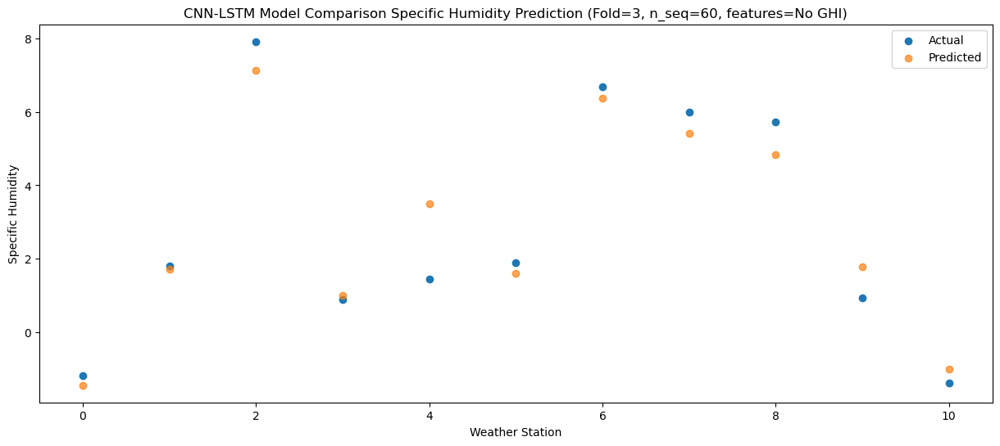

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.05   0.965462
1                 1    4.78   4.516012
2                 2    7.72   8.009753
3                 3    4.33   3.675077
4                 4    5.15   6.391769
5                 5    5.10   4.433808
6                 6    7.82   7.892684
7                 7    5.29   6.477579
8                 8    6.59   5.563666
9                 9    3.16   4.118864
10               10    1.15   1.491478


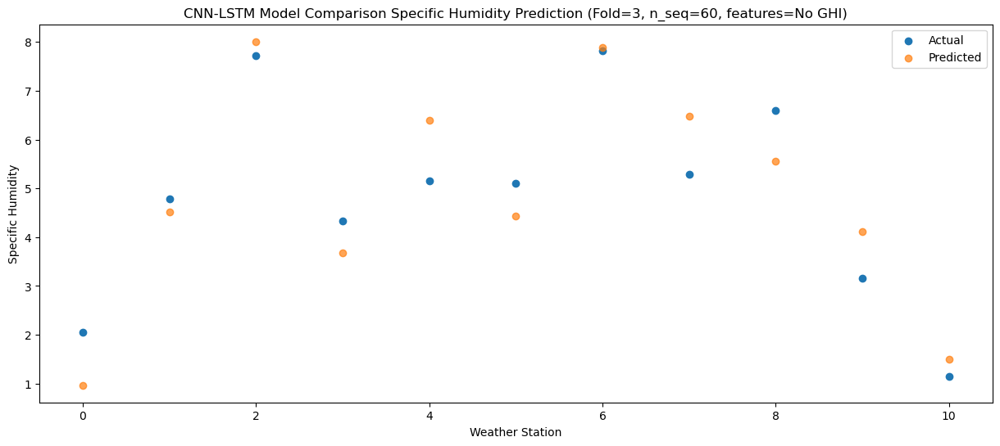

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    5.59   4.905652
1                 1    8.31   7.864961
2                 2    9.26   8.862401
3                 3    7.57   7.650703
4                 4    8.24  10.087537
5                 5    7.83   8.297179
6                 6    8.88   9.427231
7                 7    5.62   7.357553
8                 8    6.81   6.444096
9                 9    7.27   7.726893
10               10    4.72   5.336261


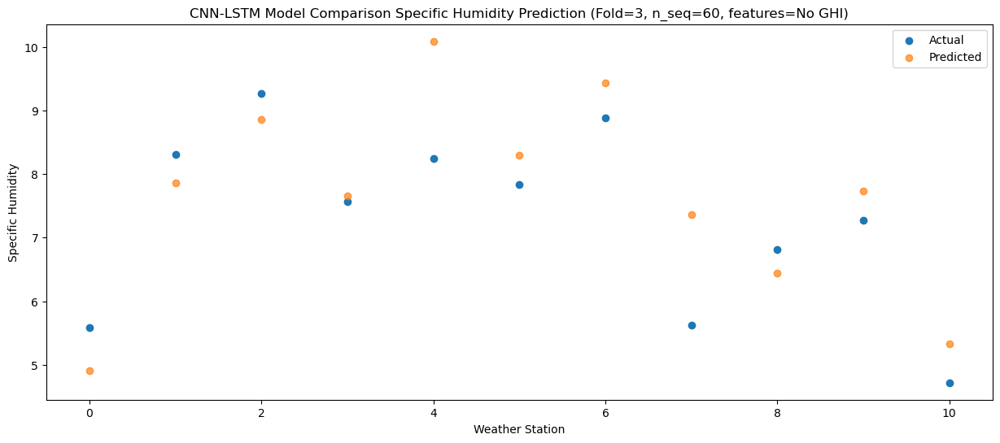

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    8.28   7.264408
1                 1   11.05  10.448576
2                 2    9.48   8.911663
3                 3   10.67  10.296594
4                 4   12.19  12.772151
5                 5   10.99  11.019520
6                 6   10.40  10.217133
7                 7    6.10   7.556328
8                 8    7.28   6.350012
9                 9   11.25  10.203080
10               10    8.07   7.988423


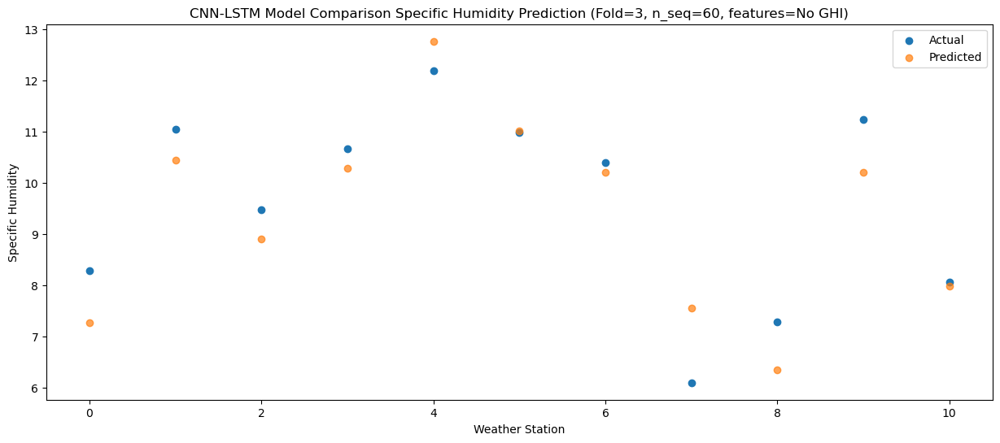

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    8.57   6.880194
1                 1    8.38   8.580431
2                 2   11.00   8.904003
3                 3    9.59   9.406702
4                 4    9.81  11.174774
5                 5    9.77   9.705499
6                 6    9.19   9.571007
7                 7    6.97   7.245362
8                 8    8.08   6.663777
9                 9   10.18   9.557937
10               10    7.43   7.263431


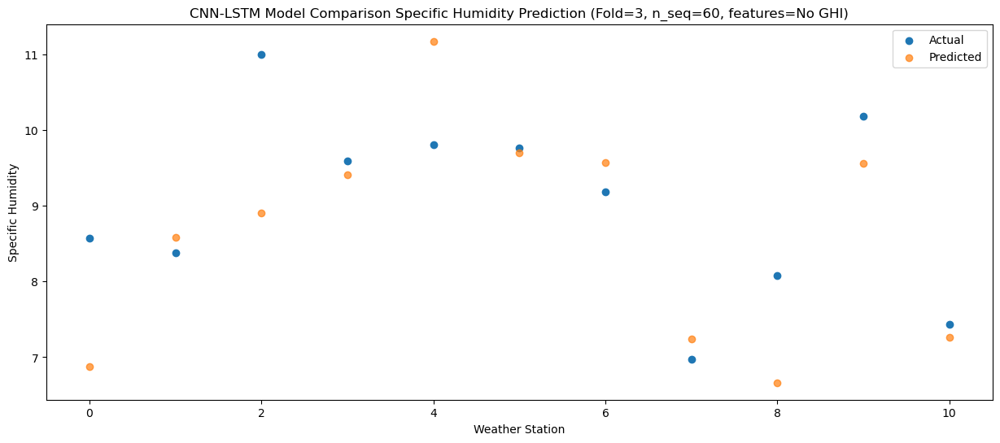

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.929328
1                 1    6.94   5.735631
2                 2   10.52   7.982816
3                 3    7.02   6.154524
4                 4    6.85   7.831034
5                 5    6.59   6.323086
6                 6    8.05   7.919242
7                 7    5.71   6.104368
8                 8    7.69   5.937722
9                 9    6.81   6.428873
10               10    4.14   3.962726


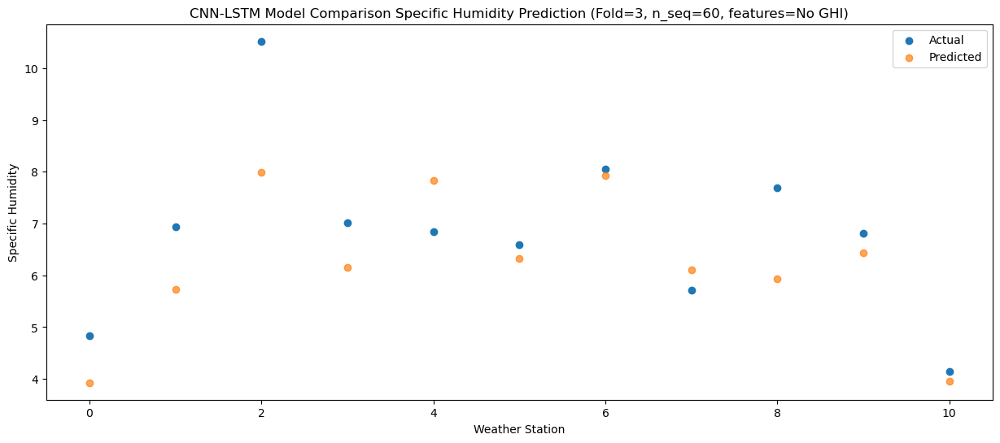

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.25   1.268781
1                 1    2.37   2.009417
2                 2    8.64   7.090250
3                 3    3.33   3.146343
4                 4    2.13   4.368571
5                 5    3.17   3.038203
6                 6    6.40   6.219744
7                 7    4.70   4.984108
8                 8    5.49   5.237212
9                 9    4.28   3.988577
10               10    1.37   1.325280


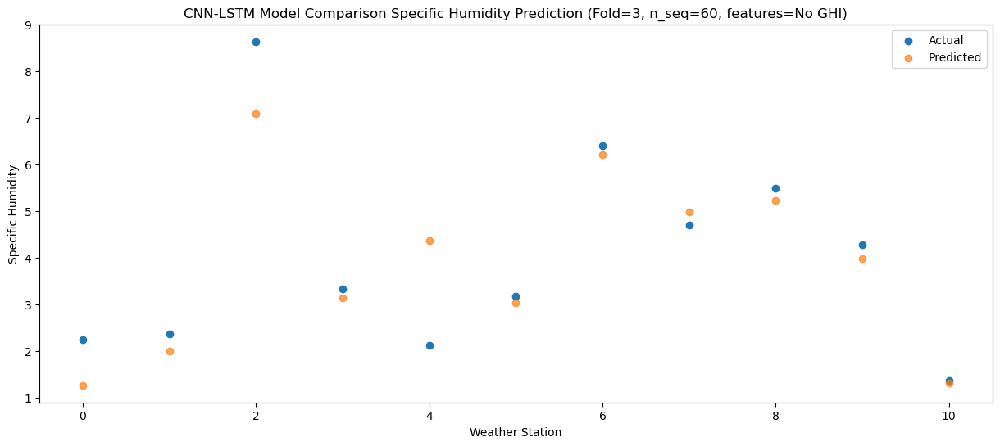

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.49  -1.347146
1                 1    0.87   0.513676
2                 2    5.95   6.376907
3                 3    0.44   0.982071
4                 4    1.03   2.961582
5                 5    1.40   1.327263
6                 6    6.34   5.616499
7                 7    4.68   4.592313
8                 8    4.33   4.162257
9                 9    2.12   2.078919
10               10   -0.96  -0.702132


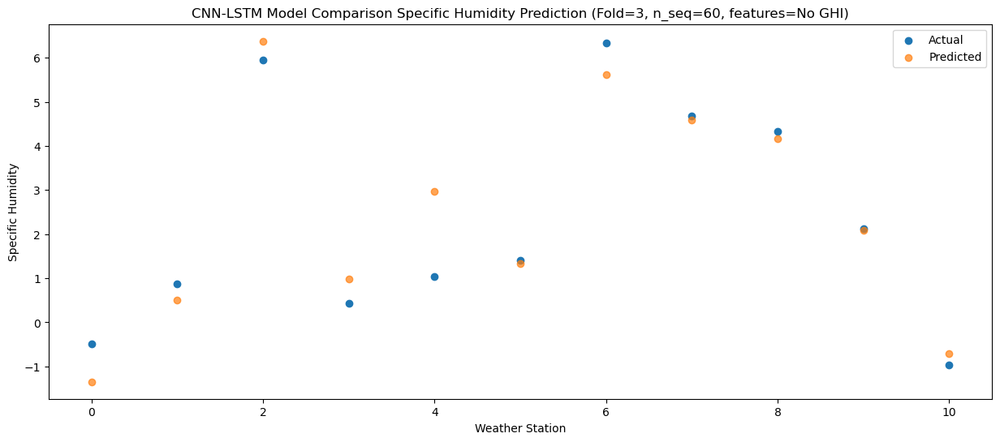

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -4.014860
1                 1   -1.17  -1.394409
2                 2    5.35   5.867554
3                 3   -1.17  -1.224297
4                 4   -0.90   1.278937
5                 5   -0.26  -0.533114
6                 6    5.53   5.044933
7                 7    3.85   4.341185
8                 8    3.99   3.312455
9                 9    0.16   0.570788
10               10   -2.81  -2.401669


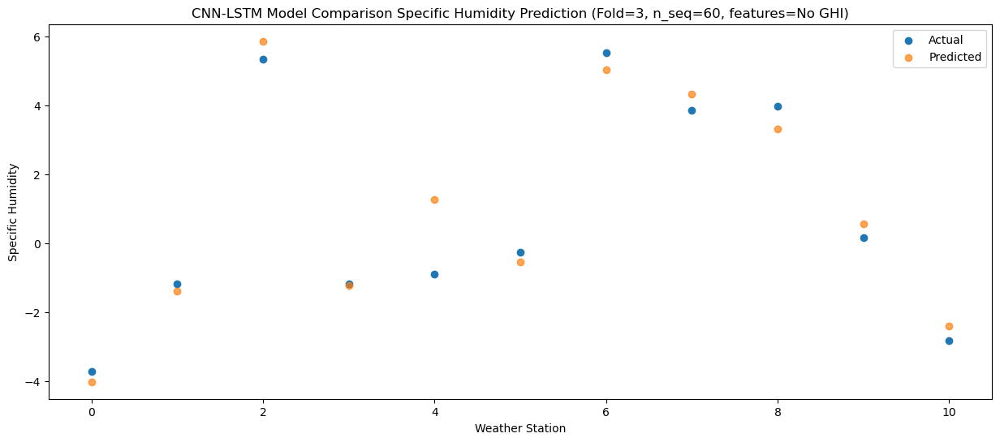

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.84  -4.271472
1                 1   -1.26  -1.446504
2                 2    5.79   6.312817
3                 3   -1.44  -1.545028
4                 4   -1.10   1.075365
5                 5   -0.57  -0.819594
6                 6    5.70   5.315577
7                 7    4.66   4.751949
8                 8    4.66   3.798987
9                 9   -0.93   0.169941
10               10   -3.50  -2.841805


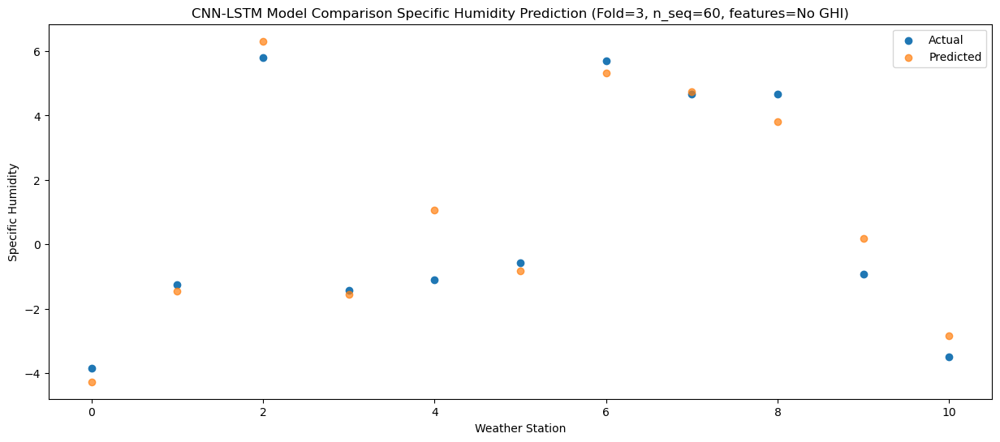

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.75  -4.070796
1                 1   -1.82  -2.128833
2                 2    5.73   6.041893
3                 3   -1.51  -1.745813
4                 4   -1.93   0.427663
5                 5   -1.09  -1.309237
6                 6    5.76   4.777001
7                 7    4.18   4.271060
8                 8    4.31   3.784506
9                 9   -0.78  -0.220302
10               10   -3.64  -3.203507


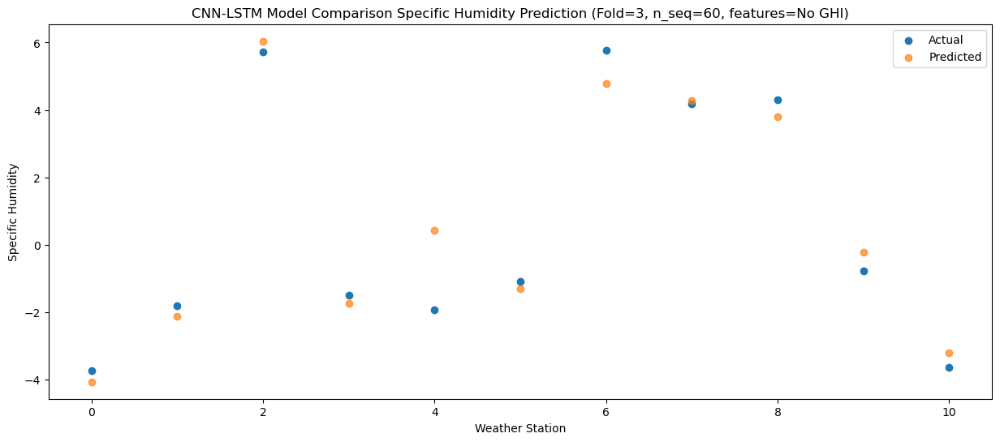

Predictions for (t+16):
    Weather_Station        Actual  Predicted
0                 0 -2.100000e+00  -2.695180
1                 1  6.900000e-01   0.133555
2                 2  5.810000e+00   5.859072
3                 3 -2.100000e-01  -0.168124
4                 4  5.500000e-01   2.365713
5                 5  9.400000e-01   0.471519
6                 6  6.070000e+00   5.257243
7                 7  4.480000e+00   4.244326
8                 8  3.960000e+00   3.481607
9                 9  2.220446e-16   0.747328
10               10 -2.360000e+00  -2.059715


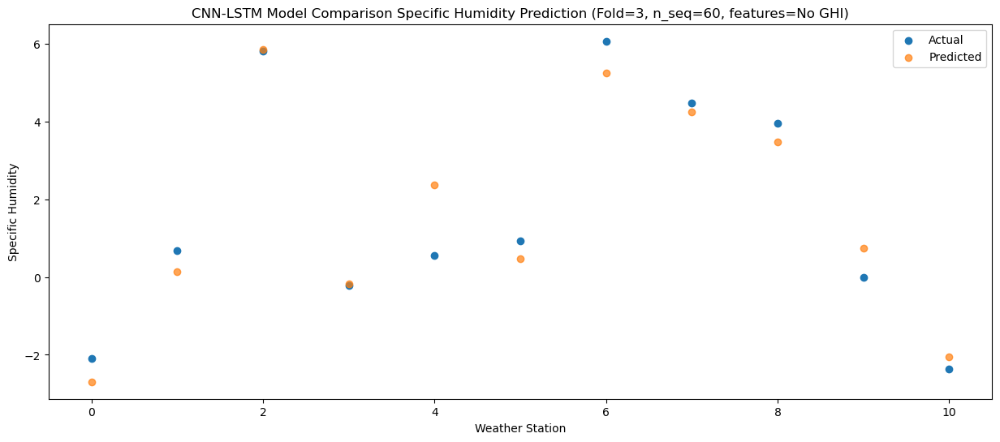

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -1.58  -2.059565
1                 1    1.86   0.812917
2                 2    6.43   5.827717
3                 3    0.98   0.616543
4                 4    1.61   3.143390
5                 5    2.24   1.284286
6                 6    6.54   5.458535
7                 7    4.17   4.260239
8                 8    4.89   3.397029
9                 9    1.38   1.710332
10               10   -0.95  -1.071944


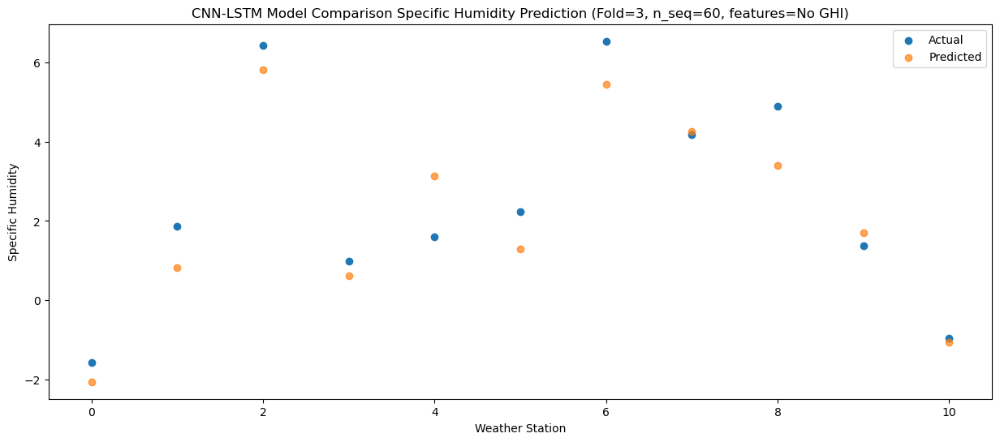

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    1.20   0.197003
1                 1    5.38   4.165554
2                 2    6.83   7.634874
3                 3    3.51   2.938778
4                 4    4.03   5.900969
5                 5    4.48   3.805694
6                 6    7.94   7.599379
7                 7    4.73   6.150681
8                 8    5.33   5.151785
9                 9    2.95   3.324647
10               10    0.64   0.655884


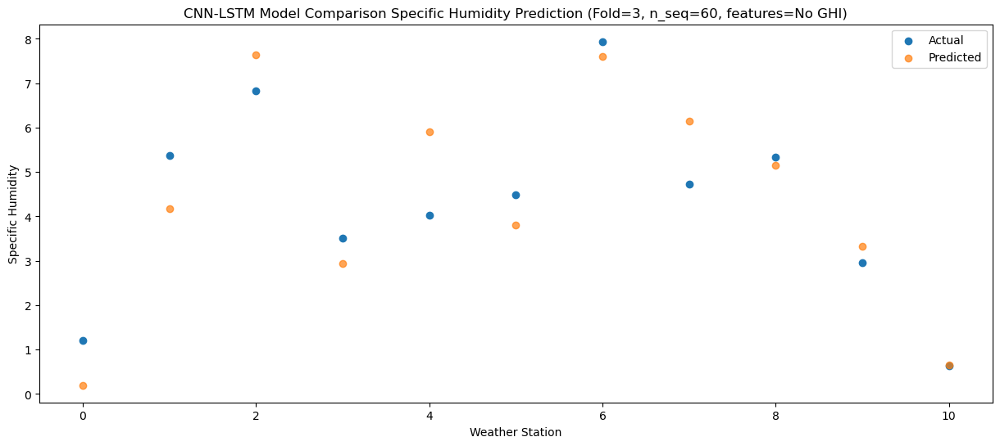

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.92   4.784737
1                 1    9.91   7.821849
2                 2    9.28   8.727440
3                 3    8.93   7.558955
4                 4    8.49  10.045146
5                 5    9.70   8.231439
6                 6    9.27   9.373285
7                 7    6.15   7.241156
8                 8    6.76   6.299912
9                 9    7.85   7.703238
10               10    5.51   5.291219


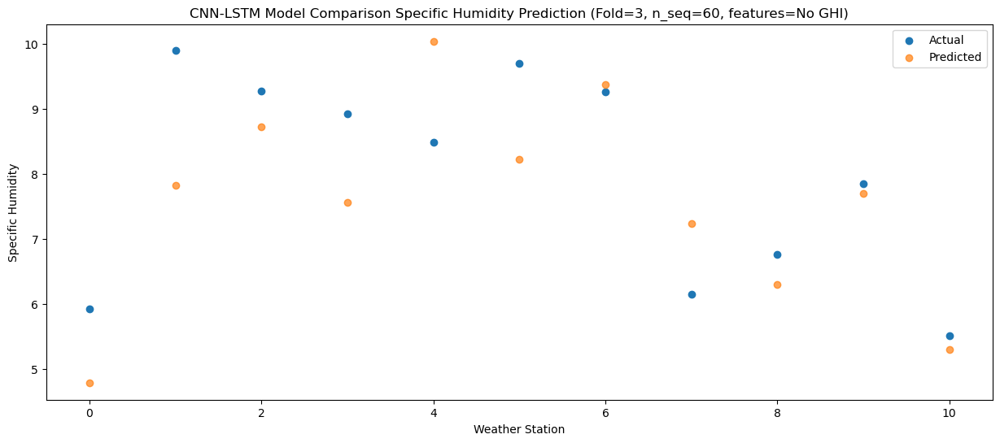

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    7.16   6.130899
1                 1   10.79   9.017196
2                 2    9.98   9.345627
3                 3    9.56   8.973727
4                 4   10.44  11.490220
5                 5   10.95   9.689680
6                 6   11.72  10.245445
7                 7   11.51   7.946444
8                 8    7.24   6.846467
9                 9   10.06   9.060302
10               10    7.20   6.710261


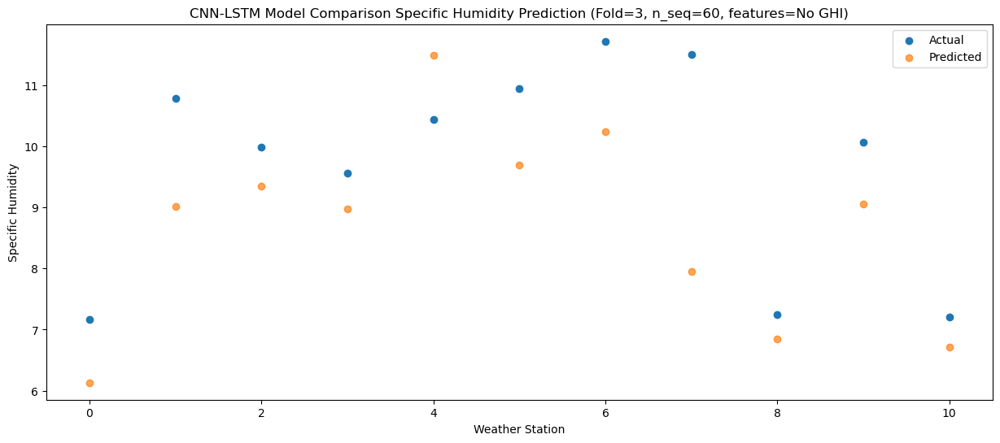

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.43   6.433231
1                 1   10.96   8.555927
2                 2    9.51   8.408999
3                 3   10.44   9.214675
4                 4   10.53  11.320634
5                 5   11.12   9.735352
6                 6   10.29   9.412211
7                 7    9.08   6.927832
8                 8    7.63   5.969632
9                 9   10.44   9.494903
10               10    7.52   7.184547


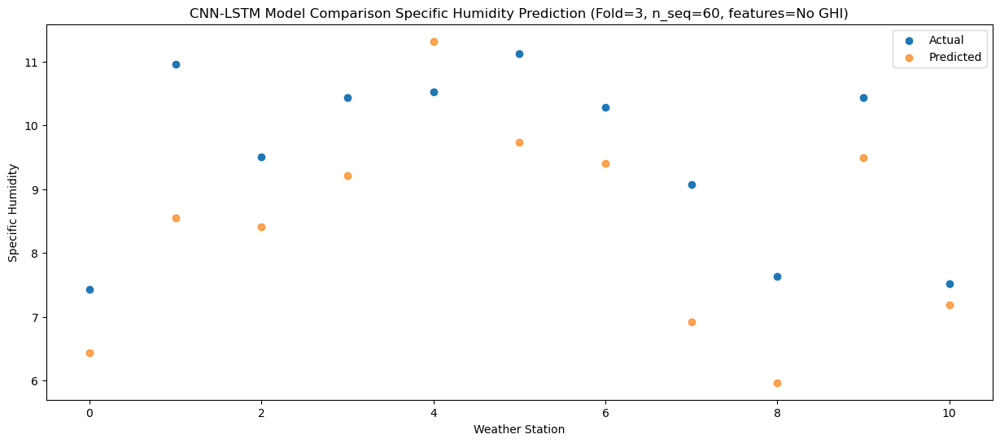

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.81   3.878644
1                 1    6.99   5.569714
2                 2    8.22   8.101790
3                 3    6.97   6.331791
4                 4    6.76   8.253871
5                 5    7.82   6.695367
6                 6    8.59   8.303731
7                 7    7.36   6.423010
8                 8    6.99   5.822721
9                 9    7.84   6.966490
10               10    4.60   4.447292


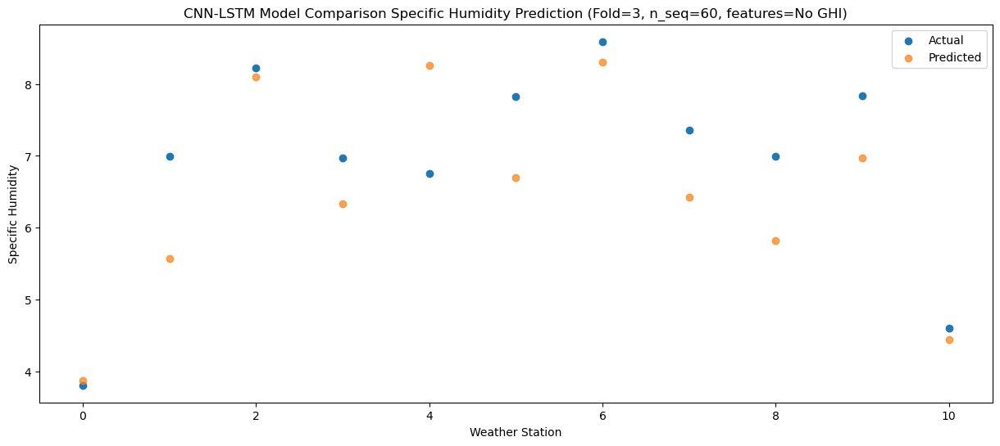

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.77   1.558252
1                 1    4.80   2.930231
2                 2    7.08   6.141400
3                 3    4.91   4.066857
4                 4    4.81   5.907377
5                 5    6.20   4.416327
6                 6    7.50   6.249792
7                 7    6.26   4.475167
8                 8    5.96   3.821279
9                 9    5.30   4.983701
10               10    2.70   2.418776


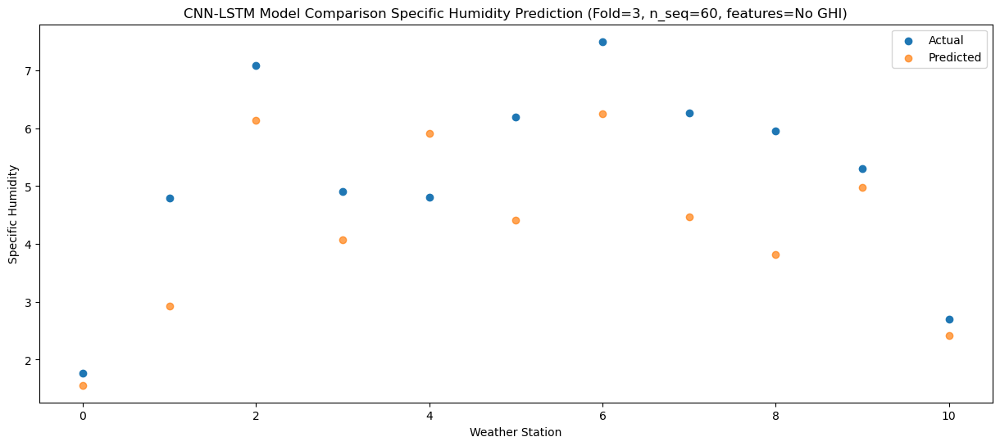

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -3.73  -3.618736
1                 1    0.37  -1.027825
2                 2    7.66   6.895665
3                 3   -0.78  -0.966349
4                 4   -0.31   1.591726
5                 5    0.33  -0.271905
6                 6    6.79   5.913246
7                 7    4.99   5.304929
8                 8    6.18   4.376209
9                 9    0.77   0.847706
10               10   -2.22  -2.185870


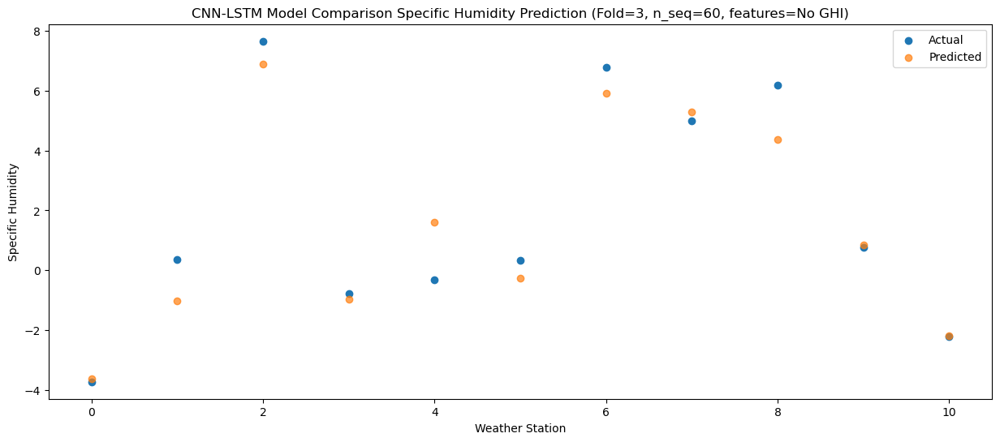

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -2.484883
1                 1    1.34  -0.432767
2                 2    6.16   4.368278
3                 3    0.36  -0.285398
4                 4    0.39   1.709625
5                 5    1.38   0.039378
6                 6    6.08   3.799580
7                 7    5.13   2.508424
8                 8    4.93   2.241016
9                 9    0.47   0.343999
10               10   -2.32  -2.354623


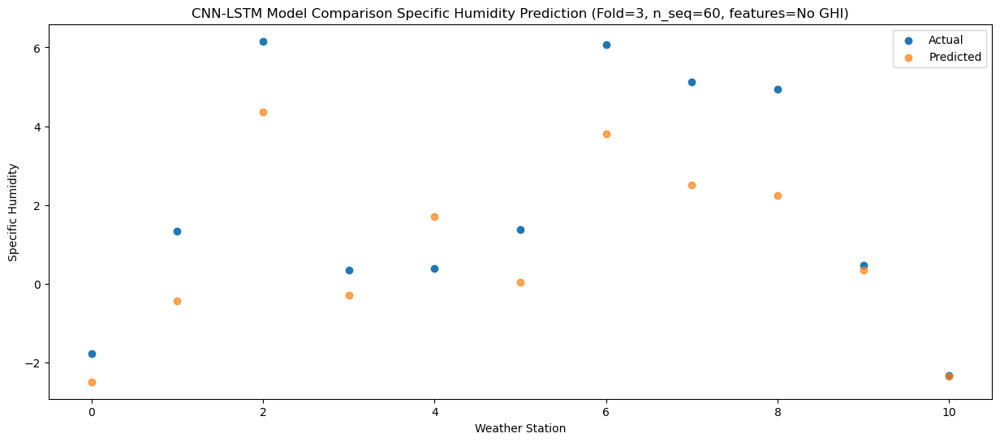

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.57  -4.864893
1                 1   -1.85  -2.772427
2                 2    5.88   5.257493
3                 3   -1.96  -2.276081
4                 4   -2.07   0.106677
5                 5   -1.13  -1.658227
6                 6    5.60   4.292995
7                 7    4.14   3.640836
8                 8    4.60   2.768491
9                 9   -1.01  -0.447087
10               10   -3.83  -3.449687


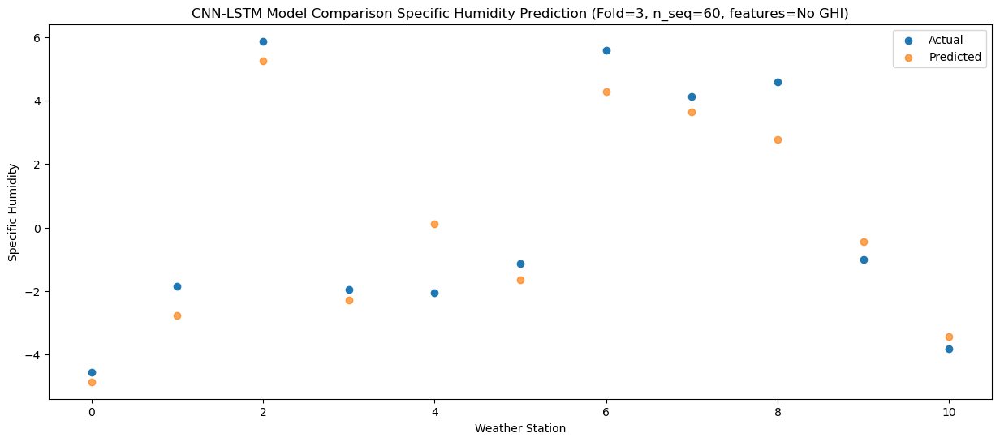

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.21  -3.780914
1                 1   -1.48  -2.425321
2                 2    5.10   4.782807
3                 3   -1.44  -1.405105
4                 4   -1.45   0.556431
5                 5   -0.60  -1.024939
6                 6    5.39   3.918041
7                 7    3.71   3.030386
8                 8    3.76   2.470335
9                 9   -0.42   0.181395
10               10   -3.13  -2.711633


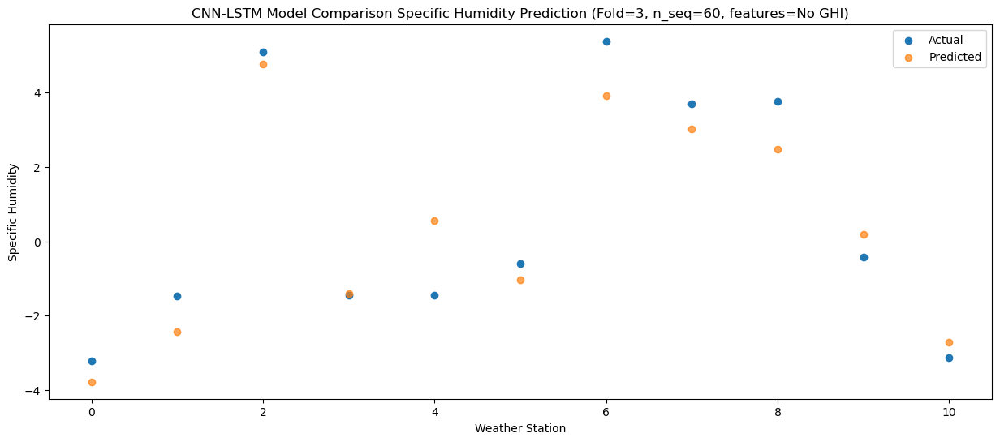

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -2.754973
1                 1   -0.01  -1.284329
2                 2    6.44   5.808972
3                 3   -0.46  -0.375270
4                 4    0.12   1.666297
5                 5    0.71   0.044196
6                 6    6.07   4.985095
7                 7    4.33   4.072727
8                 8    4.76   3.495697
9                 9    0.42   1.107398
10               10   -2.19  -1.774695


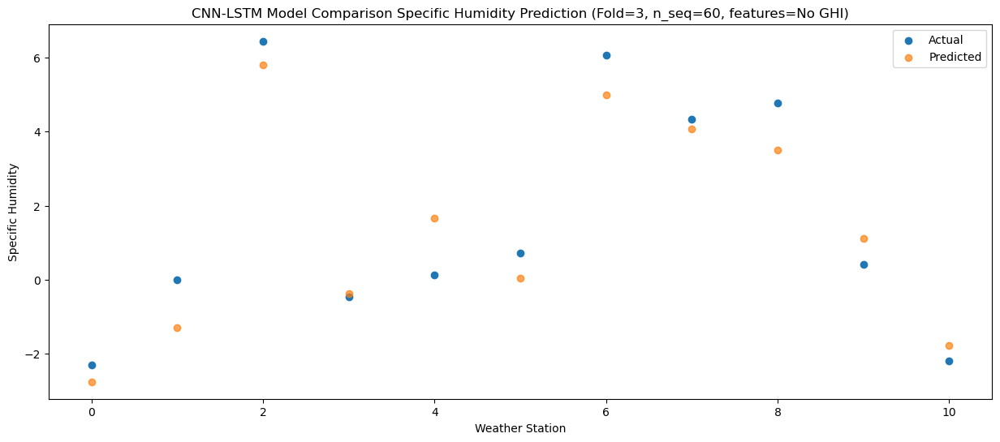

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.28  -1.331136
1                 1    2.29   1.129823
2                 2    6.11   5.628998
3                 3    0.81   1.130825
4                 4    1.68   3.461212
5                 5    2.24   1.681525
6                 6    6.57   5.355448
7                 7    4.33   3.952710
8                 8    4.86   3.314712
9                 9    1.07   1.846675
10               10   -1.55  -0.844828


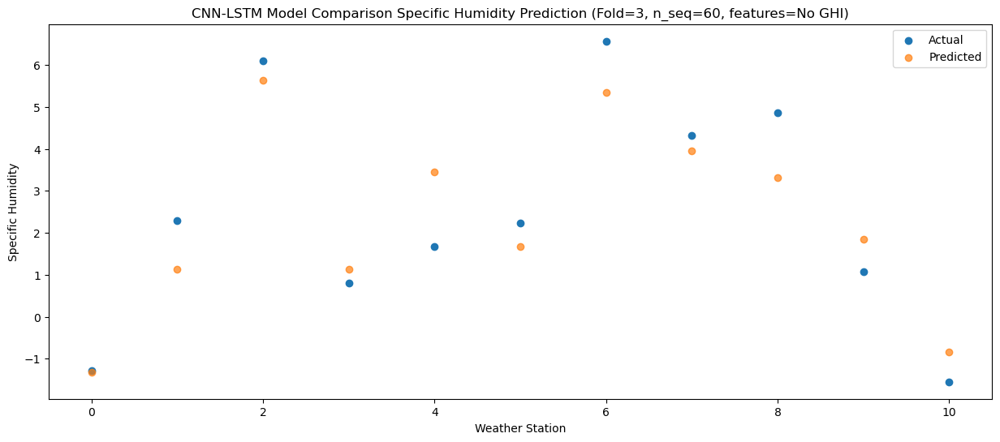

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    3.03   2.699617
1                 1    6.74   5.040030
2                 2    6.29   6.307067
3                 3    5.23   5.237865
4                 4    5.77   7.435812
5                 5    6.47   5.744654
6                 6    7.38   6.852780
7                 7    4.59   4.690823
8                 8    5.23   4.011146
9                 9    4.46   5.319672
10               10    2.63   2.913719


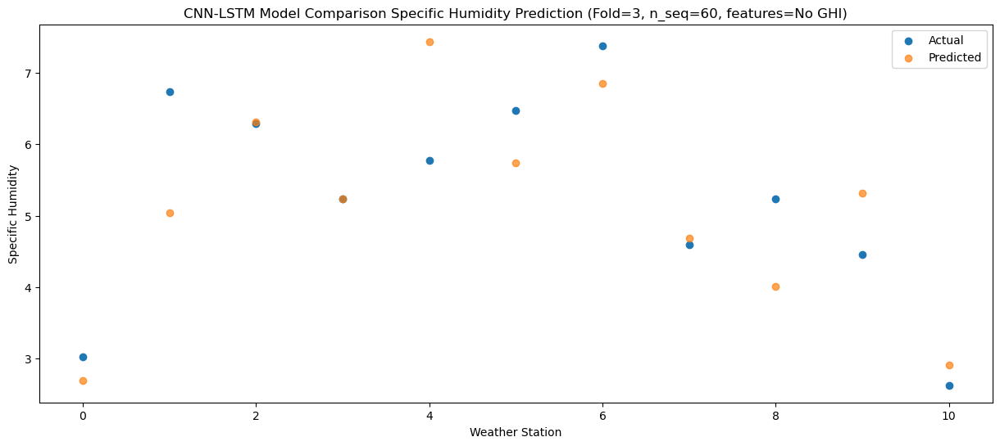

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.33   4.729516
1                 1    9.36   7.411146
2                 2    7.46   8.733914
3                 3    7.49   7.343578
4                 4    7.87   9.809303
5                 5    8.54   7.997215
6                 6    9.32   9.361320
7                 7    6.35   7.213504
8                 8    6.72   6.359507
9                 9    6.80   7.276394
10               10    4.03   4.878616


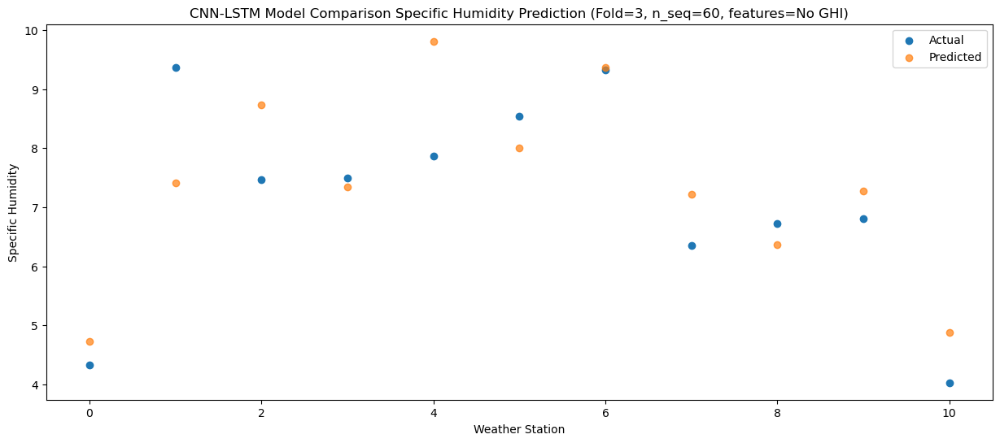

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    8.40   7.316532
1                 1    9.57   8.844770
2                 2    8.63   9.102587
3                 3   10.53   9.925483
4                 4   10.46  11.949764
5                 5   11.32  10.402725
6                 6   12.31  10.108491
7                 7    9.78   7.586154
8                 8    7.55   6.759102
9                 9    9.96   9.866433
10               10    7.01   7.622325


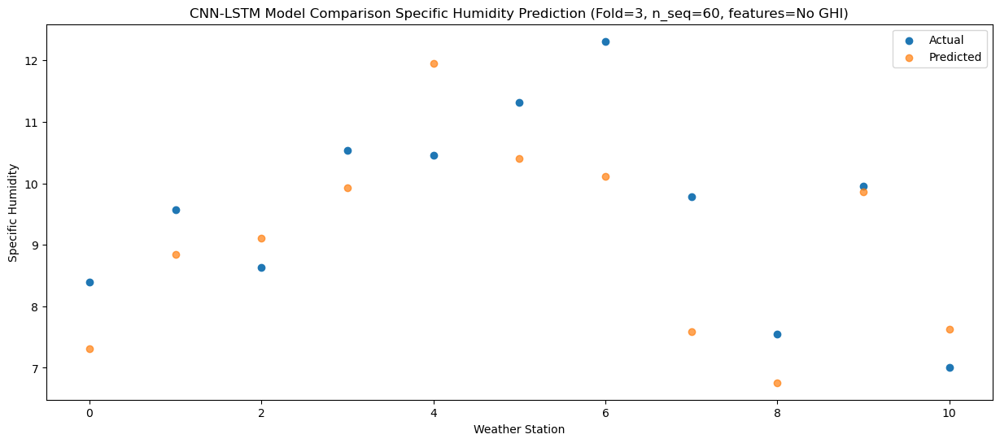

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.59   6.304637
1                 1   10.18   8.261012
2                 2    9.42   8.923192
3                 3    9.40   9.035324
4                 4    9.96  11.205326
5                 5   10.12   9.598652
6                 6   12.15   9.823631
7                 7   12.85   7.432302
8                 8    8.01   6.518201
9                 9   10.10   9.233958
10               10    6.64   6.902707


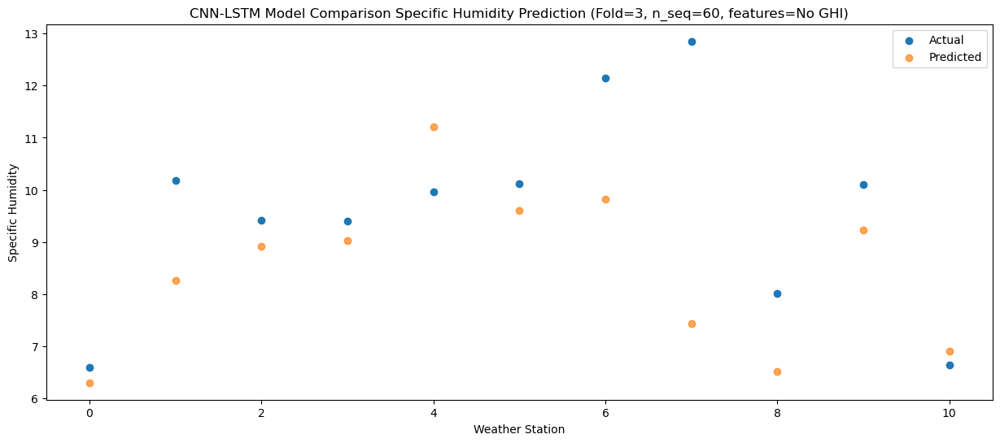

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.17   3.507513
1                 1    6.33   4.966361
2                 2    9.13   8.030942
3                 3    6.15   6.037311
4                 4    6.86   8.046174
5                 5    7.35   6.491461
6                 6    9.20   8.293470
7                 7    8.94   6.414430
8                 8    7.41   5.728879
9                 9    6.43   6.664164
10               10    3.62   4.154527


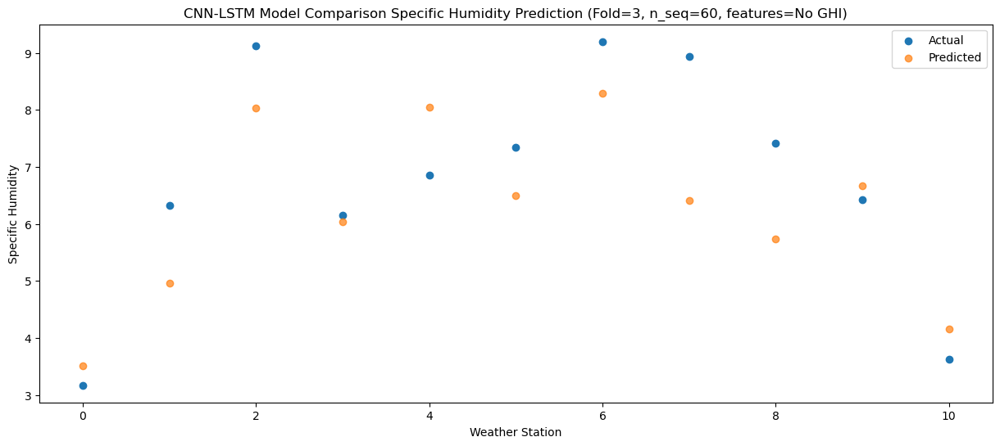

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.06  -1.109095
1                 1    1.87   0.500542
2                 2    7.96   7.667400
3                 3    1.00   1.391836
4                 4    1.86   3.519935
5                 5    2.05   1.887242
6                 6    7.59   6.917064
7                 7    6.21   5.988980
8                 8    6.10   5.295676
9                 9    3.80   3.061346
10               10    0.20   0.151725


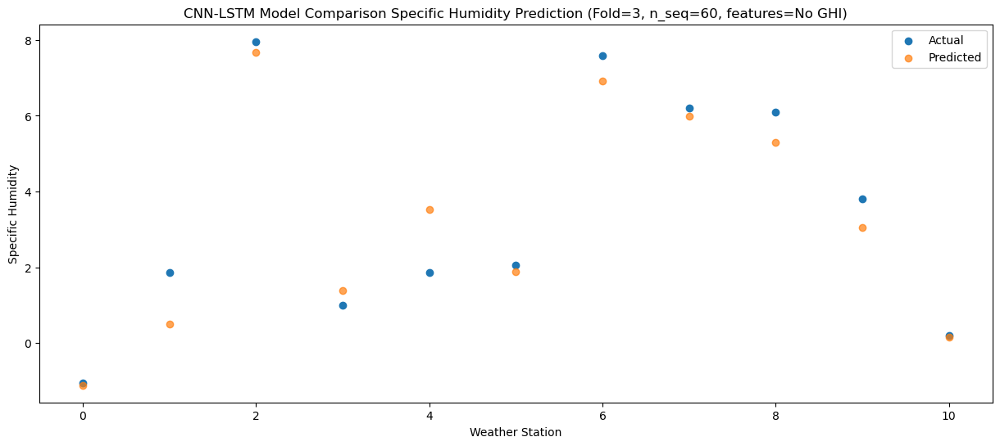

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.51  -1.739860
1                 1    0.84  -0.562484
2                 2    5.24   4.420524
3                 3    0.19   0.568154
4                 4    0.47   2.387786
5                 5    0.83   0.876814
6                 6    5.93   4.102682
7                 7    4.44   2.667663
8                 8    3.85   2.205242
9                 9    1.95   1.636953
10               10   -1.02  -1.058393


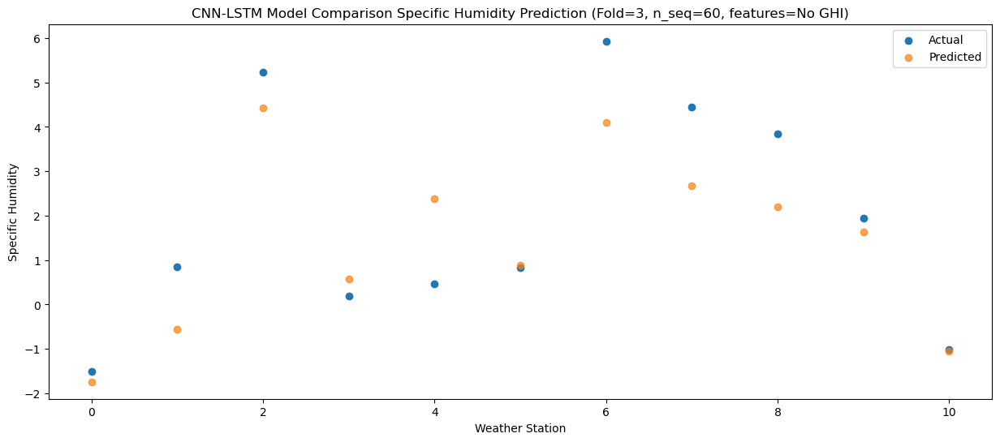

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -3.559754
1                 1   -0.35  -1.513293
2                 2    6.08   4.365823
3                 3   -0.84  -1.059682
4                 4   -0.65   1.184892
5                 5    0.07  -0.520188
6                 6    5.96   3.869300
7                 7    5.19   2.709155
8                 8    4.64   2.002399
9                 9   -0.02   0.175709
10               10   -2.94  -2.646671


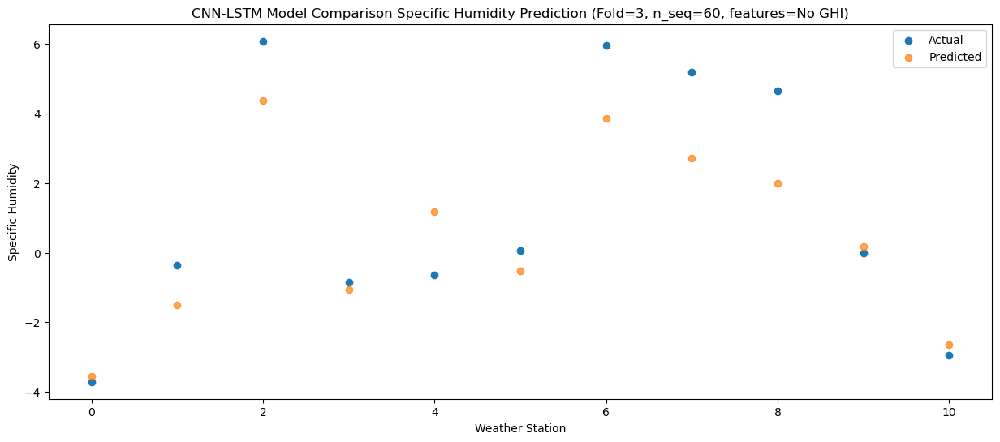

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.80  -3.357502
1                 1   -0.43  -1.730797
2                 2    6.23   4.208458
3                 3   -0.30  -0.811976
4                 4   -0.27   1.295213
5                 5    0.65  -0.312768
6                 6    5.93   3.777568
7                 7    5.58   2.577980
8                 8    4.47   1.809329
9                 9    0.55   0.642497
10               10   -2.16  -2.175138


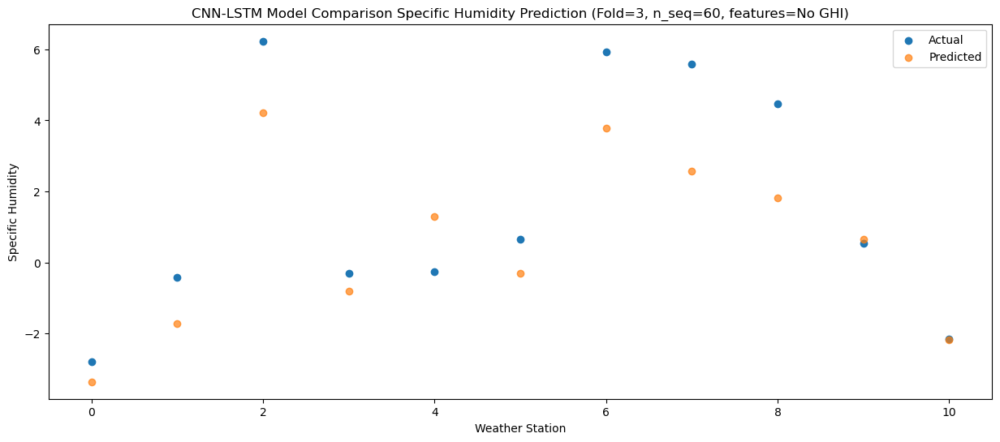

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.07  -2.761172
1                 1   -0.27  -1.428209
2                 2    5.10   3.654758
3                 3   -0.48  -0.550176
4                 4    0.61   1.348642
5                 5    0.32  -0.221181
6                 6    5.55   3.255131
7                 7    4.33   1.870063
8                 8    3.61   1.477693
9                 9   -0.16   0.233506
10               10   -2.91  -2.455794


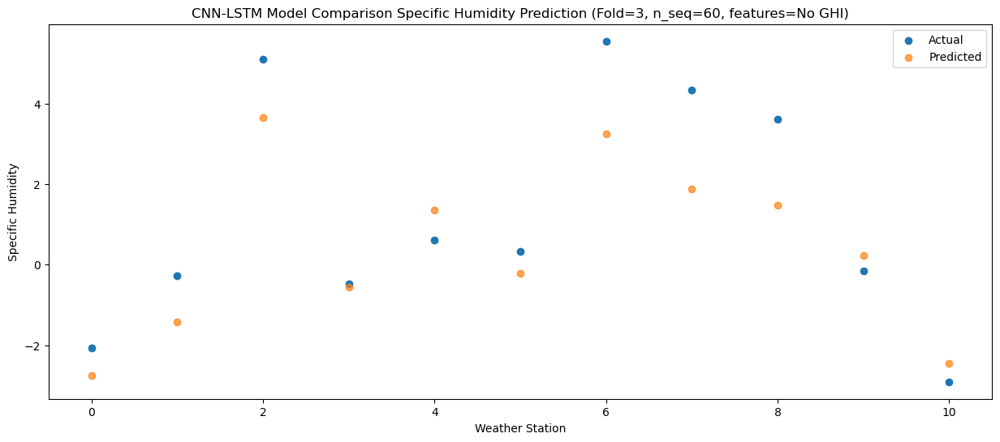

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.46  -2.591615
1                 1    0.67  -0.455643
2                 2    6.62   4.565370
3                 3   -0.61  -0.240352
4                 4    0.28   1.999141
5                 5    0.75   0.266410
6                 6    5.85   4.190217
7                 7    5.37   2.851990
8                 8    4.41   2.303143
9                 9    0.05   0.480874
10               10   -2.78  -2.245919


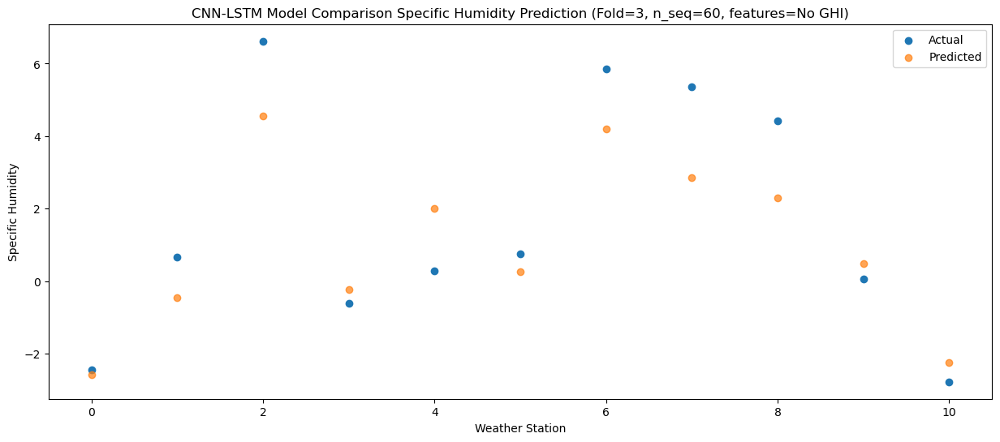

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.47  -0.919881
1                 1    1.54   0.365825
2                 2    6.82   5.036382
3                 3    0.93   1.402879
4                 4    1.51   3.237018
5                 5    2.06   1.727507
6                 6    6.48   4.772075
7                 7    4.52   3.274121
8                 8    4.79   2.830689
9                 9    2.29   2.324326
10               10   -0.35  -0.346201


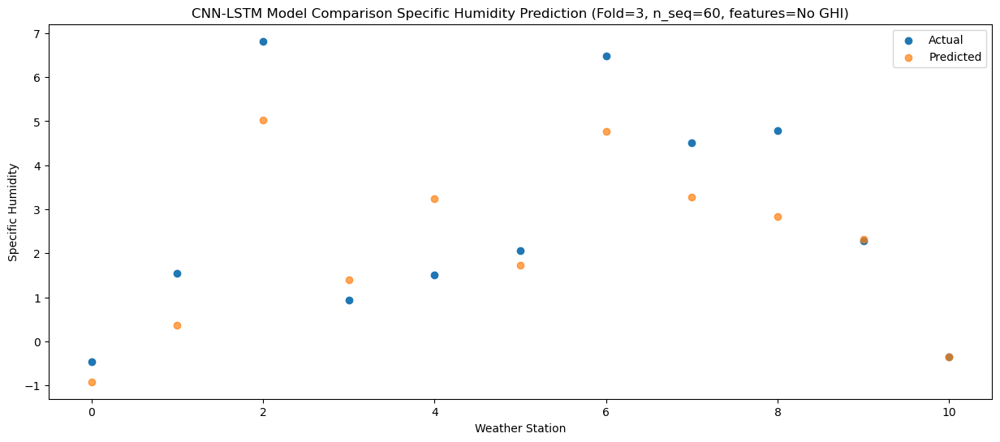

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.98   0.950640
1                 1    5.95   4.684719
2                 2    7.76   8.362496
3                 3    3.84   3.607267
4                 4    4.69   6.571919
5                 5    4.66   4.497357
6                 6    8.64   8.401920
7                 7    6.06   6.862709
8                 8    6.38   5.898313
9                 9    2.81   3.807864
10               10    0.12   1.144441


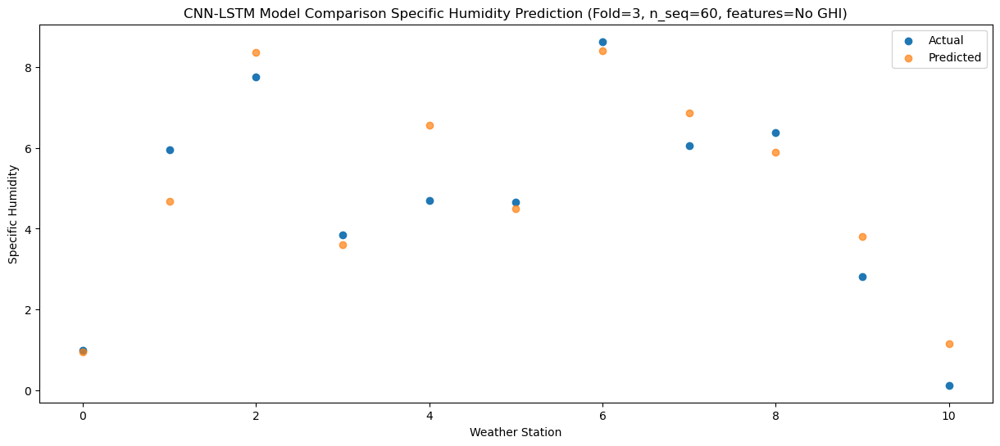

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    4.25   4.162937
1                 1    8.59   7.702464
2                 2    8.53   8.673996
3                 3    5.86   6.870232
4                 4    6.82   9.662916
5                 5    6.82   7.692682
6                 6    8.87   9.400845
7                 7    6.56   7.208743
8                 8    6.44   6.218177
9                 9    6.51   6.715390
10               10    3.81   4.271124


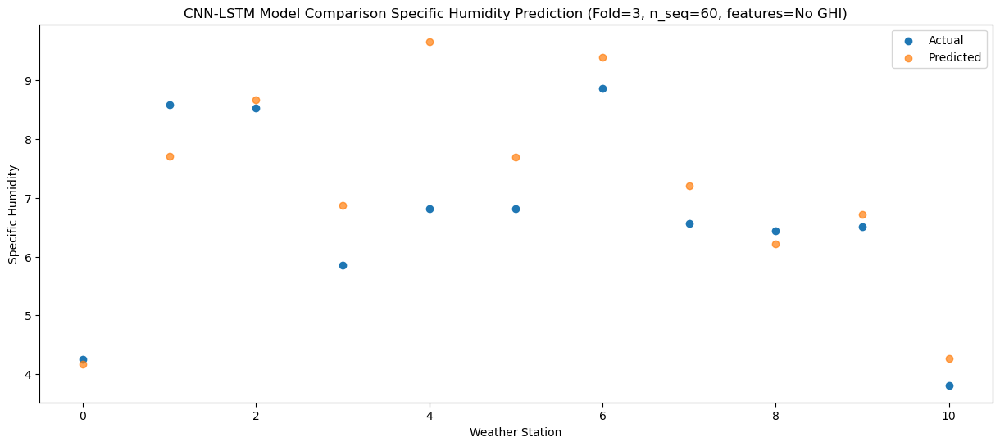

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    8.20   7.297791
1                 1   10.86   8.999834
2                 2    9.63   7.969068
3                 3    9.51  10.019815
4                 4   10.59  11.999701
5                 5   11.33  10.502957
6                 6    9.71   9.343837
7                 7    7.53   6.495988
8                 8    7.28   5.539425
9                 9   11.36  10.078536
10               10    7.79   7.868688


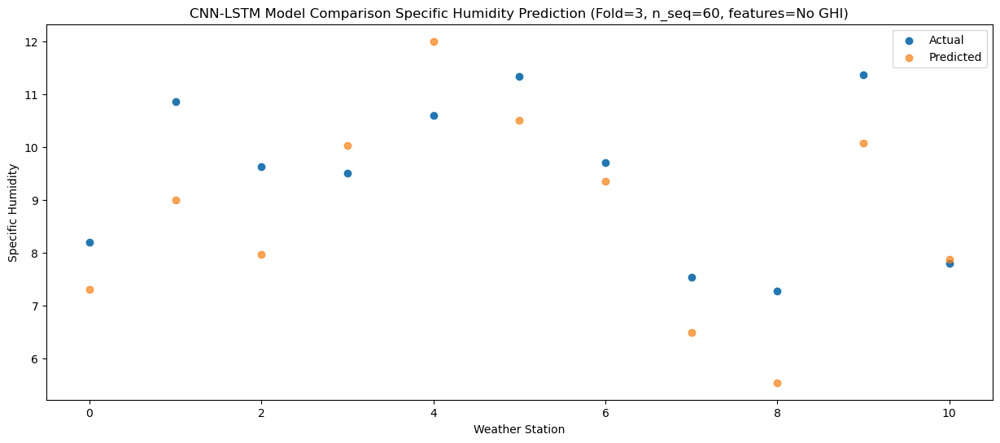

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    7.30   6.507427
1                 1   11.10   8.172645
2                 2   10.70   8.592849
3                 3    8.96   9.113490
4                 4   10.98  11.266487
5                 5   10.45   9.665027
6                 6   11.36   9.648981
7                 7   10.11   7.125303
8                 8    8.55   6.187781
9                 9    8.79   9.000067
10               10    6.55   6.730769


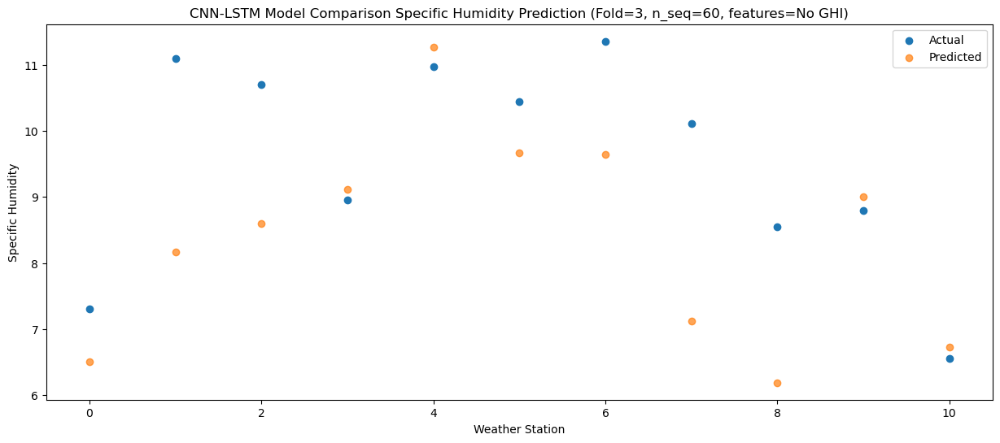

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    4.39   3.898870
1                 1    7.03   5.756103
2                 2    9.16   7.606063
3                 3    6.49   6.566085
4                 4    6.87   8.708969
5                 5    7.22   7.110770
6                 6    8.74   8.260017
7                 7    9.17   6.084588
8                 8    8.00   5.172908
9                 9    7.82   7.112554
10               10    4.86   4.648134


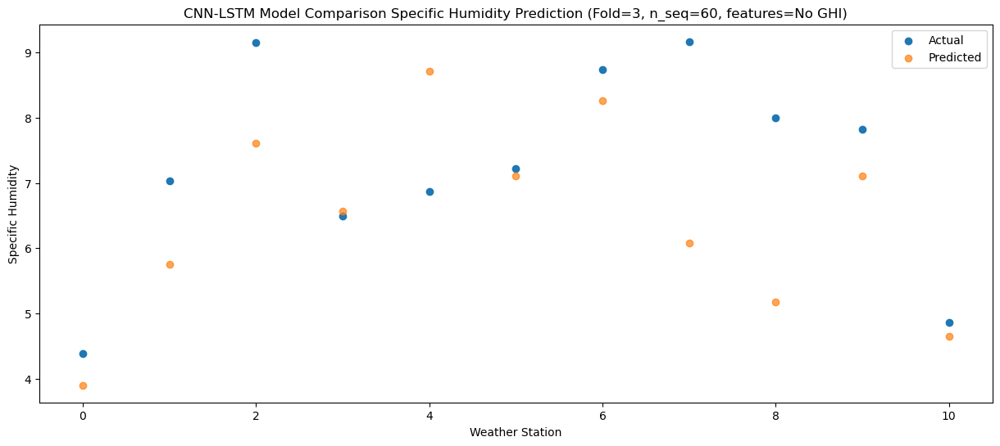

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.28   0.201680
1                 1    3.59   2.165093
2                 2    8.00   6.767540
3                 3    2.96   2.884078
4                 4    3.25   5.130800
5                 5    3.84   3.474488
6                 6    7.49   6.754944
7                 7    6.11   5.212442
8                 8    6.57   4.290619
9                 9    4.43   4.198880
10               10    1.59   1.457922


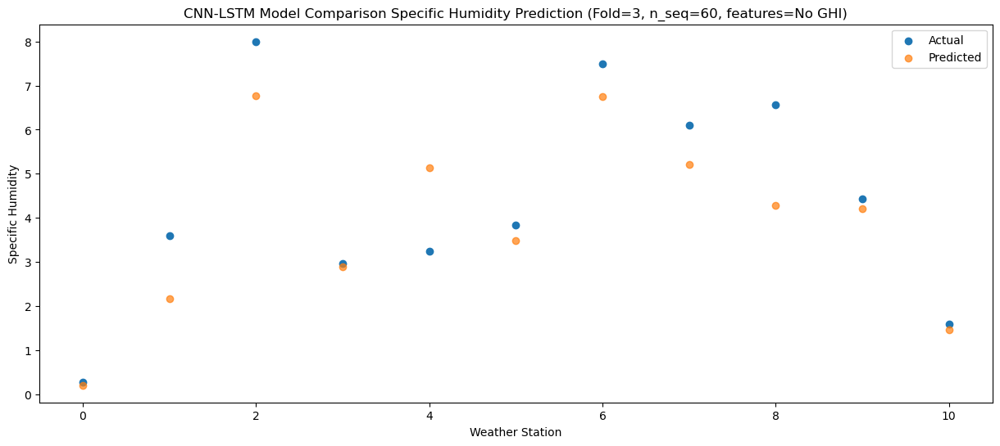

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -3.052944
1                 1    0.71  -0.743657
2                 2    5.89   4.998477
3                 3   -0.43  -0.501402
4                 4    0.08   1.931122
5                 5    0.65   0.136603
6                 6    6.16   4.635058
7                 7    5.10   3.396909
8                 8    5.48   2.579327
9                 9    0.63   0.784737
10               10   -2.09  -2.054937


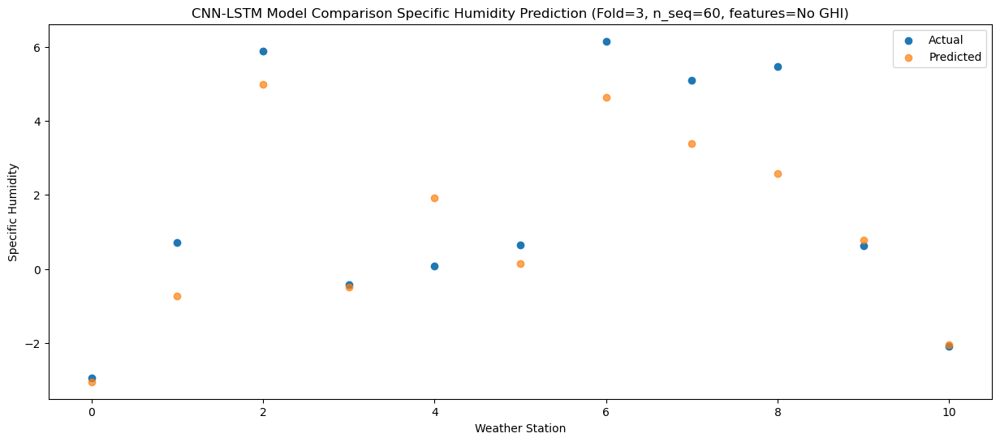

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.96  -3.511046
1                 1   -0.11  -1.693792
2                 2    6.12   4.743457
3                 3   -0.41  -0.746247
4                 4   -0.33   1.578540
5                 5    0.61  -0.091007
6                 6    6.03   4.404624
7                 7    5.02   3.227627
8                 8    5.86   2.182263
9                 9    0.96   1.152224
10               10   -1.71  -1.748710


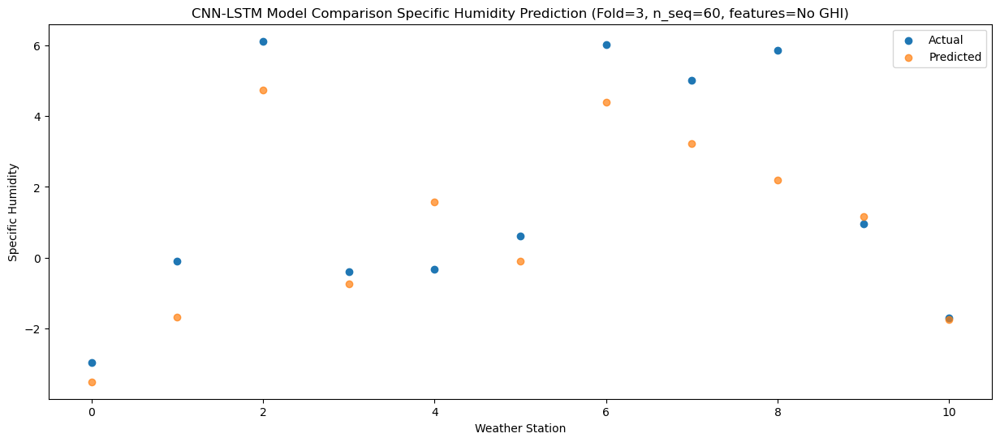

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.61  -4.482489
1                 1   -1.42  -2.910622
2                 2    6.66   3.946777
3                 3   -1.15  -1.846866
4                 4   -1.20   0.344672
5                 5   -0.27  -1.282573
6                 6    5.97   3.445341
7                 7    5.56   2.358130
8                 8    5.87   1.472946
9                 9   -0.34   0.029937
10               10   -2.84  -2.888297


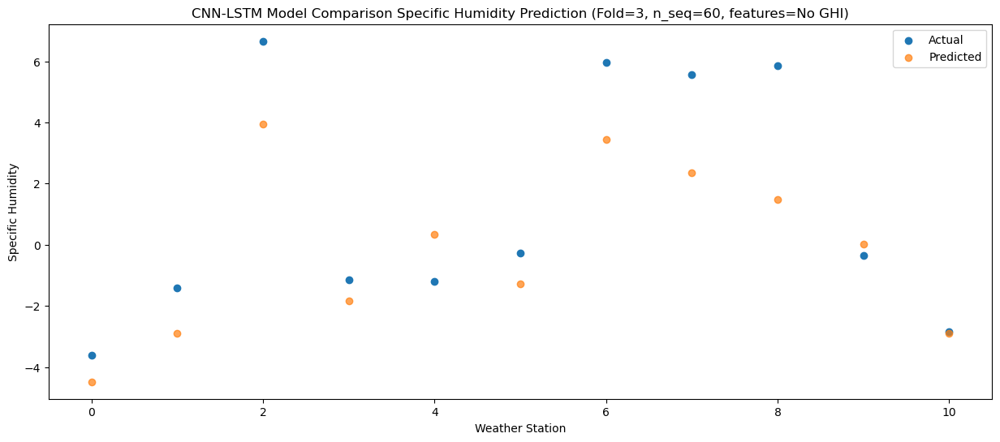

Predictions for (t+51):
    Weather_Station        Actual  Predicted
0                 0 -3.550000e+00  -4.475422
1                 1 -3.552714e-15  -1.619438
2                 2  6.830000e+00   4.311102
3                 3 -8.300000e-01  -1.633627
4                 4 -2.900000e-01   1.073884
5                 5  3.100000e-01  -0.809092
6                 6  6.040000e+00   4.036068
7                 7  6.380000e+00   2.848399
8                 8  5.560000e+00   1.707450
9                 9 -4.400000e-01  -0.050556
10               10 -2.930000e+00  -2.952419


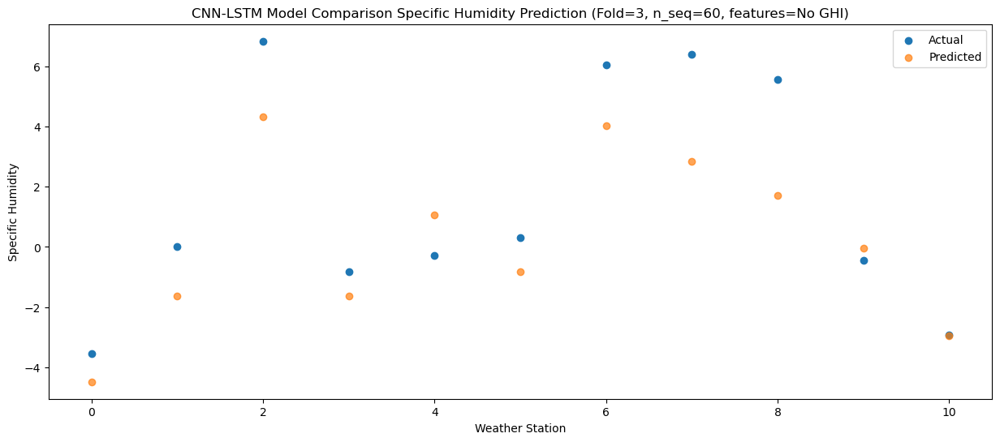

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.05  -2.996107
1                 1    1.42  -0.720420
2                 2    6.54   3.883577
3                 3    0.13  -0.484653
4                 4    0.75   1.778573
5                 5    1.39   0.052618
6                 6    6.40   3.721747
7                 7    5.70   2.224373
8                 8    5.36   1.535423
9                 9    0.61   0.616260
10               10   -1.88  -2.140877


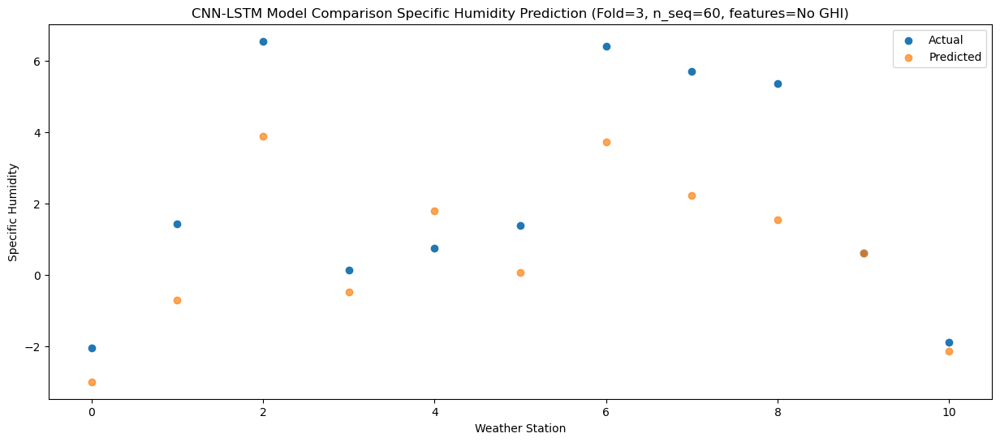

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -0.01  -1.464785
1                 1    2.96   1.321110
2                 2    7.22   3.434621
3                 3    2.04   1.286435
4                 4    2.57   3.699863
5                 5    3.64   1.937947
6                 6    7.08   3.956483
7                 7    5.40   1.913042
8                 8    5.80   0.955266
9                 9    1.52   2.022010
10               10   -0.28  -0.557249


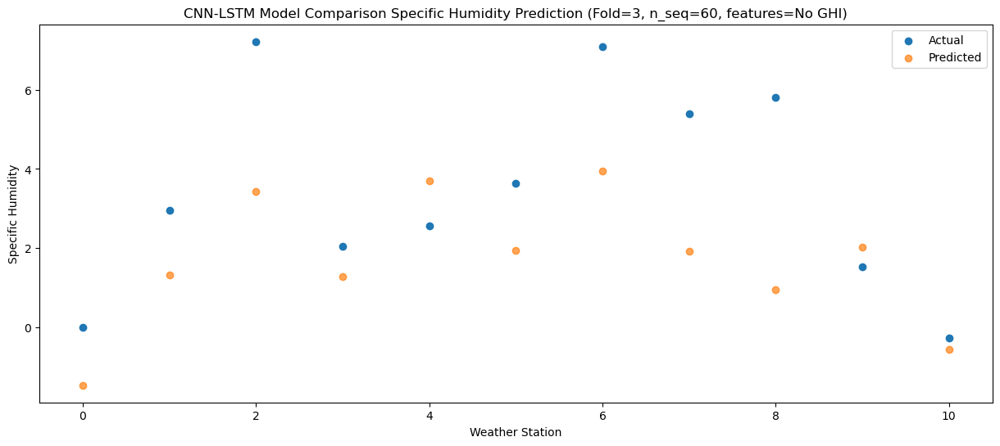

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    3.86   2.323023
1                 1    7.46   4.765780
2                 2    7.09   4.154490
3                 3    6.15   4.931839
4                 4    6.71   7.002156
5                 5    7.31   5.383963
6                 6    7.97   5.198707
7                 7    5.27   2.533930
8                 8    5.96   1.857409
9                 9    4.98   5.032505
10               10    3.35   2.704471


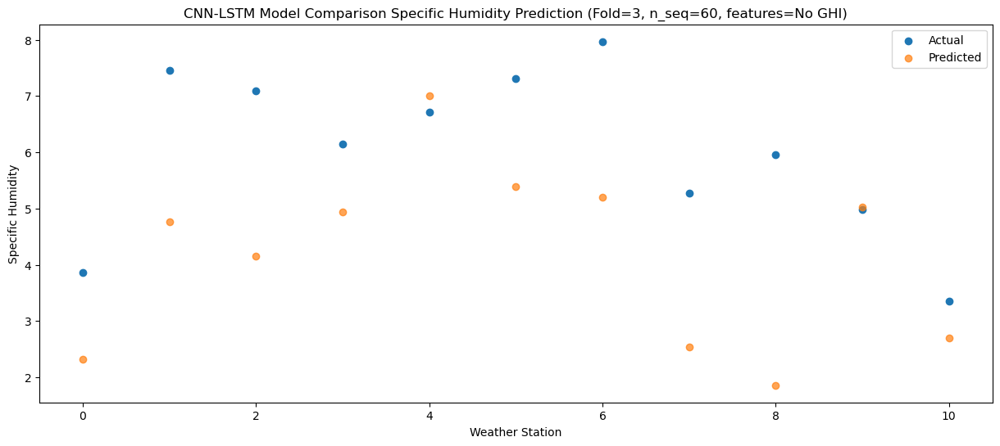

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    5.59   4.471452
1                 1    9.74   7.733440
2                 2    8.36   6.580654
3                 3    7.95   7.401052
4                 4    8.68   9.998481
5                 5    9.13   8.168339
6                 6   10.26   7.967273
7                 7    6.67   5.206377
8                 8    7.11   4.026827
9                 9    7.85   7.541665
10               10    5.03   5.213939


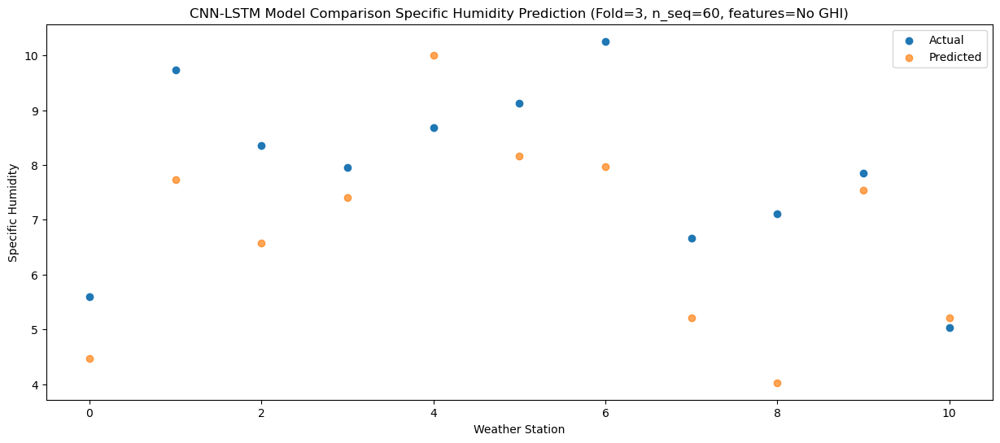

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    8.45   6.877439
1                 1   10.23   8.626511
2                 2   10.34   6.581574
3                 3    8.85   9.558018
4                 4   10.25  11.425613
5                 5   10.32   9.950719
6                 6   10.31   8.133912
7                 7    7.70   5.052154
8                 8    8.69   4.224713
9                 9   11.02   9.720145
10               10    7.91   7.529089


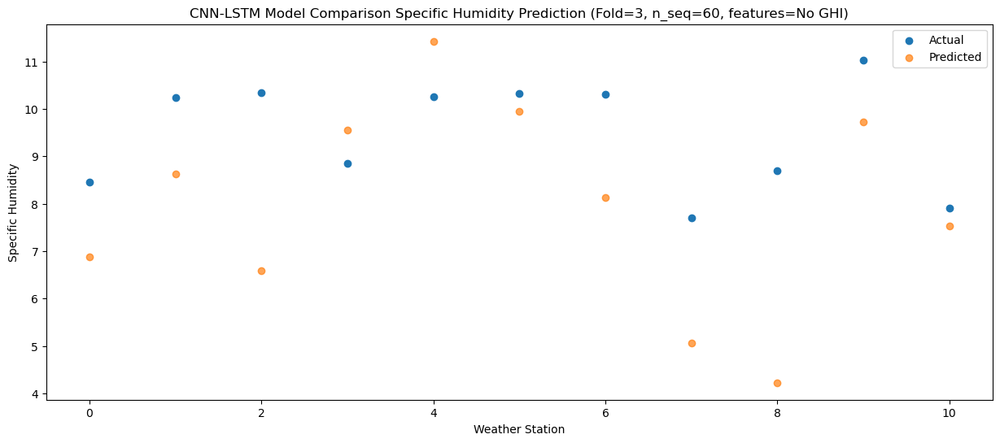

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    7.01   5.841933
1                 1    9.49   8.085774
2                 2    8.65   7.359605
3                 3    7.53   8.565737
4                 4    9.77  10.789118
5                 5    9.76   9.131782
6                 6   11.77   8.660882
7                 7    8.52   5.900623
8                 8    7.96   4.917020
9                 9    9.67   8.860177
10               10    6.63   6.544828


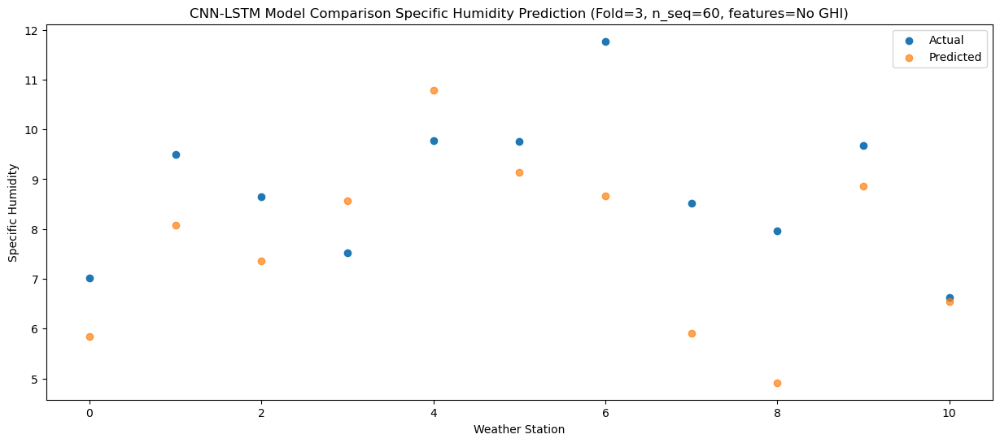

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    5.30   3.589918
1                 1    6.50   4.876788
2                 2    8.92   5.860907
3                 3    5.99   5.858329
4                 4    6.76   7.560885
5                 5    7.14   6.083823
6                 6    9.35   6.513392
7                 7    6.80   4.098910
8                 8    7.64   3.721564
9                 9    6.31   6.311606
10               10    3.81   3.893603


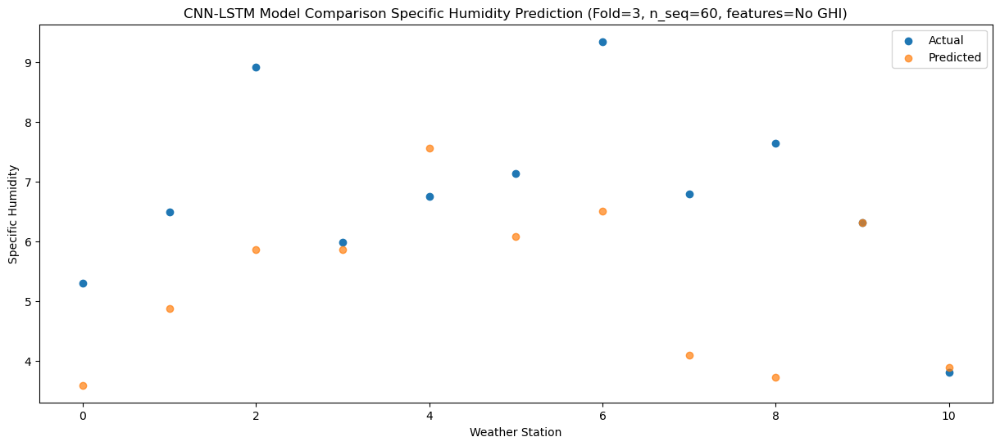

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.48  -0.843754
1                 1    2.27   0.917304
2                 2    7.81   4.433239
3                 3    2.24   1.547177
4                 4    2.40   3.535633
5                 5    3.27   1.925407
6                 6    7.59   4.510446
7                 7    5.75   2.695913
8                 8    6.05   2.186186
9                 9    3.21   2.721878
10               10   -0.19   0.023080


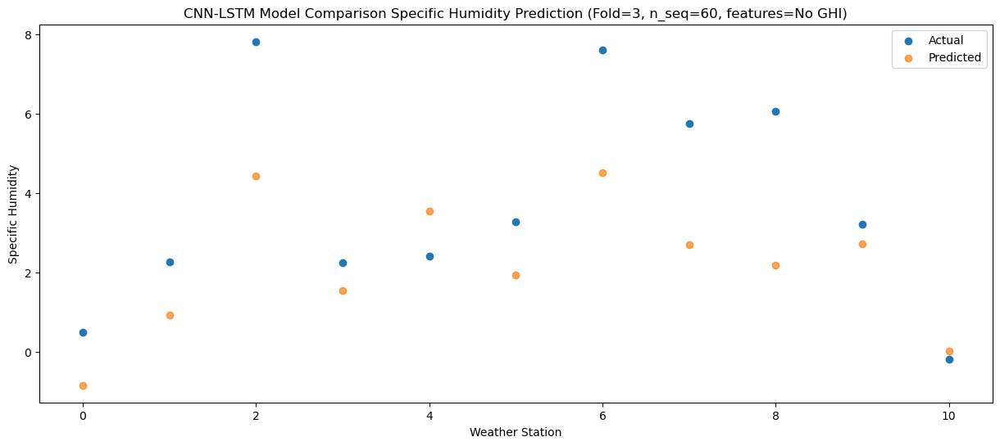

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_3 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_9 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_6 (LSTM)               (None, 1, 512)            3147776   
                                                                 
 dropout_10 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_7 (LSTM)               (None, 512)               2099200   
                                                      

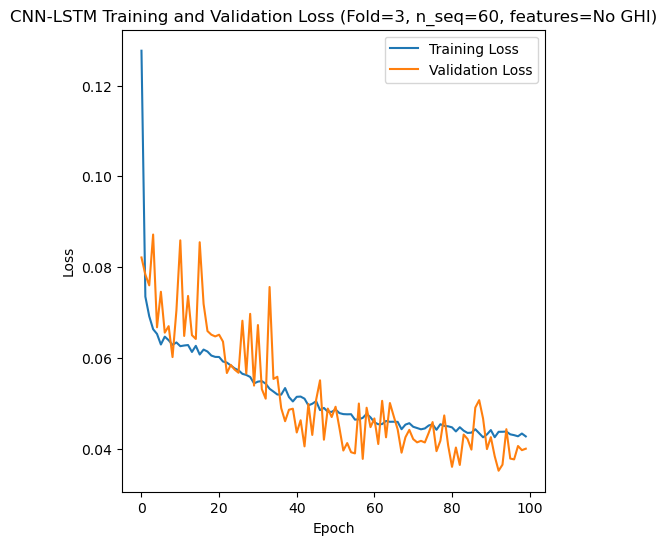

Epoch 1/100
84/84 [==============================] - 7s 42ms/step - loss: 0.1301 - accuracy: 0.2500 - mae: 0.1108 - rmse: 0.1301 - mape: 23.2213 - pearson: 0.5979 - val_loss: 0.0818 - val_accuracy: 0.7000 - val_mae: 0.0656 - val_rmse: 0.0818 - val_mape: 16.0861 - val_pearson: 0.6520
Epoch 2/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0764 - accuracy: 0.3452 - mae: 0.0605 - rmse: 0.0764 - mape: 13.7862 - pearson: 0.7311 - val_loss: 0.0781 - val_accuracy: 0.7000 - val_mae: 0.0617 - val_rmse: 0.0781 - val_mape: 13.4819 - val_pearson: 0.7234
Epoch 3/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0718 - accuracy: 0.4048 - mae: 0.0569 - rmse: 0.0718 - mape: 12.7854 - pearson: 0.7562 - val_loss: 0.0667 - val_accuracy: 0.7000 - val_mae: 0.0529 - val_rmse: 0.0667 - val_mape: 11.4906 - val_pearson: 0.7841
Epoch 4/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0677 - accuracy: 0.4286 - mae: 0.0530 - rmse: 0.0677 - mape: 11.9126 - p

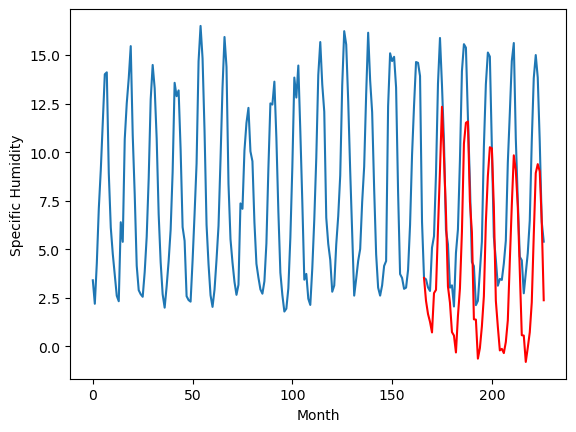

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		-0.46		0.90
-1.22		-0.30		0.92
-2.78		-0.75		2.03
-1.94		-0.85		1.09
-0.56		1.66		2.22
0.65		1.46		0.81
1.30		3.62		2.32
4.63		6.20		1.57
6.37		8.15		1.78
6.61		7.61		1.00
6.03		5.95		-0.08
3.99		3.30		-0.69
0.93		0.69		-0.24
-3.81		-2.03		1.78
-3.46		-1.76		1.70
-1.47		-1.59		-0.12
-1.50		-0.23		1.27
-0.75		0.56		1.31
0.58		3.10		2.52
4.87		7.07		2.20
6.08		7.87		1.79
6.47		7.79		1.32
5.67		5.10		-0.57
2.75		3.15		0.40
-1.91		-1.26		0.65
-0.17		0.63		0.80
-4.03		-2.85		1.18
-2.45		-1.90		0.55
-0.92		-0.90		0.02
0.37		0.46		0.09
2.76		3.72		0.96
5.66		5.59		-0.07
6.69		6.98		0.29
6.77		6.70		-0.07
5.90		4.15		-1.75
1.12		-0.24		-1.36
1.29		-1.29		-2.58
-2.23		-2.39		-0.16
-2.74		-2.38		0.36
-0.80		-1.75		-0.95
-0.42		-1.35		-0.93
1.07		-0.46		-1.53
1.87		1.60		-0.27
5.38		3.78		-1.60
7.29		6.05		-1.24
7.59		6.00		-1.59
5.14		3.97		-1.17
1.52		0.66		-0.86
-0.78		-2.06		-1.28
-1.87		-2.6

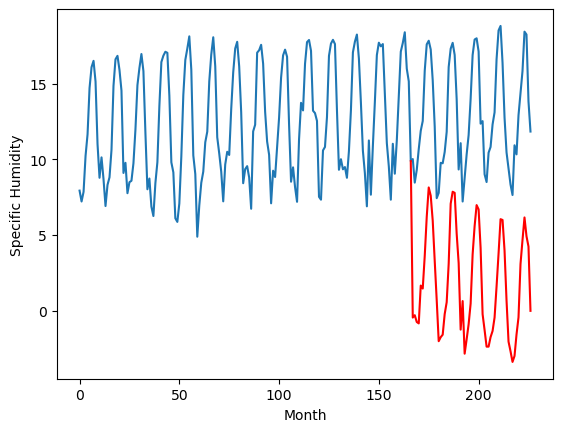

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.06		-0.56		0.50
-0.22		-0.73		-0.51
-0.36		-1.09		-0.73
-0.55		-1.30		-0.75
3.00		1.56		-1.44
1.88		1.25		-0.63
4.12		3.95		-0.17
7.42		6.90		-0.52
10.35		9.52		-0.83
8.84		8.05		-0.79
6.79		5.90		-0.89
3.44		2.53		-0.91
0.77		0.33		-0.44
-1.61		-2.35		-0.74
-1.72		-2.25		-0.53
-1.84		-2.40		-0.56
1.22		-0.49		-1.71
1.47		0.46		-1.01
4.91		3.61		-1.30
9.15		8.03		-1.12
10.80		8.86		-1.94
10.81		8.79		-2.02
7.87		5.37		-2.50
5.09		3.36		-1.73
-0.35		-1.74		-1.39
2.60		0.14		-2.46
-2.13		-3.56		-1.43
-1.28		-2.56		-1.28
-0.23		-1.51		-1.28
2.22		0.39		-1.83
6.82		4.26		-2.56
9.20		6.37		-2.83
11.04		7.66		-3.38
10.86		7.34		-3.52
6.62		4.26		-2.36
1.66		-0.88		-2.54
0.91		-1.68		-2.59
0.37		-2.95		-3.32
0.27		-3.00		-3.27
0.94		-2.33		-3.27
1.27		-1.87		-3.14
2.11		-1.00		-3.11
5.49		1.81		-3.68
9.06		4.47		-4.59
10.65		6.80		-3.85
9.07		6.38		-2.69
6.05		4.06		-1.99
2.12		0.40		-1.72
0.14		

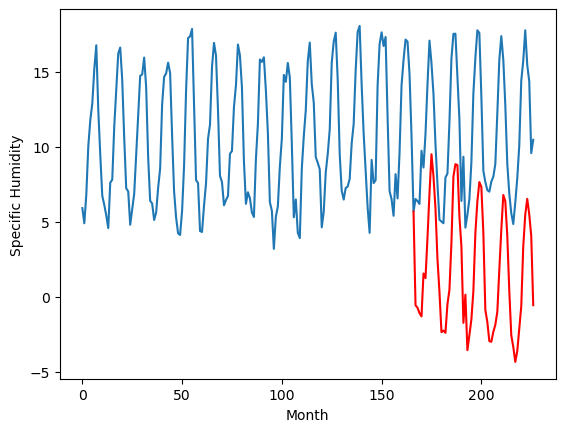

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.12		0.86		-0.26
0.12		0.33		0.21
0.76		-0.03		-0.79
0.14		-0.46		-0.60
4.09		2.06		-2.03
3.69		2.04		-1.65
6.85		4.84		-2.01
9.01		7.44		-1.57
12.24		10.20		-2.04
9.65		8.06		-1.59
8.44		5.79		-2.65
3.87		2.21		-1.66
2.23		0.98		-1.25
-0.37		-0.91		-0.54
-0.48		-0.78		-0.30
-0.80		-1.36		-0.56
1.86		0.55		-1.31
3.15		1.68		-1.47
7.15		4.86		-2.29
10.84		8.92		-1.92
11.41		9.82		-1.59
11.80		9.61		-2.19
7.79		6.04		-1.75
4.94		4.18		-0.76
1.32		0.07		-1.25
3.18		0.75		-2.43
-1.48		-1.88		-0.40
-0.95		-1.32		-0.37
0.64		-0.23		-0.87
4.15		1.55		-2.60
8.14		5.08		-3.06
9.91		7.39		-2.52
9.33		8.47		-0.86
10.34		8.39		-1.95
7.06		5.47		-1.59
2.60		0.81		-1.79
2.42		-0.49		-2.91
0.84		-1.44		-2.28
0.15		-1.54		-1.69
0.51		-1.40		-1.91
2.57		-0.69		-3.26
3.25		0.03		-3.22
7.51		3.44		-4.07
11.45		5.92		-5.53
11.30		7.83		-3.47
9.20		7.45		-1.75
8.30		5.46		-2.84
4.58		2.21		-2.37
2.05		-0.74		-2.

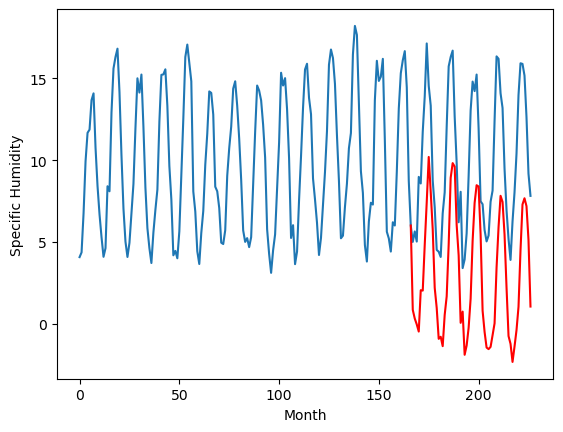

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.61		0.67		0.06
-0.36		0.11		0.47
0.33		-0.26		-0.59
-0.33		-0.72		-0.39
3.57		1.69		-1.88
3.06		1.73		-1.33
6.30		4.51		-1.79
8.28		7.04		-1.24
11.43		9.77		-1.66
8.78		7.61		-1.17
7.89		5.34		-2.55
3.12		1.80		-1.32
1.76		0.69		-1.07
-0.81		-1.07		-0.26
-0.85		-0.94		-0.09
-1.30		-1.55		-0.25
1.28		0.29		-0.99
2.64		1.45		-1.19
6.93		4.54		-2.39
10.81		8.54		-2.27
11.19		9.45		-1.74
11.30		9.23		-2.07
7.40		5.69		-1.71
4.67		3.88		-0.79
1.06		-0.03		-1.09
2.47		0.44		-2.03
-1.86		-1.98		-0.12
-1.42		-1.48		-0.06
0.10		-0.39		-0.49
3.78		1.30		-2.48
7.66		4.72		-2.94
9.34		7.05		-2.29
8.84		8.13		-0.71
10.01		8.08		-1.93
6.86		5.24		-1.62
2.40		0.72		-1.68
1.98		-0.68		-2.66
0.39		-1.58		-1.97
-0.36		-1.66		-1.30
0.04		-1.62		-1.66
2.01		-0.89		-2.90
2.86		-0.16		-3.02
7.13		3.23		-3.90
10.61		5.65		-4.96
9.71		7.51		-2.20
8.33		7.17		-1.16
8.00		5.26		-2.74
4.34		2.10		-2.24
1.92		-0.83		-

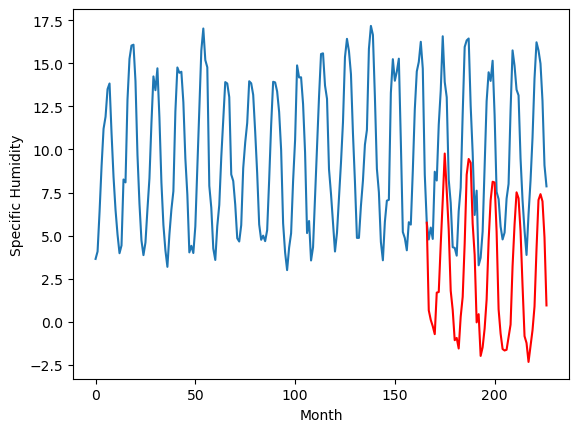

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.92		6.18		-0.74
5.68		5.74		0.06
5.56		5.30		-0.26
5.44		4.85		-0.59
8.24		6.77		-1.47
7.49		7.06		-0.43
9.76		9.37		-0.39
11.47		11.39		-0.08
12.70		13.54		0.84
11.39		11.92		0.53
11.20		10.04		-1.16
7.55		7.06		-0.49
7.09		6.08		-1.01
4.53		4.72		0.19
5.23		5.02		-0.21
4.59		4.48		-0.11
6.08		5.81		-0.27
7.04		6.89		-0.15
11.59		9.45		-2.14
13.89		12.82		-1.07
14.92		13.74		-1.18
14.64		13.41		-1.23
11.39		10.49		-0.90
8.34		8.82		0.48
6.62		6.07		-0.55
5.77		5.95		0.18
4.31		4.29		-0.02
4.30		4.54		0.24
4.89		5.61		0.72
6.92		6.74		-0.18
9.18		9.41		0.23
12.03		11.65		-0.38
12.72		12.68		-0.04
14.71		12.79		-1.92
13.46		10.53		-2.93
9.95		6.97		-2.98
7.25		5.07		-2.18
6.61		4.51		-2.10
5.06		4.45		-0.61
5.18		4.21		-0.97
6.47		5.01		-1.46
6.44		5.66		-0.78
11.28		8.71		-2.57
15.14		10.57		-4.57
12.81		12.13		-0.68
11.95		12.18		0.23
12.46		10.69		-1.77
10.33		8.06		-2.27
8.03		5.39		-2.6

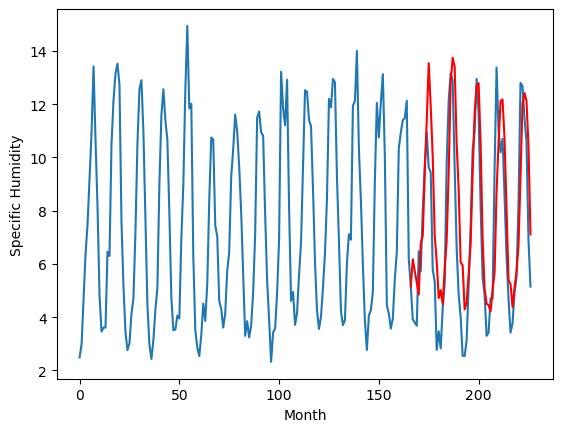

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.46		1.25		0.79
0.53		1.16		0.63
0.37		0.72		0.35
0.95		0.49		-0.46
3.14		2.83		-0.31
2.47		2.68		0.21
5.59		5.45		-0.14
9.42		8.65		-0.77
12.01		11.40		-0.61
12.22		10.05		-2.17
8.38		7.63		-0.75
5.73		4.42		-1.31
2.90		2.20		-0.70
-0.44		-0.32		0.12
-0.56		-0.40		0.16
-0.31		-0.59		-0.28
1.40		1.05		-0.35
1.81		2.19		0.38
4.79		4.85		0.06
9.48		9.59		0.11
11.08		10.55		-0.53
11.46		10.79		-0.67
7.88		7.23		-0.65
5.67		5.45		-0.22
-0.05		0.14		0.19
1.81		1.64		-0.17
-1.17		-1.62		-0.45
0.15		-0.58		-0.73
0.99		0.47		-0.52
2.05		1.96		-0.09
6.06		5.89		-0.17
8.34		7.86		-0.48
11.50		9.61		-1.89
10.31		9.31		-1.00
6.76		6.32		-0.44
2.08		1.29		-0.79
1.90		0.44		-1.46
-0.09		-1.03		-0.94
0.54		-0.90		-1.44
1.58		-0.49		-2.07
1.07		-0.21		-1.28
2.67		1.06		-1.61
4.89		3.08		-1.81
7.94		5.93		-2.01
11.33		8.93		-2.40
10.87		8.29		-2.58
7.42		6.17		-1.25
3.51		2.58		-0.93
0.56		-0.62		-1.18
0.28	

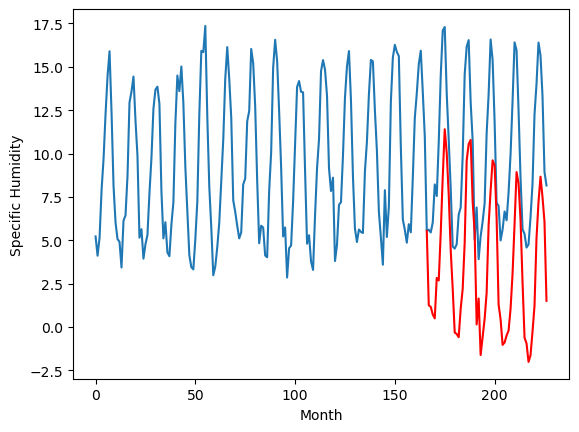

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.67		0.66		-0.01
0.40		0.13		-0.27
0.16		-0.25		-0.41
-0.07		-0.71		-0.64
2.48		1.55		-0.93
2.80		1.58		-1.22
6.18		4.64		-1.54
9.79		7.67		-2.12
11.84		10.78		-1.06
9.19		8.48		-0.71
7.59		5.77		-1.82
3.04		2.08		-0.96
1.37		0.84		-0.53
-0.56		-1.01		-0.45
-0.71		-1.13		-0.42
-1.34		-1.79		-0.45
1.03		0.11		-0.92
1.95		1.44		-0.51
5.11		4.42		-0.69
9.71		9.01		-0.70
10.66		10.02		-0.64
10.40		10.10		-0.30
7.14		6.14		-1.00
5.05		4.44		-0.61
0.36		-0.32		-0.68
1.83		0.23		-1.60
-1.37		-2.30		-0.93
-0.86		-1.60		-0.74
0.65		-0.51		-1.16
2.44		1.16		-1.28
7.15		5.05		-2.10
9.51		7.31		-2.20
10.31		8.78		-1.53
10.78		8.66		-2.12
6.97		5.58		-1.39
2.31		0.62		-1.69
0.95		-0.54		-1.49
0.08		-1.78		-1.86
0.36		-1.73		-2.09
0.17		-1.72		-1.89
0.93		-1.19		-2.12
1.83		-0.10		-1.93
6.22		2.83		-3.39
8.78		5.70		-3.08
11.57		8.28		-3.29
11.85		7.56		-4.29
7.65		5.56		-2.09
4.04		2.16		-1.88
1.01		-1.1

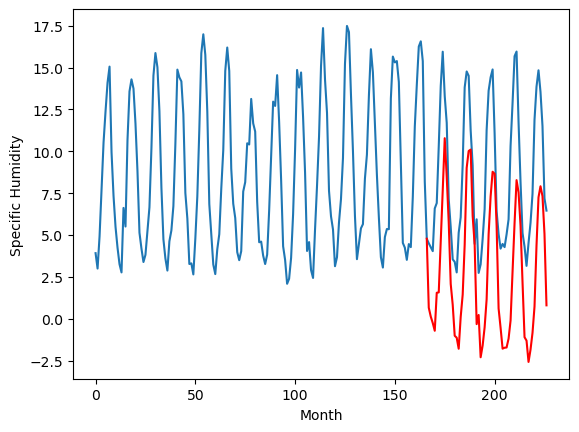

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.13		0.22		0.09
0.30		-0.23		-0.53
-0.07		-0.68		-0.61
-0.47		-1.18		-0.71
1.45		0.61		-0.84
1.73		0.80		-0.93
4.88		3.88		-1.00
7.62		7.10		-0.52
10.84		10.31		-0.53
9.17		8.12		-1.05
6.25		5.19		-1.06
2.87		1.68		-1.19
1.19		0.44		-0.75
-0.41		-1.20		-0.79
-0.76		-1.47		-0.71
-1.33		-2.15		-0.82
0.61		-0.53		-1.14
1.94		0.99		-0.95
4.23		3.49		-0.74
9.29		8.34		-0.95
10.55		9.48		-1.07
10.69		9.84		-0.85
7.21		5.79		-1.42
6.06		4.30		-1.76
0.29		-0.56		-0.85
1.00		-0.42		-1.42
-1.38		-2.50		-1.12
-0.80		-1.80		-1.00
0.51		-0.71		-1.22
2.00		0.58		-1.42
6.02		4.46		-1.56
7.46		6.57		-0.89
10.20		8.44		-1.76
9.84		8.38		-1.46
7.18		5.43		-1.75
1.85		0.61		-1.24
0.81		-0.64		-1.45
-0.15		-2.01		-1.86
0.47		-1.79		-2.26
0.07		-2.06		-2.13
0.42		-1.68		-2.10
1.87		-0.26		-2.13
4.12		1.96		-2.16
6.08		4.98		-1.10
10.38		8.14		-2.24
9.84		7.24		-2.60
7.04		5.47		-1.57
3.71		2.20		-1.51
0.64		-1.2

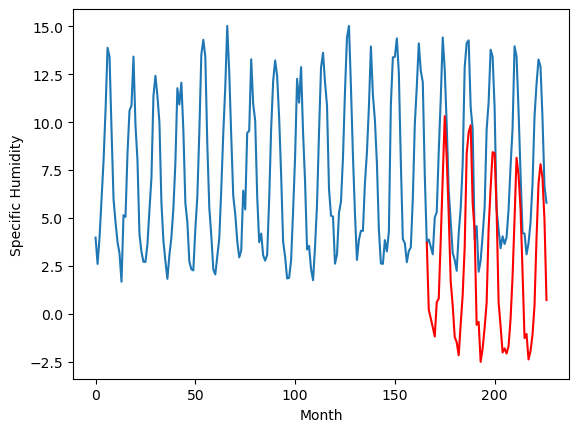

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		-0.73		-0.19
-0.37		-1.27		-0.90
-0.85		-1.70		-0.85
-1.12		-2.22		-1.10
0.93		-0.37		-1.30
1.52		-0.17		-1.69
5.24		2.95		-2.29
7.72		6.11		-1.61
11.28		9.36		-1.92
9.09		6.99		-2.10
6.31		4.04		-2.27
2.15		0.42		-1.73
1.06		-0.64		-1.70
-0.85		-2.21		-1.36
-1.17		-2.46		-1.29
-1.81		-3.23		-1.42
0.56		-1.51		-2.07
1.87		-0.01		-1.88
4.49		2.64		-1.85
9.24		7.41		-1.83
10.64		8.53		-2.11
10.89		8.80		-2.09
6.86		4.69		-2.17
4.99		3.18		-1.81
-0.30		-1.56		-1.26
0.24		-1.50		-1.74
-2.00		-3.54		-1.54
-1.30		-2.90		-1.60
0.22		-1.80		-2.02
1.52		-0.41		-1.93
5.59		3.47		-2.12
7.83		5.67		-2.16
10.47		7.41		-3.06
9.70		7.36		-2.34
6.33		4.37		-1.96
1.57		-0.46		-2.03
0.20		-1.75		-1.95
-0.91		-3.06		-2.15
-0.39		-2.90		-2.51
-0.62		-3.17		-2.55
-0.01		-2.71		-2.70
1.50		-1.39		-2.89
4.28		1.13		-3.15
5.92		4.12		-1.80
10.62		7.09		-3.53
10.49		6.22		-4.27
6.71		4.42		-2.29
3.27		1.13		-

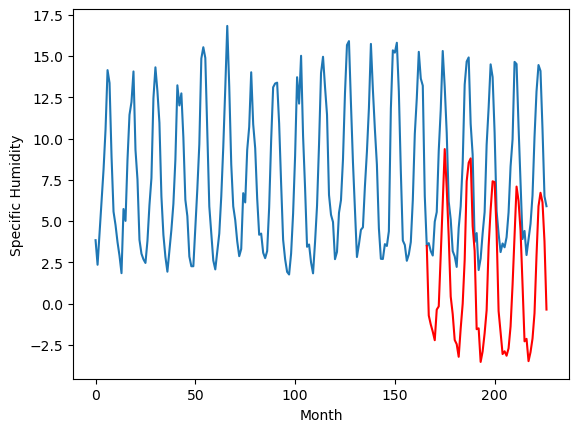

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.53		1.90		0.37
1.68		1.51		-0.17
1.34		1.01		-0.33
0.99		0.51		-0.48
2.56		1.93		-0.63
2.40		2.26		-0.14
5.02		5.27		0.25
8.21		8.53		0.32
11.13		11.74		0.61
9.71		9.71		-0.00
7.57		6.71		-0.86
4.53		3.41		-1.12
2.60		2.19		-0.41
1.27		0.70		-0.57
0.89		0.37		-0.52
0.32		-0.30		-0.62
1.61		1.08		-0.53
3.28		2.69		-0.59
4.88		4.84		-0.04
9.89		9.74		-0.15
11.16		10.95		-0.21
12.03		11.45		-0.58
8.27		7.47		-0.80
7.26		6.11		-1.15
2.02		1.36		-0.66
1.98		1.19		-0.79
0.24		-0.52		-0.76
0.69		0.15		-0.54
1.84		1.22		-0.62
2.83		2.20		-0.63
6.29		5.94		-0.35
8.20		7.96		-0.24
9.93		10.05		0.12
10.39		10.07		-0.32
8.40		7.29		-1.11
3.58		2.71		-0.87
2.86		1.33		-1.53
1.41		-0.08		-1.49
2.03		0.22		-1.81
1.28		-0.26		-1.54
1.49		0.05		-1.44
3.19		1.64		-1.55
4.09		3.37		-0.72
7.33		6.41		-0.92
10.95		9.88		-1.07
10.15		8.91		-1.24
8.44		7.35		-1.09
5.38		4.24		-1.14
1.94		0.69		-1.25
2.46		1.20		

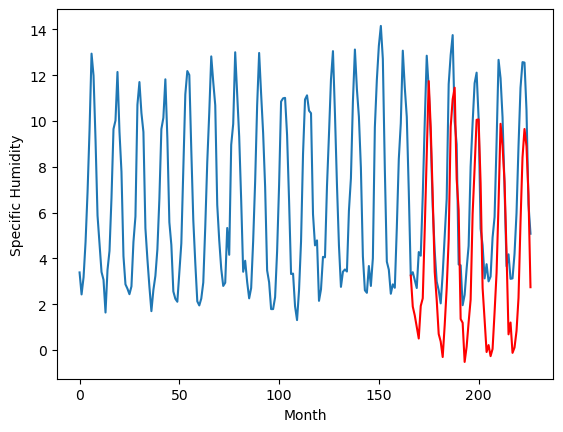

RangeIndex(start=1, stop=12, step=1)
[2.3299999999999996, -1.3599999999999994, -1.06, 1.1199999999999997, 0.6100000000000012, 6.92, 0.45999999999999996, 0.6700000000000013, 0.1299999999999999, -0.5399999999999991, 1.529999999999999]
[2.3390438270568845, -0.46100910186767585, -0.5558591079711914, 0.8601497077941893, 0.6659568786621093, 6.175243201255799, 1.2505349349975585, 0.66095121383667, 0.21674432754516593, -0.728837261199951, 1.8991377067565915]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.33   2.339044
1                 1   -1.36  -0.461009
2                 2   -1.06  -0.555859
3                 3    1.12   0.860150
4                 4    0.61   0.665957
5                 5    6.92   6.175243
6                 6    0.46   1.250535
7                 7    0.67   0.660951
8                 8    0.13   0.216744
9                 9   -0.54  -0.728837
10               10    1.53   1.899138


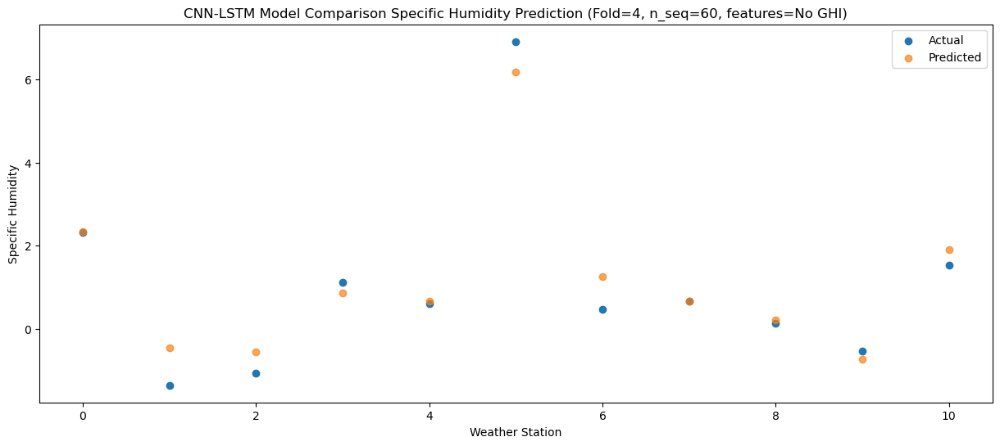

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    2.26   1.663722
1                 1   -1.22  -0.304725
2                 2   -0.22  -0.728046
3                 3    0.12   0.328371
4                 4   -0.36   0.109808
5                 5    5.68   5.736053
6                 6    0.53   1.157922
7                 7    0.40   0.131372
8                 8    0.30  -0.232780
9                 9   -0.37  -1.269401
10               10    1.68   1.513189


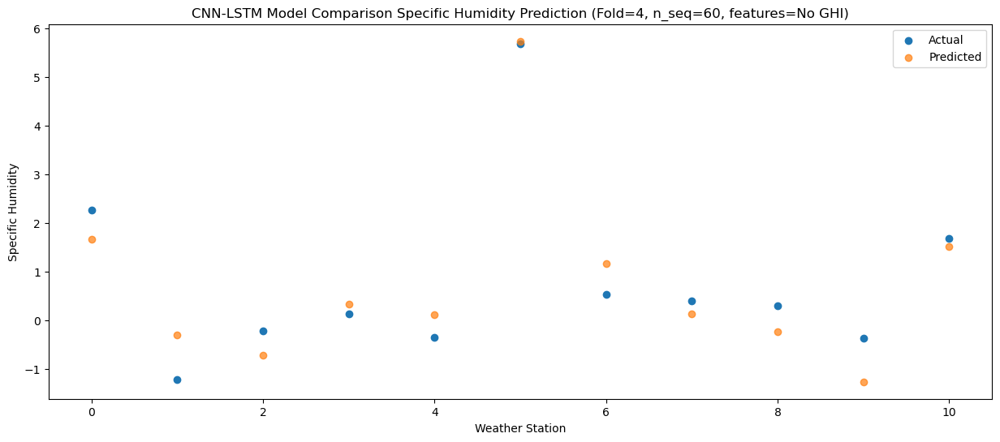

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.84   1.259661
1                 1   -2.78  -0.754137
2                 2   -0.36  -1.088612
3                 3    0.76  -0.028994
4                 4    0.33  -0.257056
5                 5    5.56   5.303655
6                 6    0.37   0.721339
7                 7    0.16  -0.253123
8                 8   -0.07  -0.684345
9                 9   -0.85  -1.703649
10               10    1.34   1.009967


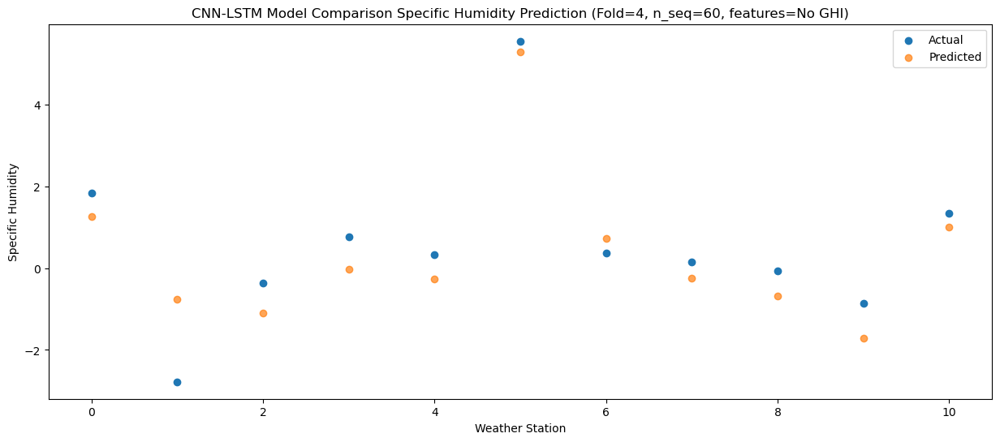

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    1.66   0.714071
1                 1   -1.94  -0.846671
2                 2   -0.55  -1.304191
3                 3    0.14  -0.464976
4                 4   -0.33  -0.715188
5                 5    5.44   4.846772
6                 6    0.95   0.494962
7                 7   -0.07  -0.714612
8                 8   -0.47  -1.176141
9                 9   -1.12  -2.222811
10               10    0.99   0.506072


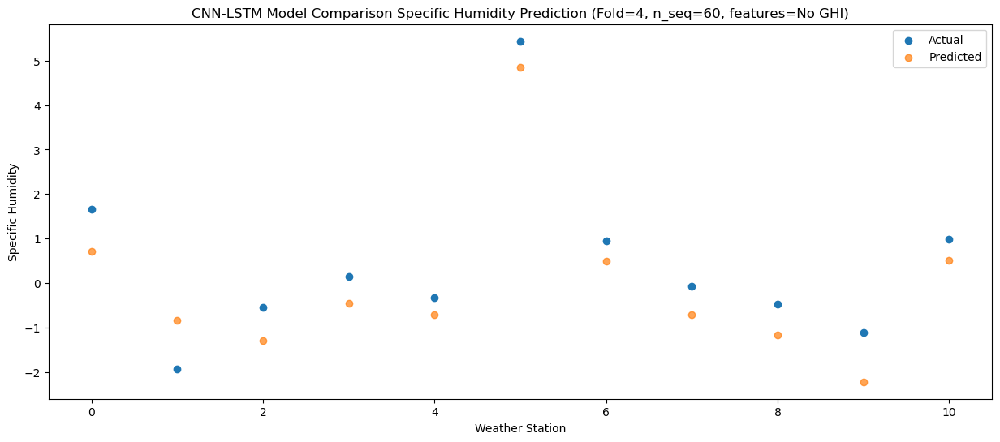

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.89   2.738593
1                 1   -0.56   1.657202
2                 2    3.00   1.559694
3                 3    4.09   2.060401
4                 4    3.57   1.693341
5                 5    8.24   6.769355
6                 6    3.14   2.829712
7                 7    2.48   1.553615
8                 8    1.45   0.606070
9                 9    0.93  -0.367512
10               10    2.56   1.927538


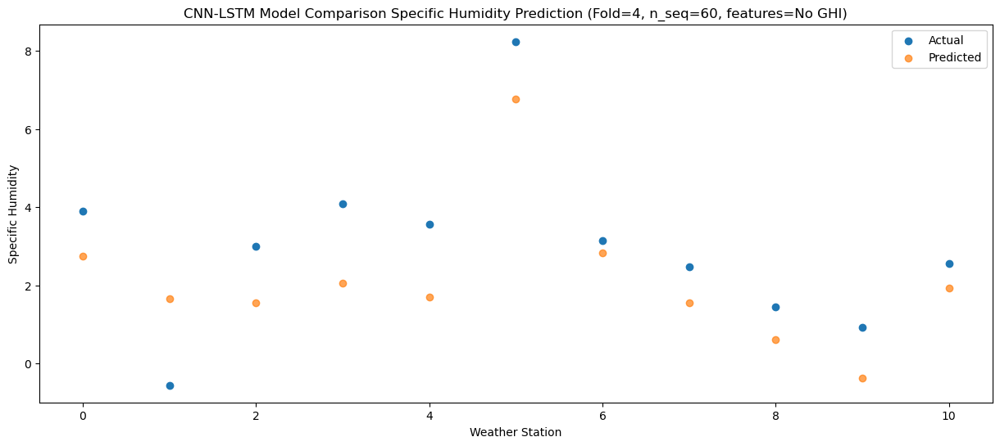

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.48   2.905092
1                 1    0.65   1.459446
2                 2    1.88   1.249381
3                 3    3.69   2.035107
4                 4    3.06   1.729657
5                 5    7.49   7.056840
6                 6    2.47   2.679893
7                 7    2.80   1.576454
8                 8    1.73   0.800945
9                 9    1.52  -0.173367
10               10    2.40   2.259710


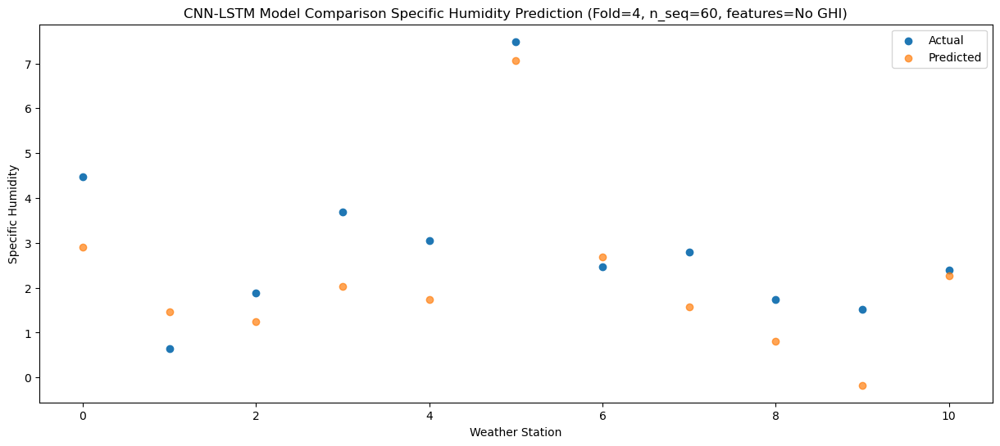

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    7.69   6.071868
1                 1    1.30   3.620271
2                 2    4.12   3.954616
3                 3    6.85   4.839723
4                 4    6.30   4.506614
5                 5    9.76   9.372589
6                 6    5.59   5.447964
7                 7    6.18   4.636226
8                 8    4.88   3.877430
9                 9    5.24   2.950947
10               10    5.02   5.268988


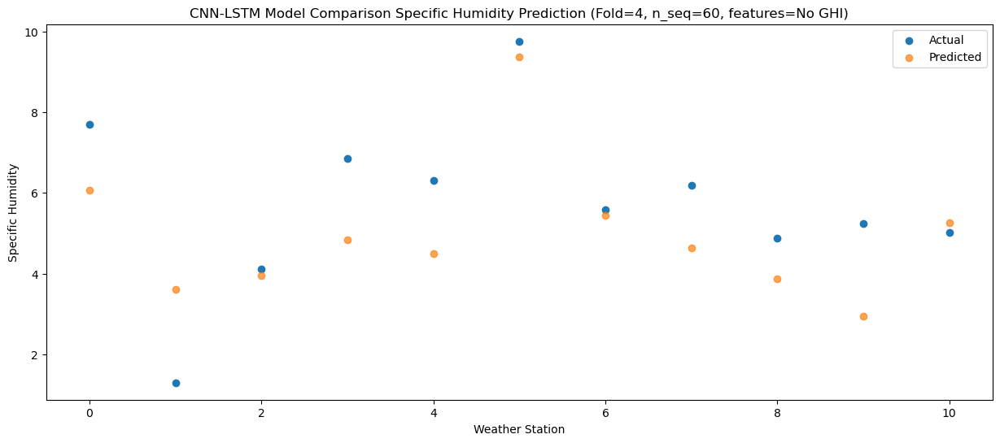

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.34   9.087019
1                 1    4.63   6.204350
2                 2    7.42   6.901924
3                 3    9.01   7.443070
4                 4    8.28   7.041351
5                 5   11.47  11.391871
6                 6    9.42   8.645297
7                 7    9.79   7.668821
8                 8    7.62   7.096816
9                 9    7.72   6.109823
10               10    8.21   8.531756


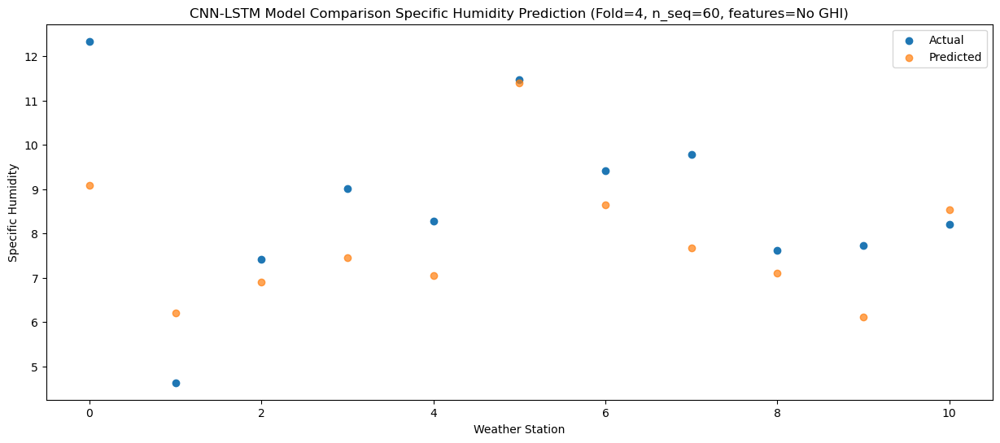

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.69  12.335381
1                 1    6.37   8.149651
2                 2   10.35   9.517182
3                 3   12.24  10.197386
4                 4   11.43   9.765020
5                 5   12.70  13.542651
6                 6   12.01  11.400394
7                 7   11.84  10.784101
8                 8   10.84  10.312990
9                 9   11.28   9.363323
10               10   11.13  11.741271


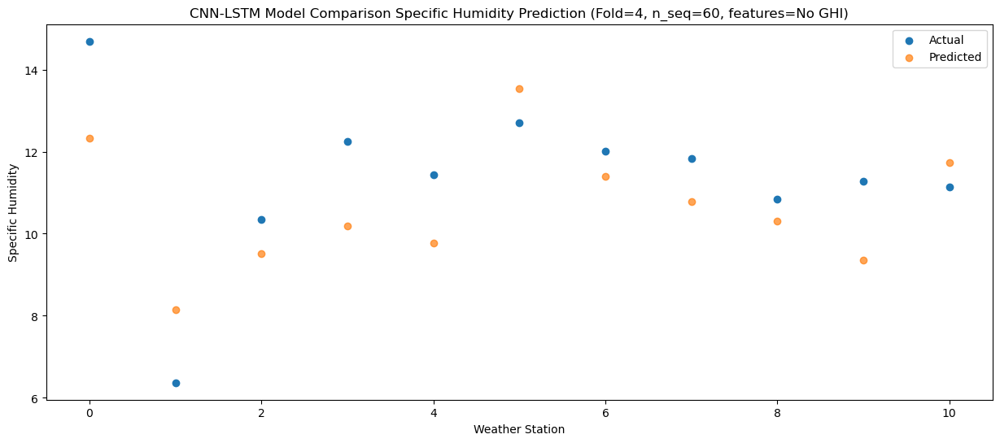

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   12.26   9.750497
1                 1    6.61   7.607409
2                 2    8.84   8.047344
3                 3    9.65   8.055490
4                 4    8.78   7.609779
5                 5   11.39  11.920617
6                 6   12.22  10.049017
7                 7    9.19   8.483369
8                 8    9.17   8.122663
9                 9    9.09   6.992869
10               10    9.71   9.709882


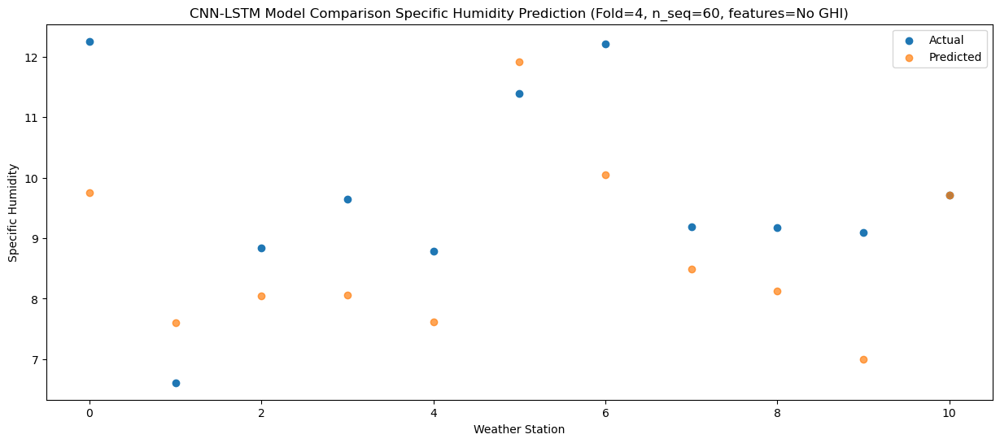

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.37   6.852547
1                 1    6.03   5.953872
2                 2    6.79   5.902686
3                 3    8.44   5.785884
4                 4    7.89   5.340994
5                 5   11.20  10.038170
6                 6    8.38   7.626044
7                 7    7.59   5.772072
8                 8    6.25   5.186389
9                 9    6.31   4.042101
10               10    7.57   6.706350


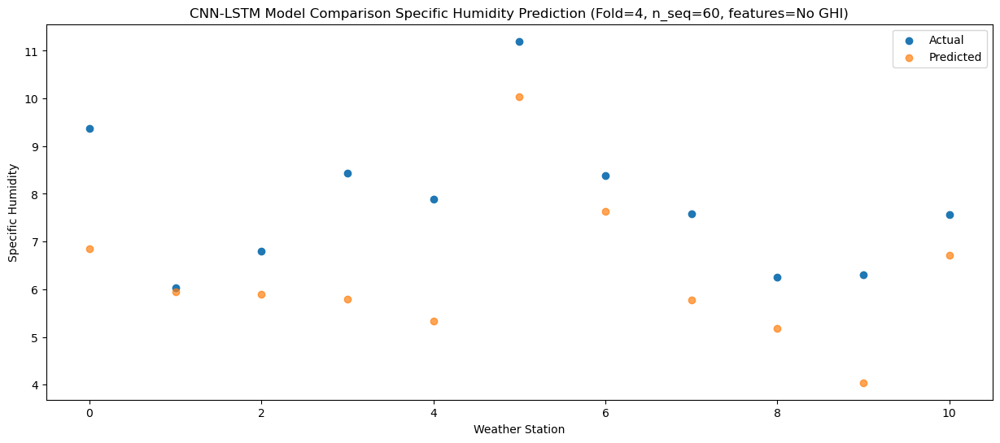

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.78   3.076319
1                 1    3.99   3.296145
2                 2    3.44   2.529959
3                 3    3.87   2.205830
4                 4    3.12   1.800891
5                 5    7.55   7.058680
6                 6    5.73   4.424714
7                 7    3.04   2.081050
8                 8    2.87   1.680415
9                 9    2.15   0.421838
10               10    4.53   3.414782


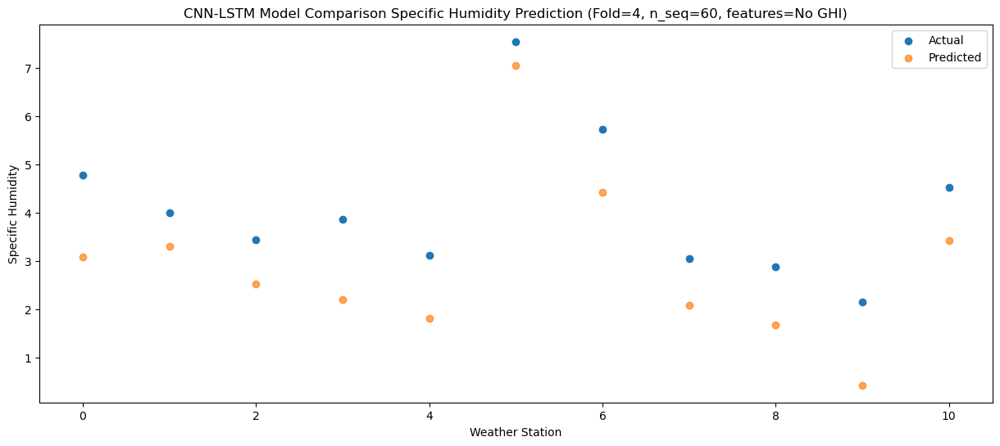

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.06   2.242332
1                 1    0.93   0.691770
2                 2    0.77   0.332646
3                 3    2.23   0.975916
4                 4    1.76   0.686810
5                 5    7.09   6.075258
6                 6    2.90   2.198766
7                 7    1.37   0.839800
8                 8    1.19   0.443780
9                 9    1.06  -0.641587
10               10    2.60   2.185876


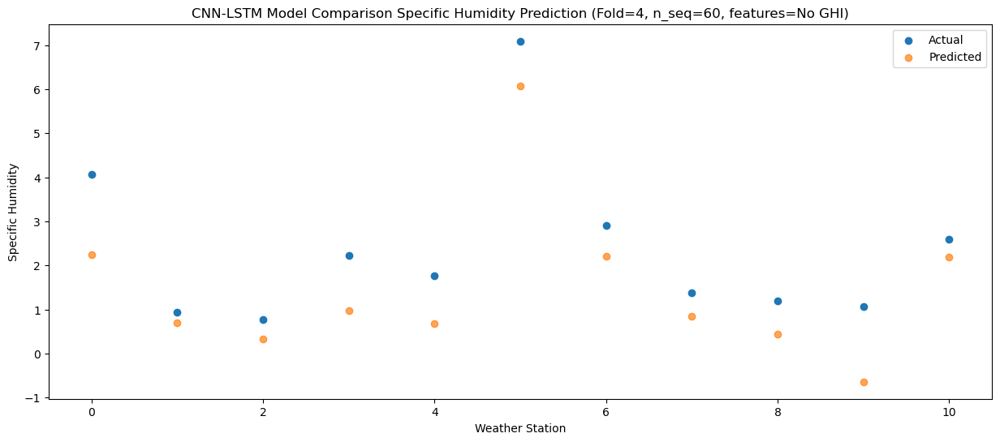

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.83   0.731231
1                 1   -3.81  -2.025000
2                 2   -1.61  -2.353542
3                 3   -0.37  -0.910301
4                 4   -0.81  -1.066657
5                 5    4.53   4.718811
6                 6   -0.44  -0.319280
7                 7   -0.56  -1.013502
8                 8   -0.41  -1.199311
9                 9   -0.85  -2.211406
10               10    1.27   0.701782


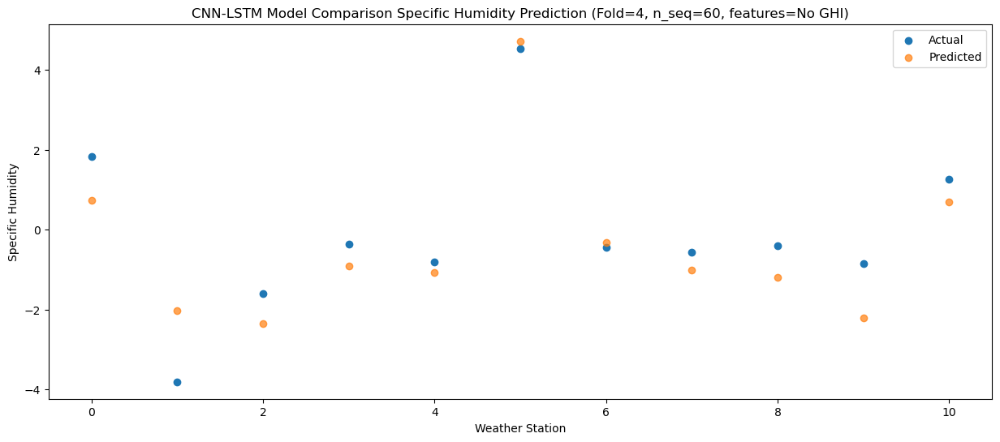

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.95   0.553830
1                 1   -3.46  -1.759097
2                 2   -1.72  -2.248831
3                 3   -0.48  -0.783854
4                 4   -0.85  -0.935097
5                 5    5.23   5.016693
6                 6   -0.56  -0.403054
7                 7   -0.71  -1.129348
8                 8   -0.76  -1.471626
9                 9   -1.17  -2.463217
10               10    0.89   0.372778


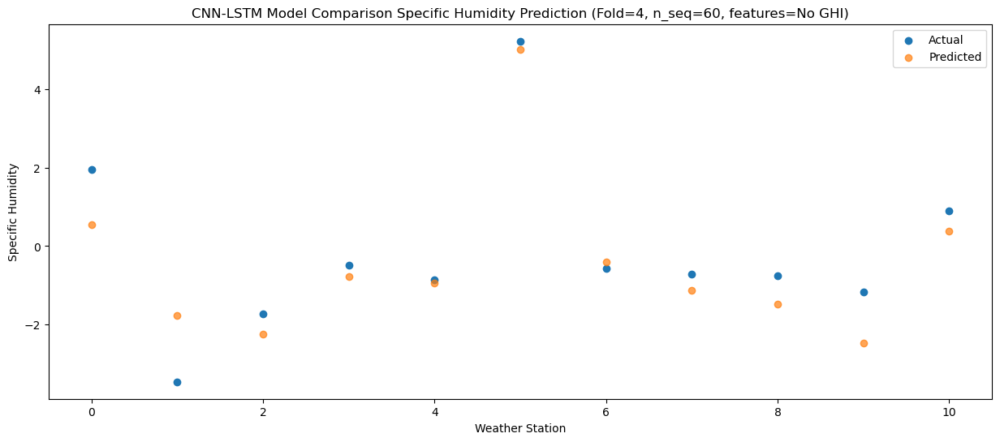

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0    0.86  -0.317805
1                 1   -1.47  -1.593989
2                 2   -1.84  -2.400753
3                 3   -0.80  -1.356492
4                 4   -1.30  -1.548444
5                 5    4.59   4.483356
6                 6   -0.31  -0.589061
7                 7   -1.34  -1.788804
8                 8   -1.33  -2.152724
9                 9   -1.81  -3.229055
10               10    0.32  -0.301886


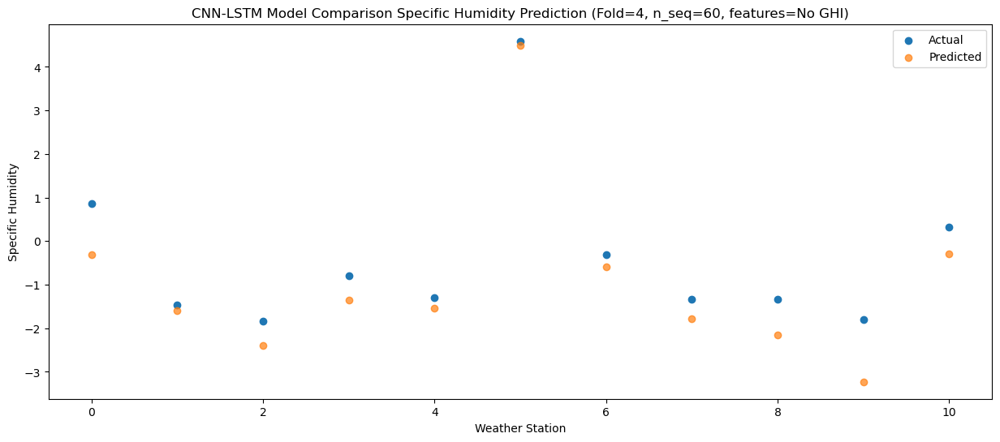

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    3.62   1.562200
1                 1   -1.50  -0.229385
2                 2    1.22  -0.490186
3                 3    1.86   0.549997
4                 4    1.28   0.293840
5                 5    6.08   5.813536
6                 6    1.40   1.052338
7                 7    1.03   0.110375
8                 8    0.61  -0.525650
9                 9    0.56  -1.507059
10               10    1.61   1.082013


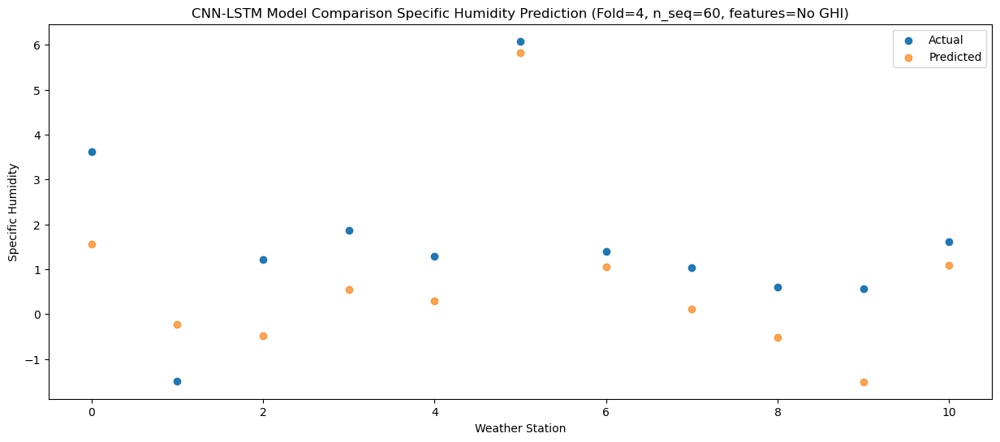

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.83   2.979236
1                 1   -0.75   0.555448
2                 2    1.47   0.463307
3                 3    3.15   1.681873
4                 4    2.64   1.446400
5                 5    7.04   6.888452
6                 6    1.81   2.191906
7                 7    1.95   1.440591
8                 8    1.94   0.987740
9                 9    1.87  -0.010759
10               10    3.28   2.692025


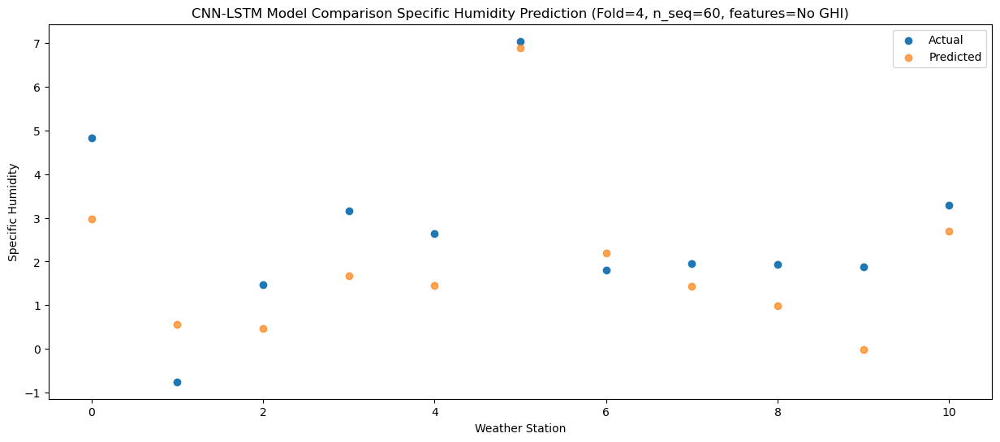

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.39   5.902196
1                 1    0.58   3.097790
2                 2    4.91   3.613413
3                 3    7.15   4.856735
4                 4    6.93   4.544462
5                 5   11.59   9.445870
6                 6    4.79   4.846533
7                 7    5.11   4.423432
8                 8    4.23   3.491134
9                 9    4.49   2.643609
10               10    4.88   4.836606


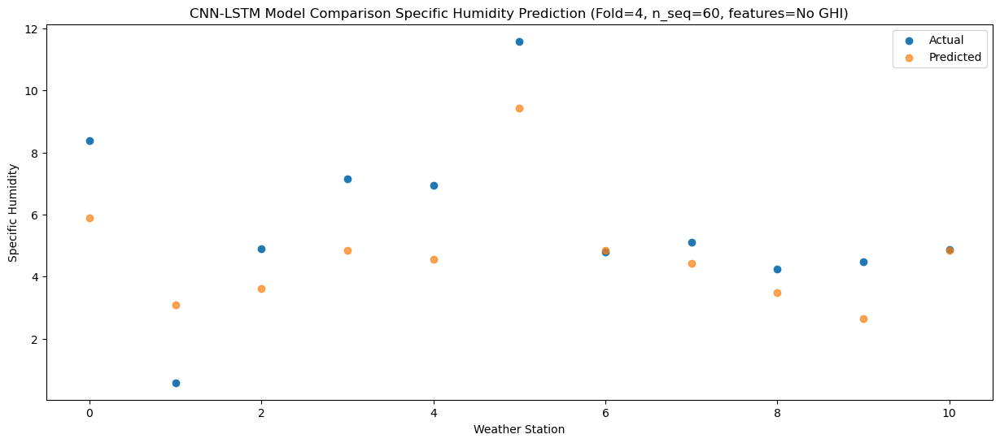

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.98  10.441668
1                 1    4.87   7.073449
2                 2    9.15   8.028917
3                 3   10.84   8.922953
4                 4   10.81   8.535822
5                 5   13.89  12.820419
6                 6    9.48   9.589504
7                 7    9.71   9.011133
8                 8    9.29   8.344808
9                 9    9.24   7.412452
10               10    9.89   9.744977


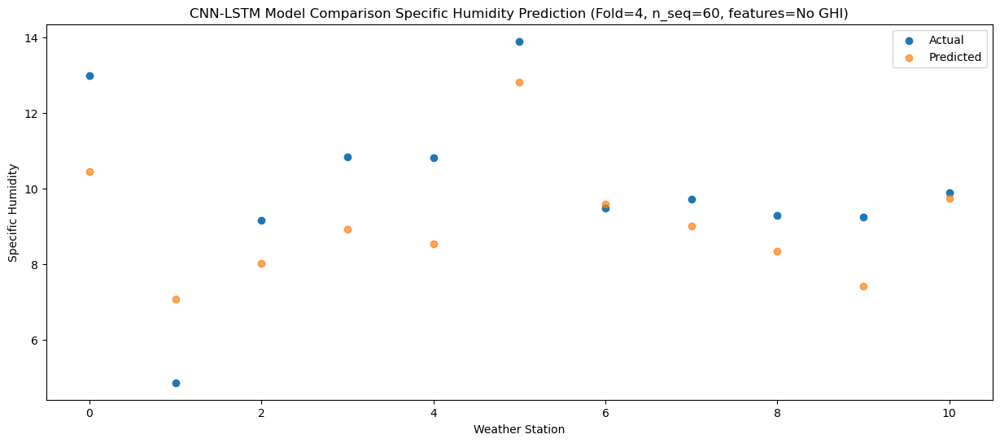

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.37  11.510609
1                 1    6.08   7.865729
2                 2   10.80   8.855735
3                 3   11.41   9.820948
4                 4   11.19   9.450298
5                 5   14.92  13.744210
6                 6   11.08  10.547329
7                 7   10.66  10.022329
8                 8   10.55   9.477942
9                 9   10.64   8.532310
10               10   11.16  10.950193


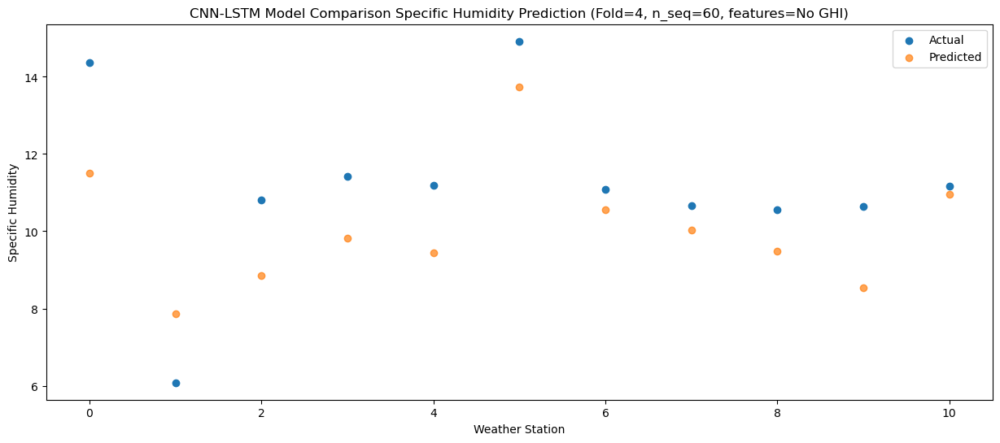

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.19  11.579194
1                 1    6.47   7.793858
2                 2   10.81   8.793664
3                 3   11.80   9.610925
4                 4   11.30   9.231466
5                 5   14.64  13.413319
6                 6   11.46  10.786543
7                 7   10.40  10.103837
8                 8   10.69   9.836422
9                 9   10.89   8.799596
10               10   12.03  11.454773


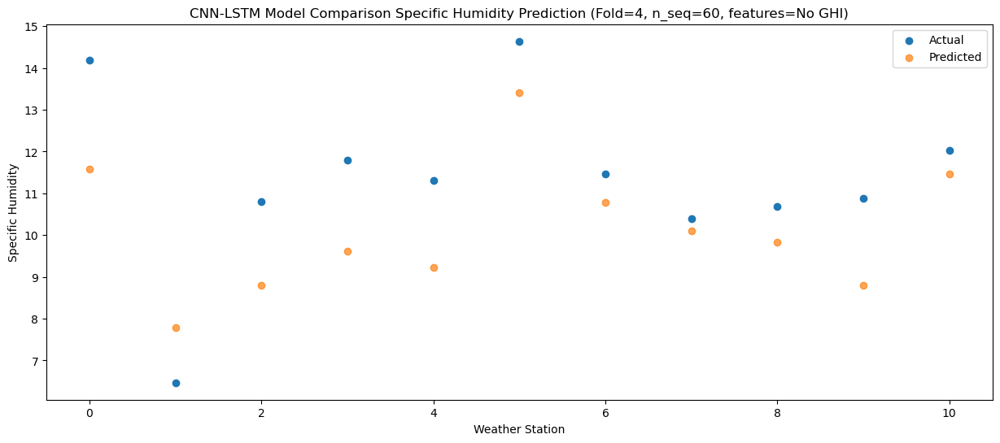

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.61   7.458549
1                 1    5.67   5.100174
2                 2    7.87   5.372758
3                 3    7.79   6.041182
4                 4    7.40   5.694561
5                 5   11.39  10.491245
6                 6    7.88   7.231076
7                 7    7.14   6.140227
8                 8    7.21   5.789220
9                 9    6.86   4.694882
10               10    8.27   7.466534


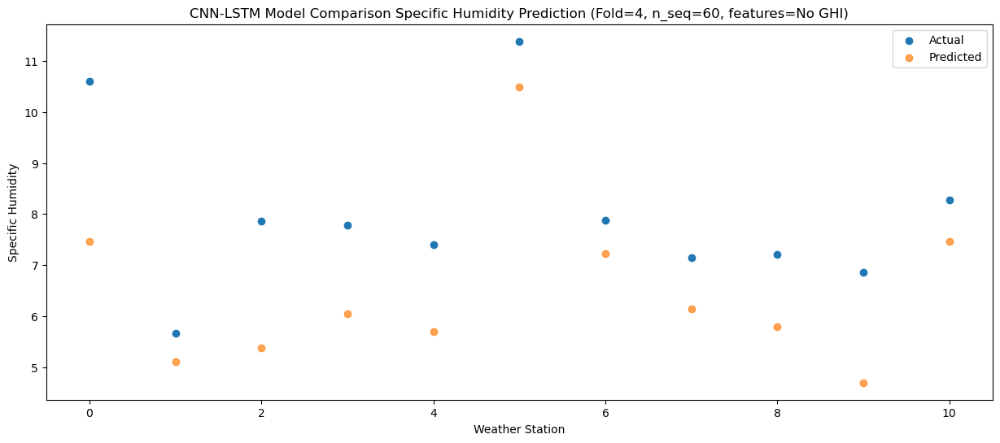

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.24   5.870078
1                 1    2.75   3.145417
2                 2    5.09   3.362236
3                 3    4.94   4.183711
4                 4    4.67   3.883889
5                 5    8.34   8.815701
6                 6    5.67   5.448990
7                 7    5.05   4.437159
8                 8    6.06   4.298185
9                 9    4.99   3.183718
10               10    7.26   6.109867


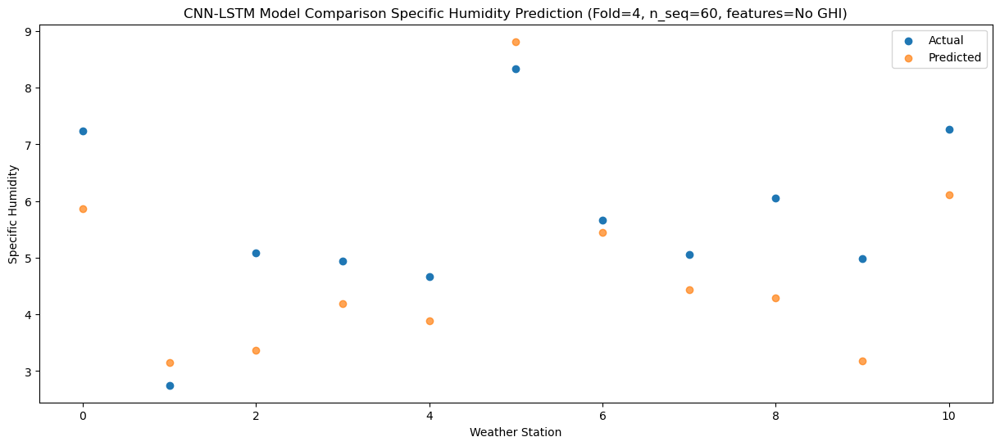

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    3.15   1.388698
1                 1   -1.91  -1.259429
2                 2   -0.35  -1.735430
3                 3    1.32   0.067490
4                 4    1.06  -0.033132
5                 5    6.62   6.065797
6                 6   -0.05   0.144490
7                 7    0.36  -0.319400
8                 8    0.29  -0.563881
9                 9   -0.30  -1.555161
10               10    2.02   1.355679


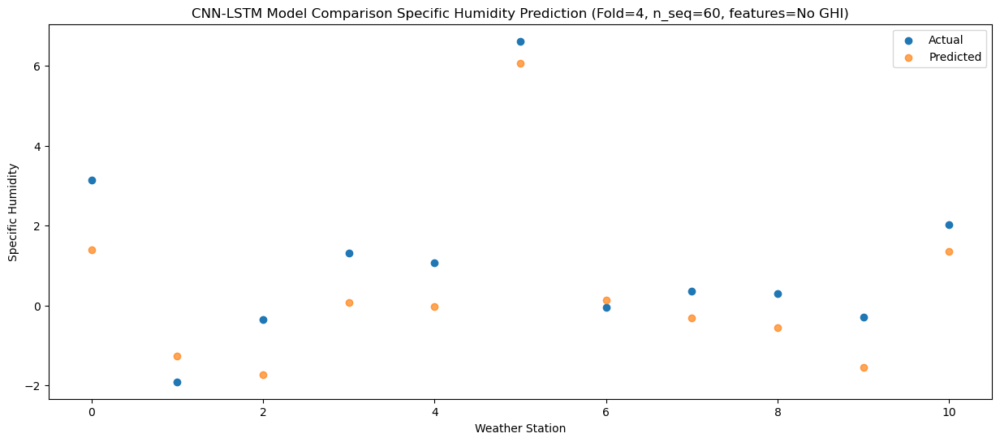

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.94   1.374320
1                 1   -0.17   0.631278
2                 2    2.60   0.143705
3                 3    3.18   0.751622
4                 4    2.47   0.442988
5                 5    5.77   5.950489
6                 6    1.81   1.642950
7                 7    1.83   0.226320
8                 8    1.00  -0.415815
9                 9    0.24  -1.504064
10               10    1.98   1.192077


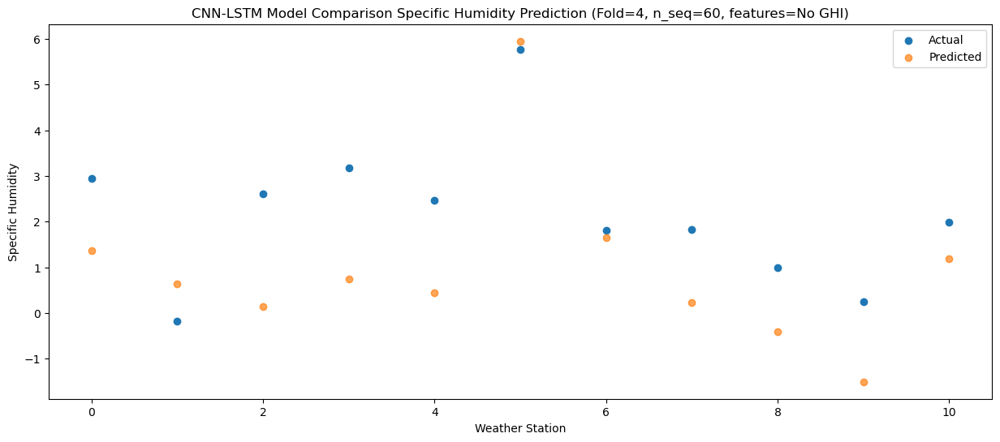

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0    0.93  -0.635220
1                 1   -4.03  -2.851235
2                 2   -2.13  -3.559026
3                 3   -1.48  -1.884311
4                 4   -1.86  -1.978055
5                 5    4.31   4.290765
6                 6   -1.17  -1.618276
7                 7   -1.37  -2.297665
8                 8   -1.38  -2.502348
9                 9   -2.00  -3.540341
10               10    0.24  -0.516078


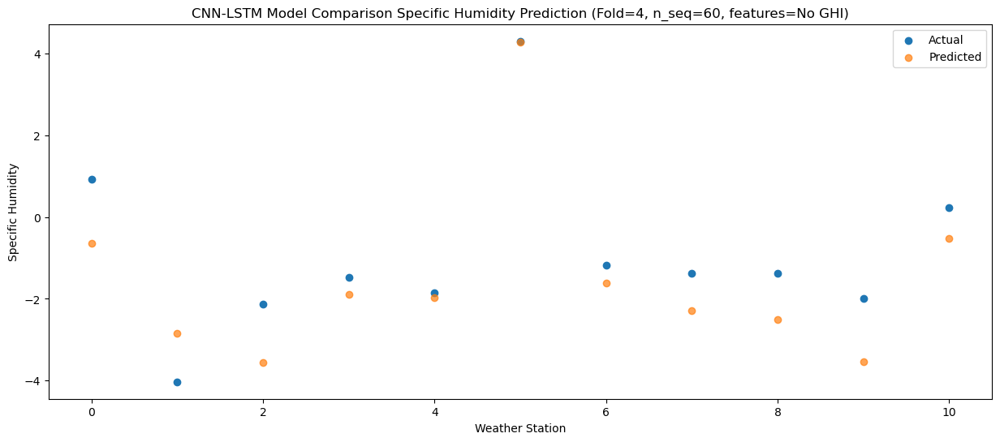

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    1.15  -0.093557
1                 1   -2.45  -1.902624
2                 2   -1.28  -2.556235
3                 3   -0.95  -1.319179
4                 4   -1.42  -1.477372
5                 5    4.30   4.542111
6                 6    0.15  -0.575322
7                 7   -0.86  -1.599067
8                 8   -0.80  -1.800120
9                 9   -1.30  -2.899571
10               10    0.69   0.147296


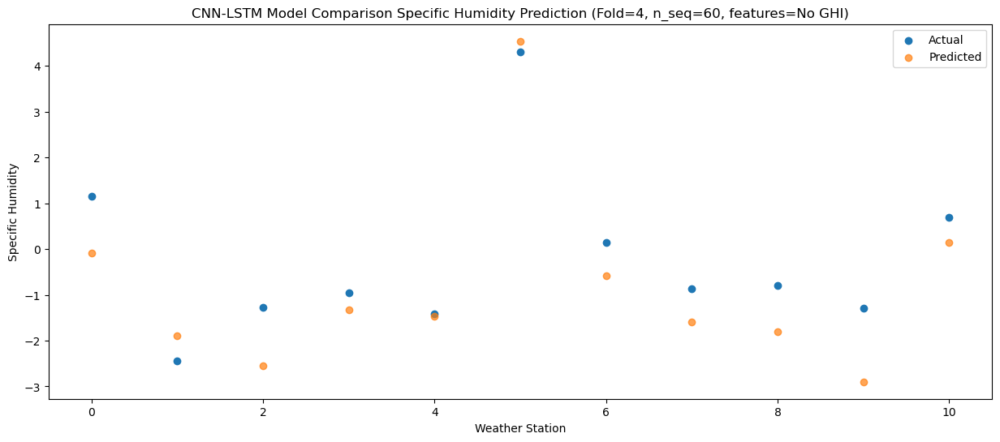

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.71   1.025200
1                 1   -0.92  -0.897248
2                 2   -0.23  -1.510391
3                 3    0.64  -0.232803
4                 4    0.10  -0.389140
5                 5    4.89   5.609178
6                 6    0.99   0.467048
7                 7    0.65  -0.506831
8                 8    0.51  -0.714568
9                 9    0.22  -1.797620
10               10    1.84   1.217587


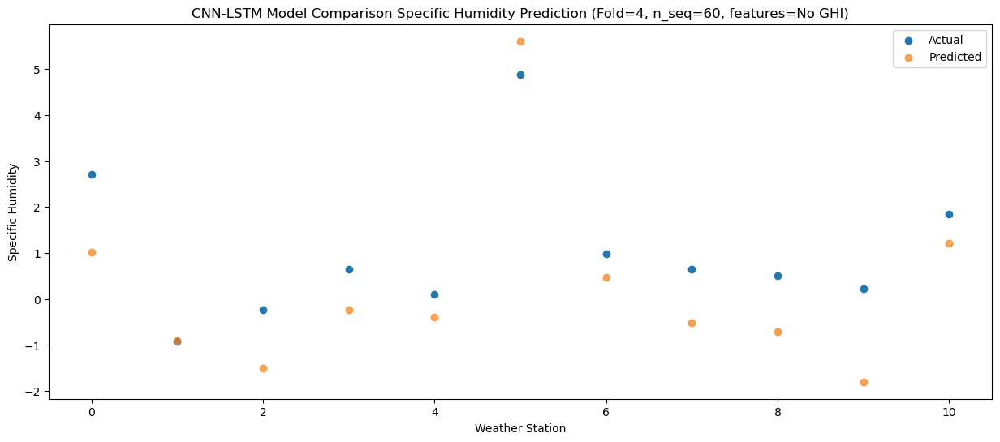

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.20   2.580842
1                 1    0.37   0.460202
2                 2    2.22   0.391118
3                 3    4.15   1.545230
4                 4    3.78   1.295485
5                 5    6.92   6.740645
6                 6    2.05   1.964551
7                 7    2.44   1.162422
8                 8    2.00   0.576301
9                 9    1.52  -0.407706
10               10    2.83   2.201261


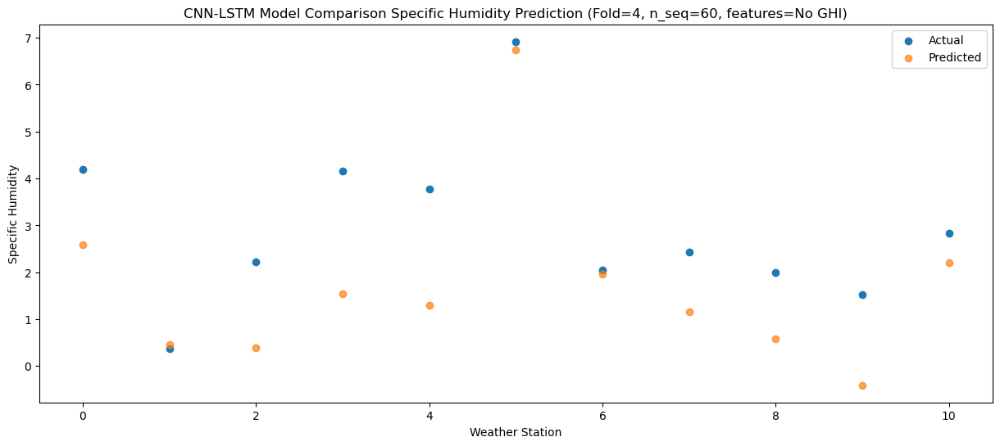

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.08   6.404913
1                 1    2.76   3.715773
2                 2    6.82   4.264627
3                 3    8.14   5.076850
4                 4    7.66   4.721317
5                 5    9.18   9.406015
6                 6    6.06   5.885834
7                 7    7.15   5.048837
8                 8    6.02   4.455329
9                 9    5.59   3.469053
10               10    6.29   5.944734


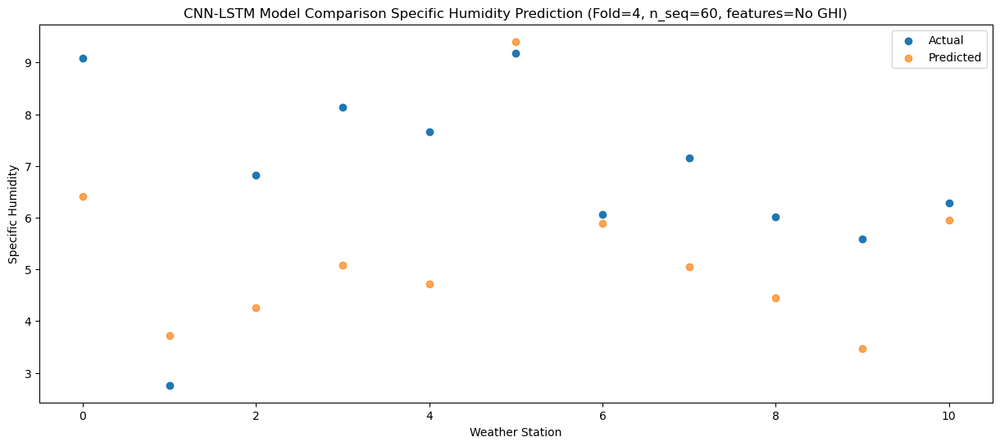

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.31   8.768045
1                 1    5.66   5.590895
2                 2    9.20   6.369585
3                 3    9.91   7.391393
4                 4    9.34   7.046024
5                 5   12.03  11.649820
6                 6    8.34   7.859779
7                 7    9.51   7.305504
8                 8    7.46   6.566422
9                 9    7.83   5.667244
10               10    8.20   7.957323


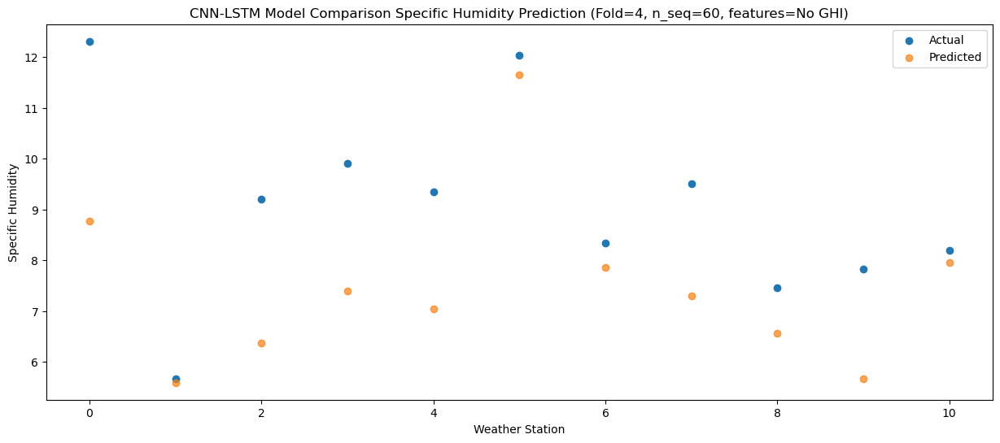

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.94  10.251722
1                 1    6.69   6.982072
2                 2   11.04   7.662333
3                 3    9.33   8.471885
4                 4    8.84   8.129093
5                 5   12.72  12.684401
6                 6   11.50   9.610043
7                 7   10.31   8.779748
8                 8   10.20   8.436090
9                 9   10.47   7.410237
10               10    9.93  10.052418


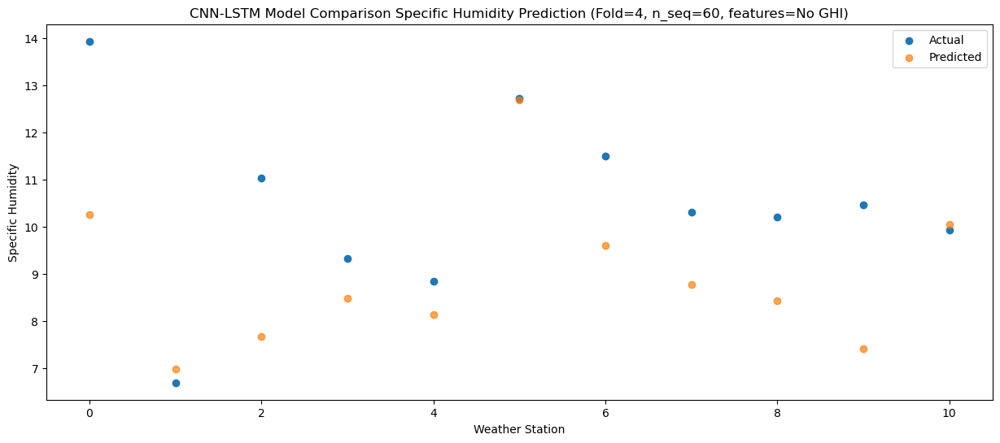

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.73  10.196023
1                 1    6.77   6.696726
2                 2   10.86   7.335878
3                 3   10.34   8.390777
4                 4   10.01   8.084872
5                 5   14.71  12.793253
6                 6   10.31   9.308697
7                 7   10.78   8.661471
8                 8    9.84   8.380690
9                 9    9.70   7.361239
10               10   10.39  10.068940


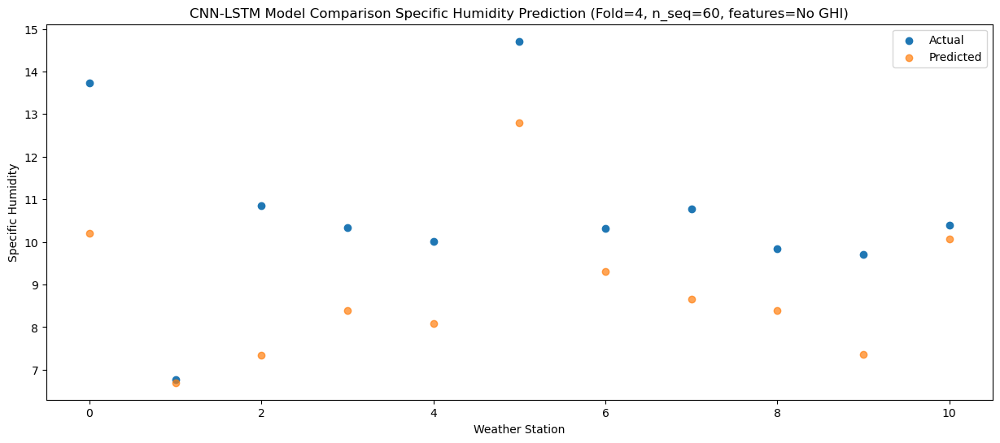

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    9.03   7.158268
1                 1    5.90   4.149321
2                 2    6.62   4.263269
3                 3    7.06   5.469634
4                 4    6.86   5.237511
5                 5   13.46  10.529705
6                 6    6.76   6.324123
7                 7    6.97   5.584103
8                 8    7.18   5.432989
9                 9    6.33   4.372208
10               10    8.40   7.291873


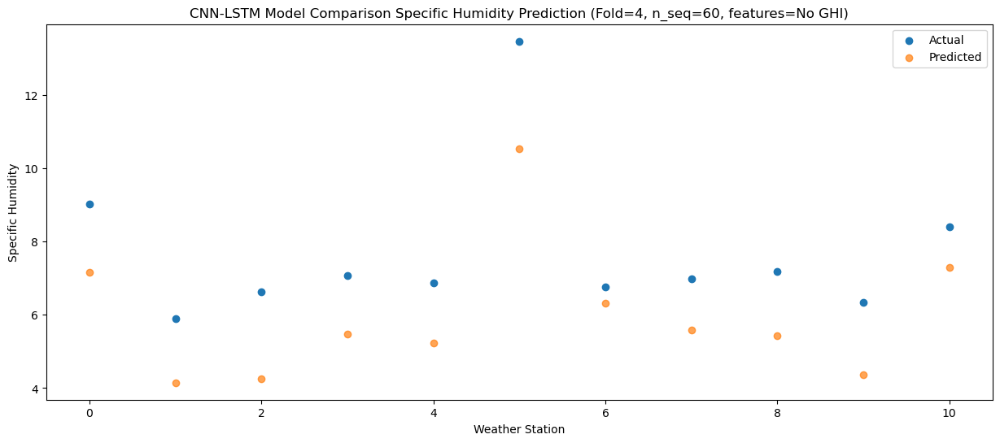

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    4.44   2.342356
1                 1    1.12  -0.238989
2                 2    1.66  -0.884414
3                 3    2.60   0.807882
4                 4    2.40   0.724872
5                 5    9.95   6.970495
6                 6    2.08   1.286978
7                 7    2.31   0.617097
8                 8    1.85   0.614857
9                 9    1.57  -0.458397
10               10    3.58   2.712573


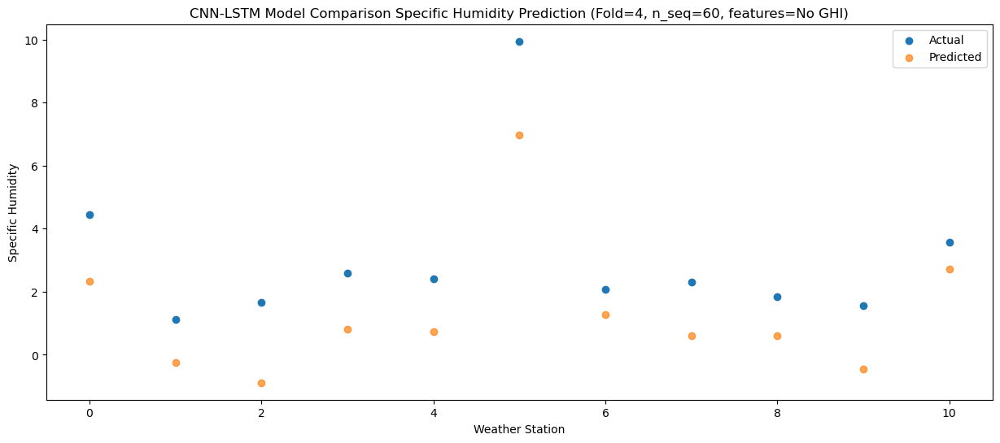

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.27   1.002435
1                 1    1.29  -1.289257
2                 2    0.91  -1.681888
3                 3    2.42  -0.491956
4                 4    1.98  -0.677811
5                 5    7.25   5.068516
6                 6    1.90   0.437151
7                 7    0.95  -0.541729
8                 8    0.81  -0.639037
9                 9    0.20  -1.746170
10               10    2.86   1.331184


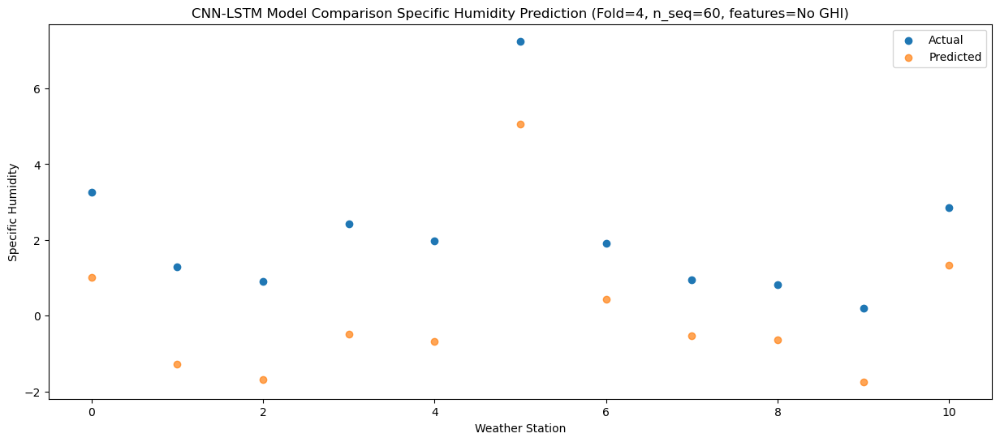

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.93  -0.211774
1                 1   -2.23  -2.385246
2                 2    0.37  -2.953632
3                 3    0.84  -1.442315
4                 4    0.39  -1.579120
5                 5    6.61   4.510484
6                 6   -0.09  -1.032916
7                 7    0.08  -1.784233
8                 8   -0.15  -2.008926
9                 9   -0.91  -3.064056
10               10    1.41  -0.084423


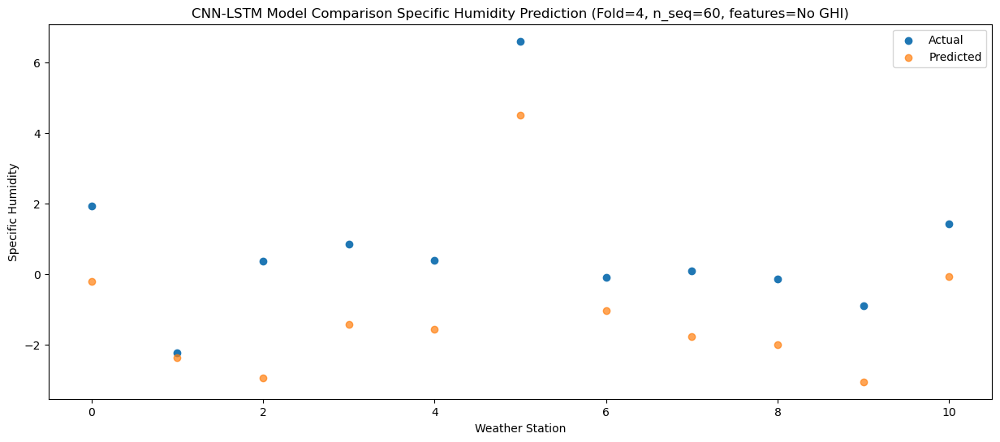

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    2.28  -0.130686
1                 1   -2.74  -2.384345
2                 2    0.27  -3.000596
3                 3    0.15  -1.538221
4                 4   -0.36  -1.664455
5                 5    5.06   4.451692
6                 6    0.54  -0.895846
7                 7    0.36  -1.727182
8                 8    0.47  -1.794450
9                 9   -0.39  -2.895183
10               10    2.03   0.219490


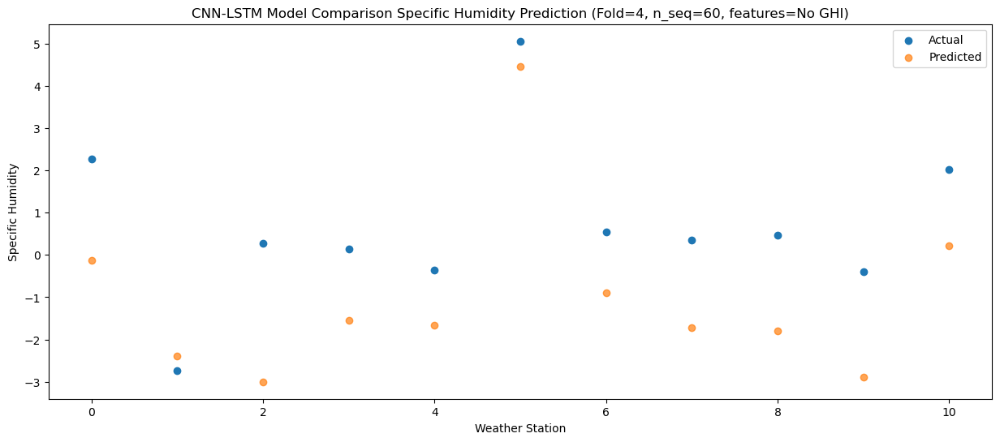

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.23  -0.349467
1                 1   -0.80  -1.753874
2                 2    0.94  -2.334378
3                 3    0.51  -1.401586
4                 4    0.04  -1.621672
5                 5    5.18   4.212354
6                 6    1.58  -0.493253
7                 7    0.17  -1.715698
8                 8    0.07  -2.064479
9                 9   -0.62  -3.165378
10               10    1.28  -0.264165


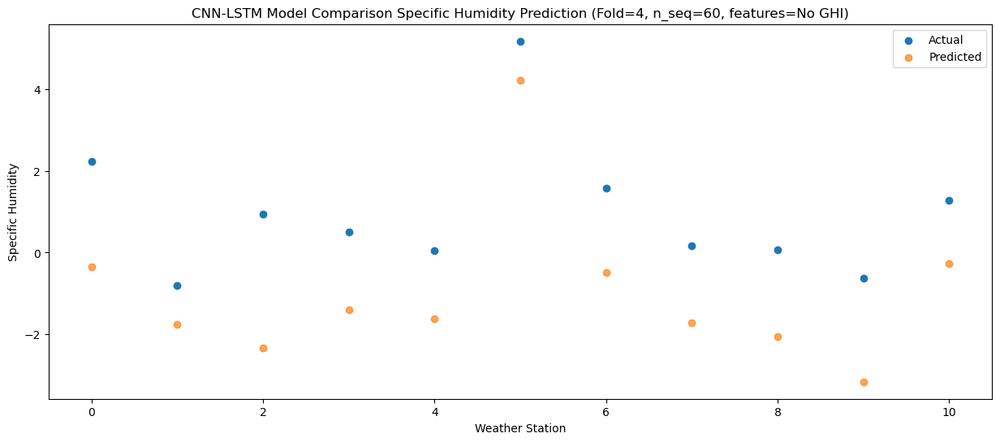

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.07   0.221413
1                 1   -0.42  -1.348490
2                 2    1.27  -1.868788
3                 3    2.57  -0.690201
4                 4    2.01  -0.890971
5                 5    6.47   5.012400
6                 6    1.07  -0.210950
7                 7    0.93  -1.187635
8                 8    0.42  -1.680414
9                 9   -0.01  -2.712700
10               10    1.49   0.051140


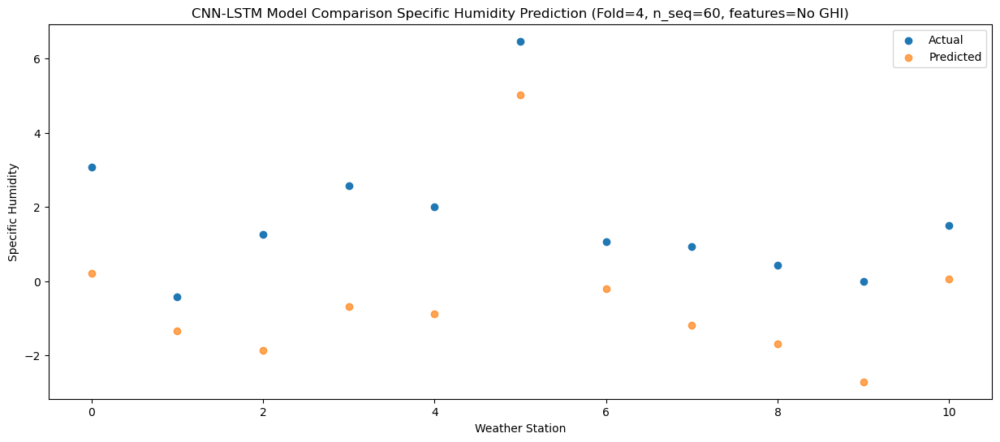

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.25   1.339336
1                 1    1.07  -0.460218
2                 2    2.11  -0.998615
3                 3    3.25   0.034733
4                 4    2.86  -0.162563
5                 5    6.44   5.660265
6                 6    2.67   1.055427
7                 7    1.83  -0.103718
8                 8    1.87  -0.261934
9                 9    1.50  -1.388075
10               10    3.19   1.642563


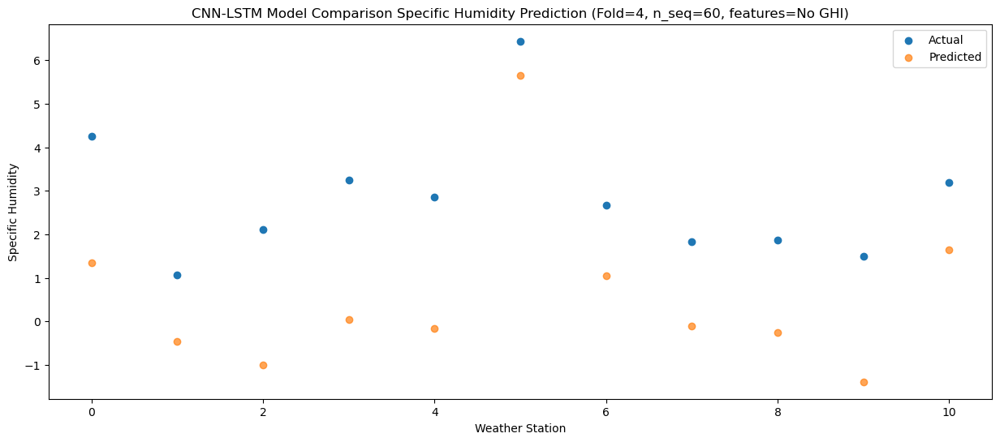

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.27   4.393831
1                 1    1.87   1.597896
2                 2    5.49   1.810113
3                 3    7.51   3.441986
4                 4    7.13   3.227408
5                 5   11.28   8.710239
6                 6    4.89   3.079575
7                 7    6.22   2.828784
8                 8    4.12   1.956113
9                 9    4.28   1.129441
10               10    4.09   3.372518


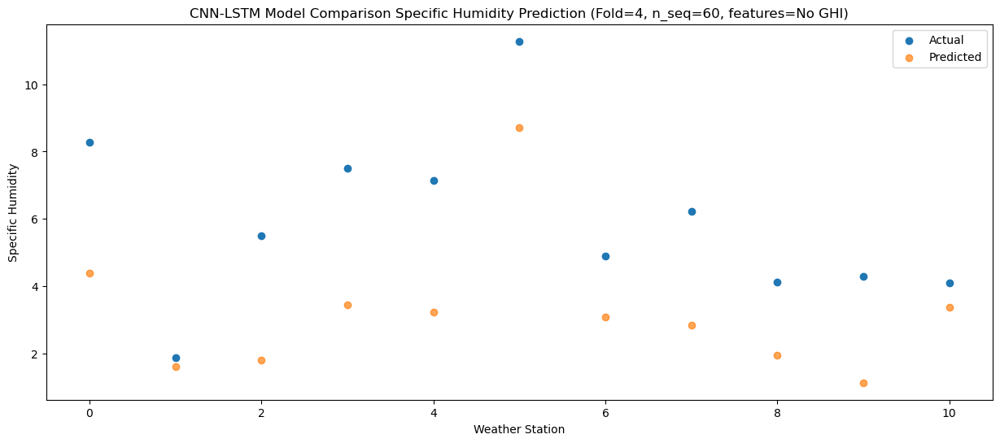

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.81   7.287139
1                 1    5.38   3.775273
2                 2    9.06   4.474744
3                 3   11.45   5.921293
4                 4   10.61   5.646043
5                 5   15.14  10.572880
6                 6    7.94   5.928429
7                 7    8.78   5.704668
8                 8    6.08   4.977528
9                 9    5.92   4.120168
10               10    7.33   6.413990


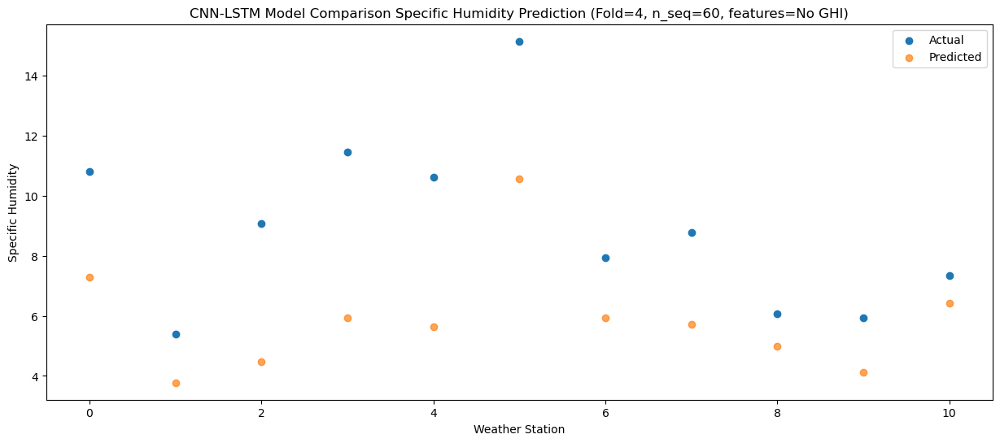

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.50   9.836134
1                 1    7.29   6.050860
2                 2   10.65   6.798260
3                 3   11.30   7.825603
4                 4    9.71   7.514305
5                 5   12.81  12.127923
6                 6   11.33   8.931204
7                 7   11.57   8.279651
8                 8   10.38   8.144132
9                 9   10.62   7.090604
10               10   10.95   9.878196


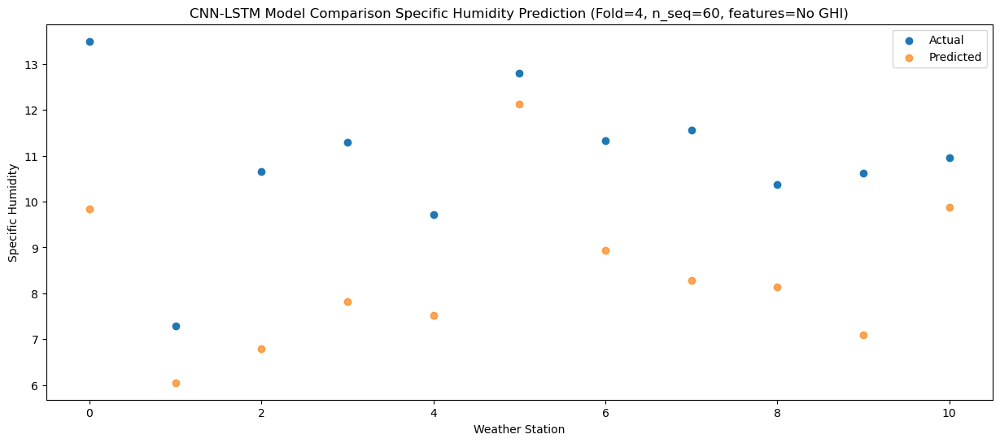

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.43   9.065188
1                 1    7.59   5.998464
2                 2    9.07   6.377507
3                 3    9.20   7.449027
4                 4    8.33   7.166557
5                 5   11.95  12.178025
6                 6   10.87   8.289511
7                 7   11.85   7.557188
8                 8    9.84   7.241785
9                 9   10.49   6.218979
10               10   10.15   8.910534


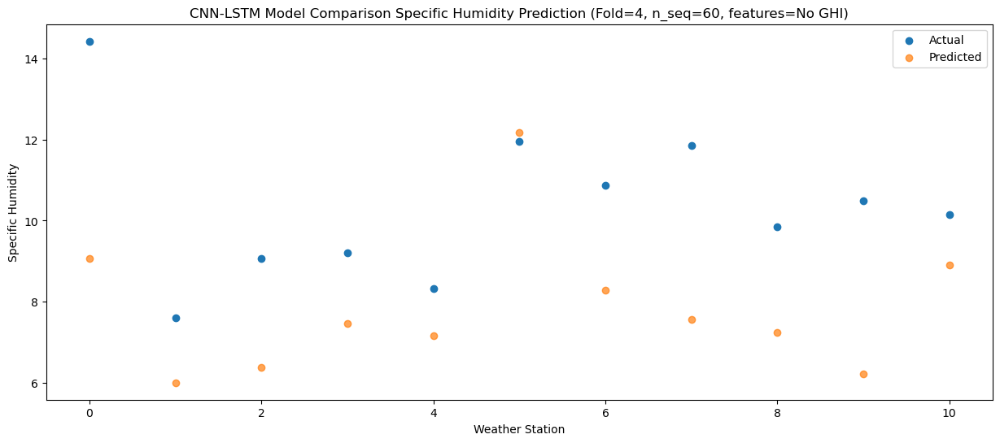

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.51   7.188423
1                 1    5.14   3.972139
2                 2    6.05   4.058345
3                 3    8.30   5.460217
4                 4    8.00   5.261587
5                 5   12.46  10.693940
6                 6    7.42   6.166110
7                 7    7.65   5.559110
8                 8    7.04   5.474022
9                 9    6.71   4.422576
10               10    8.44   7.347101


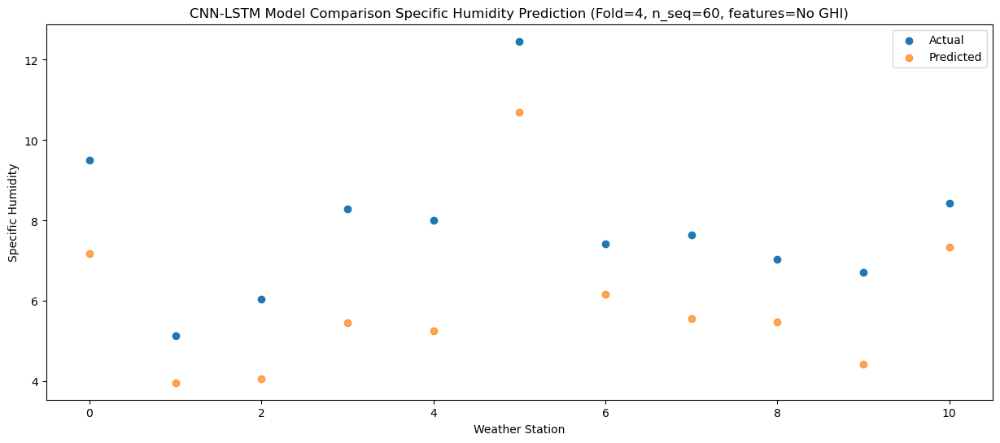

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.32   3.885186
1                 1    1.52   0.659182
2                 2    2.12   0.398727
3                 3    4.58   2.209746
4                 4    4.34   2.104009
5                 5   10.33   8.058631
6                 6    3.51   2.578508
7                 7    4.04   2.158306
8                 8    3.71   2.195959
9                 9    3.27   1.134350
10               10    5.38   4.236469


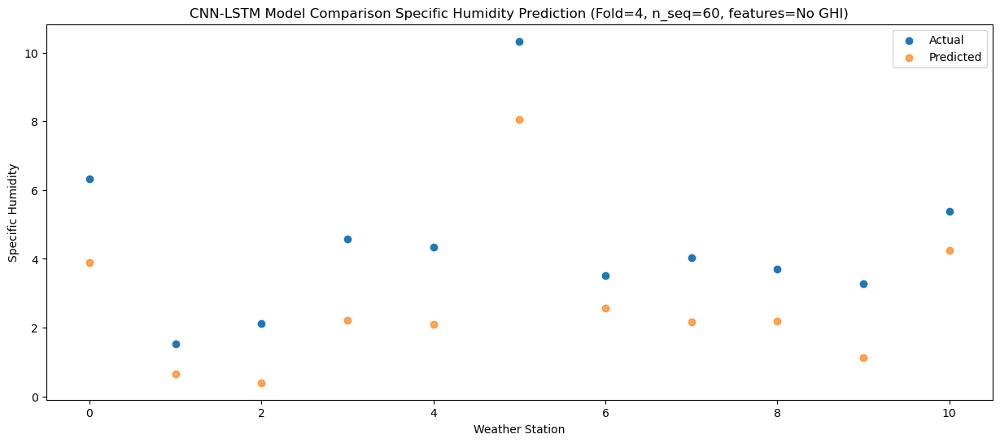

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.42   0.570740
1                 1   -0.78  -2.055851
2                 2    0.14  -2.572009
3                 3    2.05  -0.741007
4                 4    1.92  -0.832526
5                 5    8.03   5.390738
6                 6    0.56  -0.616147
7                 7    1.01  -1.098760
8                 8    0.64  -1.262767
9                 9   -0.12  -2.292444
10               10    1.94   0.688239


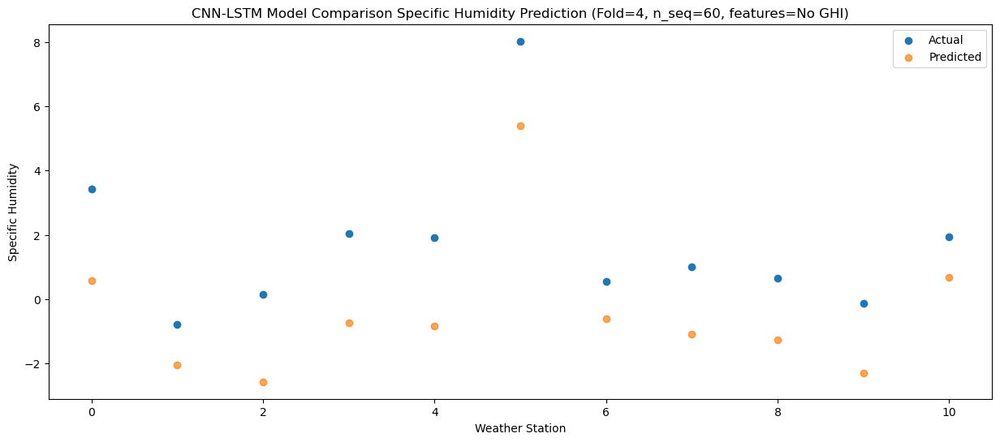

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.24   0.553375
1                 1   -1.87  -2.691781
2                 2   -1.17  -3.339907
3                 3    0.30  -1.216838
4                 4    0.16  -1.229323
5                 5    6.45   5.244877
6                 6    0.28  -0.946492
7                 7    0.20  -1.303570
8                 8    0.61  -1.043266
9                 9    0.37  -2.140175
10               10    2.46   1.203461


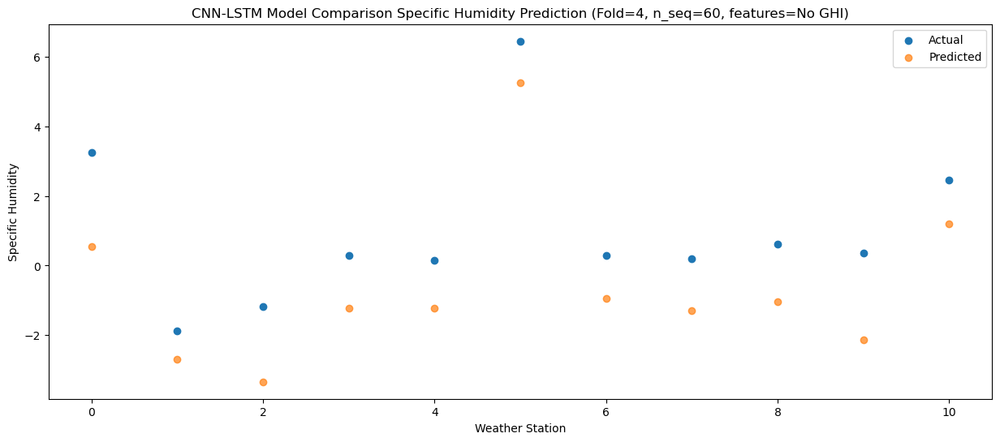

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    1.54  -0.804607
1                 1   -2.91  -3.396324
2                 2   -1.89  -4.342217
3                 3   -0.98  -2.320352
4                 4   -1.26  -2.327412
5                 5    5.18   4.382990
6                 6   -0.50  -2.015293
7                 7   -0.95  -2.576355
8                 8   -0.47  -2.372527
9                 9   -1.09  -3.492516
10               10    1.39  -0.121210


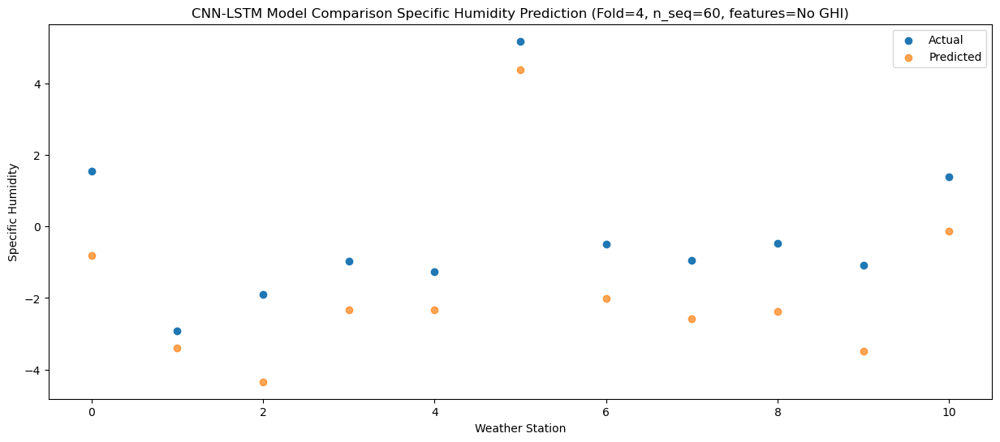

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    2.55  -0.072808
1                 1   -3.60  -3.001551
2                 2   -0.46  -3.618614
3                 3    1.36  -1.382196
4                 4    1.09  -1.408910
5                 5    5.53   5.108538
6                 6   -0.32  -1.632494
7                 7    0.41  -1.841439
8                 8    0.11  -1.933746
9                 9   -0.17  -2.945260
10               10    1.41   0.111764


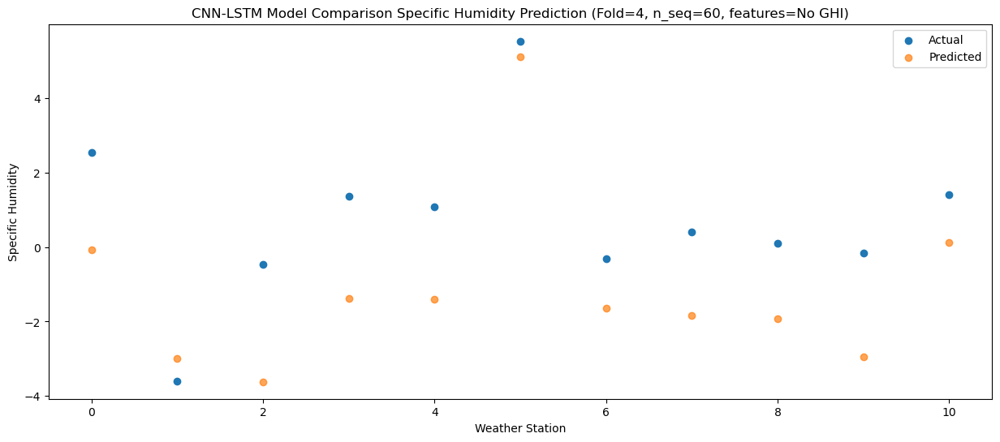

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.61   0.720565
1                 1   -0.31  -1.583811
2                 2    1.17  -2.127149
3                 3    3.15  -0.375239
4                 4    3.04  -0.489544
5                 5    6.67   5.699314
6                 6    1.25  -0.267994
7                 7    1.62  -0.836515
8                 8    1.18  -1.084174
9                 9    0.80  -2.125100
10               10    2.48   0.833990


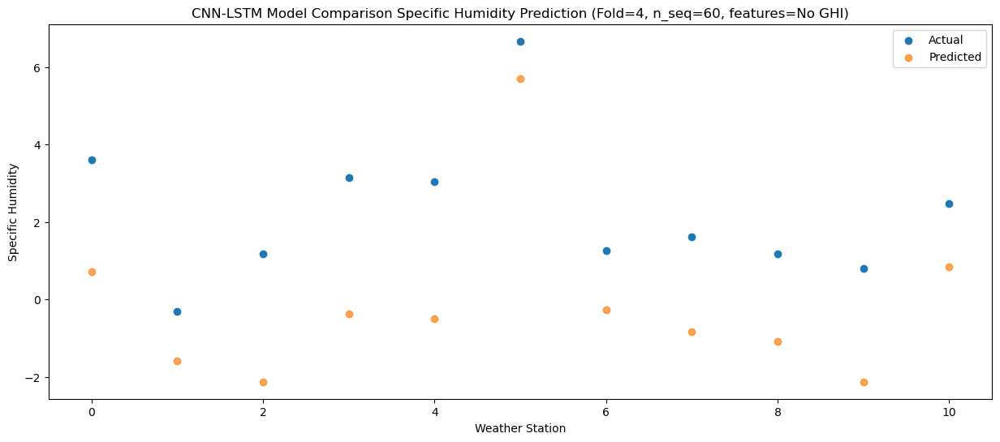

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.29   2.260620
1                 1   -0.91  -0.443664
2                 2    3.35  -0.625591
3                 3    5.52   1.047418
4                 4    5.54   0.886801
5                 5    7.27   6.680951
6                 6    3.17   1.223367
7                 7    3.35   0.728644
8                 8    3.21   0.441932
9                 9    2.52  -0.584575
10               10    4.26   2.280493


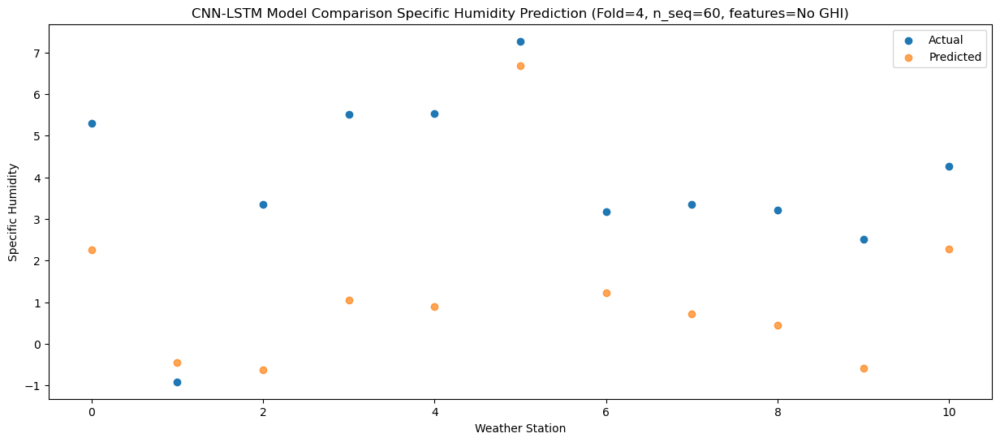

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.36   5.714352
1                 1    1.68   3.083731
2                 2    7.67   3.367446
3                 3    9.09   4.494792
4                 4    8.97   4.206593
5                 5   10.03   9.285702
6                 6    7.17   5.120685
7                 7    7.77   4.369429
8                 8    6.70   3.926852
9                 9    6.06   2.887483
10               10    7.18   5.571661


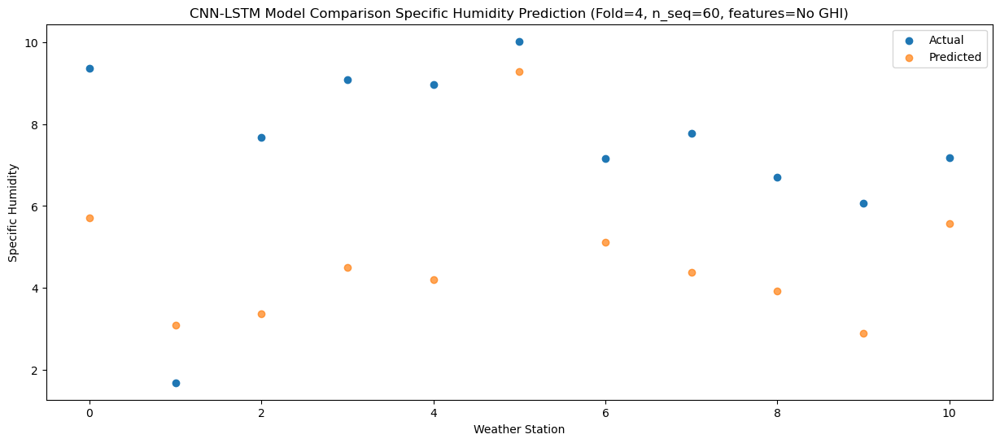

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   12.62   8.922656
1                 1    3.14   4.667783
2                 2    9.01   5.486288
3                 3   11.03   7.296237
4                 4   11.08   7.070259
5                 5   14.56  12.019974
6                 6    8.93   7.210061
7                 7    9.75   7.254496
8                 8    8.39   6.790453
9                 9    8.82   5.900647
10               10    9.73   8.405436


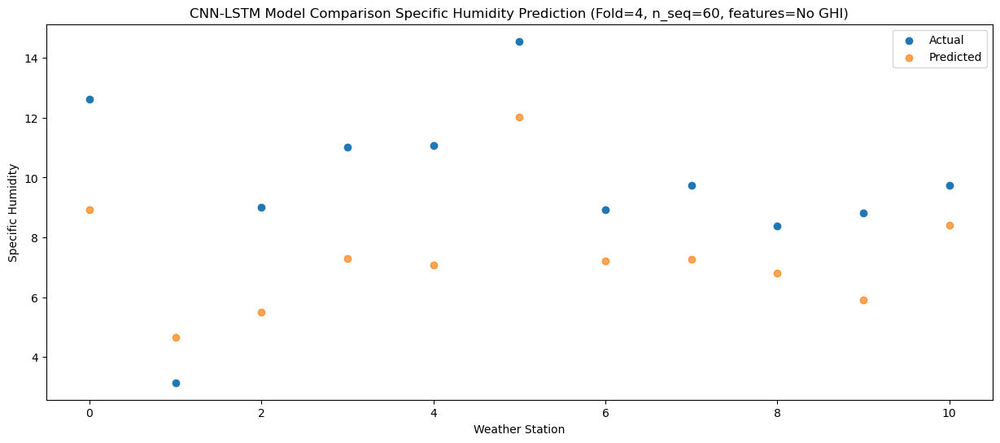

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   13.81   9.382250
1                 1    4.60   6.164644
2                 2   11.04   6.539380
3                 3   10.99   7.674426
4                 4   10.61   7.407186
5                 5   14.44  12.419269
6                 6   11.32   8.665452
7                 7   10.73   7.915324
8                 8    9.69   7.808618
9                 9   10.43   6.714956
10               10   10.85   9.650661


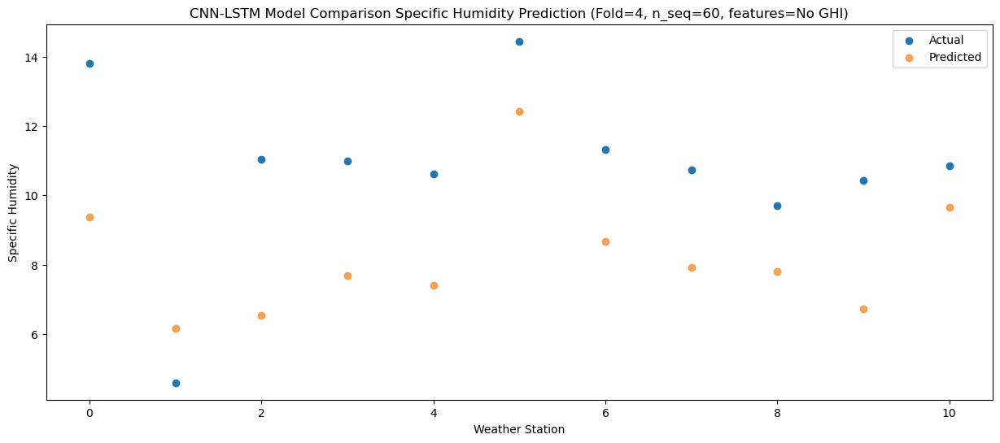

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.65   9.011270
1                 1    7.21   4.922829
2                 2    8.73   5.506642
3                 3   10.28   7.192460
4                 4    9.84   6.991655
5                 5   13.24  12.124871
6                 6   10.58   7.497321
7                 7    9.44   7.320663
8                 8    9.33   7.106621
9                 9   10.07   6.141674
10               10   10.83   8.892604


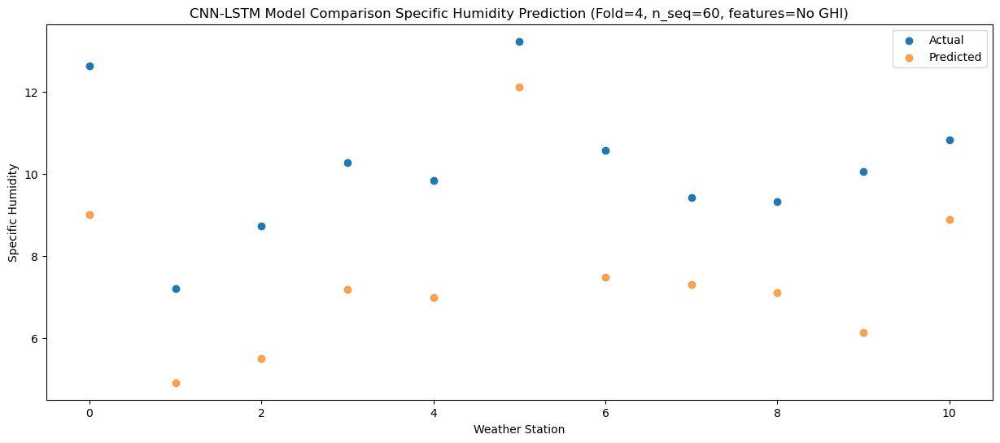

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.35   6.446684
1                 1    7.02   4.240382
2                 2    7.63   4.059323
3                 3    7.75   5.134768
4                 4    7.68   4.905224
5                 5   12.36  10.439933
6                 6    8.26   6.068660
7                 7    7.40   5.067335
8                 8    6.65   4.887822
9                 9    6.57   3.765408
10               10    8.76   6.764317


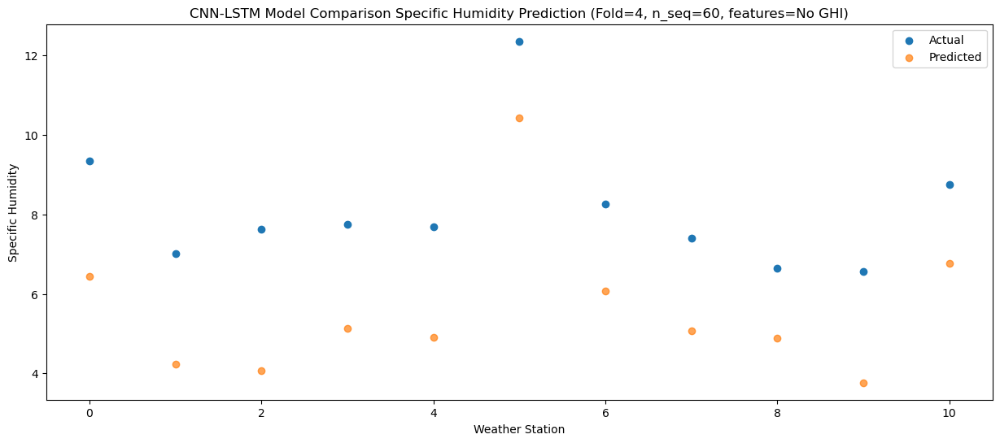

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.22   2.371363
1                 1    2.60  -0.015846
2                 2    2.84  -0.556476
3                 3    4.29   1.061761
4                 4    3.94   0.950670
5                 5    8.67   7.110608
6                 6    3.86   1.508024
7                 7    3.08   0.803000
8                 8    3.07   0.723028
9                 9    2.47  -0.366134
10               10    4.65   2.745238


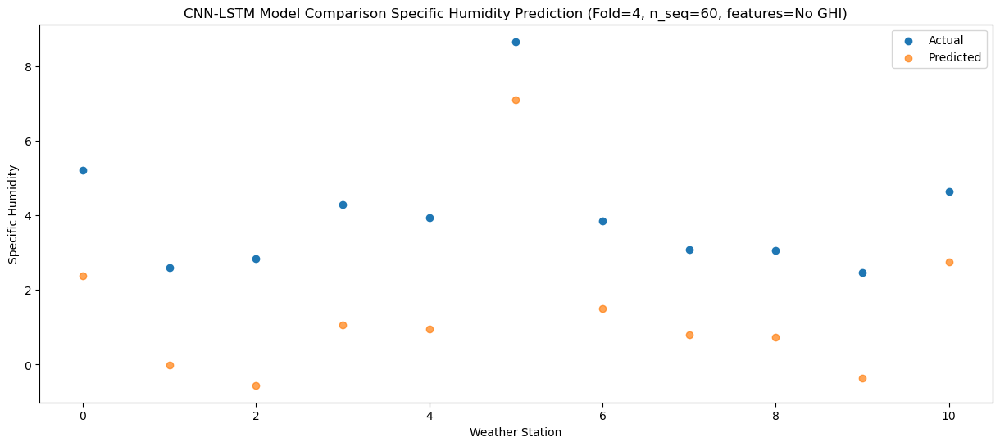

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_8 (LSTM)               (None, 1, 512)            3147776   
                                                                 
 dropout_13 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_9 (LSTM)               (None, 512)               2099200   
                                                      

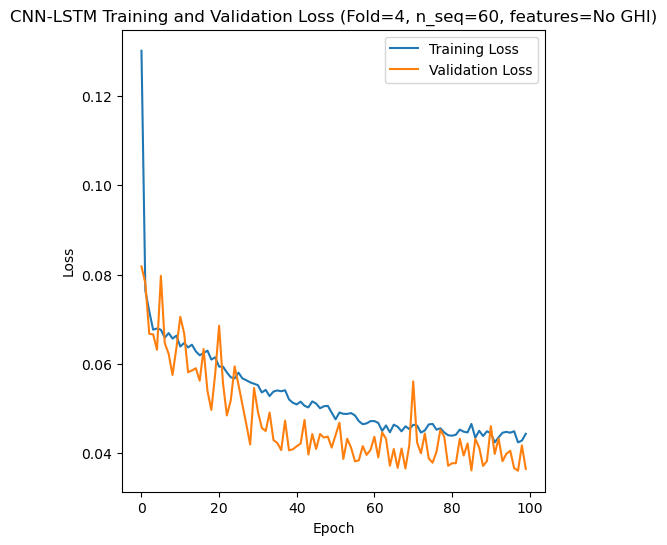

[[0.5925120673772063, 0.7704150791913592, 0.7184062925120149, 0.6360293245045591, 0.8992561086477069, 1.0436947297333425, 1.0966586153124334, 0.8832138889728263, 0.9624454748896693, 1.1462511786720682, 0.9599642887617748, 0.7377046230156848, 0.5137846592745405, 0.8578826878224892, 0.9436675053648786, 0.5871453920464849, 0.9215973832446414, 0.9494510972357544, 0.9346146966028022, 0.8117049271653821, 0.7520657104062427, 0.7701941239315829, 0.8079604654998401, 0.8387775392951903, 0.9099183475453723, 1.3974700305799823, 1.1098491616279653, 1.2013809537907212, 1.3774803290558204, 1.340780090937634, 1.3830400609526683, 1.5447146133720524, 1.8820644879569006, 1.1321020281138803, 0.9258247896131413, 0.842009309052026, 0.9588986550284515, 1.519177844880303, 1.6123752993296658, 1.5342687524471237, 1.780461820052716, 1.8071976970423667, 1.955541329444579, 2.0107454872682107, 1.4842858747692418, 1.6132763851295675, 1.6318019664900199, 1.4801577585403365, 1.7417996094548611, 1.8317293017627496, 1.8

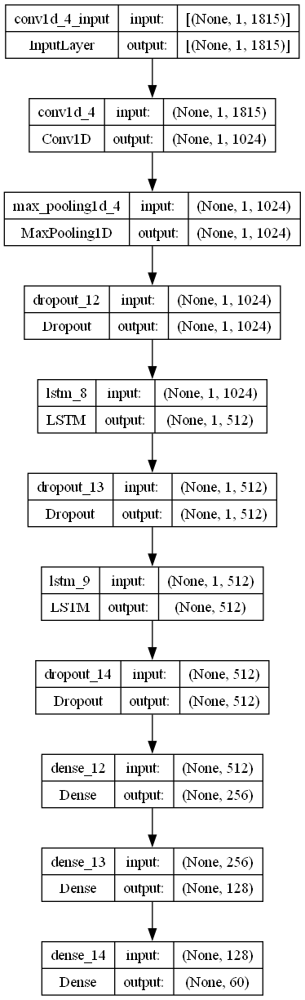

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 1024
    lr = 0.28287453942324176
    optimizer = SGD(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.28163213752842214

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No GHI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No GHI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_SH_S60_No_GHI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

In [4]:
print(np.mean(mape_avg_list))

2332797128716.652


In [7]:
print(len(mape_avg_list))

5


In [8]:
print(np.mean(mape_avg_list[0]))

1.1296736960191731


In [9]:
print(np.mean(mape_avg_list[1]))

5873836391597.957


In [10]:
print(np.mean(mape_avg_list[2]))

1.0474564668925328


In [11]:
print(np.mean(mape_avg_list[3]))

5790149251981.559


In [12]:
print(np.mean(mape_avg_list[4]))

1.562836456370442


In [13]:
print(mape_avg_list[1])

[0.19530993351059206, 0.8371338161102759, 243076030089706.47, 4.024866154005761, 0.18246970992615721, 3.1616049480997677, 0.12265858108483929, 0.15048223374351585, 0.09807888507013242, 0.09702932749483083, 0.09351105912333142, 0.16542664079579664, 1.3857825625178344, 1.205662584873069, 1.6762642432258255, 1.010650611693432, 1.1866458341671664, 2.737162658266384, 0.11664486834822275, 0.06155084117762504, 0.04986069189982562, 0.05291148609698064, 0.0826433655169656, 0.19888859510935405, 0.5121101490174039, 1.5071672594460344, 1.3581323380289465, 3.6837028649052486, 6.451464394047656, 109354153406111.86, 0.22492123438023864, 0.11198838275514546, 0.08697388242778409, 0.048225532555650916, 0.06396542041483101, 0.9203543004537355, 1.2775940880497187, 0.4690446112218206, 0.7873453380185045, 15.53060427149099, 0.7062878414714405, 0.4528611550193223, 0.13562946008161744, 0.12474345103864998, 0.08190853311994738, 0.14229103340413973, 0.08967637526208547, 0.18601719244739884, 0.3251460555366204, 

In [14]:
print(mape_avg_list[3])

[0.5166426283754583, 0.8031914129875076, 2.0746962336570403, 1.2438036646946113, 0.5224011031220652, 0.32494765922594393, 0.19406436319699075, 0.10285419749731493, 0.07361022619274968, 0.08329468225359621, 0.12001435111488541, 0.19551843809883607, 0.5317668351029877, 0.635131721369051, 0.4074392424320113, 0.27640007203439193, 305969755660913.9, 0.32455744230416256, 0.22594845739146255, 0.11501401961857374, 0.1187074666853163, 0.1328473924882465, 0.10583583819693826, 0.2094349302006041, 1.1550349197023595, 0.8974782522128141, 0.3416381505841965, 0.48725618190824965, 13.096486865903888, 0.3728834068249489, 0.1266701591022751, 0.11595124189713193, 0.10409544173869144, 0.1295024544235731, 0.14020950374897376, 0.26099472084854997, 0.8580025555354637, 2.4040258101305785, 1.2913581888010135, 1.1039084447962688, 1.770404560342977, 0.43353285387534535, 0.9040598974948896, 0.1094234002663401, 0.11368467673822612, 0.13283511803667802, 0.14873572314610706, 0.205221961190143, 2.518344257157346, 2.1

In [17]:
print(mape_avg_list[3][51])

41439199457921.484


In [18]:
print(mape_avg_list[3][16])

305969755660913.9


In [19]:
print(mape_avg_list[1][2])

243076030089706.47


In [20]:
print(mape_avg_list[1][29])

109354153406111.86


In [21]:
print(len(mape_avg_list[1]))

60


In [23]:
print(np.sum(mape_avg_list[1][0:1])+np.sum(mape_avg_list[1][3:28])+np.sum(mape_avg_list[1][30:60]))

51.79582436781263


In [26]:
print("MAPE Average for Fold 2 (removing >1e14 values): "+str(51.79582436781263/58))

MAPE Average for Fold 2 (removing >1e14 values): 0.8930314546174591


In [27]:
print(np.sum(mape_avg_list[3][0:15])+np.sum(mape_avg_list[3][17:50])+np.sum(mape_avg_list[3][52:60]))

57.01411369677088


In [28]:
print("MAPE Average for Fold 4 (removing >1e14 values): "+str(57.01411369677088/58))

MAPE Average for Fold 4 (removing >1e14 values): 0.9830019602891531


In [30]:
print("Average MAPE: "+str((1.1296736960191731+0.8930314546174591+1.0474564668925328+0.9830019602891531+1.562836456370442)/5))

Average MAPE: 1.123200006837752
